In [36]:
import torch
import torch.nn as nn
import torch.nn.functional as F
USE_GPU = torch.cuda.is_available()
BATCH_SIZE = 256

import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
%matplotlib inline

### 격자점 데이터

In [37]:
x = np.array([(i,j) for i in range(-4, 5, 2) for j in range(-4, 5, 2)] * 10000)
x = x + 0.1 * np.random.randn(*x.shape)
print(x.shape)

(250000, 2)


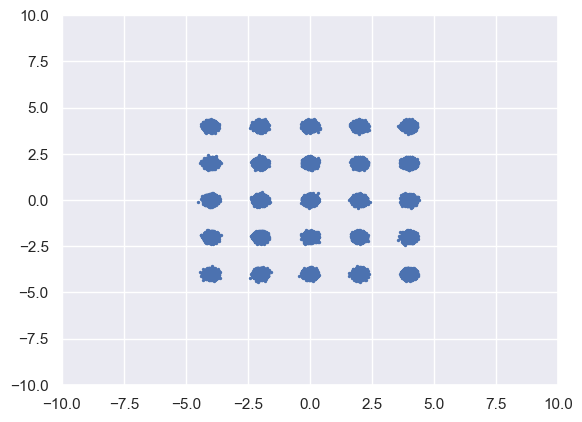

In [ ]:
plt.scatter(x[:,0], x[:,1], s=2.0)
plt.xlim((-10, 10))
plt.ylim((-10, 10))
plt.show()

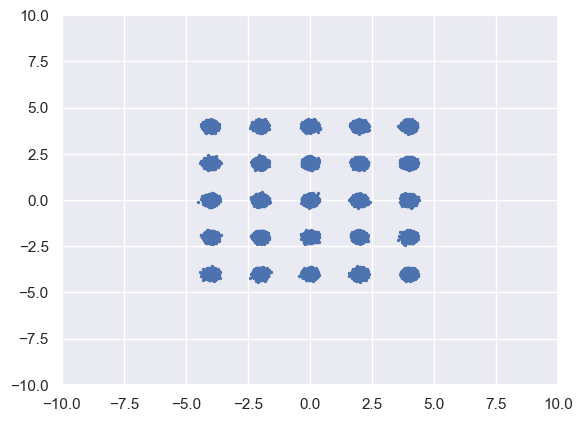

In [39]:
np.random.shuffle(x)
plt.scatter(x[:,0], x[:,1], s=2.0)
plt.xlim((-10, 10))
plt.ylim((-10, 10))
plt.show()

In [51]:
class Generator(nn.Module):
    
    def __init__(self, input_size=10, output_size=2, hidden_size=128):
        super().__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.fc2 = nn.Linear(hidden_size, hidden_size)
        self.fc3 = nn.Linear(hidden_size, output_size)
        
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight)
                nn.init.constant_(m.bias, 0.0)
                
    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), negative_slope=2e-1)
        x = F.leaky_relu(self.fc2(x), negative_slope=2e-1)
        x = F.leaky_relu(self.fc3(x), negative_slope=2e-1)
        return x
        
class Discriminator(nn.Module):
    
    def __init__(self, input_size=2, output_size=1, hidden_size=128):
        super().__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.fc2 = nn.Linear(hidden_size, hidden_size)
        self.fc_mu = nn.Linear(hidden_size, hidden_size)
        self.fc_sigma = nn.Linear(hidden_size, hidden_size)
        self.fc3 = nn.Linear(hidden_size, output_size)
        
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight)
                nn.init.constant_(m.bias, 0.0)
                
    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), negative_slope=2e-1)
        x = F.leaky_relu(self.fc2(x), negative_slope=2e-1)
        mu = self.fc_mu(x)
        sigma = torch.sigmoid(self.fc_sigma(x))
        x = torch.sigmoid(F.leaky_relu(self.fc3(mu + sigma * torch.randn_like(sigma)), negative_slope=2e-1))
        return x, mu, sigma
        
class Mine(nn.Module):
    
    def __init__(self, noise_size=3, sample_size=2, output_size=1, hidden_size=128):
        super().__init__()
        self.fc1_noise = nn.Linear(noise_size, hidden_size, bias=False)
        self.fc1_sample = nn.Linear(sample_size, hidden_size, bias=False)
        self.fc1_bias = nn.Parameter(torch.zeros(hidden_size))
        self.fc2 = nn.Linear(hidden_size, hidden_size)
        self.fc3 = nn.Linear(hidden_size, output_size)
        
        self.ma_et = None
        
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight)
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0.0)
                
    def forward(self, noise, sample):
        x_noise = self.fc1_noise(noise)
        x_sample = self.fc1_sample(sample)
        x = F.leaky_relu(x_noise + x_sample + self.fc1_bias, negative_slope=2e-1)
        x = F.leaky_relu(self.fc2(x), negative_slope=2e-1)
        x = F.leaky_relu(self.fc3(x), negative_slope=2e-1)
        return x

## 학습

In [52]:
def update_target(ma_net, net, update_rate=1e-1):
        # update moving average network parameters using network
    for ma_net_param, net_param in zip(ma_net.parameters(), net.parameters()):
        ma_net_param.data.copy_((1.0 - update_rate) \
                                * ma_net_param.data + update_rate*net_param.data)

In [53]:
def vib(mu, sigma, alpha=1e-8):
    d_kl = 0.5 * torch.mean((mu ** 2) + (sigma ** 2)
                                      - torch.log((sigma ** 2) + alpha) - 1)
    return d_kl

In [64]:
def learn_discriminator(x, G, D , M, D_opt, zero_gp=True, vdb=True):
    '''
    real_samples : torch.Tensor
    G : Generator network
    D : Discriminator network
    M : Mutual Information Neural Estimation(MINE) network
    D_opt : Optimizer of Discriminator
    '''
    z = torch.randn((BATCH_SIZE, 10))
    if USE_GPU:
        z = z.cuda()
        x = x.cuda()
    x_tilde = G(z)
    Dx_tilde, Dmu_tilde, Dsigma_tilde = D(x_tilde)
        
    if zero_gp:
        # zero centered gradient penalty  : https://arxiv.org/abs/1801.04406
        x.requires_grad = True
        Dx, Dmu, Dsigma = D(x)
        grad = torch.autograd.grad(Dx, x, create_graph=True,
                             grad_outputs=torch.ones_like(Dx),
                             retain_graph=True, only_inputs=True)[0].view(BATCH_SIZE, -1)
        grad = grad.norm(dim=1)
        gp_loss = torch.mean(grad**2)
    else:
        Dx, Dmu, Dsigma = D(x)
    
    if vdb:
        # information bottleneck
        vib_loss = (vib(Dmu, Dsigma) + vib(Dmu_tilde, Dsigma_tilde))/2
    
    loss = 0.
    gan_loss = - torch.log(Dx).mean() - torch.log(1-Dx_tilde).mean()
    loss += gan_loss
    if zero_gp:
        loss = gan_loss + 1.0 * gp_loss
    if vdb:
        loss += 0.1 * vib_loss
    
    D_opt.zero_grad()
    loss.backward()
    D_opt.step()
    
    if zero_gp:
        return gan_loss.item(), gp_loss.item()
    
    return gan_loss.item(), 0

In [70]:
def learn_generator(x, G, D, M, G_opt, G_ma, mi_obj=False):
    '''
    real_samples : torch.Tensor
    G : Generator network
    D : Discriminator network
    M : Mutual Information Neural Estimation(MINE) network
    G_opt : Optimizer of Generator
    mi_reg : add Mutual information objective
    '''
    z = torch.randn((BATCH_SIZE, 10))
    z_bar = torch.narrow(torch.randn((BATCH_SIZE, 10)), dim=1, start=0, length=3)
        # which is for product distribution.
    if USE_GPU:
        z = z.cuda()
        z_bar = z_bar.cuda()
        x = x.cuda()
    x_tilde = G(z)
    Dx_tilde, Dmu_tilde, Dsimga_tilde = D(x_tilde)
    
    loss = 0.
    gan_loss = torch.log(1-Dx_tilde).mean()
    loss += gan_loss
    if mi_obj:
        z = torch.narrow(z, dim=1, start=0, length=3) # slice for MI
        mi = torch.mean(M(z, x_tilde)) - torch.log(torch.mean(torch.exp(M(z_bar, x_tilde)))+1e-8)
        loss -= 0.05 * mi
    
    G_opt.zero_grad()
    loss.backward()
    G_opt.step()
    
    # EMA GAN : https://arxiv.org/abs/1806.04498
    update_target(G_ma, G)
    
    return gan_loss.item()

In [71]:
def learn_mine(G, M, M_opt, ma_rate=0.001):
    '''
    Mine is learning for MI of (input, output) of Generator.
    '''
    z = torch.randn((BATCH_SIZE, 10)) # (256, 10)
    # which is the input of Generator.
    z_bar = torch.narrow(torch.randn((BATCH_SIZE, 10)), dim=1, start=0, length=3) # (256, 3)
    # which is for product distribution.
    if USE_GPU:
        z = z.cuda()
        z_bar = z_bar.cuda()
    x_tilde = G(z) # which is the output of Generator.
    #print(z.shape, z_bar.shape, x_tilde.shape)
    
    et = torch.mean(torch.exp(M(z_bar, x_tilde))) # z_bar가 x, x_tilde가 y_shuffle
    
    if M.ma_et is None:
        M.ma_et = et.detach().item()
    M.ma_et += ma_rate * (et.detach().item() - M.ma_et)
    z = torch.narrow(z, dim=1, start=0, length=3) # slice for MI -> (256, 3)
    mutual_information = torch.mean(M(z, x_tilde)) - torch.log(et) * et.detach() /M.ma_et
    loss = - mutual_information
    
    M_opt.zero_grad()
    loss.backward()
    M_opt.step()
    
    return mutual_information.item()

In [72]:
z_test = torch.randn((20000, 10))
if USE_GPU:
    z_test = z_test.cuda()
def train(epoch_num=300, is_zero_gp=False, is_mi_obj=False):
    for i in range(1, epoch_num+1):
        np.random.shuffle(x)
        iter_num = len(x) // BATCH_SIZE
        d_loss_arr, gp_loss_arr, g_loss_arr, mi_arr = [], [], [], []
        for j in tqdm(range(iter_num)):
            batch = torch.FloatTensor(x[BATCH_SIZE * j : BATCH_SIZE * j + BATCH_SIZE])
            d_loss, gp_loss = learn_discriminator(batch, G, D, M, D_opt, zero_gp=is_zero_gp)
            g_loss = learn_generator(batch, G, D, M, G_opt, G_ma, mi_obj=is_mi_obj)
            mi = learn_mine(G, M, M_opt)
            
            d_loss_arr.append(d_loss)
            gp_loss_arr.append(gp_loss)
            g_loss_arr.append(g_loss)
            mi_arr.append(mi)
        print('D loss : {0}, GP_loss : {1} G_loss : {2}, MI : {3}'.format(
            round(np.mean(d_loss_arr),4), round(np.mean(gp_loss_arr)),
            round(np.mean(g_loss_arr),4), round(np.mean(mi_arr),4)))
        x_test = G_ma(z_test).data.cpu().numpy()
        plt.title('Epoch {0}'.format(i))
        plt.scatter(x_test[:,0], x_test[:,1], s=2.0)
        plt.xlim((-10, 10))
        plt.ylim((-10, 10))
        plt.savefig(f'result3/{i}.png')
        plt.show()

100%|██████████| 976/976 [00:10<00:00, 89.46it/s]


D loss : 1.2762, GP_loss : 0 G_loss : -0.6806, MI : 0.2562


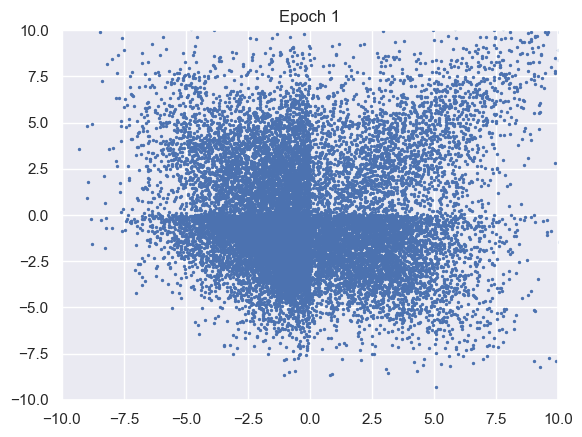

100%|██████████| 976/976 [00:10<00:00, 90.59it/s]


D loss : 1.3357, GP_loss : 0 G_loss : -0.7182, MI : 0.8984


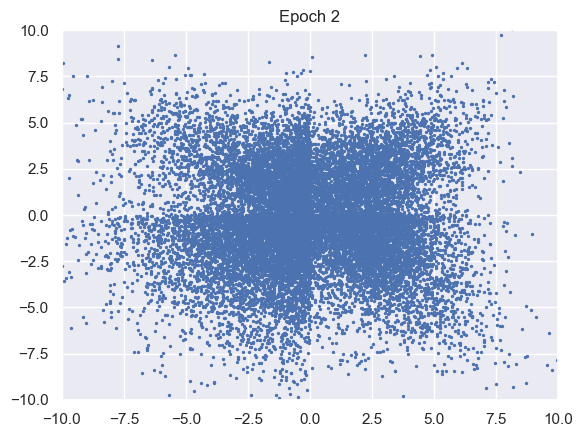

100%|██████████| 976/976 [00:10<00:00, 91.44it/s]


D loss : 1.3477, GP_loss : 0 G_loss : -0.7216, MI : 1.7093


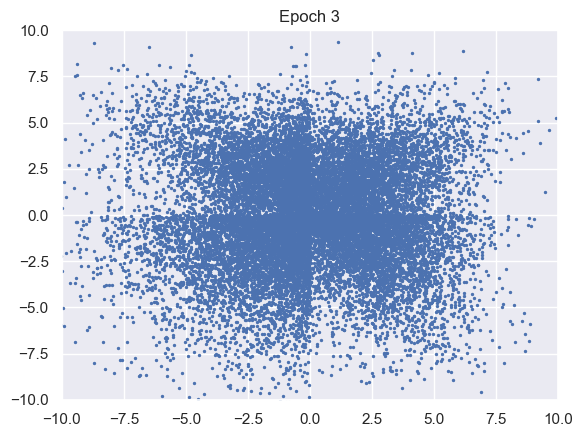

100%|██████████| 976/976 [00:10<00:00, 90.83it/s]


D loss : 1.3381, GP_loss : 0 G_loss : -0.7504, MI : 2.4671


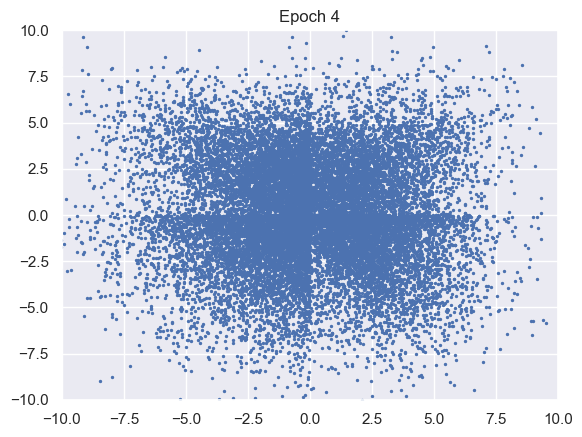

100%|██████████| 976/976 [00:10<00:00, 91.38it/s]


D loss : 1.3337, GP_loss : 0 G_loss : -0.7617, MI : 3.1245


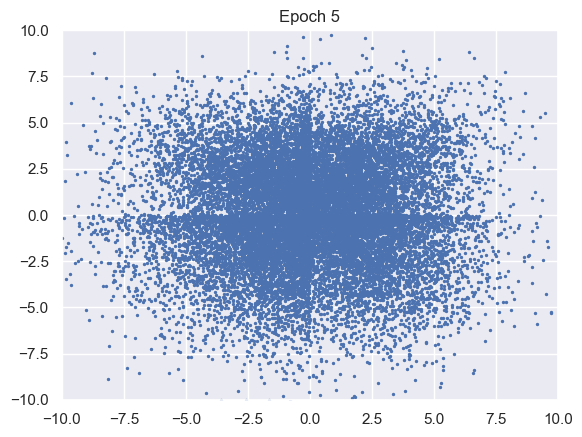

100%|██████████| 976/976 [00:10<00:00, 93.09it/s]


D loss : 1.3252, GP_loss : 0 G_loss : -0.7689, MI : 3.502


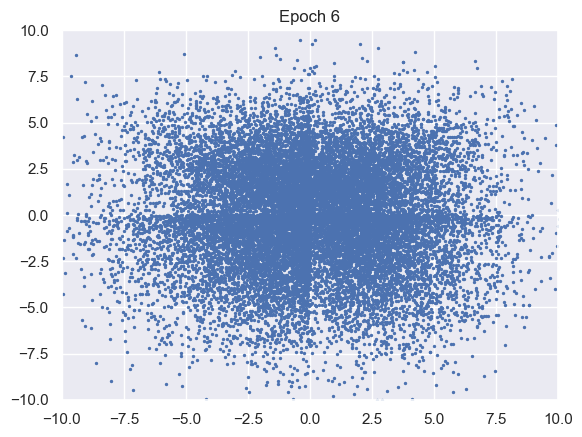

100%|██████████| 976/976 [00:10<00:00, 93.21it/s]


D loss : 1.3144, GP_loss : 0 G_loss : -0.7721, MI : 3.8066


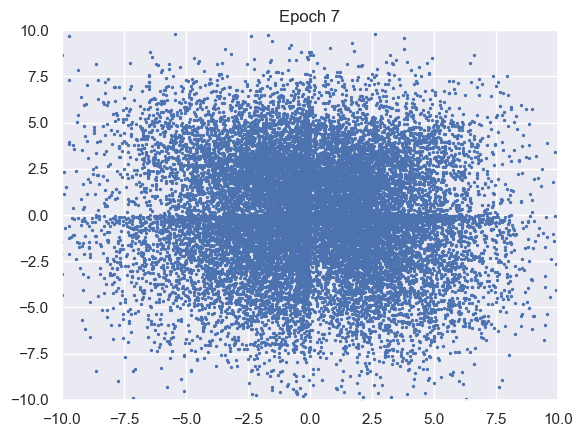

100%|██████████| 976/976 [00:10<00:00, 94.10it/s]


D loss : 1.2964, GP_loss : 0 G_loss : -0.7767, MI : 4.1446


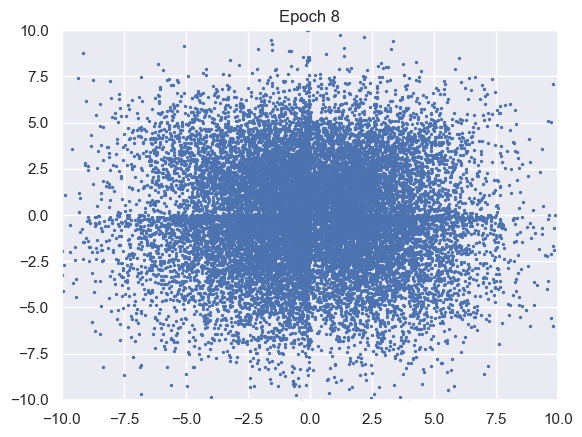

100%|██████████| 976/976 [00:10<00:00, 93.69it/s]


D loss : 1.2713, GP_loss : 0 G_loss : -0.7806, MI : 4.1882


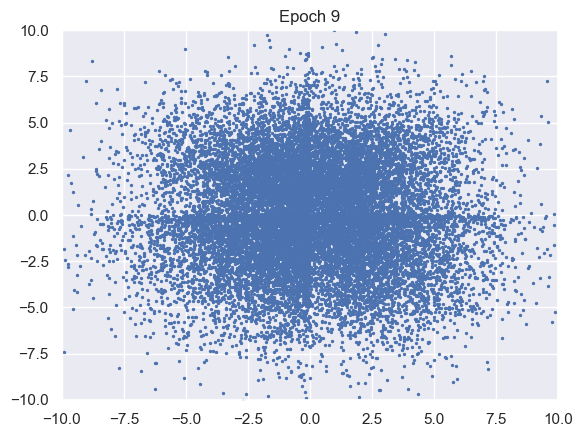

100%|██████████| 976/976 [00:10<00:00, 92.73it/s]


D loss : 1.255, GP_loss : 0 G_loss : -0.7852, MI : 4.1732


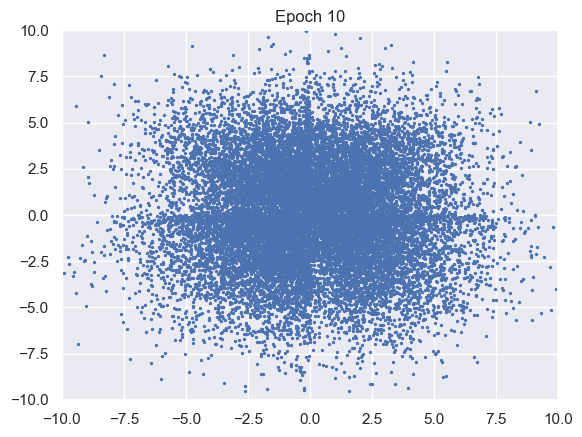

100%|██████████| 976/976 [00:10<00:00, 92.54it/s]


D loss : 1.24, GP_loss : 0 G_loss : -0.7884, MI : 3.9613


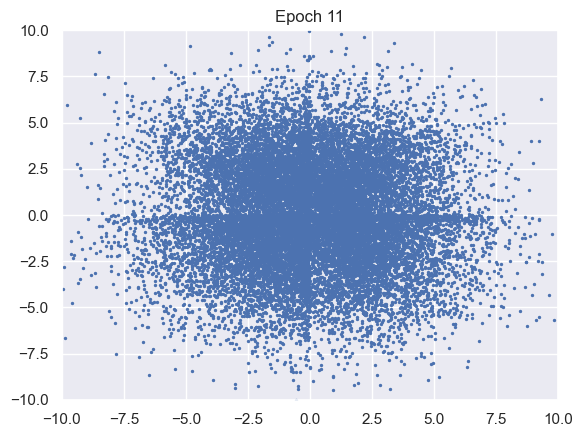

100%|██████████| 976/976 [00:10<00:00, 92.03it/s]


D loss : 1.2235, GP_loss : 0 G_loss : -0.7915, MI : 4.0807


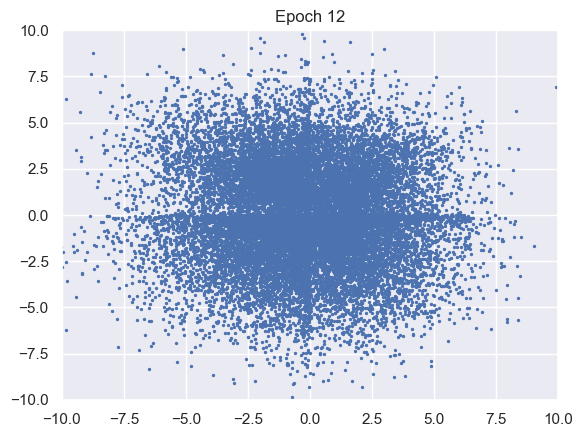

100%|██████████| 976/976 [00:10<00:00, 91.15it/s]


D loss : 1.2163, GP_loss : 0 G_loss : -0.7971, MI : 4.2385


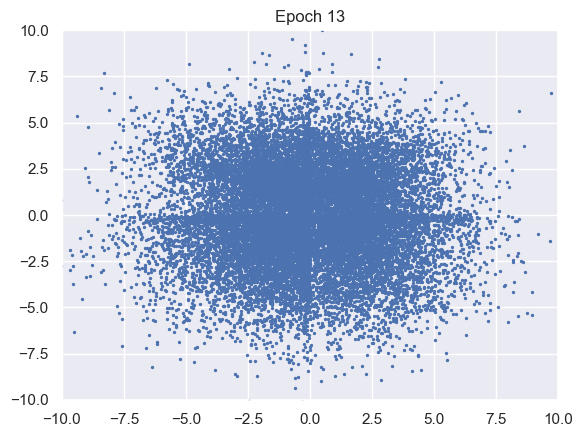

100%|██████████| 976/976 [00:10<00:00, 92.45it/s]


D loss : 1.207, GP_loss : 0 G_loss : -0.7977, MI : 4.1968


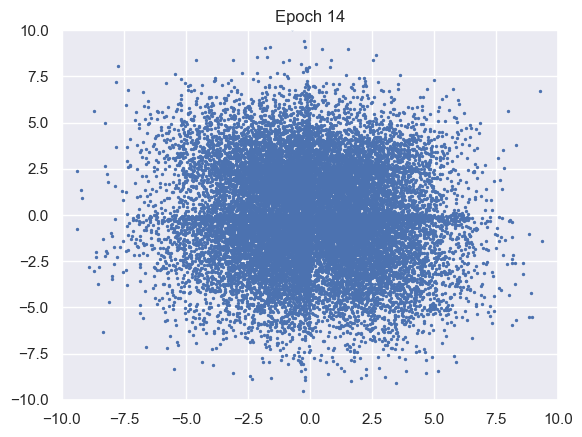

100%|██████████| 976/976 [00:10<00:00, 91.73it/s]


D loss : 1.1979, GP_loss : 0 G_loss : -0.7981, MI : 4.1534


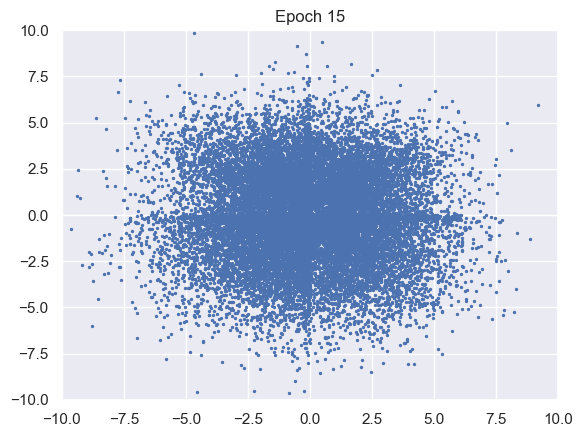

100%|██████████| 976/976 [00:10<00:00, 91.23it/s]


D loss : 1.1967, GP_loss : 0 G_loss : -0.7988, MI : 3.0412


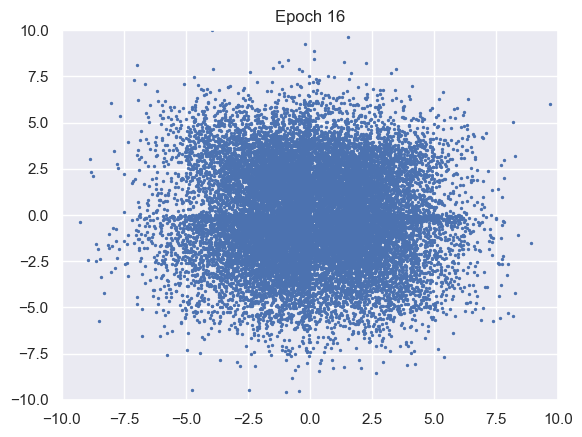

100%|██████████| 976/976 [00:10<00:00, 91.59it/s]


D loss : 1.195, GP_loss : 0 G_loss : -0.7982, MI : 4.5839


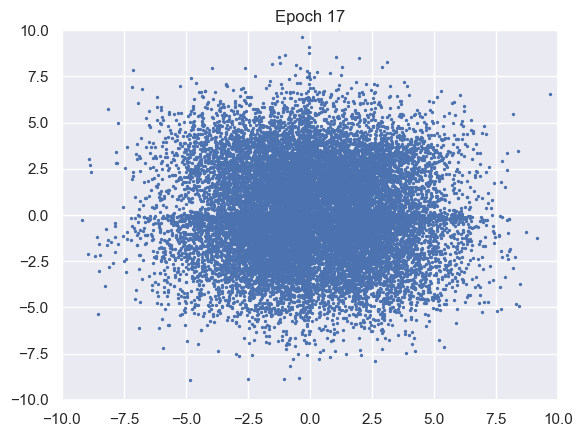

100%|██████████| 976/976 [00:10<00:00, 90.94it/s]


D loss : 1.1894, GP_loss : 0 G_loss : -0.7981, MI : 1.9328


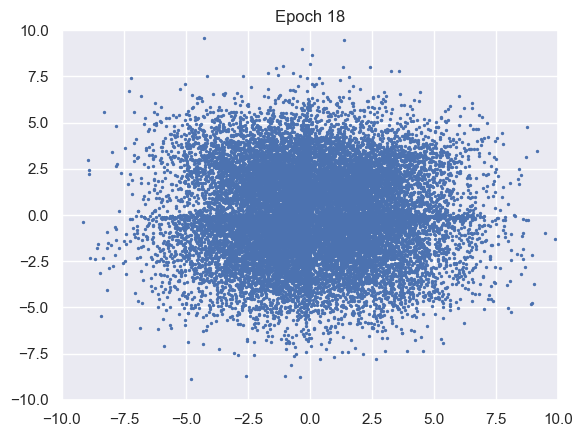

100%|██████████| 976/976 [00:10<00:00, 91.40it/s]


D loss : 1.1819, GP_loss : 0 G_loss : -0.7966, MI : 2.4155


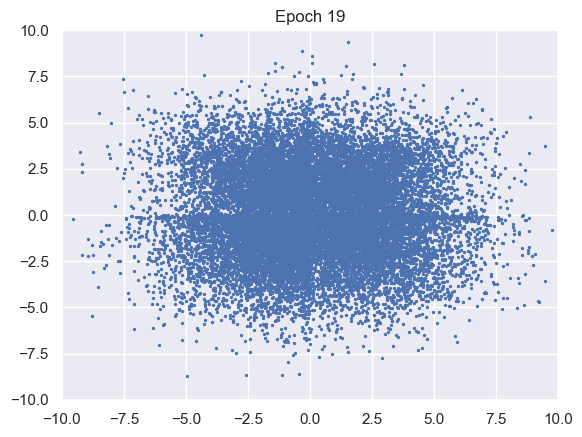

100%|██████████| 976/976 [00:10<00:00, 91.75it/s]


D loss : 1.1752, GP_loss : 0 G_loss : -0.7965, MI : 4.6064


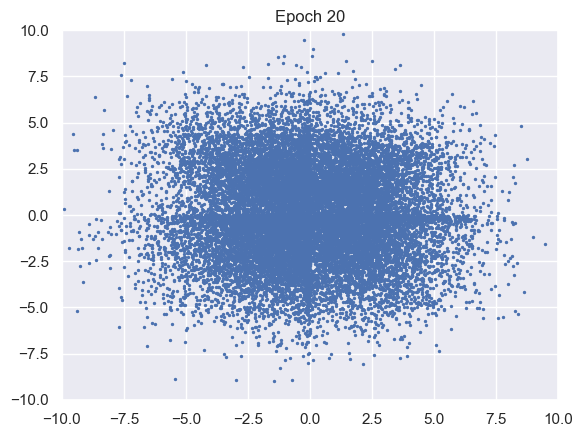

100%|██████████| 976/976 [00:10<00:00, 90.88it/s]


D loss : 1.1714, GP_loss : 0 G_loss : -0.7954, MI : 4.7638


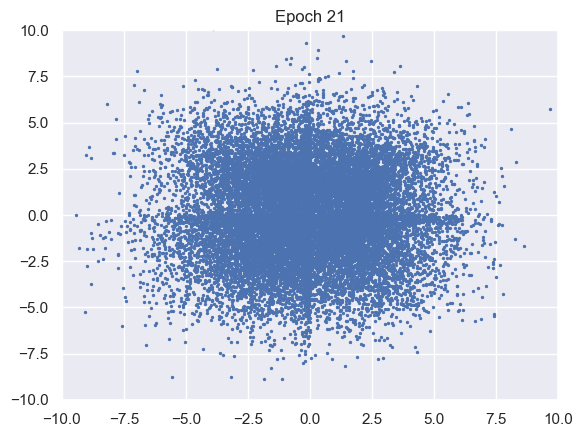

100%|██████████| 976/976 [00:10<00:00, 90.46it/s]


D loss : 1.1666, GP_loss : 0 G_loss : -0.7964, MI : 4.7325


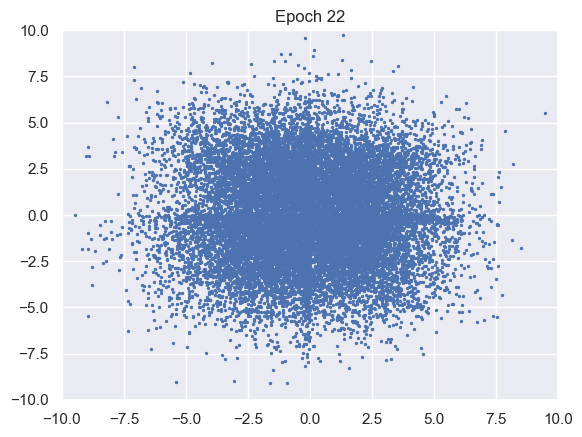

100%|██████████| 976/976 [00:10<00:00, 90.92it/s]


D loss : 1.1608, GP_loss : 0 G_loss : -0.7949, MI : 3.7857


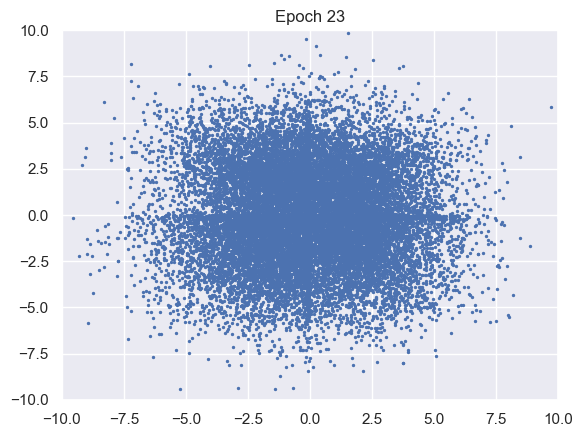

100%|██████████| 976/976 [00:10<00:00, 92.47it/s]


D loss : 1.1579, GP_loss : 0 G_loss : -0.7943, MI : 4.0386


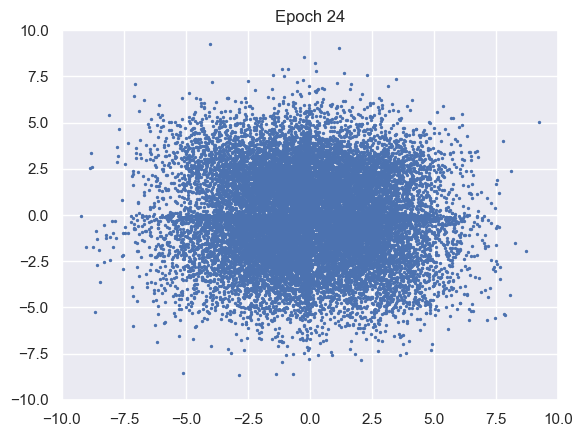

100%|██████████| 976/976 [00:10<00:00, 90.17it/s]


D loss : 1.1536, GP_loss : 0 G_loss : -0.7919, MI : 4.2151


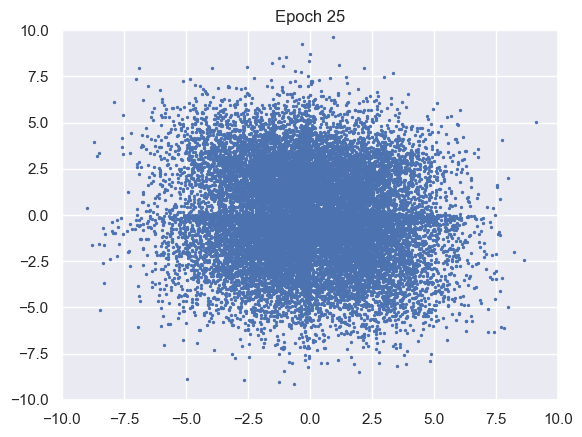

100%|██████████| 976/976 [00:10<00:00, 90.48it/s]


D loss : 1.1479, GP_loss : 0 G_loss : -0.7875, MI : 4.5536


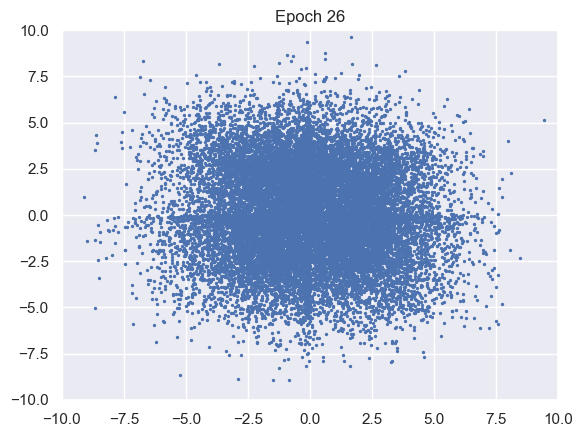

100%|██████████| 976/976 [00:10<00:00, 92.11it/s]


D loss : 1.1379, GP_loss : 0 G_loss : -0.7796, MI : 3.9981


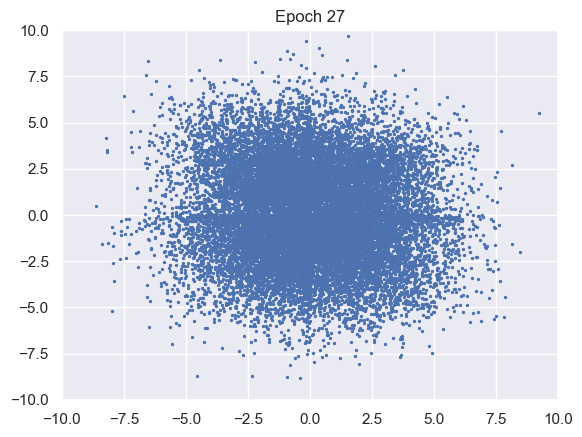

100%|██████████| 976/976 [00:10<00:00, 92.44it/s]


D loss : 1.122, GP_loss : 0 G_loss : -0.7637, MI : 4.5688


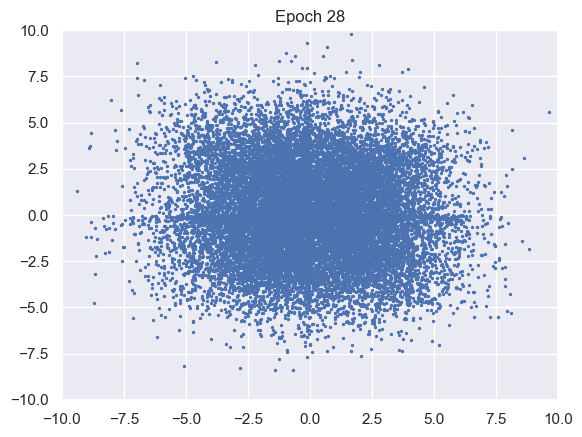

100%|██████████| 976/976 [00:10<00:00, 92.71it/s]


D loss : 1.0892, GP_loss : 0 G_loss : -0.7381, MI : 3.7624


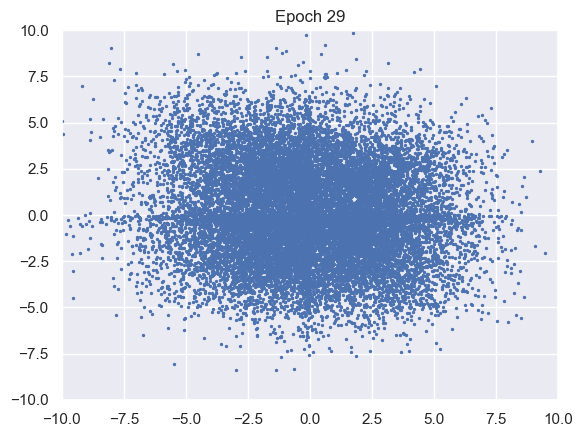

100%|██████████| 976/976 [00:10<00:00, 91.40it/s]


D loss : 1.0644, GP_loss : 0 G_loss : -0.7307, MI : 4.0969


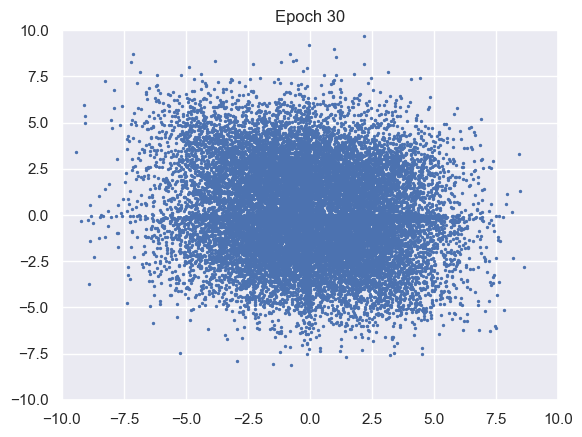

100%|██████████| 976/976 [00:10<00:00, 91.39it/s]


D loss : 1.0559, GP_loss : 0 G_loss : -0.7261, MI : 4.3056


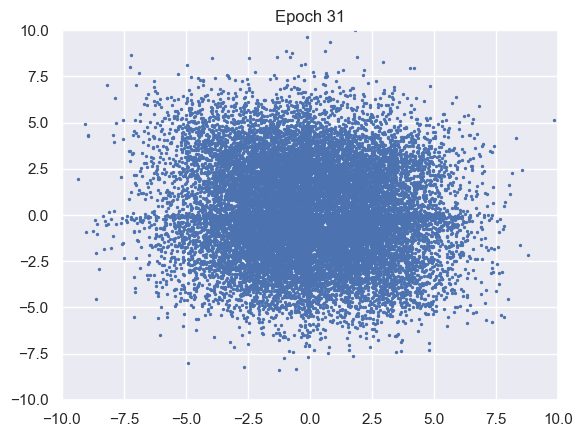

100%|██████████| 976/976 [00:10<00:00, 92.25it/s]


D loss : 1.0478, GP_loss : 0 G_loss : -0.722, MI : 4.4472


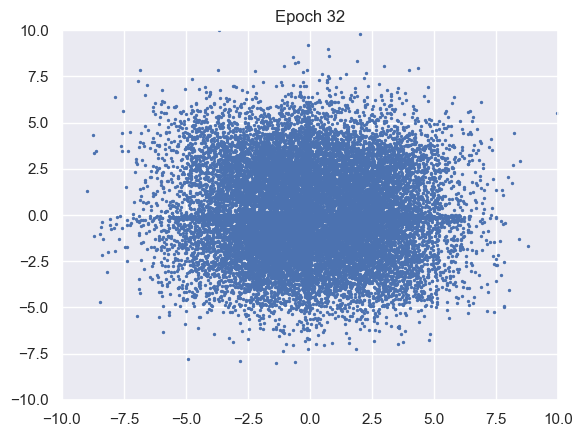

100%|██████████| 976/976 [00:10<00:00, 93.09it/s]


D loss : 1.0375, GP_loss : 0 G_loss : -0.7158, MI : 4.2577


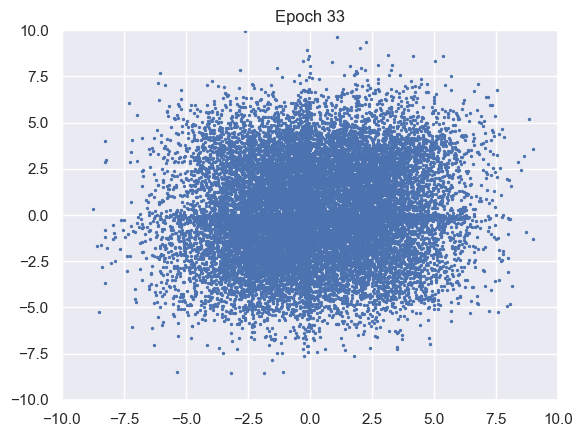

100%|██████████| 976/976 [00:10<00:00, 93.43it/s]


D loss : 1.0318, GP_loss : 0 G_loss : -0.7143, MI : 4.4344


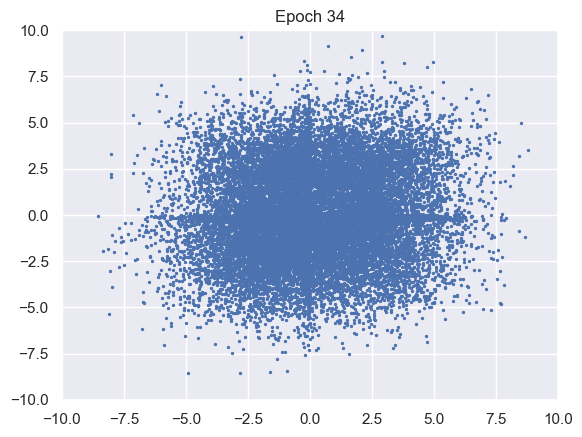

100%|██████████| 976/976 [00:10<00:00, 91.90it/s]


D loss : 1.0254, GP_loss : 0 G_loss : -0.7095, MI : 4.4684


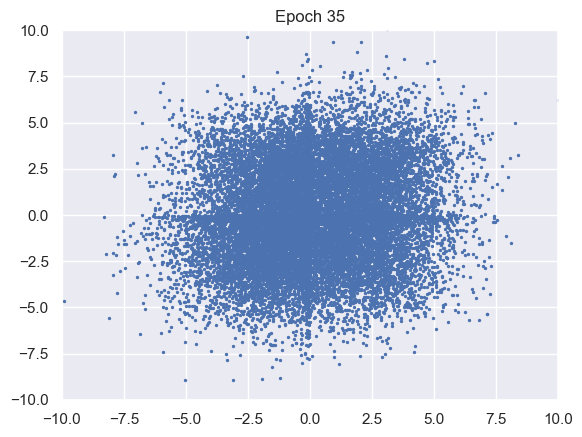

100%|██████████| 976/976 [00:10<00:00, 93.45it/s]


D loss : 1.023, GP_loss : 0 G_loss : -0.7072, MI : 4.2444


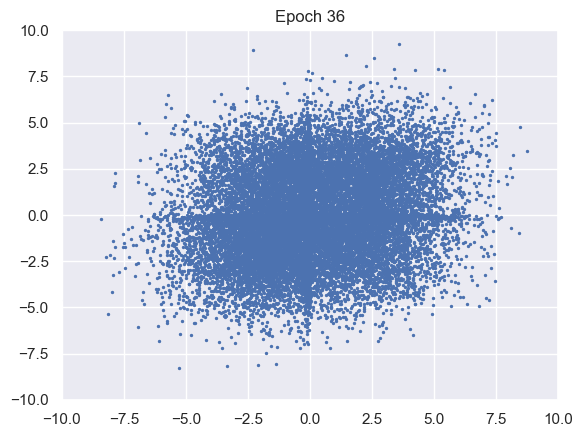

100%|██████████| 976/976 [00:10<00:00, 92.54it/s]


D loss : 1.0205, GP_loss : 0 G_loss : -0.7045, MI : 4.3661


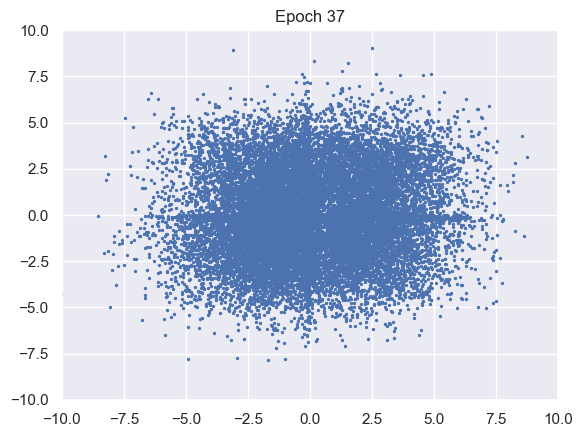

100%|██████████| 976/976 [00:10<00:00, 93.36it/s]


D loss : 1.0204, GP_loss : 0 G_loss : -0.7055, MI : 4.6726


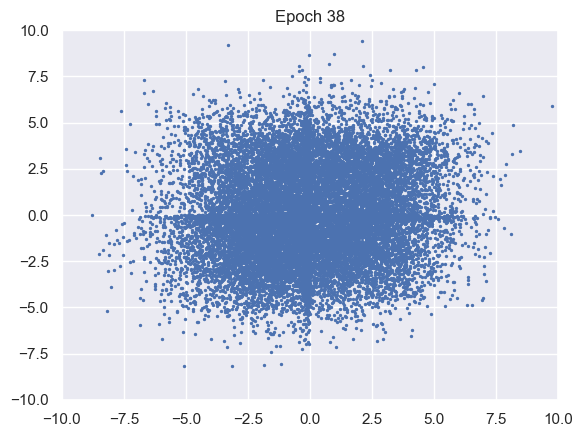

100%|██████████| 976/976 [00:10<00:00, 93.42it/s]


D loss : 1.0175, GP_loss : 0 G_loss : -0.7066, MI : 4.365


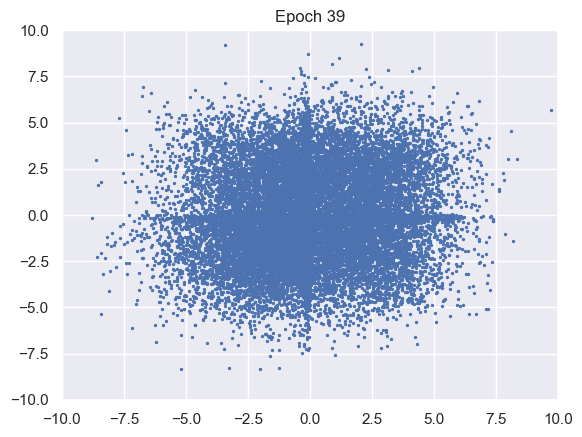

100%|██████████| 976/976 [00:10<00:00, 92.43it/s]


D loss : 1.0178, GP_loss : 0 G_loss : -0.7079, MI : 4.1467


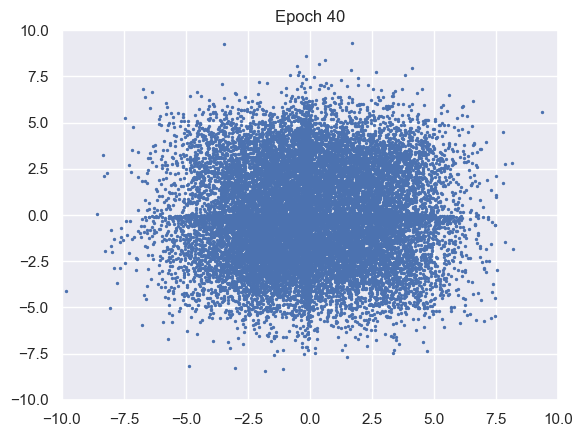

100%|██████████| 976/976 [00:10<00:00, 90.59it/s]


D loss : 1.0184, GP_loss : 0 G_loss : -0.7117, MI : 3.9326


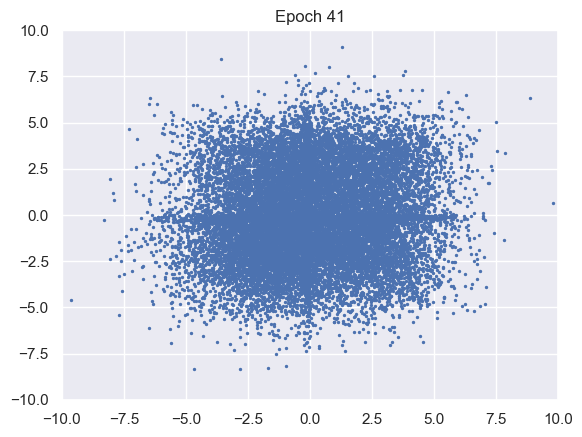

100%|██████████| 976/976 [00:10<00:00, 92.58it/s]


D loss : 1.0206, GP_loss : 0 G_loss : -0.7114, MI : 4.4565


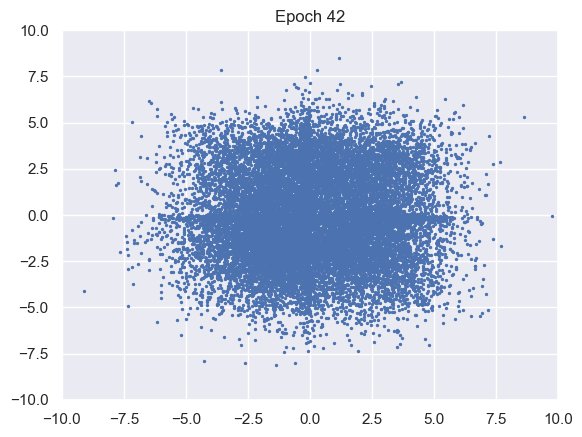

100%|██████████| 976/976 [00:10<00:00, 93.81it/s]


D loss : 1.0235, GP_loss : 0 G_loss : -0.715, MI : 4.2542


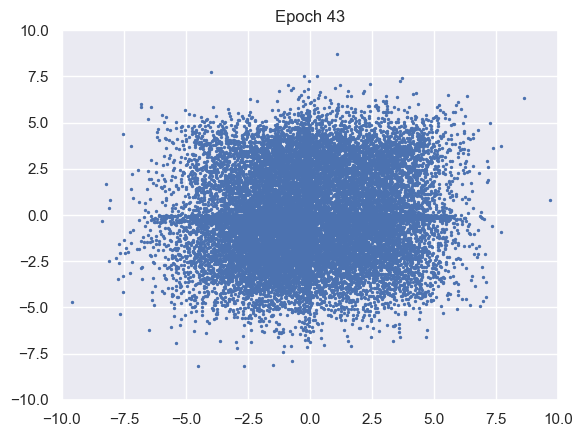

100%|██████████| 976/976 [00:10<00:00, 93.95it/s]


D loss : 1.0296, GP_loss : 0 G_loss : -0.718, MI : 4.2803


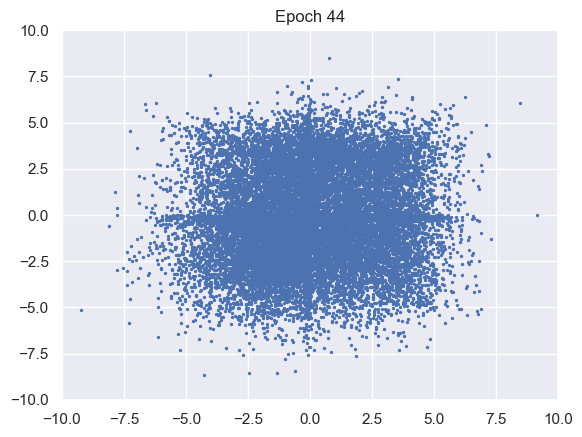

100%|██████████| 976/976 [00:10<00:00, 94.19it/s]


D loss : 1.0361, GP_loss : 0 G_loss : -0.7263, MI : 4.3898


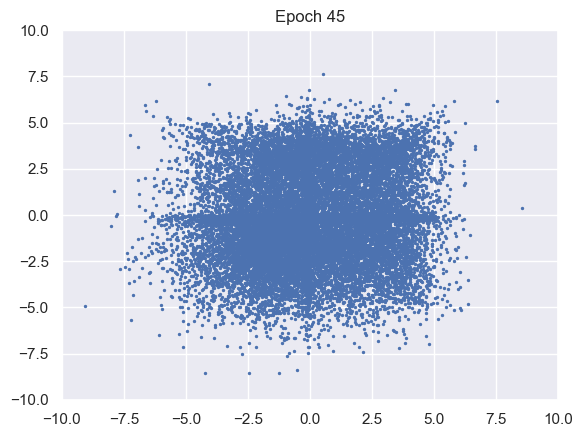

100%|██████████| 976/976 [00:10<00:00, 92.89it/s]


D loss : 1.0449, GP_loss : 0 G_loss : -0.7363, MI : 4.1567


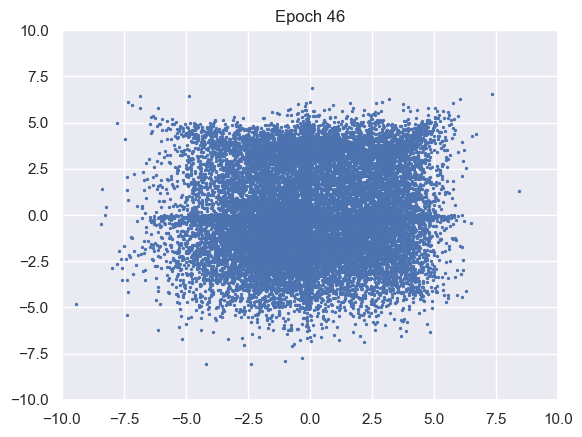

100%|██████████| 976/976 [00:10<00:00, 92.63it/s]


D loss : 1.0589, GP_loss : 0 G_loss : -0.748, MI : 4.1128


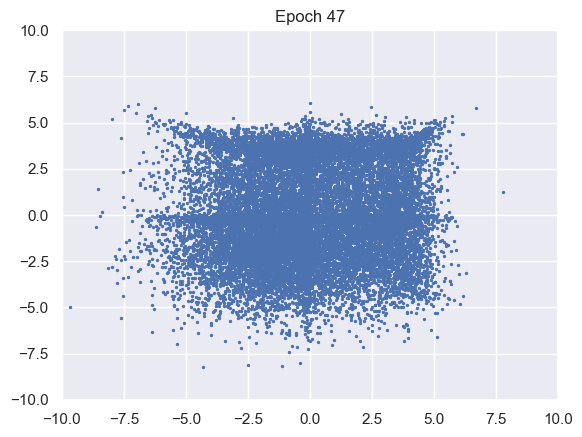

100%|██████████| 976/976 [00:10<00:00, 93.79it/s]


D loss : 1.0763, GP_loss : 0 G_loss : -0.7621, MI : 4.1343


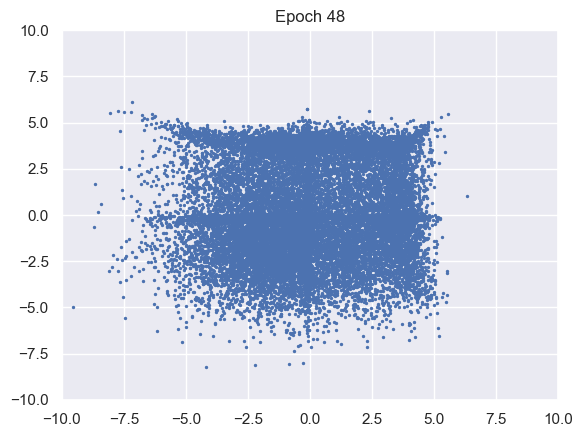

100%|██████████| 976/976 [00:10<00:00, 93.92it/s]


D loss : 1.0989, GP_loss : 0 G_loss : -0.7771, MI : 3.6403


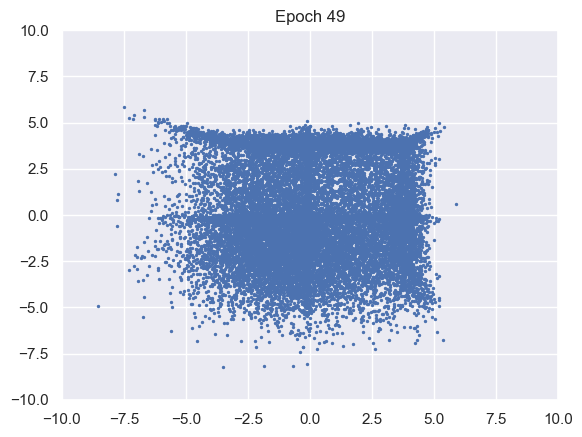

100%|██████████| 976/976 [00:10<00:00, 93.81it/s]


D loss : 1.1181, GP_loss : 0 G_loss : -0.7863, MI : 3.9241


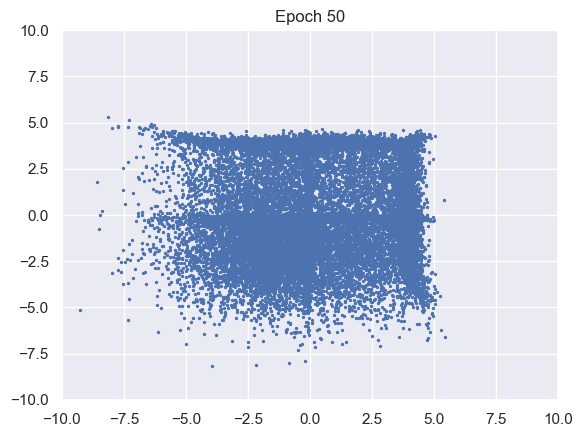

100%|██████████| 976/976 [00:10<00:00, 94.00it/s]


D loss : 1.1343, GP_loss : 0 G_loss : -0.7923, MI : 3.9291


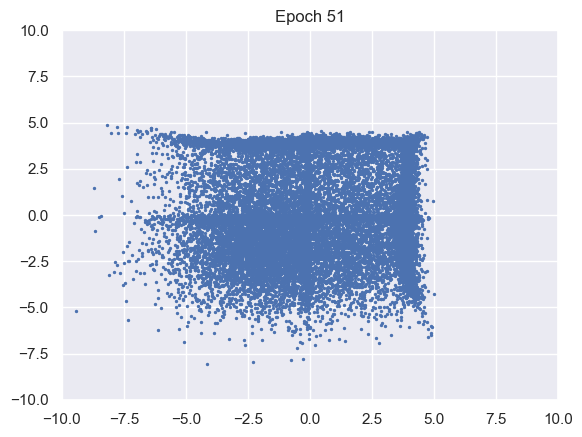

100%|██████████| 976/976 [00:10<00:00, 94.10it/s]


D loss : 1.1362, GP_loss : 0 G_loss : -0.8089, MI : 3.9144


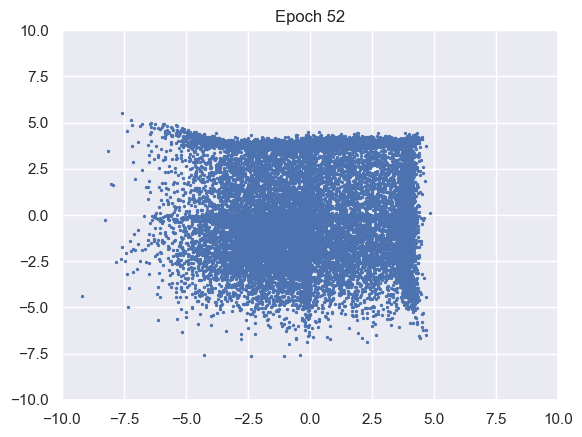

100%|██████████| 976/976 [00:10<00:00, 94.49it/s]


D loss : 1.1291, GP_loss : 0 G_loss : -0.8197, MI : 3.9301


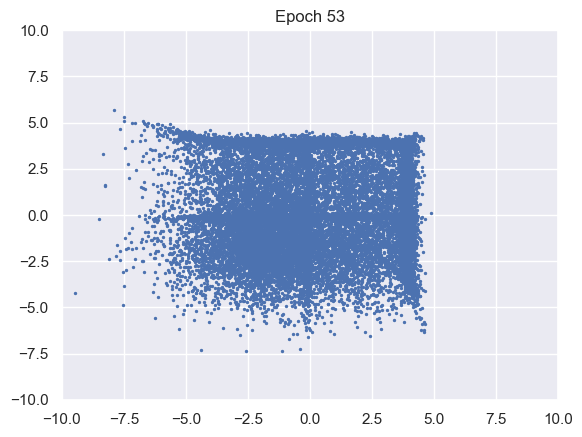

100%|██████████| 976/976 [00:10<00:00, 93.73it/s]


D loss : 1.13, GP_loss : 0 G_loss : -0.8136, MI : 4.0426


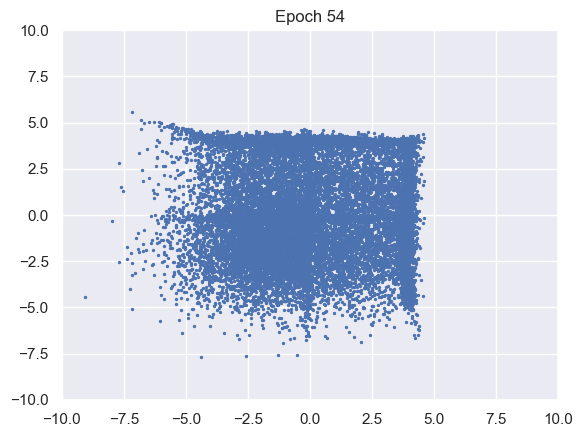

100%|██████████| 976/976 [00:10<00:00, 92.66it/s]


D loss : 1.1317, GP_loss : 0 G_loss : -0.8057, MI : 3.8441


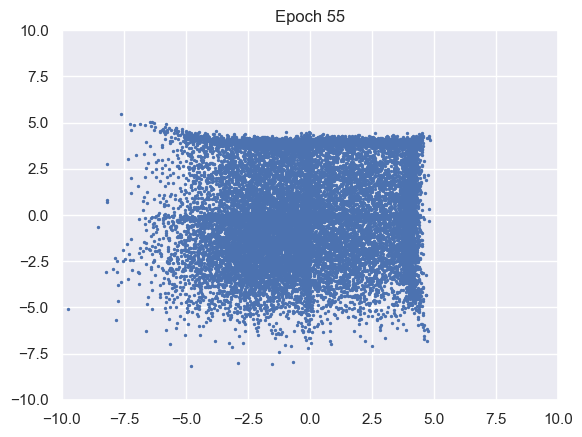

100%|██████████| 976/976 [00:10<00:00, 94.36it/s]


D loss : 1.1334, GP_loss : 0 G_loss : -0.7998, MI : 4.0436


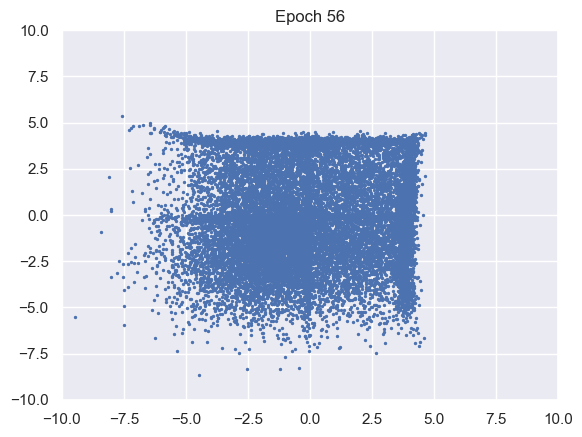

100%|██████████| 976/976 [00:10<00:00, 94.28it/s]


D loss : 1.1361, GP_loss : 0 G_loss : -0.7958, MI : 3.7766


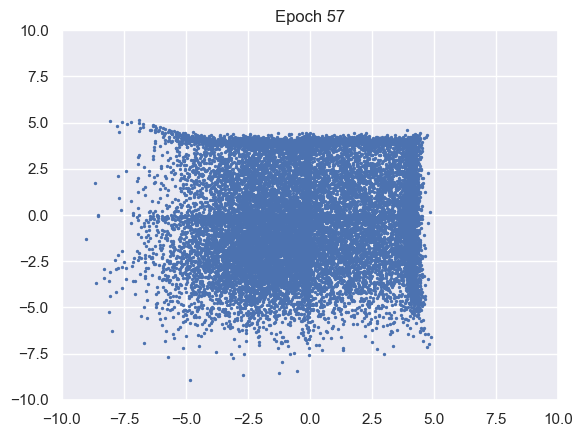

100%|██████████| 976/976 [00:10<00:00, 93.82it/s]


D loss : 1.137, GP_loss : 0 G_loss : -0.7934, MI : 4.0726


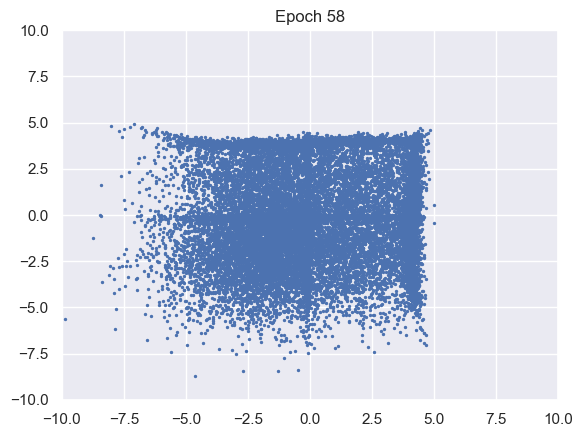

100%|██████████| 976/976 [00:10<00:00, 93.01it/s]


D loss : 1.1355, GP_loss : 0 G_loss : -0.7928, MI : 4.183


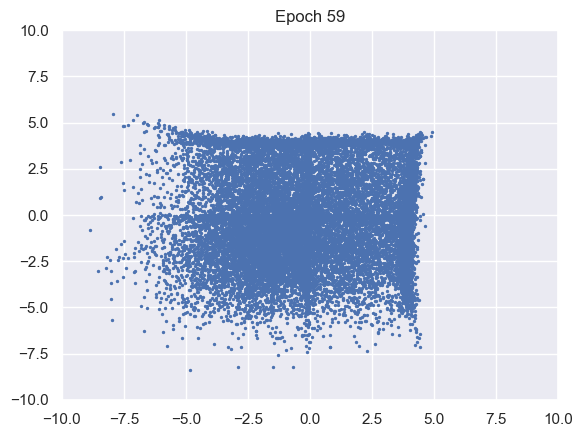

100%|██████████| 976/976 [00:10<00:00, 92.93it/s]


D loss : 1.1355, GP_loss : 0 G_loss : -0.7941, MI : 3.561


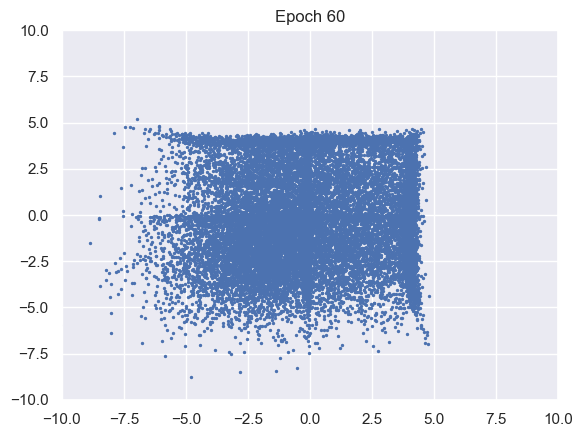

100%|██████████| 976/976 [00:10<00:00, 92.80it/s]


D loss : 1.1357, GP_loss : 0 G_loss : -0.7927, MI : 4.3226


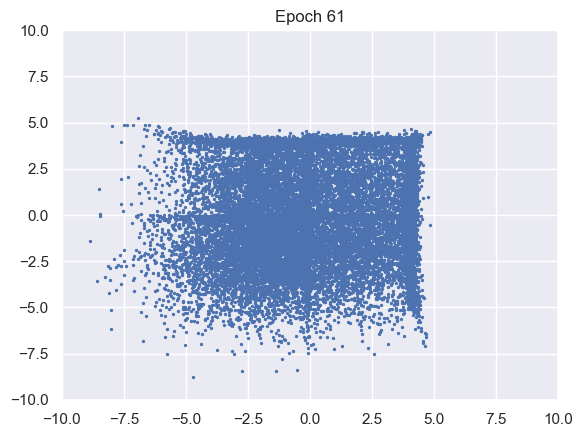

100%|██████████| 976/976 [00:10<00:00, 92.54it/s]


D loss : 1.1379, GP_loss : 0 G_loss : -0.7932, MI : 3.9529


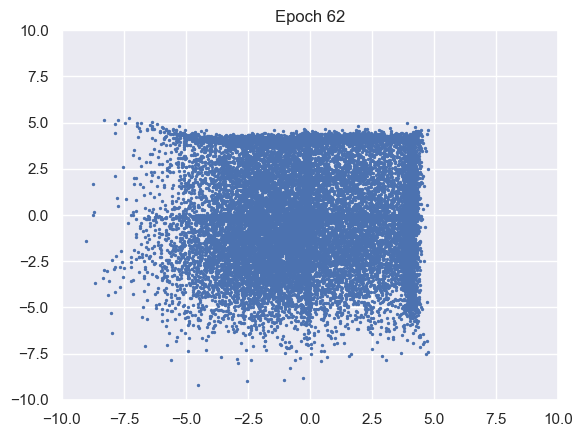

100%|██████████| 976/976 [00:10<00:00, 92.95it/s]


D loss : 1.1387, GP_loss : 0 G_loss : -0.7926, MI : 2.8255


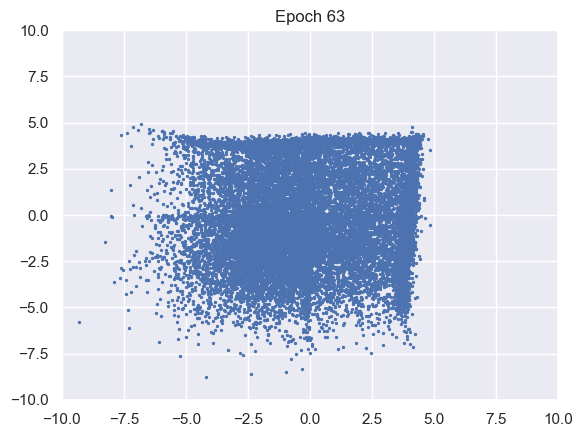

100%|██████████| 976/976 [00:10<00:00, 91.94it/s]


D loss : 1.1415, GP_loss : 0 G_loss : -0.7942, MI : 4.0288


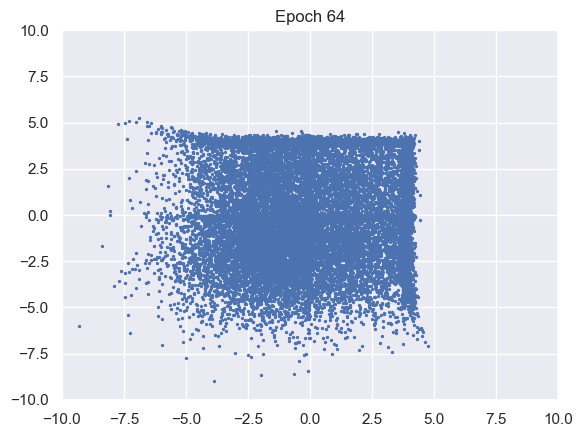

100%|██████████| 976/976 [00:10<00:00, 91.85it/s]


D loss : 1.1417, GP_loss : 0 G_loss : -0.7917, MI : 4.2632


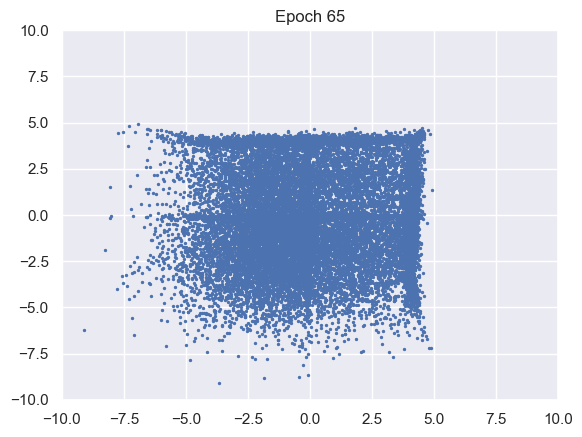

100%|██████████| 976/976 [00:10<00:00, 91.34it/s]


D loss : 1.1417, GP_loss : 0 G_loss : -0.793, MI : 4.1506


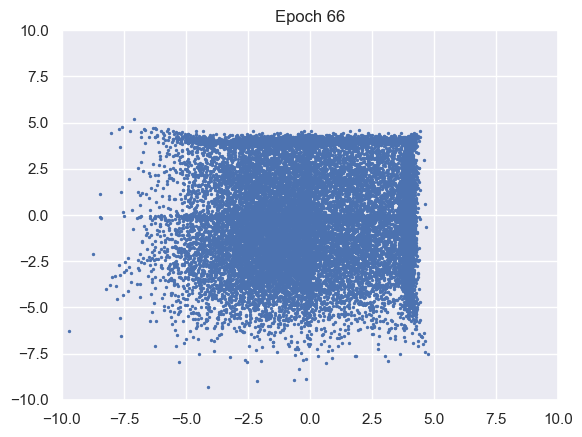

100%|██████████| 976/976 [00:10<00:00, 92.40it/s]


D loss : 1.1422, GP_loss : 0 G_loss : -0.7919, MI : 3.8162


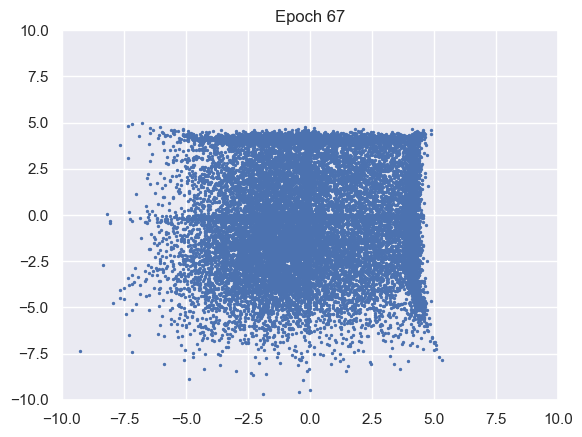

100%|██████████| 976/976 [00:10<00:00, 88.74it/s]


D loss : 1.1378, GP_loss : 0 G_loss : -0.7906, MI : 4.21


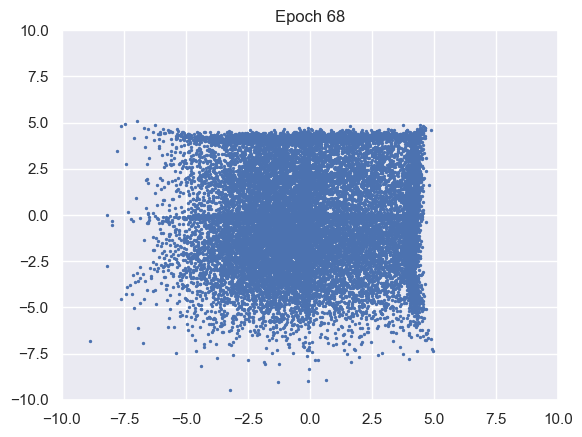

100%|██████████| 976/976 [00:10<00:00, 89.00it/s]


D loss : 1.137, GP_loss : 0 G_loss : -0.7936, MI : 4.1676


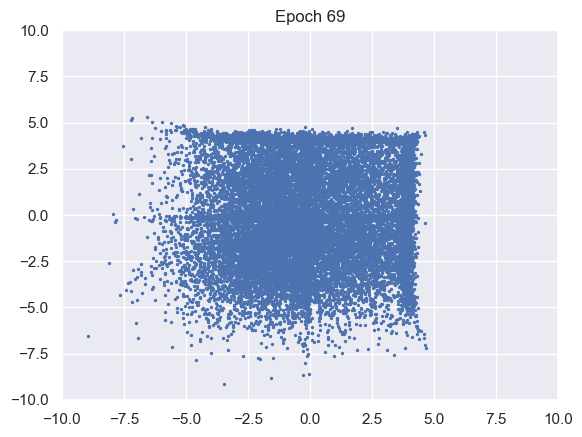

100%|██████████| 976/976 [00:10<00:00, 91.49it/s]


D loss : 1.1365, GP_loss : 0 G_loss : -0.7947, MI : 4.4201


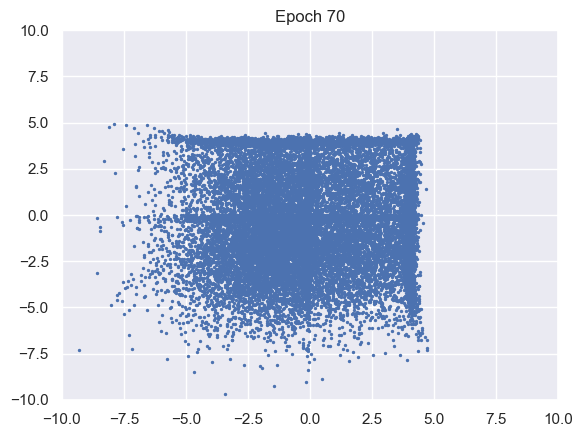

100%|██████████| 976/976 [00:10<00:00, 90.71it/s]


D loss : 1.1362, GP_loss : 0 G_loss : -0.7932, MI : 4.2364


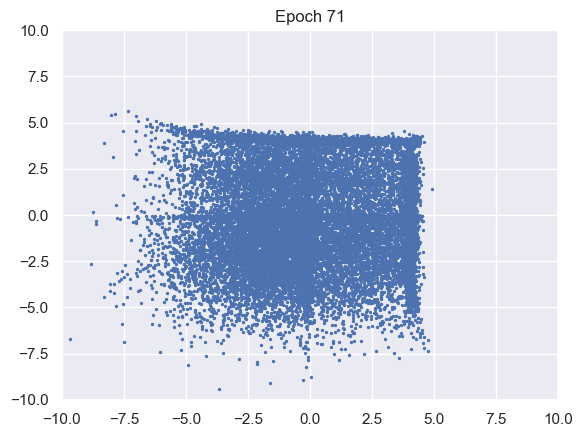

100%|██████████| 976/976 [00:10<00:00, 89.65it/s]


D loss : 1.1348, GP_loss : 0 G_loss : -0.7948, MI : 4.0634


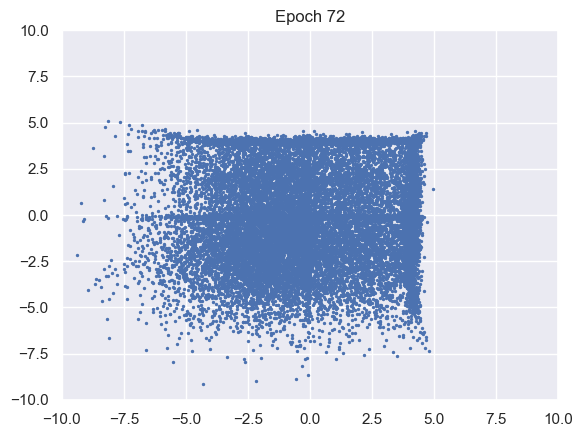

100%|██████████| 976/976 [00:10<00:00, 90.44it/s]


D loss : 1.1341, GP_loss : 0 G_loss : -0.7951, MI : 3.8498


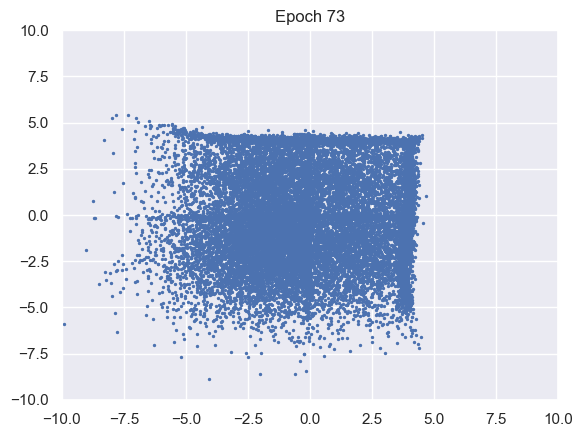

100%|██████████| 976/976 [00:11<00:00, 88.69it/s]


D loss : 1.1329, GP_loss : 0 G_loss : -0.7971, MI : 4.0996


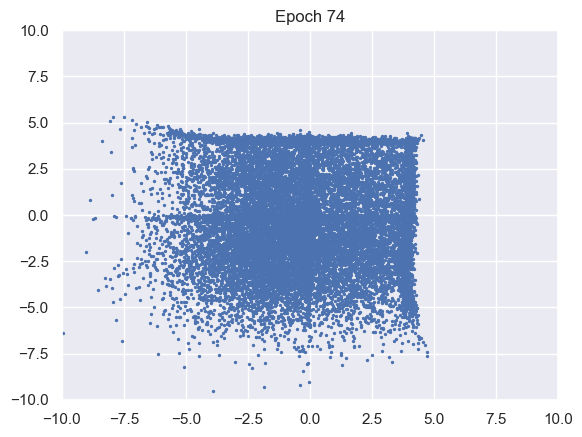

100%|██████████| 976/976 [00:10<00:00, 89.78it/s]


D loss : 1.1326, GP_loss : 0 G_loss : -0.8047, MI : 3.7484


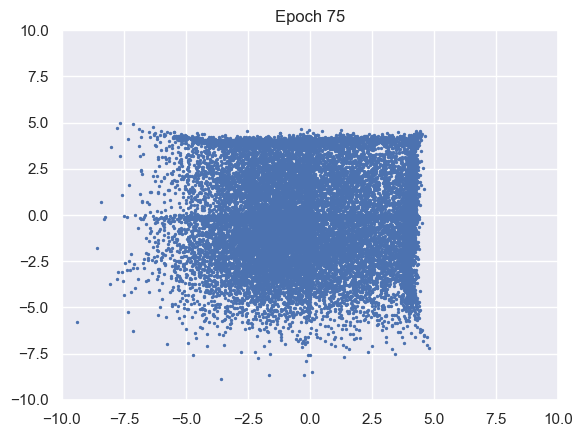

100%|██████████| 976/976 [00:10<00:00, 90.60it/s]


D loss : 1.1364, GP_loss : 0 G_loss : -0.8012, MI : 4.4833


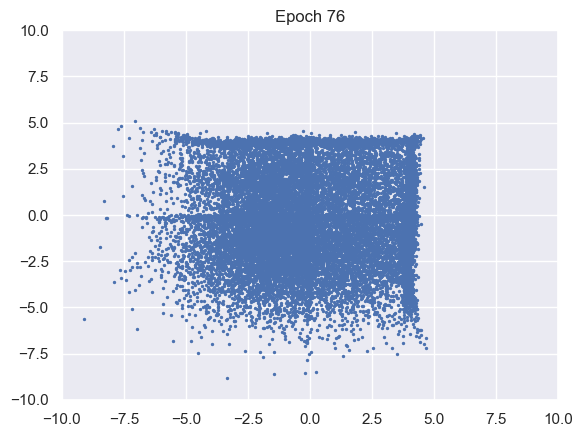

100%|██████████| 976/976 [00:10<00:00, 91.21it/s]


D loss : 1.1345, GP_loss : 0 G_loss : -0.8003, MI : 4.5541


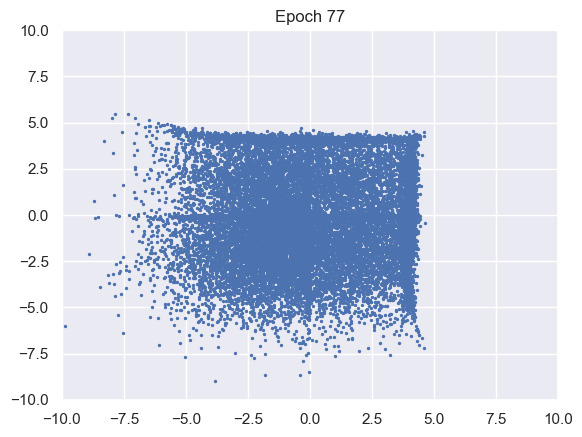

100%|██████████| 976/976 [00:10<00:00, 91.07it/s]


D loss : 1.1308, GP_loss : 0 G_loss : -0.8032, MI : 3.6291


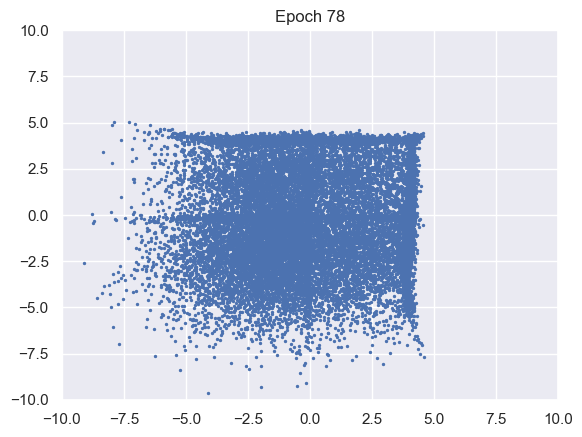

100%|██████████| 976/976 [00:10<00:00, 91.34it/s]


D loss : 1.1259, GP_loss : 0 G_loss : -0.8015, MI : 4.5626


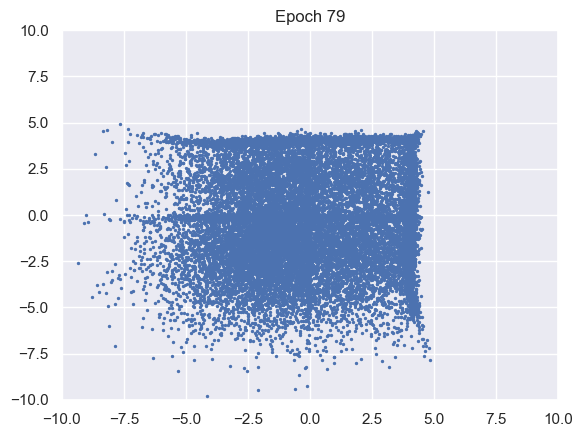

100%|██████████| 976/976 [00:10<00:00, 91.46it/s]


D loss : 1.122, GP_loss : 0 G_loss : -0.8024, MI : 3.8694


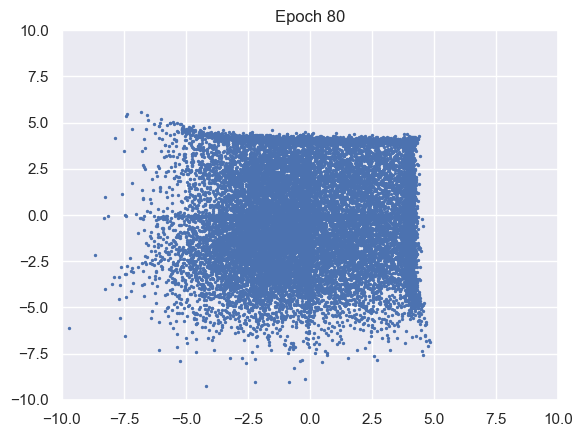

100%|██████████| 976/976 [00:10<00:00, 92.38it/s]


D loss : 1.1211, GP_loss : 0 G_loss : -0.8044, MI : 4.6153


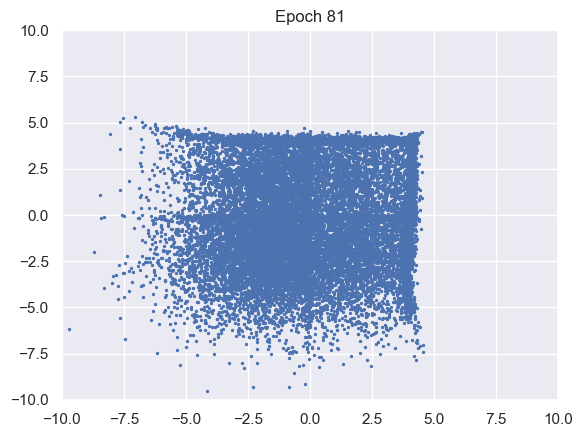

100%|██████████| 976/976 [00:10<00:00, 92.55it/s]


D loss : 1.1167, GP_loss : 0 G_loss : -0.8053, MI : 3.8627


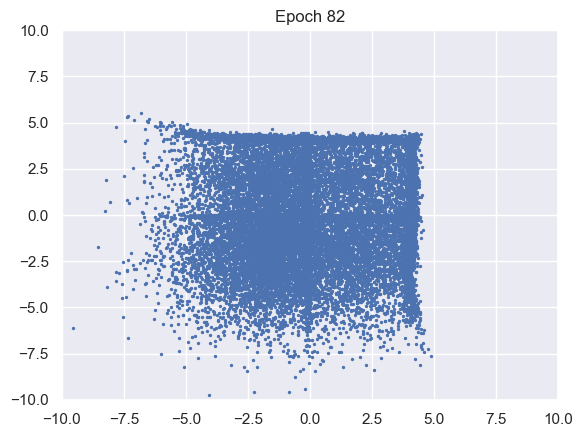

100%|██████████| 976/976 [00:10<00:00, 91.12it/s]


D loss : 1.1161, GP_loss : 0 G_loss : -0.8062, MI : 4.186


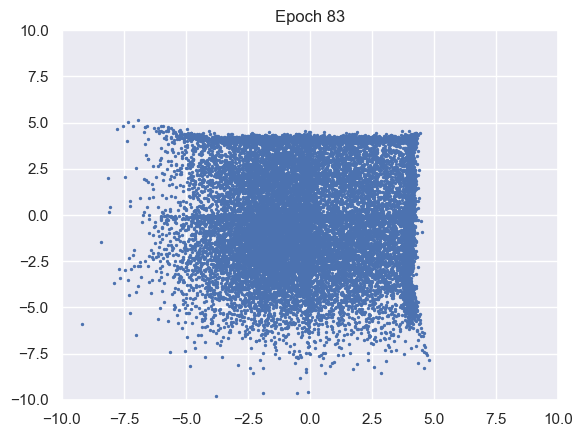

100%|██████████| 976/976 [00:10<00:00, 91.80it/s]


D loss : 1.1153, GP_loss : 0 G_loss : -0.8047, MI : 4.4372


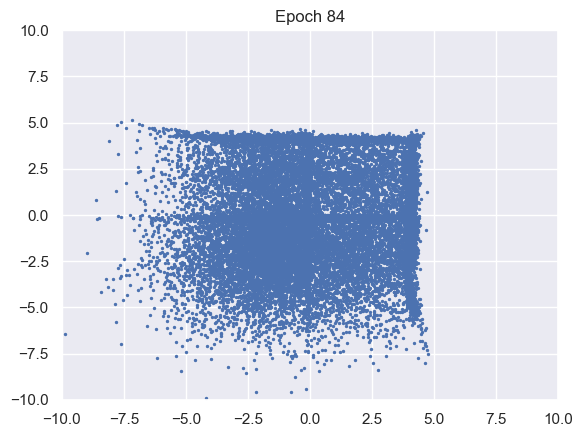

100%|██████████| 976/976 [00:10<00:00, 90.94it/s]


D loss : 1.1128, GP_loss : 0 G_loss : -0.8062, MI : 4.3971


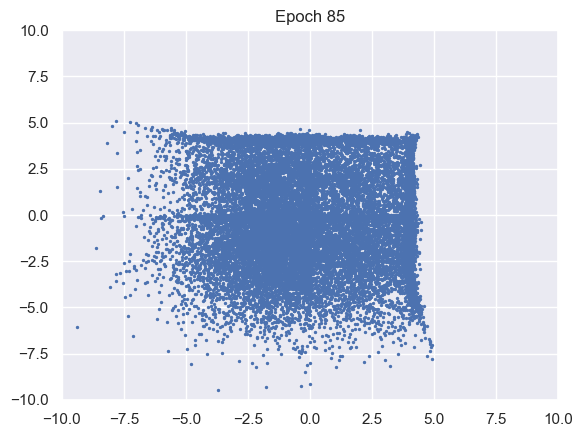

100%|██████████| 976/976 [00:10<00:00, 90.43it/s]


D loss : 1.1097, GP_loss : 0 G_loss : -0.8095, MI : 3.6809


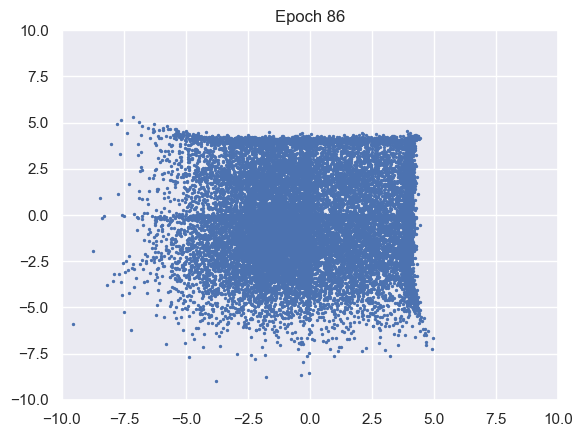

100%|██████████| 976/976 [00:10<00:00, 91.28it/s]


D loss : 1.111, GP_loss : 0 G_loss : -0.8105, MI : 4.7081


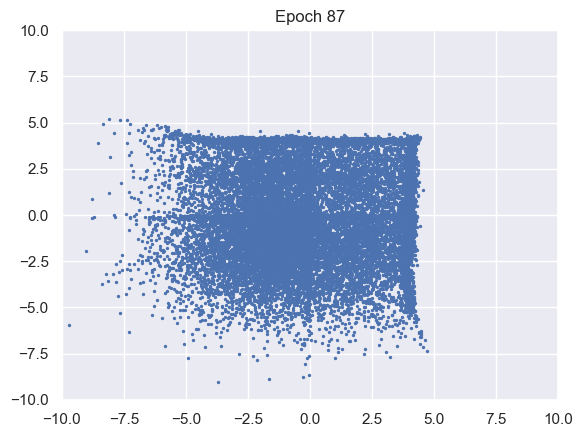

100%|██████████| 976/976 [00:10<00:00, 91.79it/s]


D loss : 1.108, GP_loss : 0 G_loss : -0.8113, MI : 4.3901


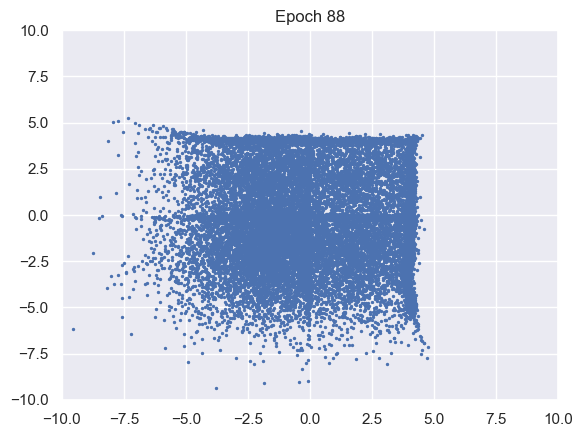

100%|██████████| 976/976 [00:10<00:00, 91.49it/s]


D loss : 1.1055, GP_loss : 0 G_loss : -0.8121, MI : 4.45


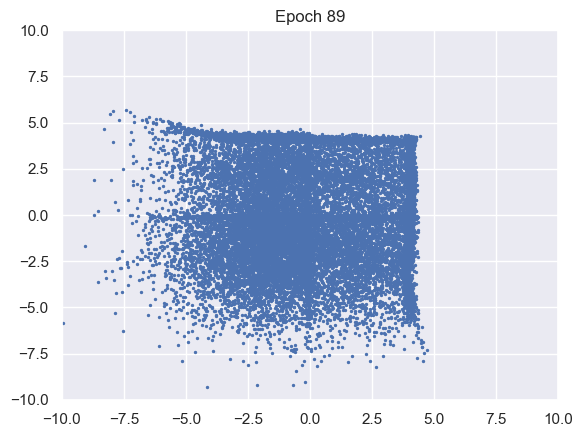

100%|██████████| 976/976 [00:10<00:00, 91.16it/s]


D loss : 1.104, GP_loss : 0 G_loss : -0.8134, MI : 4.5172


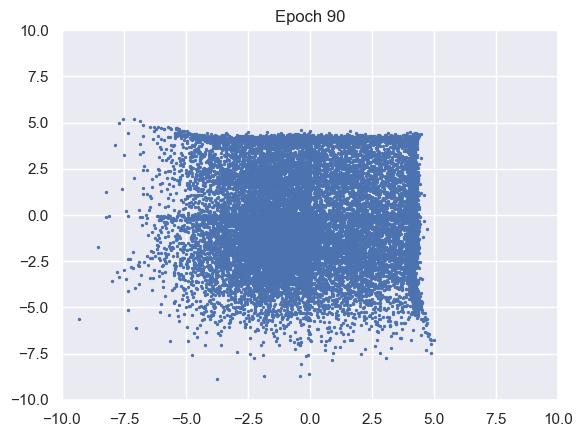

100%|██████████| 976/976 [00:10<00:00, 91.75it/s]


D loss : 1.1006, GP_loss : 0 G_loss : -0.8133, MI : 4.5709


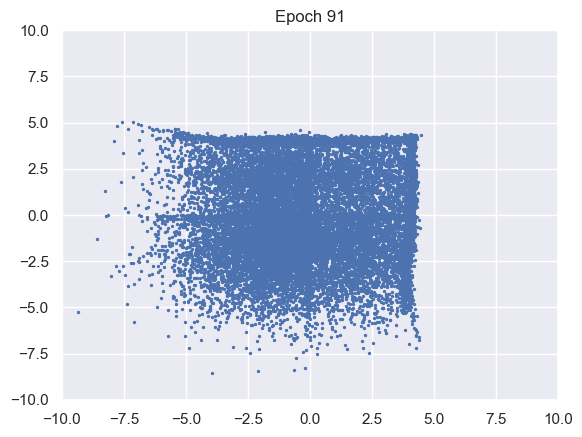

100%|██████████| 976/976 [00:10<00:00, 91.54it/s]


D loss : 1.0969, GP_loss : 0 G_loss : -0.8154, MI : 4.3509


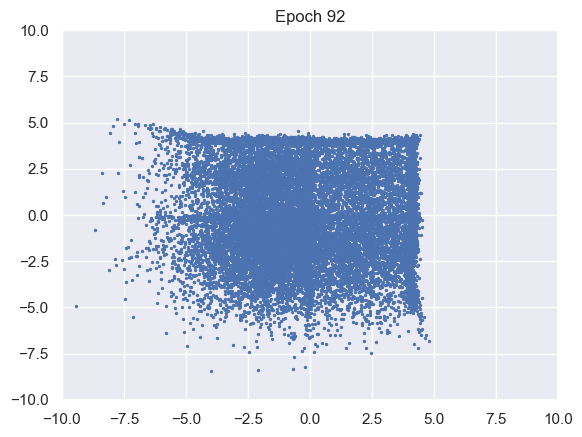

100%|██████████| 976/976 [00:10<00:00, 93.01it/s]


D loss : 1.0973, GP_loss : 0 G_loss : -0.8152, MI : 4.4463


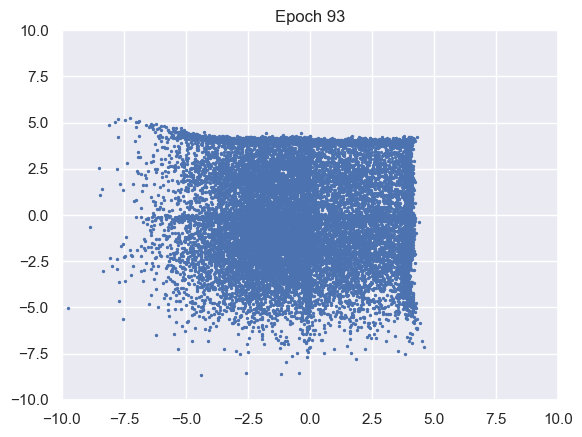

100%|██████████| 976/976 [00:10<00:00, 92.31it/s]


D loss : 1.0928, GP_loss : 0 G_loss : -0.8168, MI : 4.4001


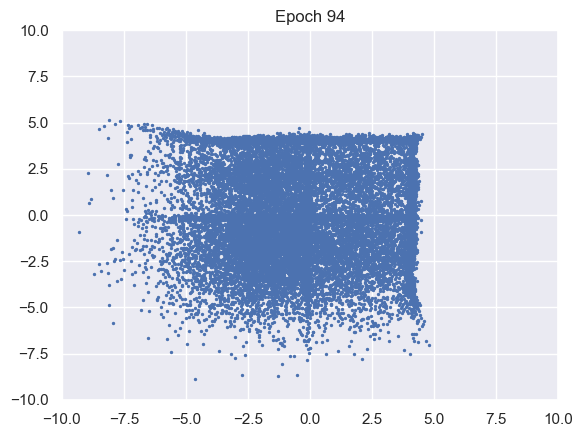

100%|██████████| 976/976 [00:10<00:00, 93.33it/s]


D loss : 1.0893, GP_loss : 0 G_loss : -0.8163, MI : 4.2762


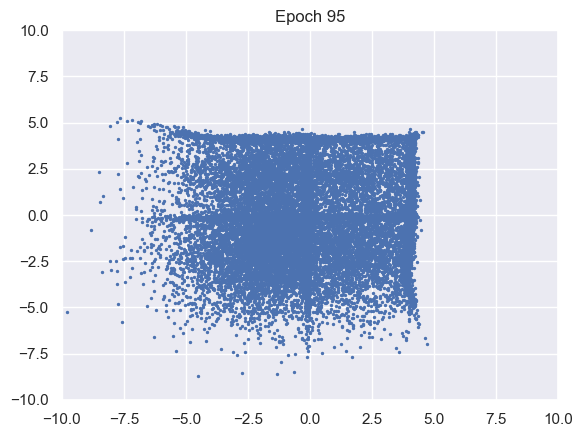

100%|██████████| 976/976 [00:10<00:00, 92.52it/s]


D loss : 1.0878, GP_loss : 0 G_loss : -0.8185, MI : 4.7233


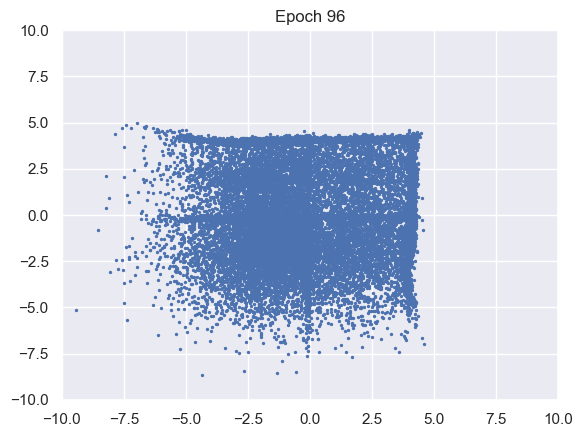

100%|██████████| 976/976 [00:10<00:00, 92.66it/s]


D loss : 1.0873, GP_loss : 0 G_loss : -0.8206, MI : 4.4615


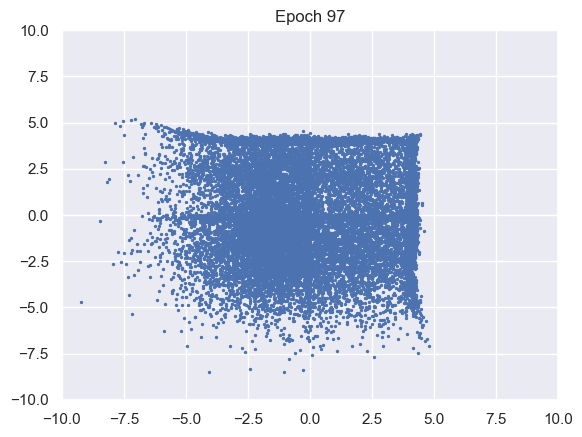

100%|██████████| 976/976 [00:10<00:00, 93.48it/s]


D loss : 1.0883, GP_loss : 0 G_loss : -0.8207, MI : 4.3855


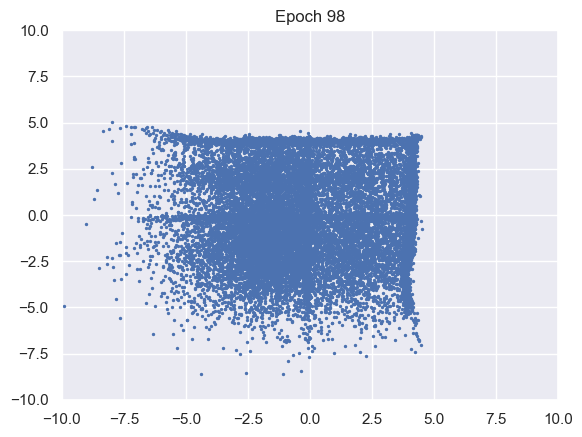

100%|██████████| 976/976 [00:10<00:00, 92.58it/s]


D loss : 1.0855, GP_loss : 0 G_loss : -0.8212, MI : 4.3923


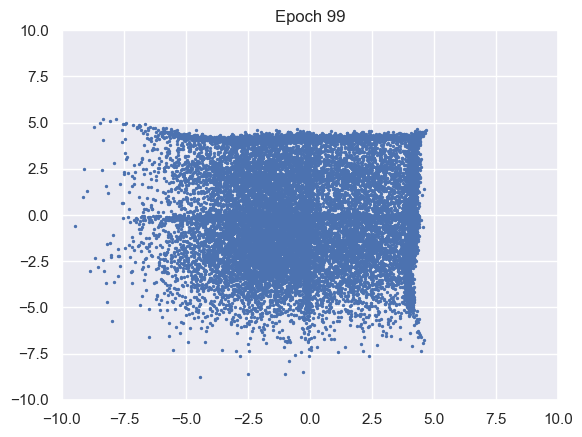

100%|██████████| 976/976 [00:10<00:00, 92.68it/s]


D loss : 1.0864, GP_loss : 0 G_loss : -0.821, MI : 2.4131


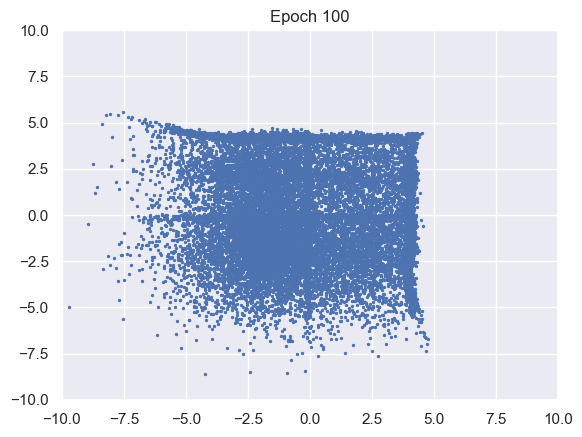

100%|██████████| 976/976 [00:10<00:00, 91.89it/s]


D loss : 1.0861, GP_loss : 0 G_loss : -0.8219, MI : 4.0532


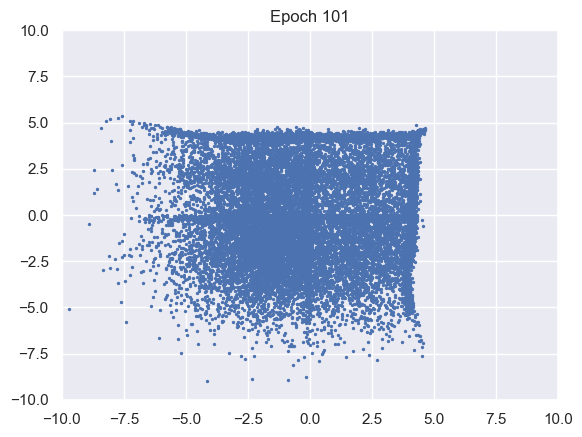

100%|██████████| 976/976 [00:10<00:00, 91.86it/s]


D loss : 1.0854, GP_loss : 0 G_loss : -0.8238, MI : 4.7386


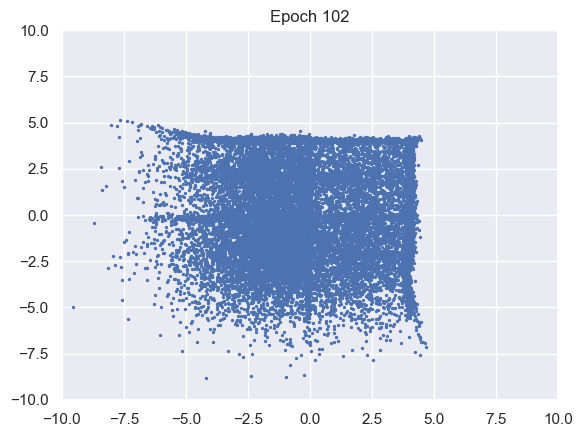

100%|██████████| 976/976 [00:10<00:00, 91.62it/s]


D loss : 1.0847, GP_loss : 0 G_loss : -0.8236, MI : 4.158


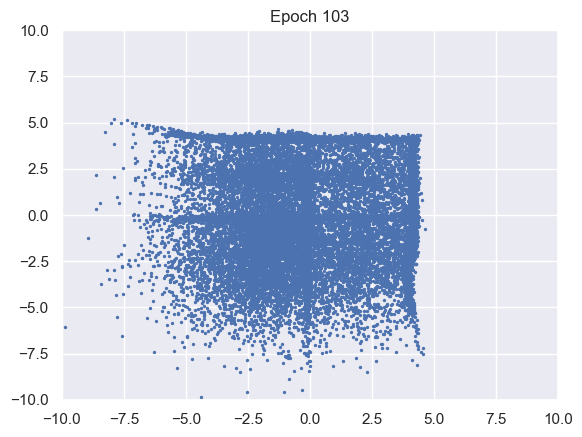

100%|██████████| 976/976 [00:10<00:00, 91.86it/s]


D loss : 1.0835, GP_loss : 0 G_loss : -0.822, MI : 4.5545


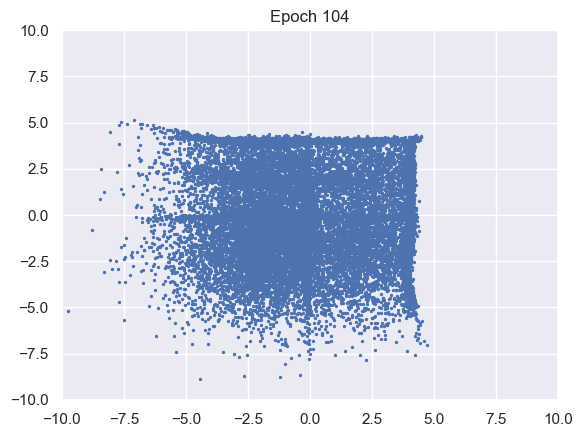

100%|██████████| 976/976 [00:10<00:00, 93.11it/s]


D loss : 1.0829, GP_loss : 0 G_loss : -0.825, MI : 4.4627


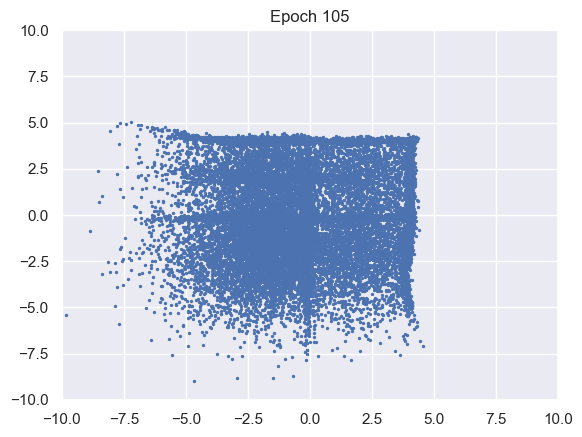

100%|██████████| 976/976 [00:10<00:00, 92.76it/s]


D loss : 1.0834, GP_loss : 0 G_loss : -0.8263, MI : 3.1014


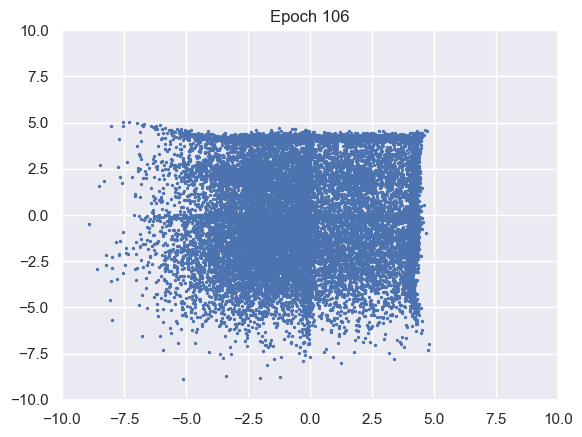

100%|██████████| 976/976 [00:10<00:00, 92.06it/s]


D loss : 1.0835, GP_loss : 0 G_loss : -0.8273, MI : 4.5811


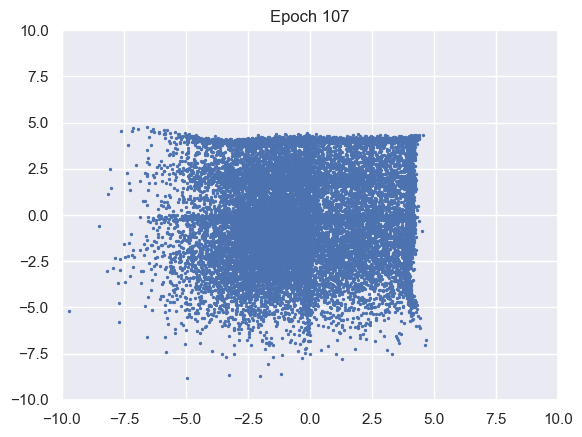

100%|██████████| 976/976 [00:10<00:00, 92.90it/s]


D loss : 1.0833, GP_loss : 0 G_loss : -0.8269, MI : 4.2192


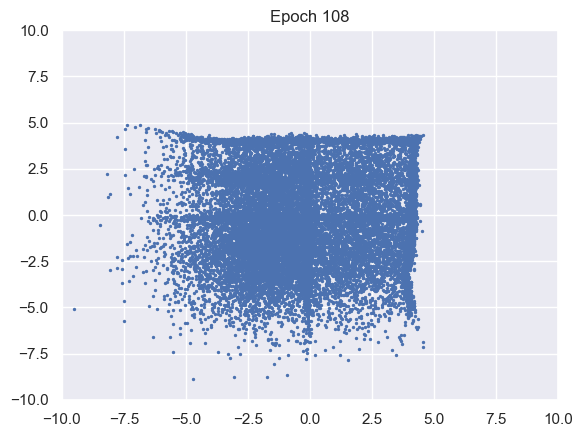

100%|██████████| 976/976 [00:10<00:00, 93.14it/s]


D loss : 1.0856, GP_loss : 0 G_loss : -0.827, MI : 4.4641


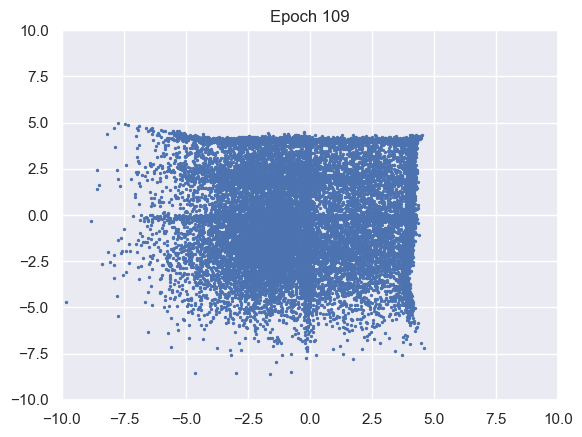

100%|██████████| 976/976 [00:10<00:00, 94.06it/s]


D loss : 1.0855, GP_loss : 0 G_loss : -0.8262, MI : 4.6564


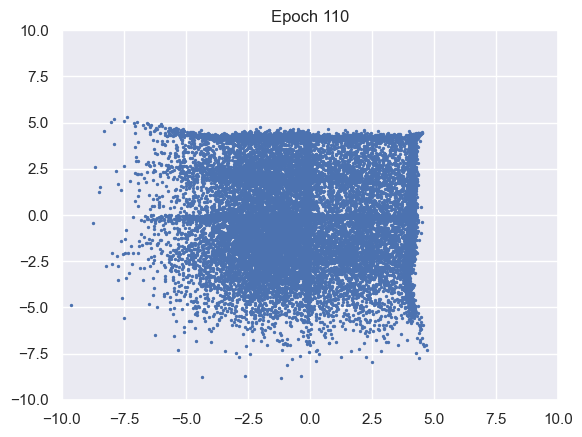

100%|██████████| 976/976 [00:10<00:00, 94.21it/s]


D loss : 1.0865, GP_loss : 0 G_loss : -0.8253, MI : 3.6187


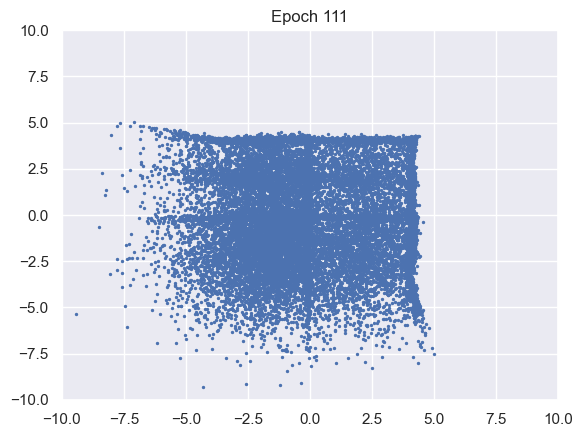

100%|██████████| 976/976 [00:10<00:00, 93.97it/s]


D loss : 1.0855, GP_loss : 0 G_loss : -0.8273, MI : 4.4544


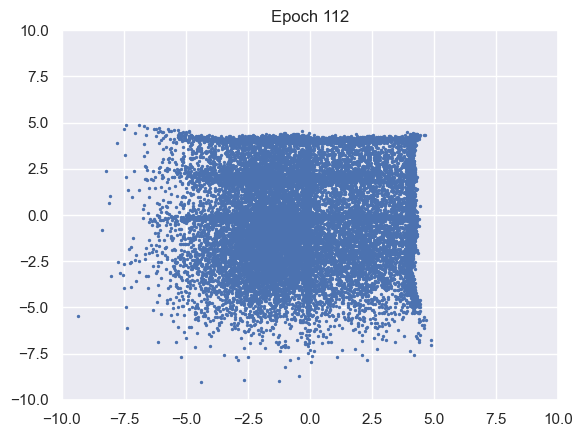

100%|██████████| 976/976 [00:10<00:00, 93.17it/s]


D loss : 1.0858, GP_loss : 0 G_loss : -0.8252, MI : 4.1805


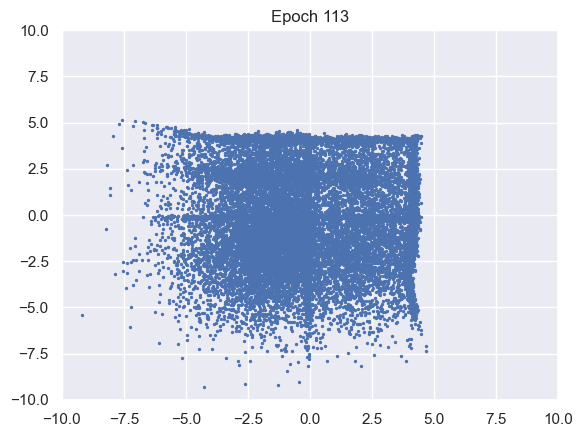

100%|██████████| 976/976 [00:10<00:00, 92.72it/s]


D loss : 1.0873, GP_loss : 0 G_loss : -0.8268, MI : 4.4173


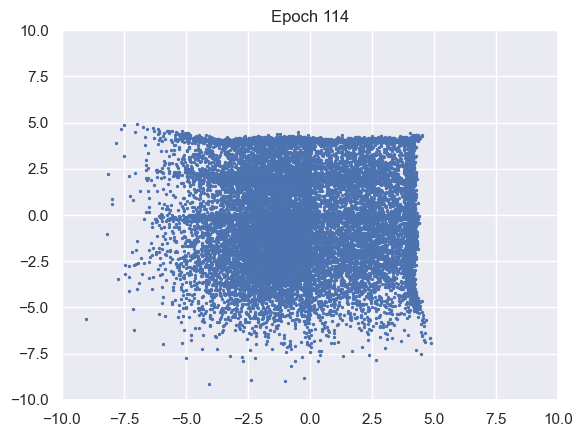

100%|██████████| 976/976 [00:10<00:00, 92.70it/s]


D loss : 1.0859, GP_loss : 0 G_loss : -0.8271, MI : 4.6476


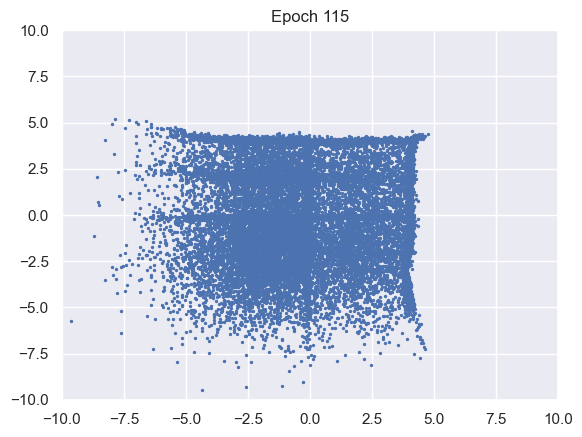

100%|██████████| 976/976 [00:10<00:00, 92.14it/s]


D loss : 1.0854, GP_loss : 0 G_loss : -0.8289, MI : 3.7008


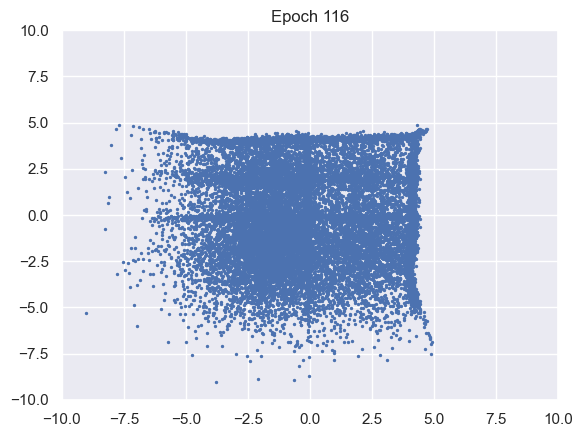

100%|██████████| 976/976 [00:10<00:00, 92.48it/s]


D loss : 1.087, GP_loss : 0 G_loss : -0.8281, MI : 4.7399


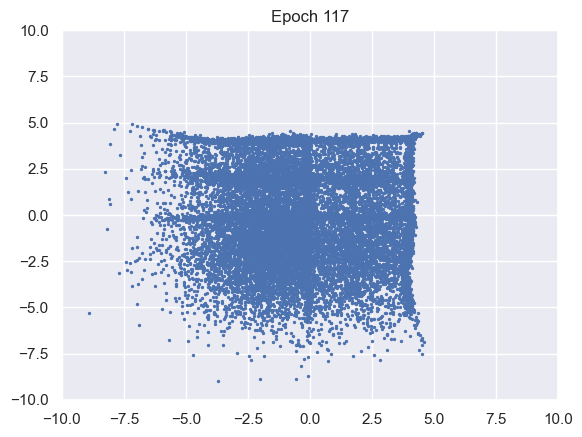

100%|██████████| 976/976 [00:10<00:00, 91.36it/s]


D loss : 1.0893, GP_loss : 0 G_loss : -0.8265, MI : 4.2999


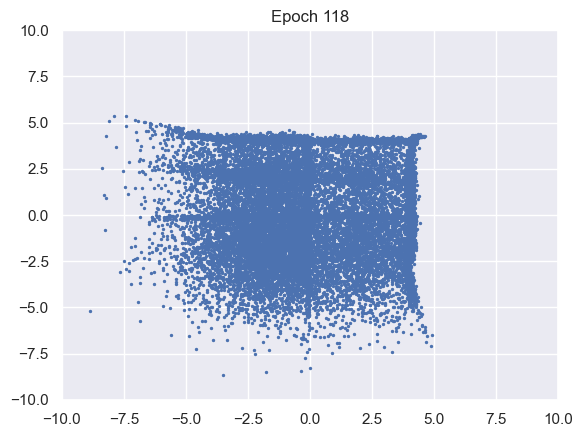

100%|██████████| 976/976 [00:10<00:00, 89.91it/s]


D loss : 1.0923, GP_loss : 0 G_loss : -0.8255, MI : 4.6661


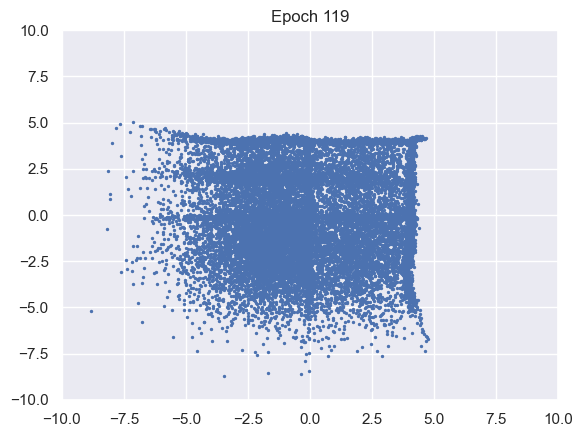

100%|██████████| 976/976 [00:10<00:00, 92.01it/s]


D loss : 1.0939, GP_loss : 0 G_loss : -0.8277, MI : 3.821


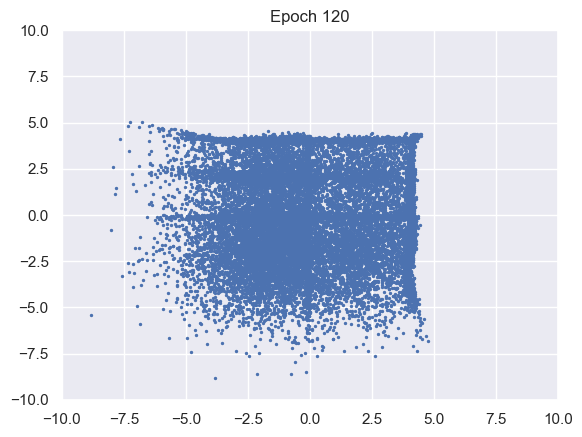

100%|██████████| 976/976 [00:10<00:00, 90.84it/s]


D loss : 1.0973, GP_loss : 0 G_loss : -0.8267, MI : 4.1879


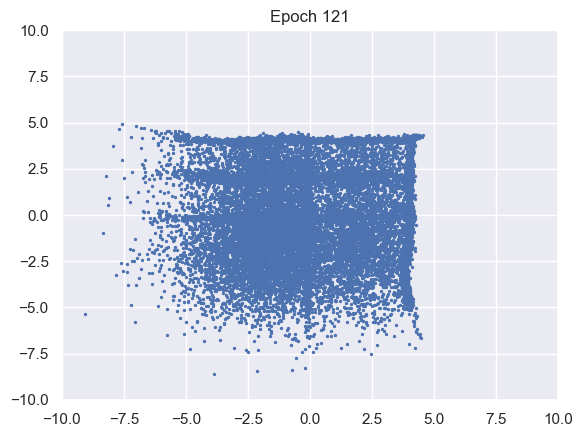

100%|██████████| 976/976 [00:10<00:00, 91.27it/s]


D loss : 1.0977, GP_loss : 0 G_loss : -0.826, MI : 4.4236


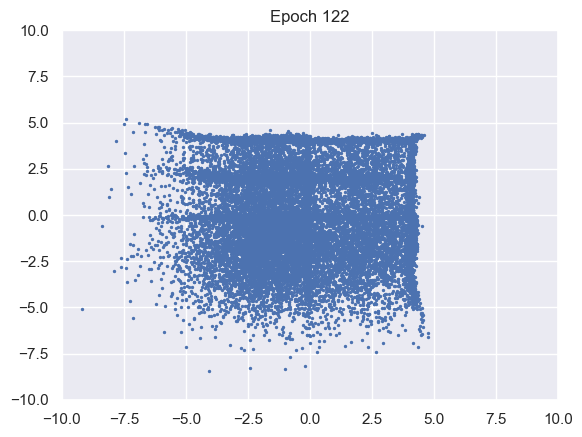

100%|██████████| 976/976 [00:10<00:00, 90.81it/s]


D loss : 1.1001, GP_loss : 0 G_loss : -0.8239, MI : 4.3657


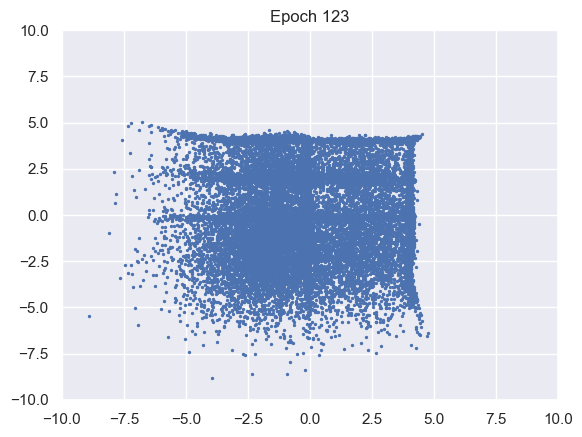

100%|██████████| 976/976 [00:11<00:00, 88.31it/s]


D loss : 1.1019, GP_loss : 0 G_loss : -0.8236, MI : 4.6128


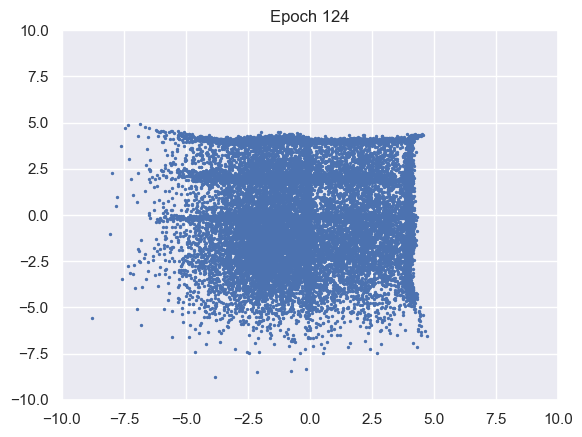

100%|██████████| 976/976 [00:11<00:00, 87.28it/s]


D loss : 1.1045, GP_loss : 0 G_loss : -0.8221, MI : 4.6575


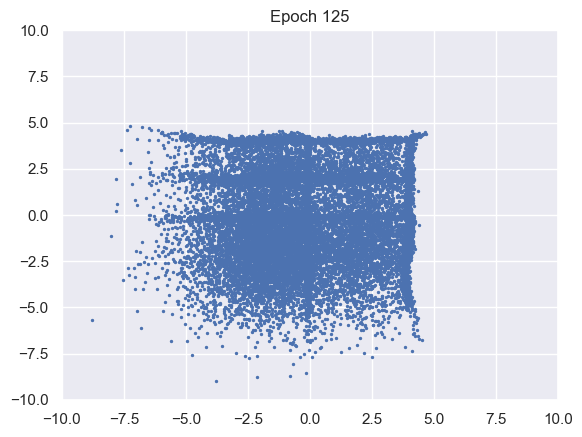

100%|██████████| 976/976 [00:11<00:00, 87.93it/s]


D loss : 1.1056, GP_loss : 0 G_loss : -0.8203, MI : 3.5266


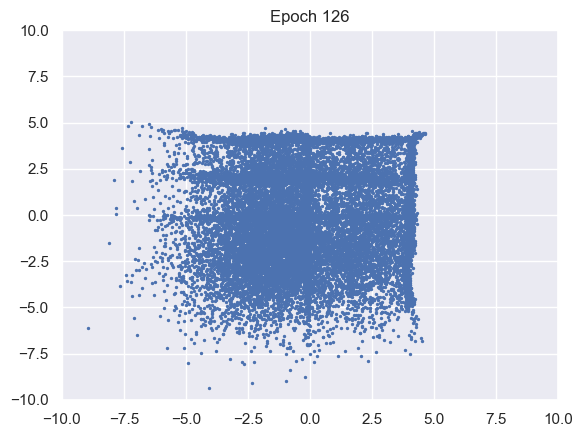

100%|██████████| 976/976 [00:11<00:00, 88.18it/s]


D loss : 1.1069, GP_loss : 0 G_loss : -0.8204, MI : 4.9458


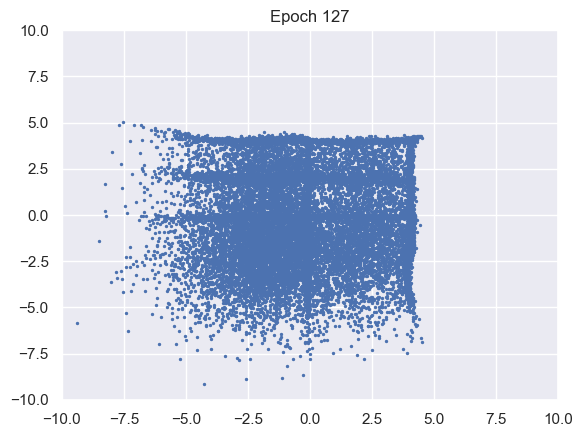

100%|██████████| 976/976 [00:10<00:00, 90.17it/s]


D loss : 1.1087, GP_loss : 0 G_loss : -0.8203, MI : 4.3841


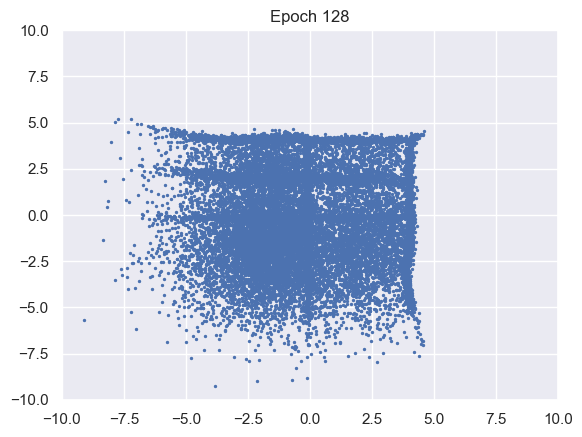

100%|██████████| 976/976 [00:10<00:00, 91.05it/s]


D loss : 1.11, GP_loss : 0 G_loss : -0.8183, MI : 4.5923


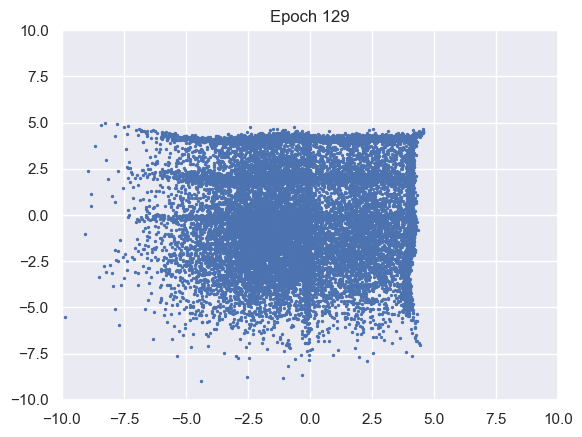

100%|██████████| 976/976 [00:10<00:00, 91.00it/s]


D loss : 1.108, GP_loss : 0 G_loss : -0.8168, MI : 4.2491


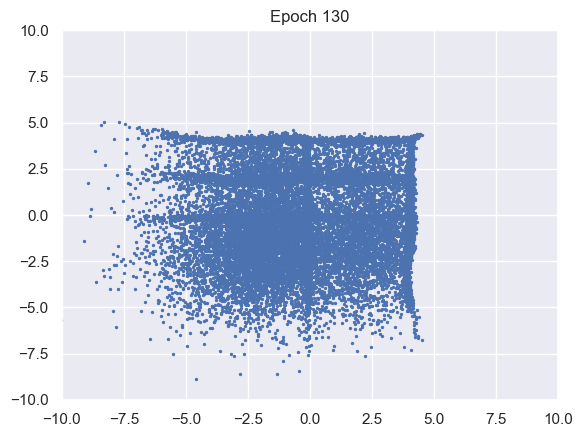

100%|██████████| 976/976 [00:11<00:00, 88.48it/s]


D loss : 1.1091, GP_loss : 0 G_loss : -0.8177, MI : 4.3745


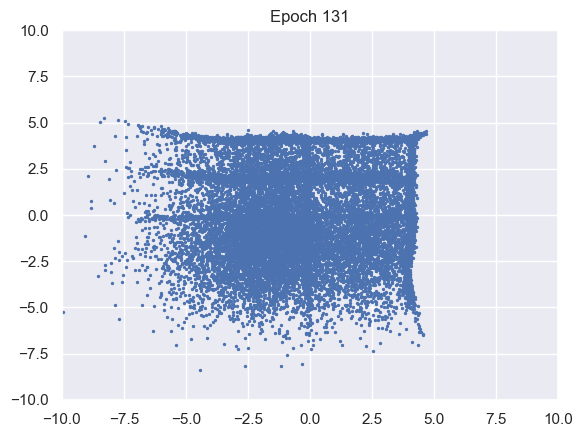

100%|██████████| 976/976 [00:10<00:00, 89.67it/s]


D loss : 1.1113, GP_loss : 0 G_loss : -0.818, MI : 4.5811


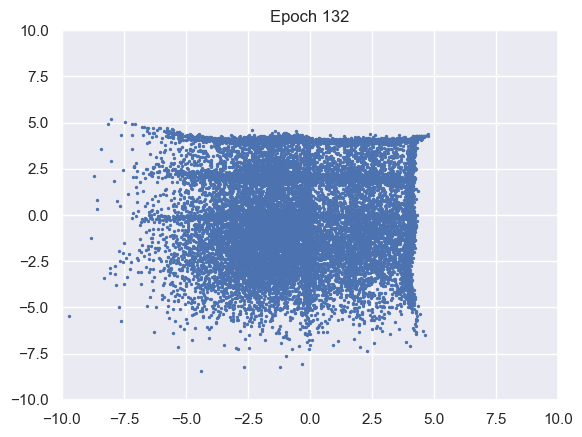

100%|██████████| 976/976 [00:10<00:00, 90.38it/s]


D loss : 1.1147, GP_loss : 0 G_loss : -0.8162, MI : 3.8249


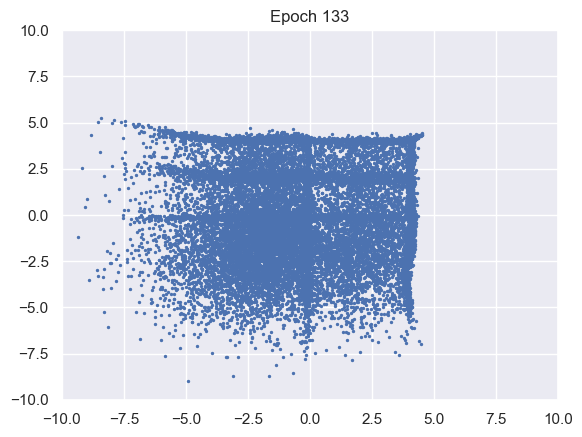

100%|██████████| 976/976 [00:10<00:00, 90.52it/s]


D loss : 1.1168, GP_loss : 0 G_loss : -0.8173, MI : 3.9329


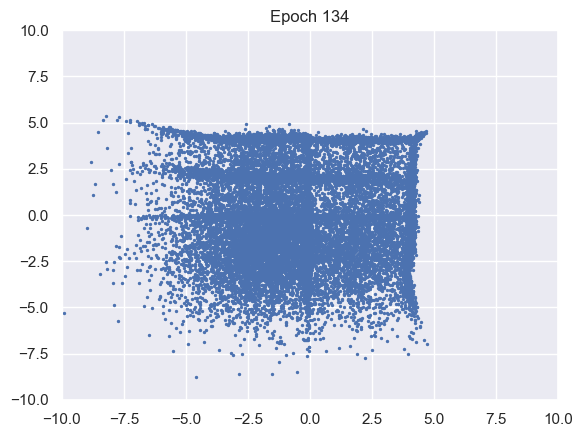

100%|██████████| 976/976 [00:10<00:00, 90.59it/s]


D loss : 1.1192, GP_loss : 0 G_loss : -0.8143, MI : 4.4217


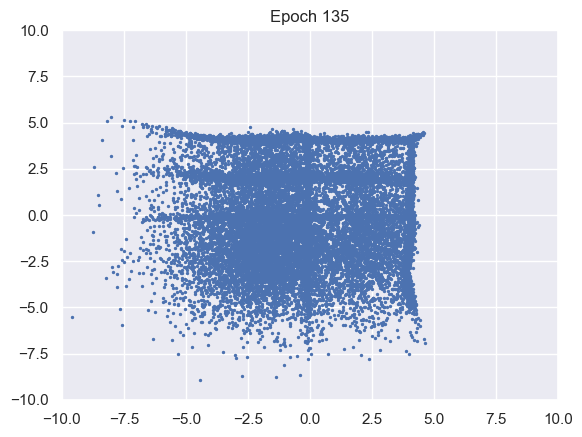

100%|██████████| 976/976 [00:10<00:00, 91.18it/s]


D loss : 1.1182, GP_loss : 0 G_loss : -0.8146, MI : 4.6704


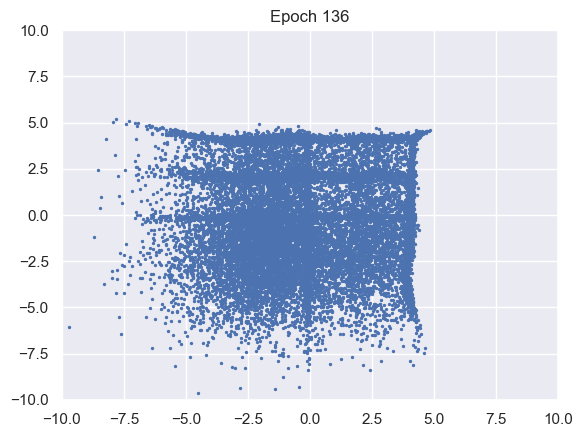

100%|██████████| 976/976 [00:10<00:00, 89.62it/s]


D loss : 1.1185, GP_loss : 0 G_loss : -0.8157, MI : 3.5447


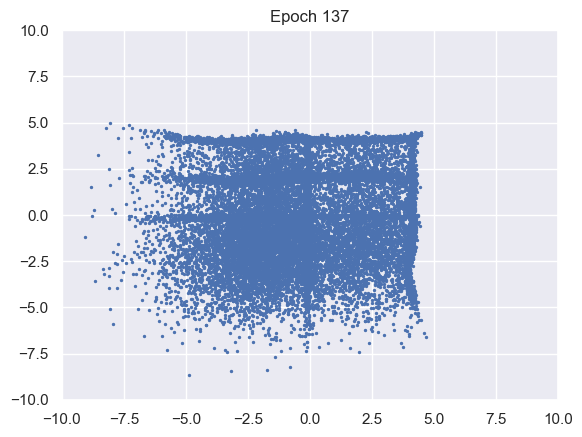

100%|██████████| 976/976 [00:10<00:00, 89.97it/s]


D loss : 1.1205, GP_loss : 0 G_loss : -0.8139, MI : 4.8311


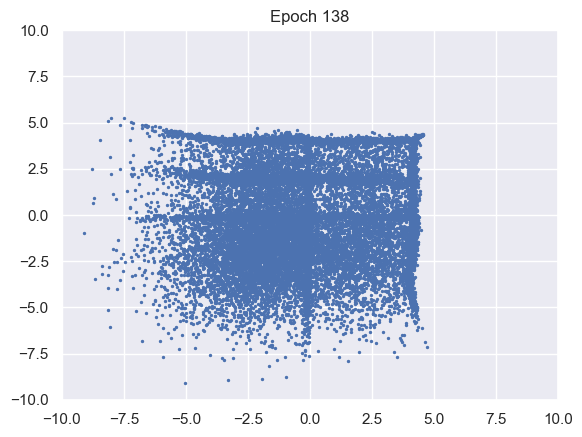

100%|██████████| 976/976 [00:10<00:00, 90.45it/s]


D loss : 1.1216, GP_loss : 0 G_loss : -0.815, MI : 4.1753


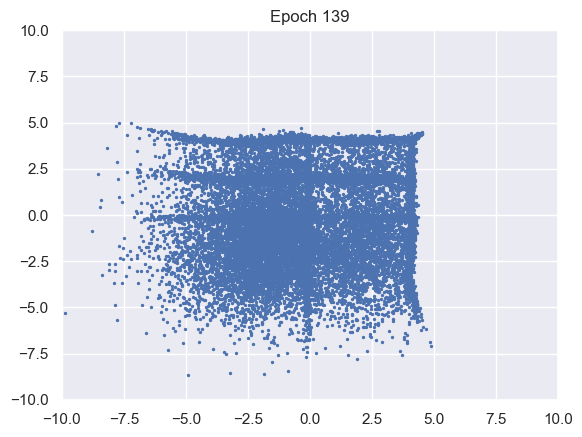

100%|██████████| 976/976 [00:11<00:00, 88.64it/s]


D loss : 1.1232, GP_loss : 0 G_loss : -0.814, MI : 3.6703


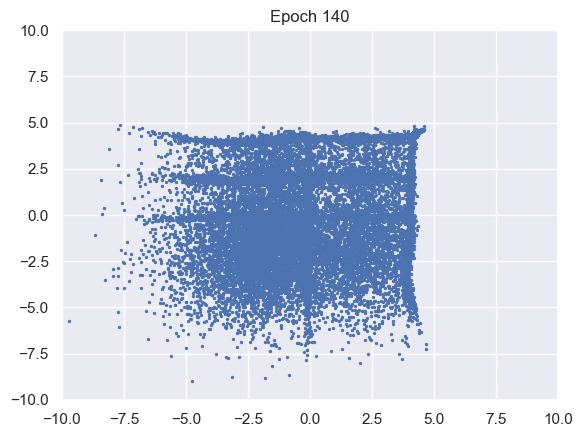

100%|██████████| 976/976 [00:10<00:00, 90.61it/s]


D loss : 1.1265, GP_loss : 0 G_loss : -0.8126, MI : 4.7498


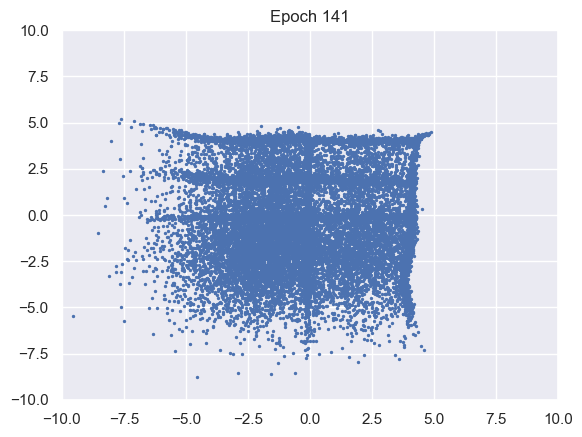

100%|██████████| 976/976 [00:10<00:00, 89.00it/s]


D loss : 1.1252, GP_loss : 0 G_loss : -0.8148, MI : 4.8497


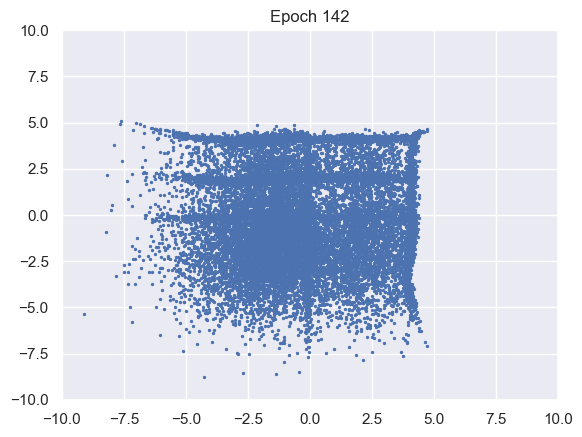

100%|██████████| 976/976 [00:10<00:00, 89.56it/s]


D loss : 1.1272, GP_loss : 0 G_loss : -0.8135, MI : 4.6636


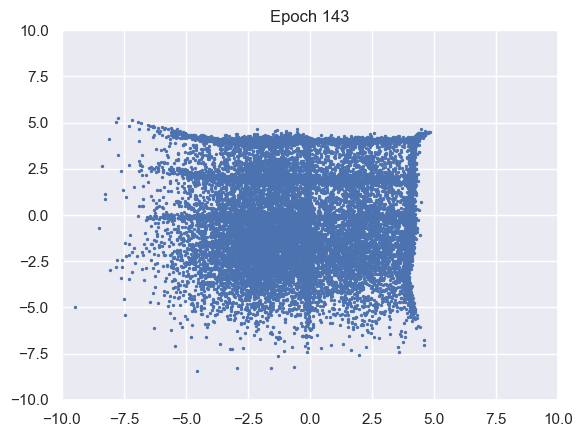

100%|██████████| 976/976 [00:10<00:00, 89.89it/s]


D loss : 1.129, GP_loss : 0 G_loss : -0.8127, MI : 4.6482


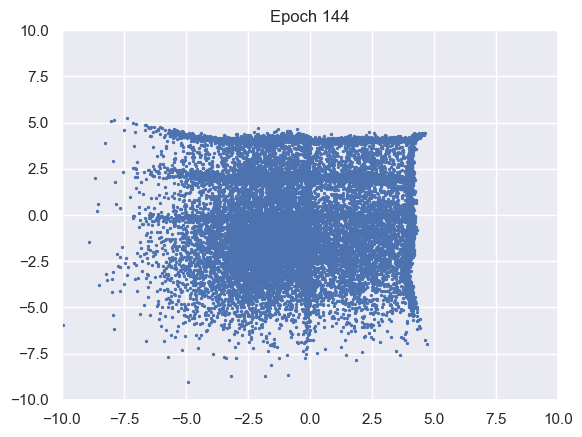

100%|██████████| 976/976 [00:10<00:00, 89.19it/s]


D loss : 1.1278, GP_loss : 0 G_loss : -0.8097, MI : 4.6752


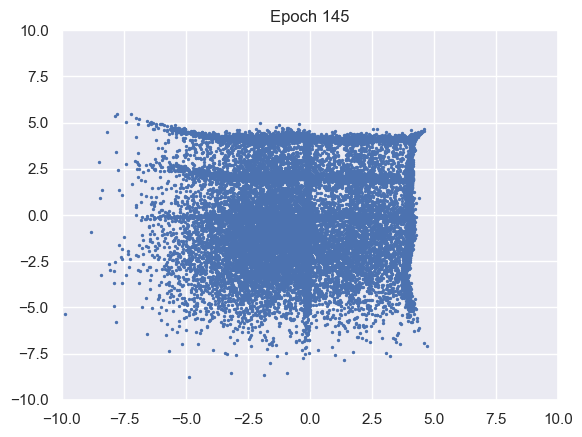

100%|██████████| 976/976 [00:11<00:00, 88.27it/s]


D loss : 1.1297, GP_loss : 0 G_loss : -0.8115, MI : 4.4305


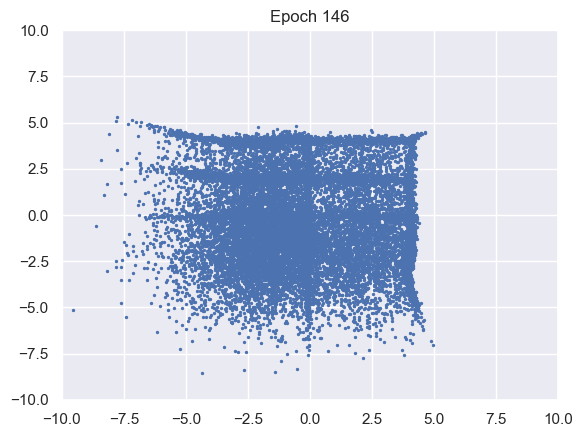

100%|██████████| 976/976 [00:11<00:00, 86.85it/s]


D loss : 1.1319, GP_loss : 0 G_loss : -0.8122, MI : 4.7814


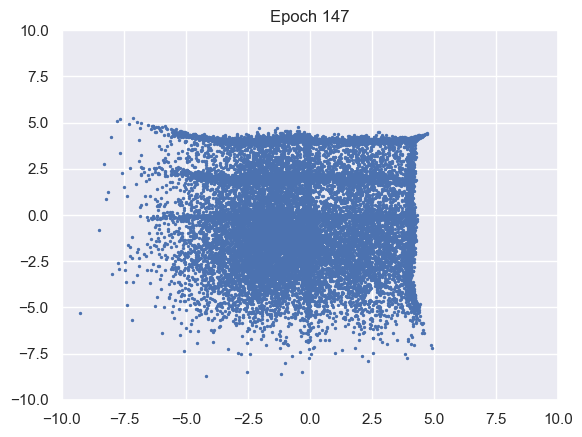

100%|██████████| 976/976 [00:11<00:00, 88.32it/s]


D loss : 1.1299, GP_loss : 0 G_loss : -0.8113, MI : 4.5396


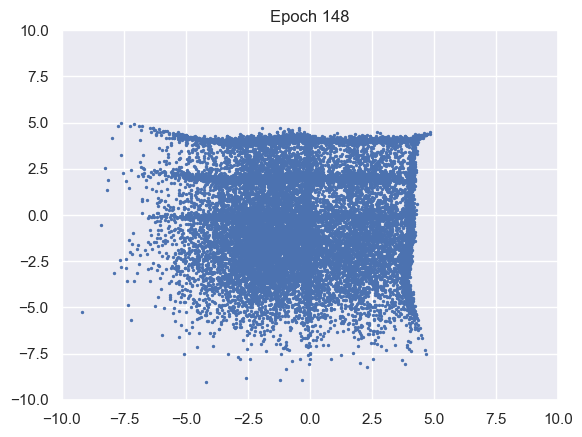

100%|██████████| 976/976 [00:11<00:00, 87.70it/s]


D loss : 1.1305, GP_loss : 0 G_loss : -0.8121, MI : 3.9179


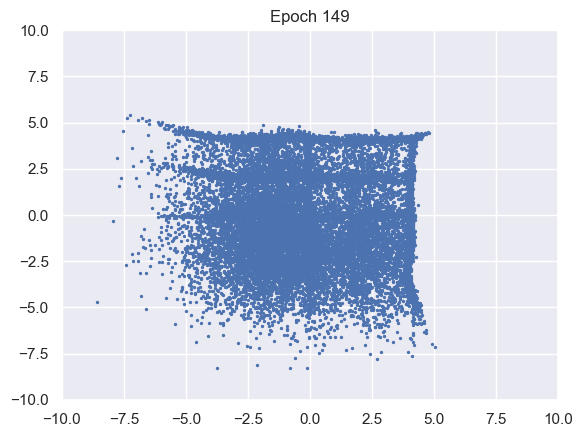

100%|██████████| 976/976 [00:10<00:00, 90.77it/s]


D loss : 1.1303, GP_loss : 0 G_loss : -0.8104, MI : 4.73


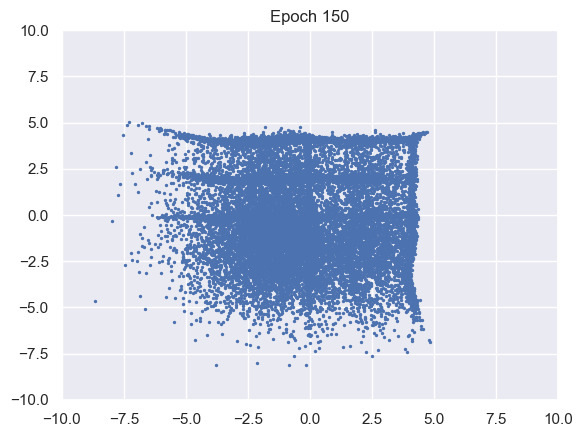

100%|██████████| 976/976 [00:11<00:00, 88.31it/s]


D loss : 1.1319, GP_loss : 0 G_loss : -0.8104, MI : 5.007


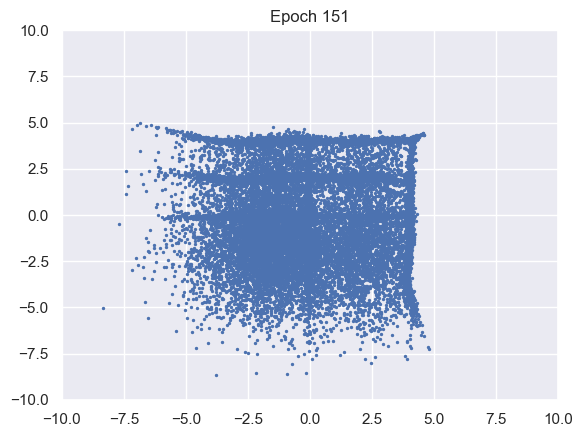

100%|██████████| 976/976 [00:11<00:00, 88.36it/s]


D loss : 1.13, GP_loss : 0 G_loss : -0.8095, MI : 2.097


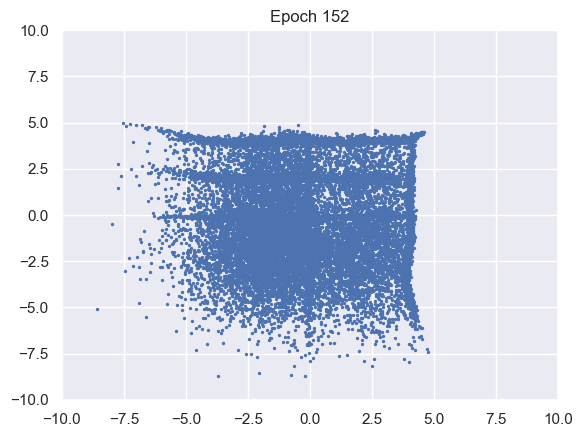

100%|██████████| 976/976 [00:11<00:00, 88.02it/s]


D loss : 1.1308, GP_loss : 0 G_loss : -0.8088, MI : 3.9337


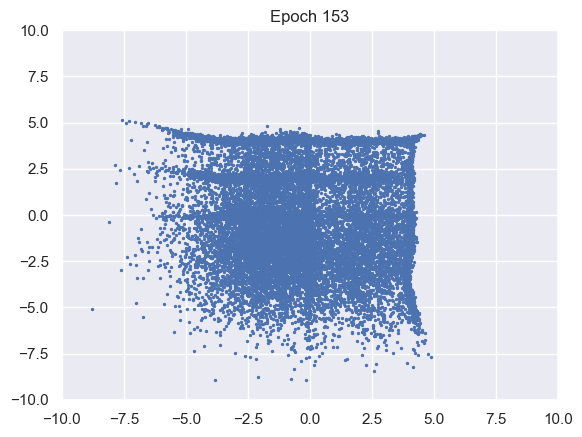

100%|██████████| 976/976 [00:10<00:00, 88.73it/s]


D loss : 1.1321, GP_loss : 0 G_loss : -0.8095, MI : 5.0349


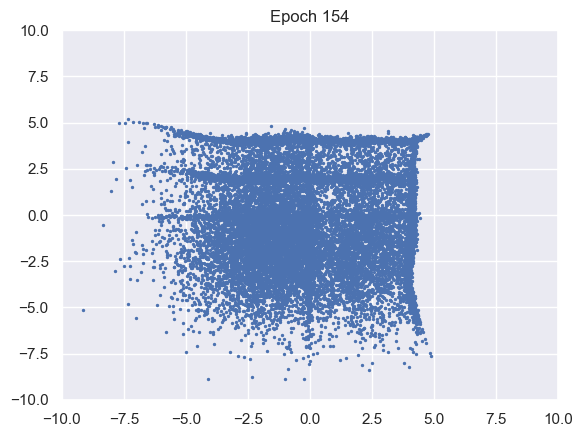

100%|██████████| 976/976 [00:10<00:00, 89.40it/s]


D loss : 1.1307, GP_loss : 0 G_loss : -0.8082, MI : 2.7445


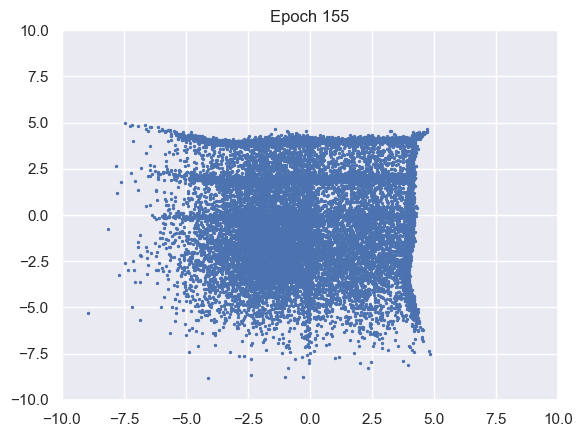

100%|██████████| 976/976 [00:10<00:00, 89.33it/s]


D loss : 1.129, GP_loss : 0 G_loss : -0.8091, MI : 4.3127


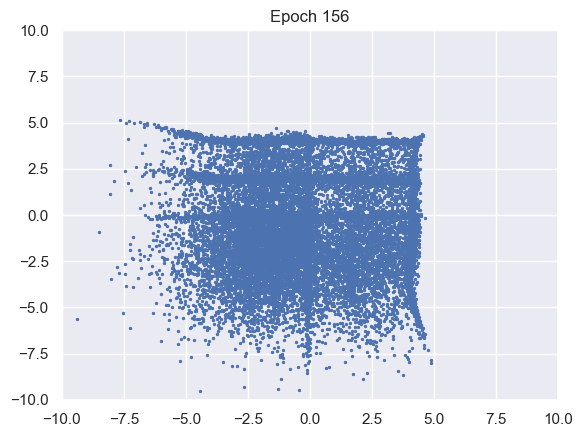

100%|██████████| 976/976 [00:10<00:00, 91.16it/s]


D loss : 1.1263, GP_loss : 0 G_loss : -0.8094, MI : 4.741


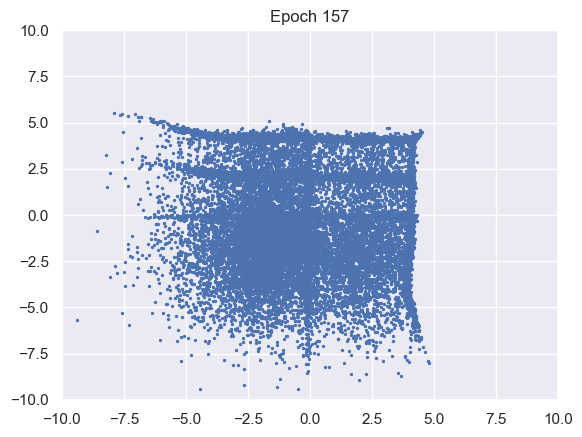

100%|██████████| 976/976 [00:10<00:00, 92.16it/s]


D loss : 1.1245, GP_loss : 0 G_loss : -0.8082, MI : 4.3748


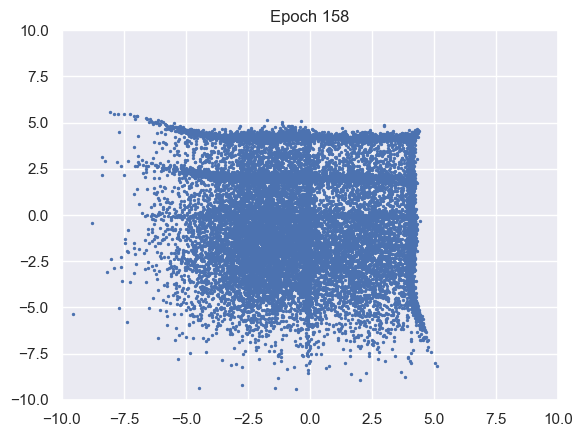

100%|██████████| 976/976 [00:10<00:00, 91.53it/s]


D loss : 1.1261, GP_loss : 0 G_loss : -0.8085, MI : 4.8028


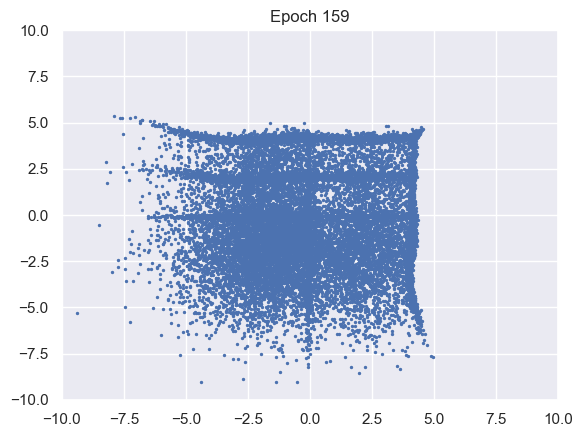

100%|██████████| 976/976 [00:10<00:00, 91.29it/s]


D loss : 1.1275, GP_loss : 0 G_loss : -0.8106, MI : 4.2047


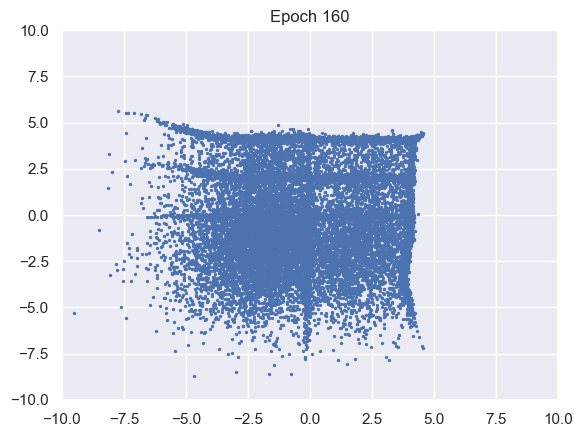

100%|██████████| 976/976 [00:10<00:00, 89.84it/s]


D loss : 1.129, GP_loss : 0 G_loss : -0.8106, MI : 4.7722


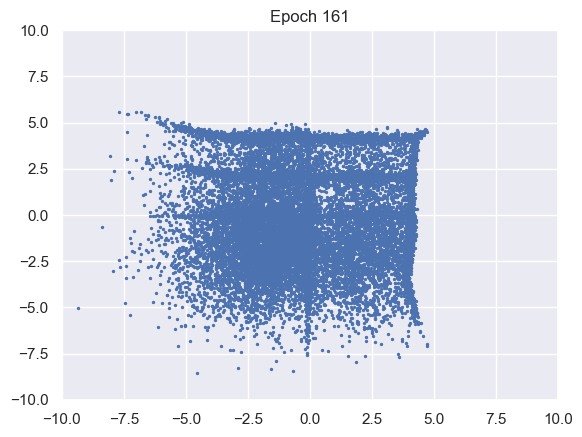

100%|██████████| 976/976 [00:11<00:00, 86.51it/s]


D loss : 1.1301, GP_loss : 0 G_loss : -0.8113, MI : 4.5391


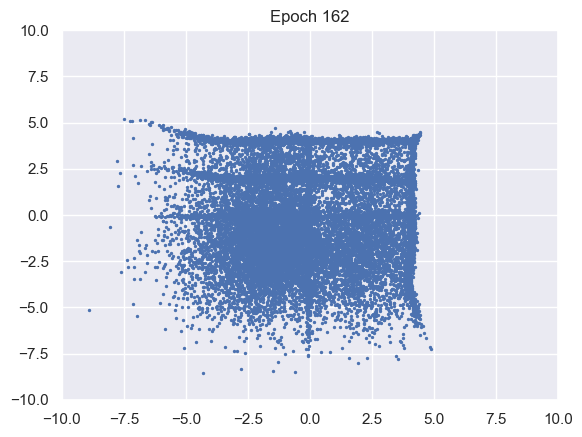

100%|██████████| 976/976 [00:11<00:00, 86.70it/s]


D loss : 1.1296, GP_loss : 0 G_loss : -0.813, MI : 4.7356


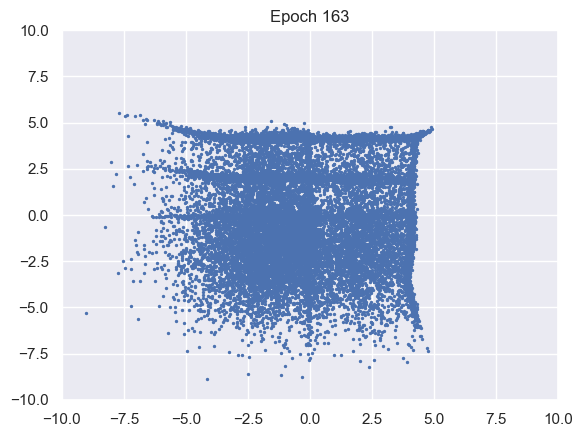

100%|██████████| 976/976 [00:11<00:00, 86.36it/s]


D loss : 1.1283, GP_loss : 0 G_loss : -0.8108, MI : 4.1357


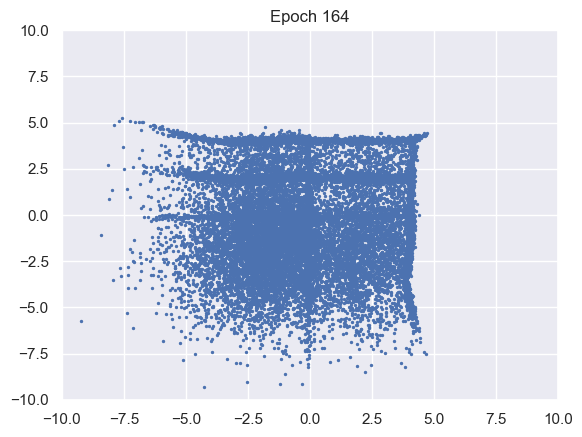

100%|██████████| 976/976 [00:11<00:00, 86.27it/s]


D loss : 1.1296, GP_loss : 0 G_loss : -0.8113, MI : 4.6652


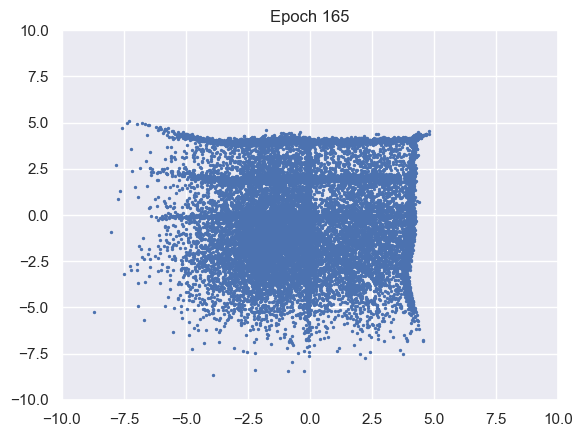

100%|██████████| 976/976 [00:11<00:00, 84.49it/s]


D loss : 1.1295, GP_loss : 0 G_loss : -0.811, MI : 4.6441


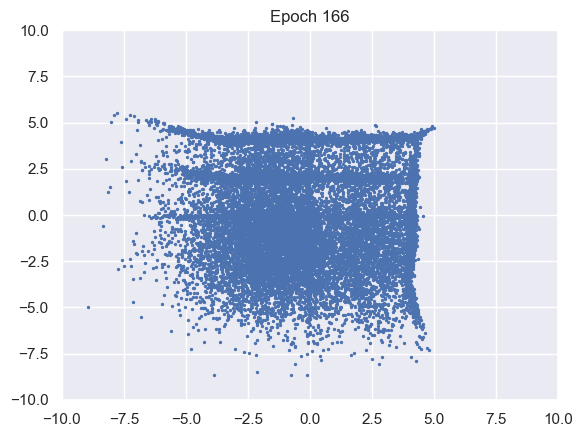

100%|██████████| 976/976 [00:11<00:00, 85.47it/s]


D loss : 1.1278, GP_loss : 0 G_loss : -0.8112, MI : 4.5824


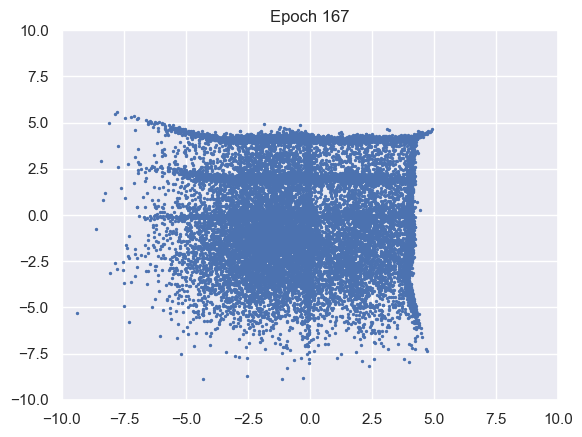

100%|██████████| 976/976 [00:11<00:00, 87.15it/s]


D loss : 1.1267, GP_loss : 0 G_loss : -0.8102, MI : 4.9778


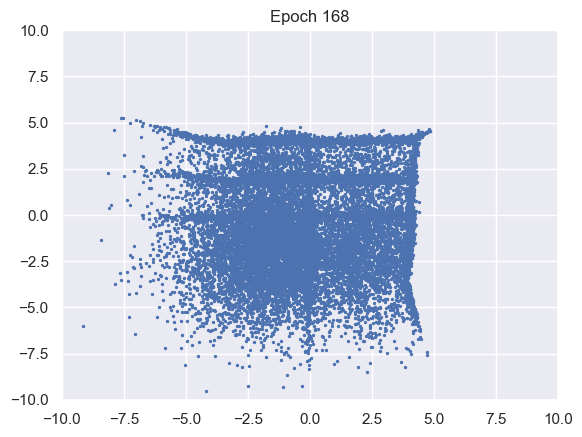

100%|██████████| 976/976 [00:11<00:00, 86.53it/s]


D loss : 1.127, GP_loss : 0 G_loss : -0.8126, MI : 1.8669


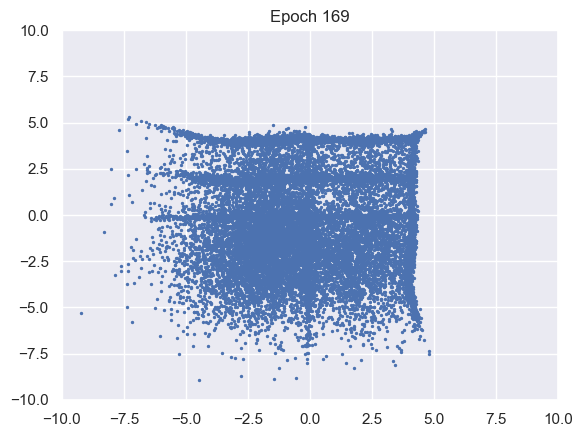

100%|██████████| 976/976 [00:11<00:00, 88.06it/s]


D loss : 1.1255, GP_loss : 0 G_loss : -0.8129, MI : 4.5786


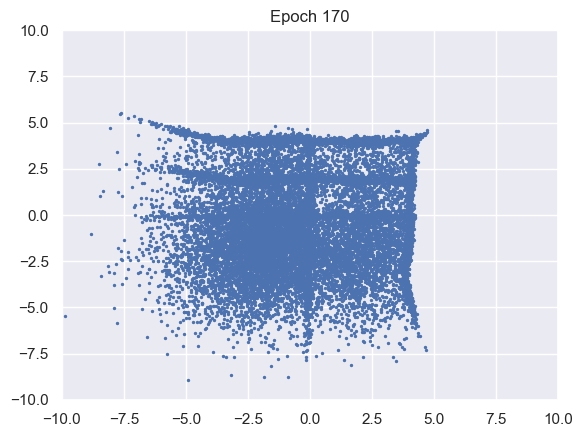

100%|██████████| 976/976 [00:11<00:00, 88.07it/s]


D loss : 1.1246, GP_loss : 0 G_loss : -0.8141, MI : 4.7805


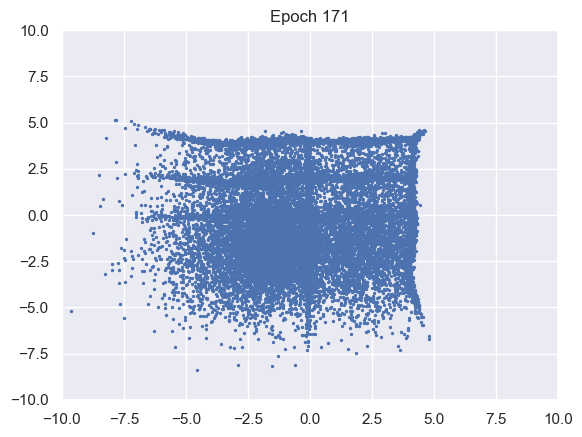

100%|██████████| 976/976 [00:11<00:00, 87.81it/s]


D loss : 1.127, GP_loss : 0 G_loss : -0.8183, MI : 3.9178


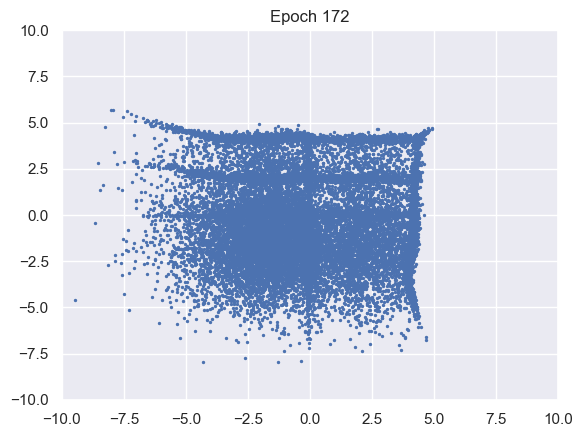

100%|██████████| 976/976 [00:11<00:00, 88.35it/s]


D loss : 1.1285, GP_loss : 0 G_loss : -0.8187, MI : 4.8917


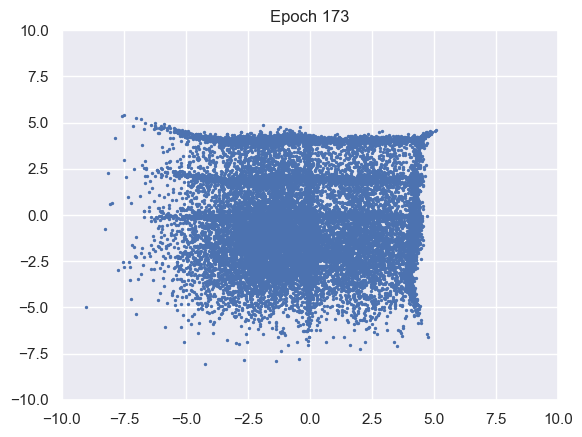

100%|██████████| 976/976 [00:11<00:00, 88.31it/s]


D loss : 1.1271, GP_loss : 0 G_loss : -0.8178, MI : 4.6369


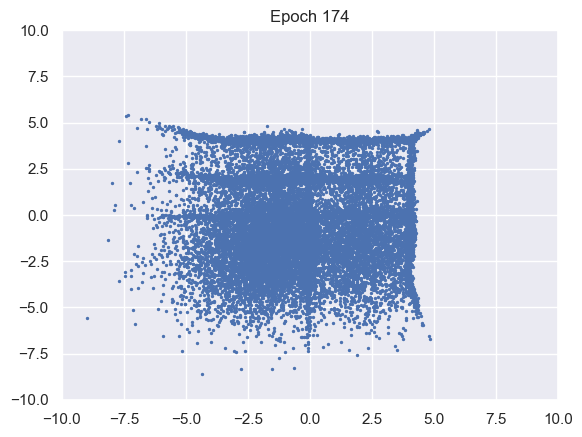

100%|██████████| 976/976 [00:11<00:00, 85.78it/s]


D loss : 1.1256, GP_loss : 0 G_loss : -0.8183, MI : 3.3916


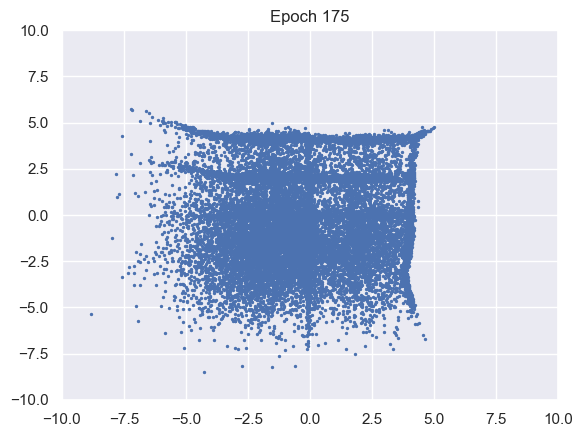

100%|██████████| 976/976 [00:11<00:00, 87.08it/s]


D loss : 1.1264, GP_loss : 0 G_loss : -0.8178, MI : 4.9427


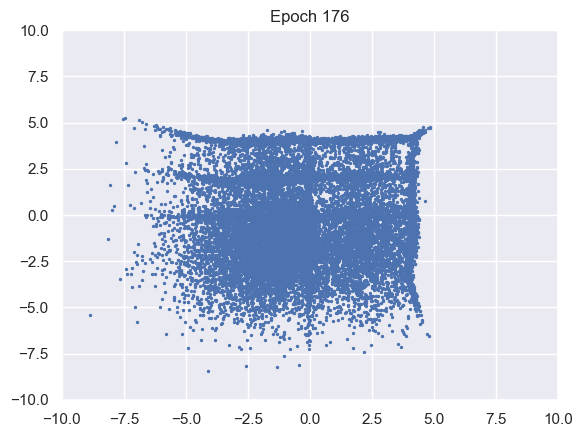

100%|██████████| 976/976 [00:11<00:00, 87.68it/s]


D loss : 1.126, GP_loss : 0 G_loss : -0.8195, MI : 5.0681


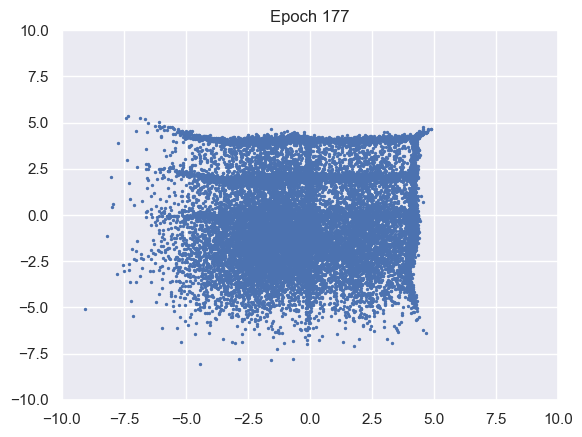

100%|██████████| 976/976 [00:11<00:00, 86.76it/s]


D loss : 1.1241, GP_loss : 0 G_loss : -0.8203, MI : 4.6846


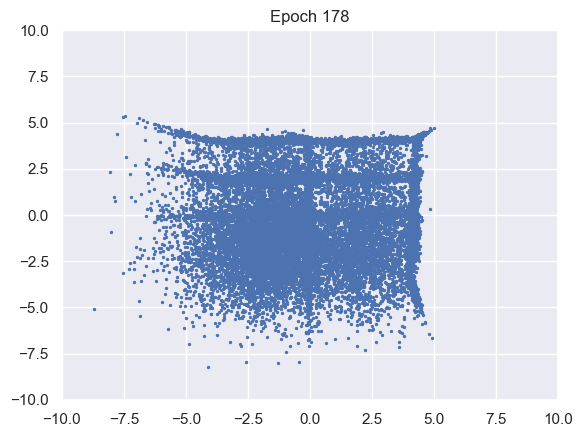

100%|██████████| 976/976 [00:11<00:00, 86.32it/s]


D loss : 1.1237, GP_loss : 0 G_loss : -0.8183, MI : 4.2127


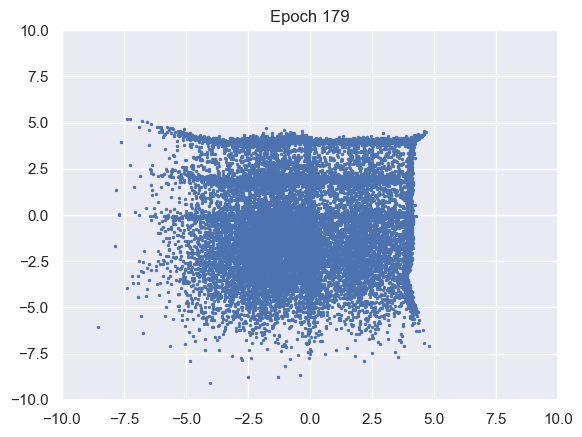

100%|██████████| 976/976 [00:11<00:00, 87.99it/s]


D loss : 1.1161, GP_loss : 0 G_loss : -0.8188, MI : 4.8103


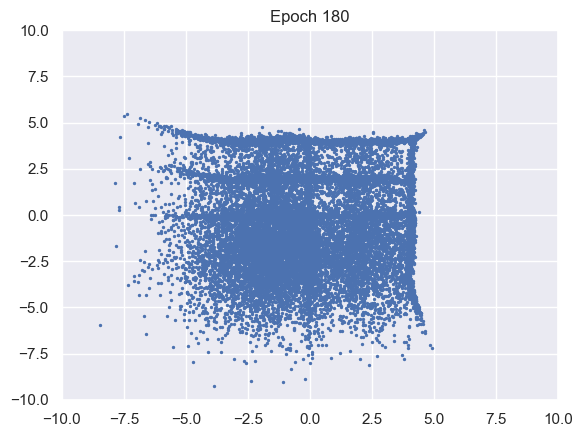

100%|██████████| 976/976 [00:11<00:00, 86.63it/s]


D loss : 1.1115, GP_loss : 0 G_loss : -0.8179, MI : 4.3891


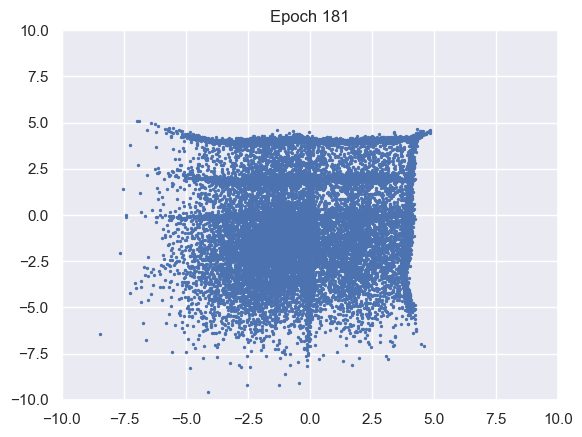

100%|██████████| 976/976 [00:11<00:00, 84.13it/s]


D loss : 1.1107, GP_loss : 0 G_loss : -0.8183, MI : 4.8219


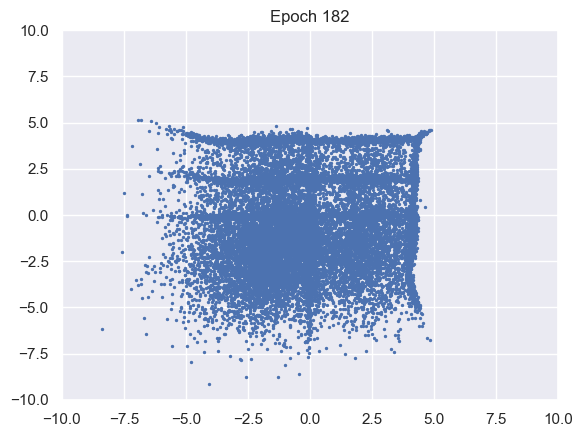

100%|██████████| 976/976 [00:11<00:00, 86.52it/s]


D loss : 1.1122, GP_loss : 0 G_loss : -0.8191, MI : 4.0257


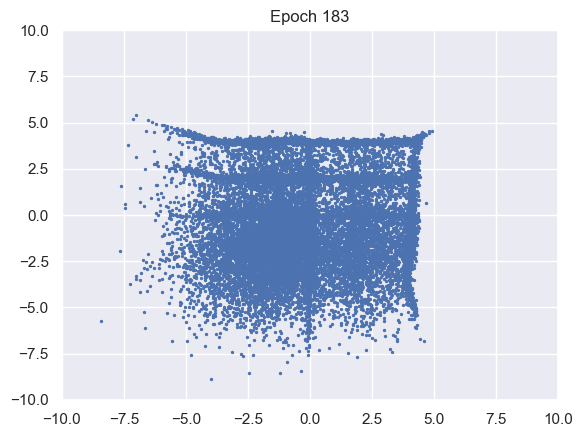

100%|██████████| 976/976 [00:11<00:00, 87.05it/s]


D loss : 1.1119, GP_loss : 0 G_loss : -0.8211, MI : 4.9696


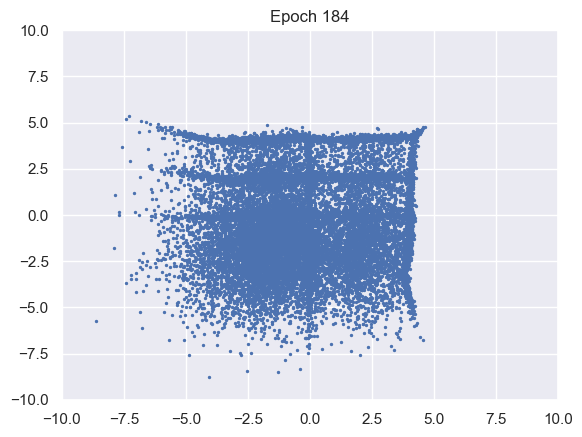

100%|██████████| 976/976 [00:11<00:00, 88.38it/s]


D loss : 1.1134, GP_loss : 0 G_loss : -0.8226, MI : 4.7589


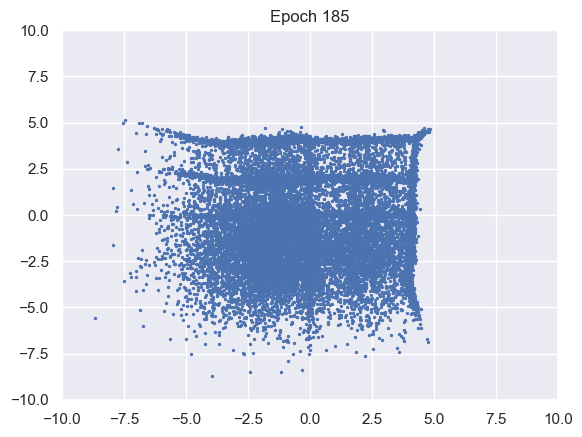

100%|██████████| 976/976 [00:11<00:00, 87.08it/s]


D loss : 1.1151, GP_loss : 0 G_loss : -0.8229, MI : 2.1706


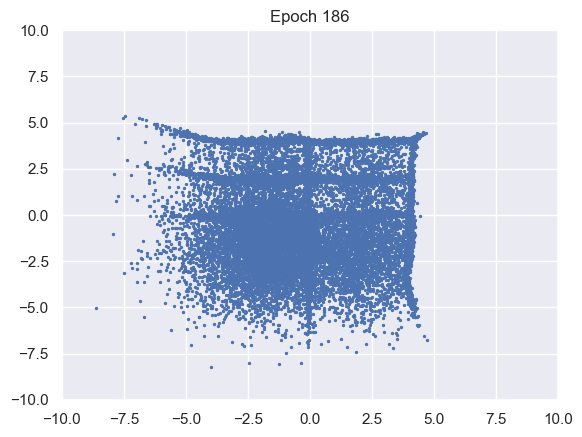

100%|██████████| 976/976 [00:11<00:00, 86.97it/s]


D loss : 1.1181, GP_loss : 0 G_loss : -0.8216, MI : 3.6238


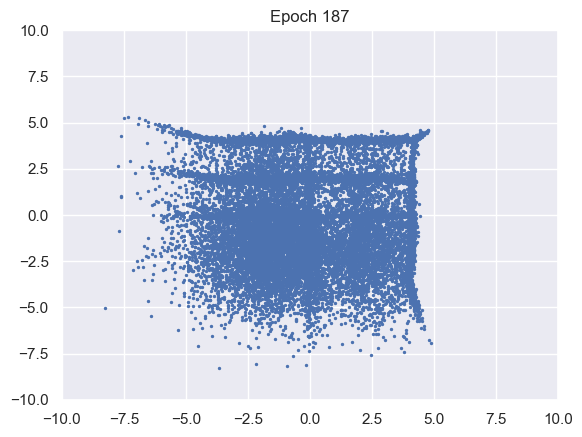

100%|██████████| 976/976 [00:11<00:00, 85.94it/s]


D loss : 1.1194, GP_loss : 0 G_loss : -0.8198, MI : 5.0599


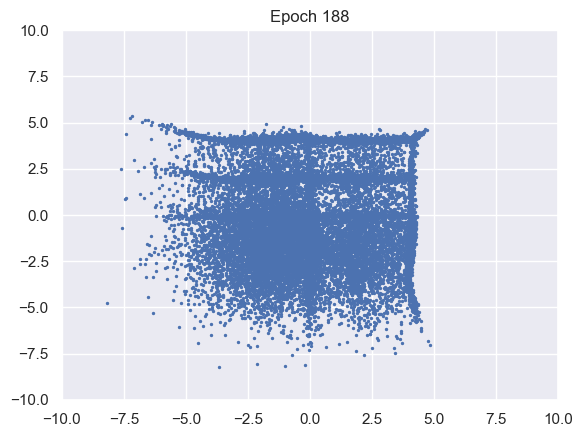

100%|██████████| 976/976 [00:11<00:00, 87.89it/s]


D loss : 1.1184, GP_loss : 0 G_loss : -0.8222, MI : 4.6739


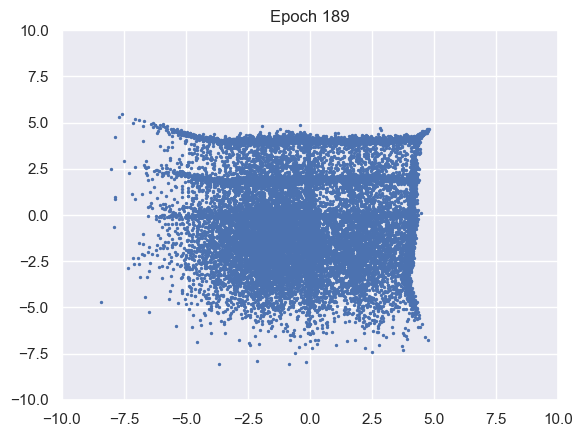

100%|██████████| 976/976 [00:11<00:00, 87.66it/s]


D loss : 1.12, GP_loss : 0 G_loss : -0.8211, MI : 5.0211


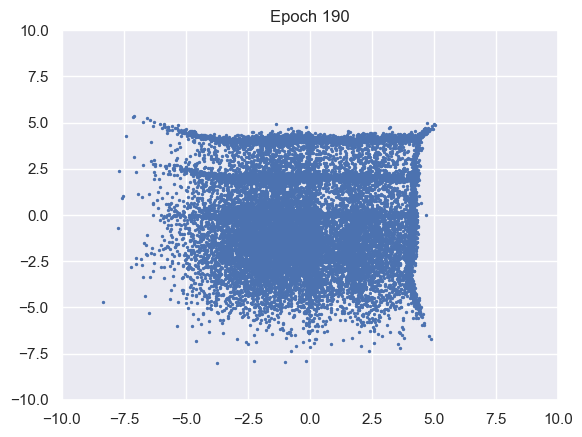

100%|██████████| 976/976 [00:11<00:00, 88.29it/s]


D loss : 1.1171, GP_loss : 0 G_loss : -0.8213, MI : 4.5595


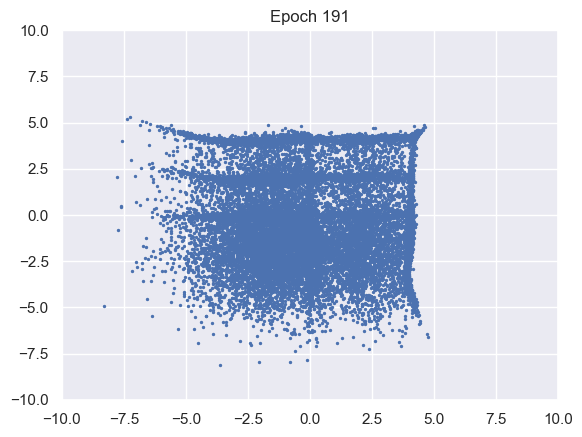

100%|██████████| 976/976 [00:11<00:00, 88.52it/s]


D loss : 1.1206, GP_loss : 0 G_loss : -0.8212, MI : 4.5782


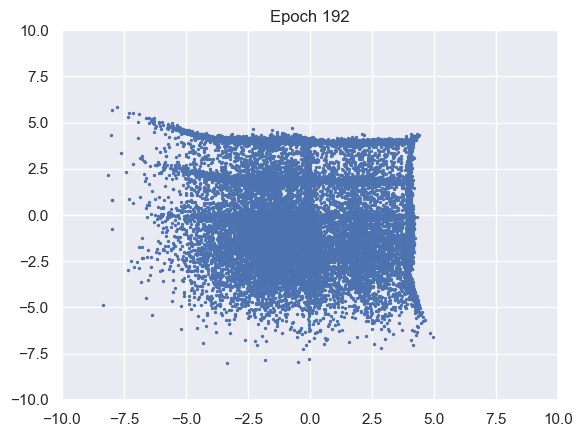

100%|██████████| 976/976 [00:10<00:00, 88.74it/s]


D loss : 1.1189, GP_loss : 0 G_loss : -0.8189, MI : 4.7421


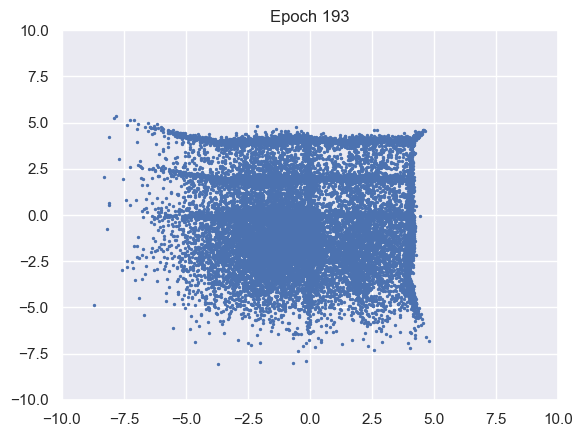

100%|██████████| 976/976 [00:10<00:00, 88.96it/s]


D loss : 1.1182, GP_loss : 0 G_loss : -0.8217, MI : 4.8398


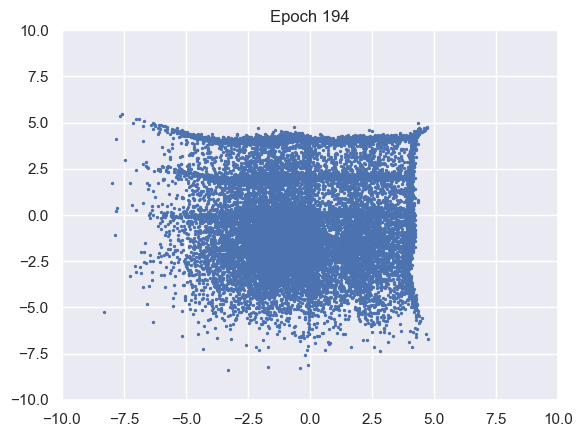

100%|██████████| 976/976 [00:11<00:00, 86.61it/s]


D loss : 1.1205, GP_loss : 0 G_loss : -0.8201, MI : 4.715


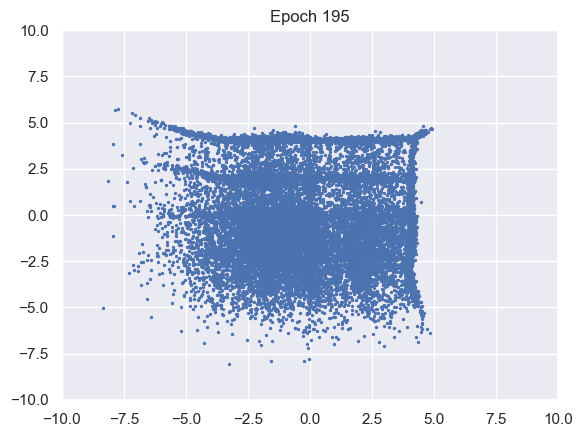

100%|██████████| 976/976 [00:11<00:00, 86.09it/s]


D loss : 1.1196, GP_loss : 0 G_loss : -0.8207, MI : 4.9045


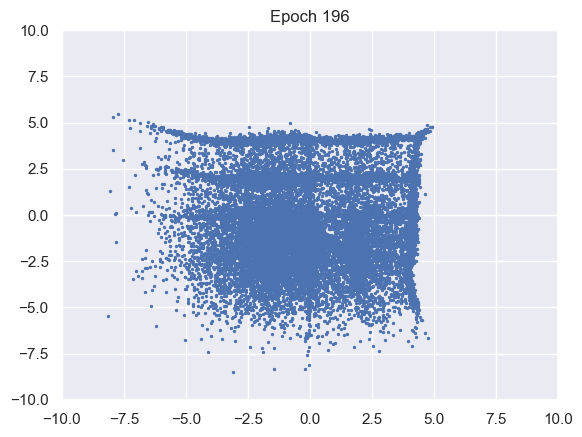

100%|██████████| 976/976 [00:11<00:00, 87.17it/s]


D loss : 1.1149, GP_loss : 0 G_loss : -0.8194, MI : 2.1837


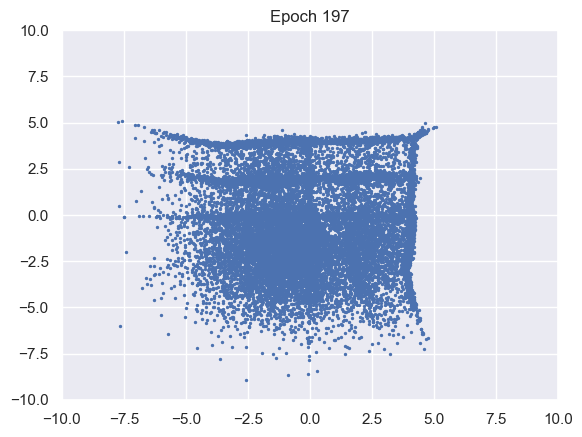

100%|██████████| 976/976 [00:11<00:00, 86.59it/s]


D loss : 1.1158, GP_loss : 0 G_loss : -0.8198, MI : 5.03


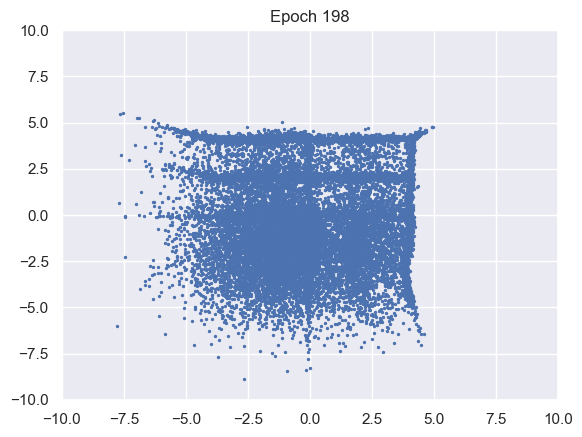

100%|██████████| 976/976 [00:11<00:00, 87.02it/s]


D loss : 1.1167, GP_loss : 0 G_loss : -0.8186, MI : 4.0251


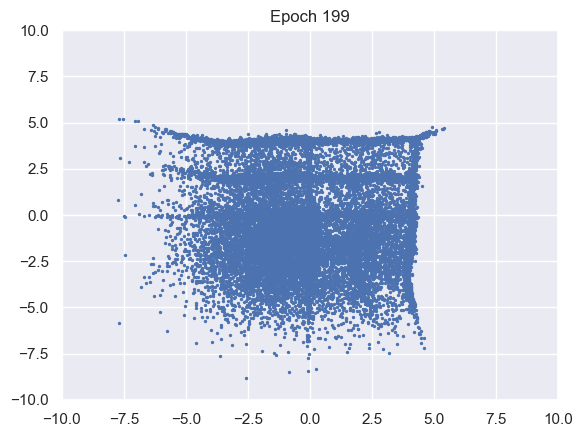

100%|██████████| 976/976 [00:11<00:00, 88.35it/s]


D loss : 1.1141, GP_loss : 0 G_loss : -0.818, MI : 4.9342


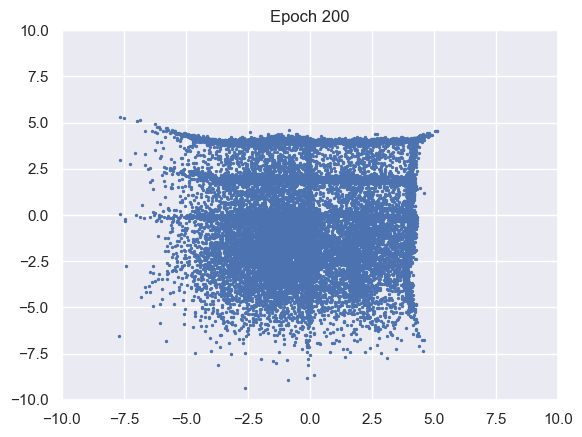

100%|██████████| 976/976 [00:11<00:00, 88.20it/s]


D loss : 1.1149, GP_loss : 0 G_loss : -0.8206, MI : 4.4442


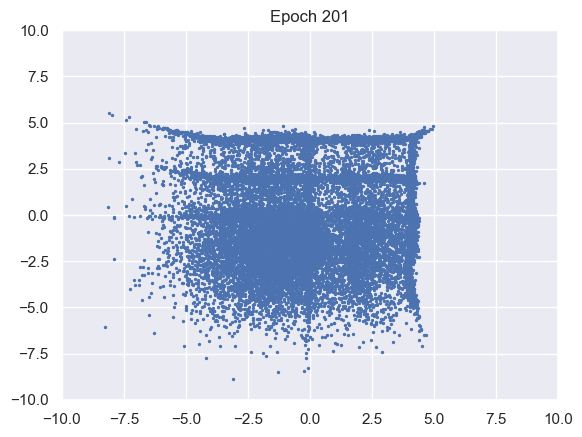

100%|██████████| 976/976 [00:10<00:00, 89.91it/s]


D loss : 1.1154, GP_loss : 0 G_loss : -0.8222, MI : 2.0972


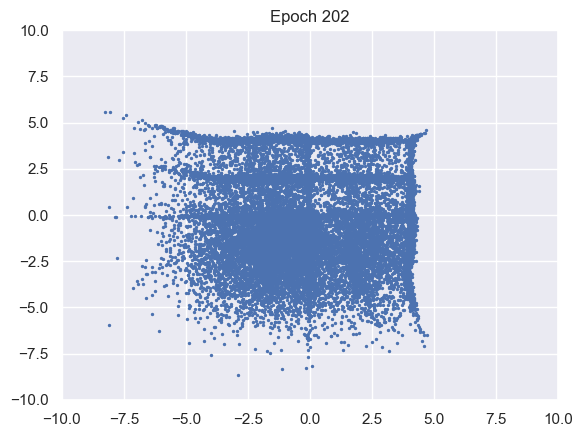

100%|██████████| 976/976 [00:10<00:00, 90.01it/s]


D loss : 1.1171, GP_loss : 0 G_loss : -0.8227, MI : 4.4911


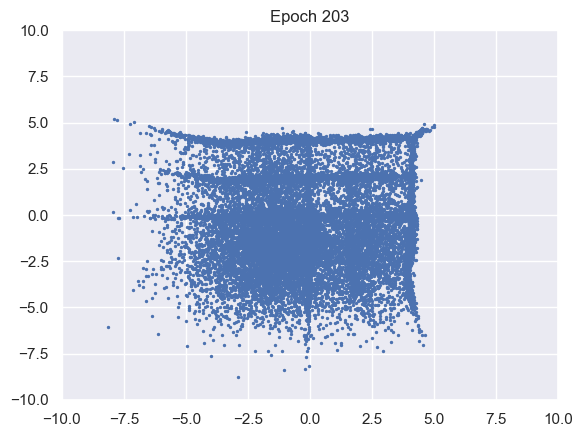

100%|██████████| 976/976 [00:10<00:00, 90.11it/s]


D loss : 1.115, GP_loss : 0 G_loss : -0.8203, MI : 5.0195


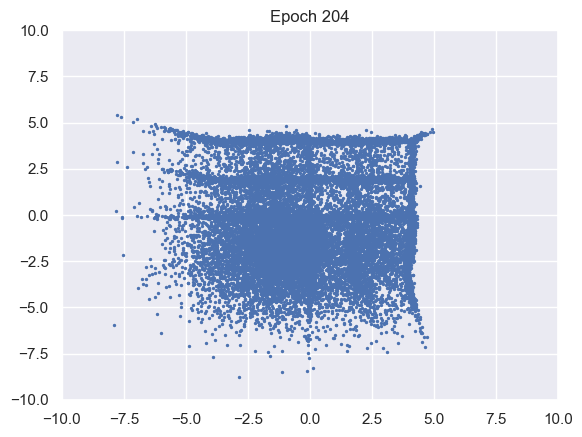

100%|██████████| 976/976 [00:10<00:00, 90.44it/s]


D loss : 1.1148, GP_loss : 0 G_loss : -0.8233, MI : 3.079


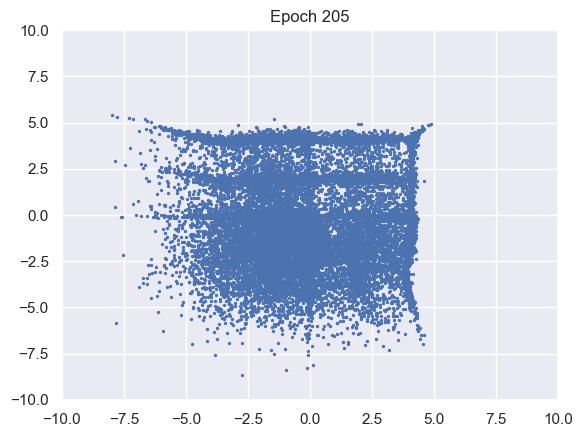

100%|██████████| 976/976 [00:11<00:00, 86.87it/s]


D loss : 1.1171, GP_loss : 0 G_loss : -0.8198, MI : 3.9693


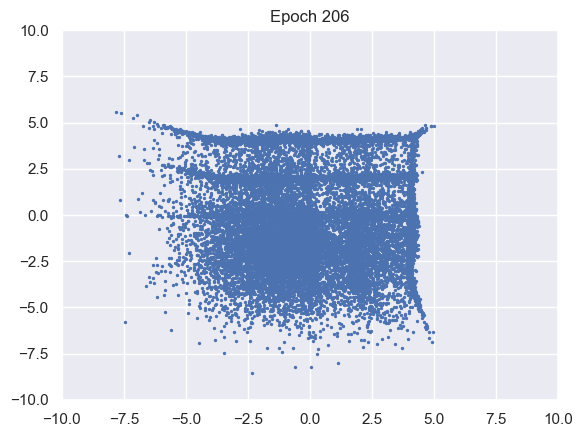

100%|██████████| 976/976 [00:11<00:00, 86.11it/s]


D loss : 1.1176, GP_loss : 0 G_loss : -0.8213, MI : 4.4822


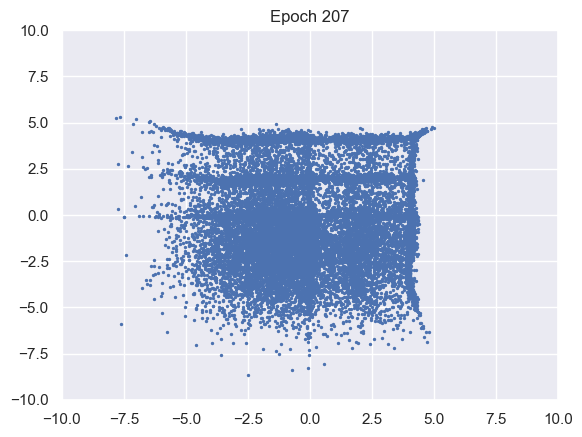

100%|██████████| 976/976 [00:11<00:00, 87.36it/s]


D loss : 1.1171, GP_loss : 0 G_loss : -0.8215, MI : 5.0251


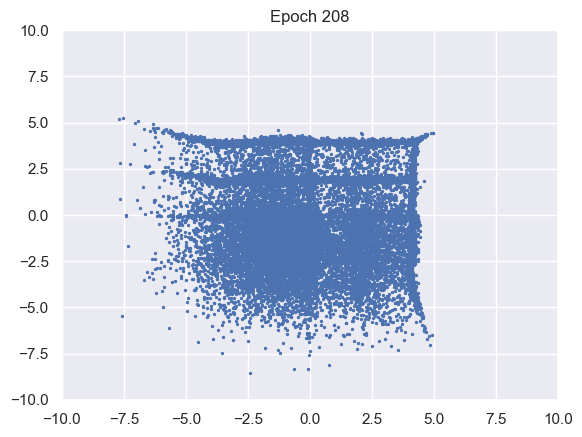

100%|██████████| 976/976 [00:11<00:00, 87.92it/s]


D loss : 1.1162, GP_loss : 0 G_loss : -0.821, MI : 2.8585


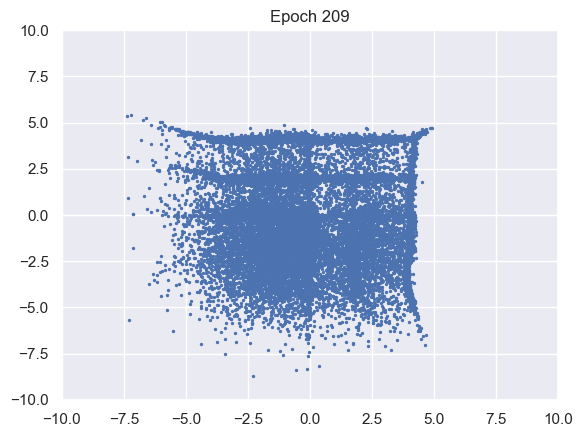

100%|██████████| 976/976 [00:11<00:00, 88.47it/s]


D loss : 1.1195, GP_loss : 0 G_loss : -0.8194, MI : 4.9251


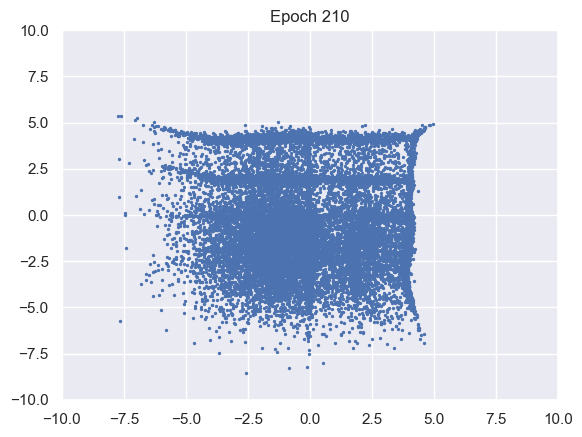

100%|██████████| 976/976 [00:11<00:00, 87.38it/s]


D loss : 1.1194, GP_loss : 0 G_loss : -0.8213, MI : 4.6548


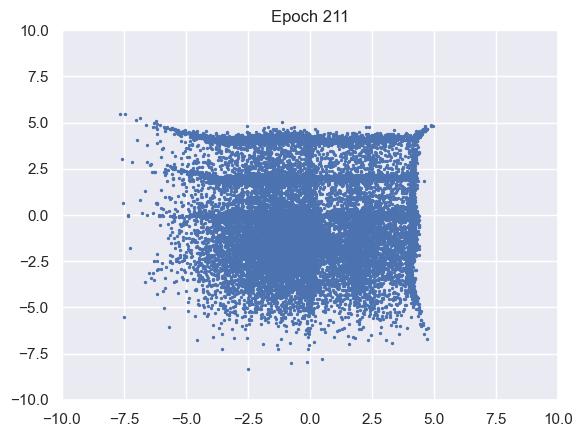

100%|██████████| 976/976 [00:11<00:00, 86.25it/s]


D loss : 1.1223, GP_loss : 0 G_loss : -0.8198, MI : 4.0823


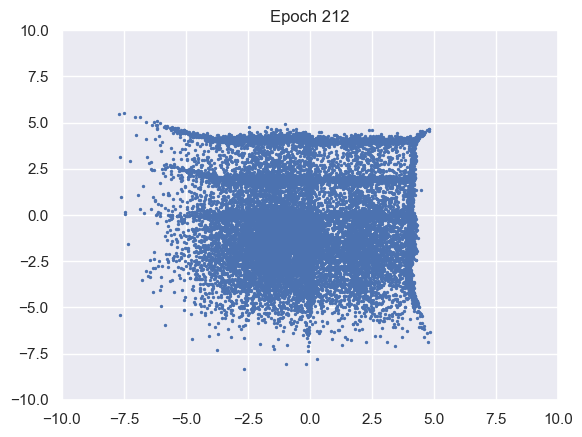

100%|██████████| 976/976 [00:11<00:00, 86.68it/s]


D loss : 1.1225, GP_loss : 0 G_loss : -0.819, MI : 4.4369


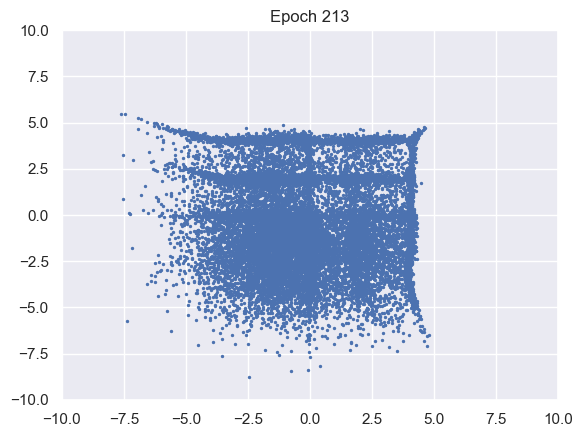

100%|██████████| 976/976 [00:11<00:00, 88.17it/s]


D loss : 1.1201, GP_loss : 0 G_loss : -0.8176, MI : 4.2042


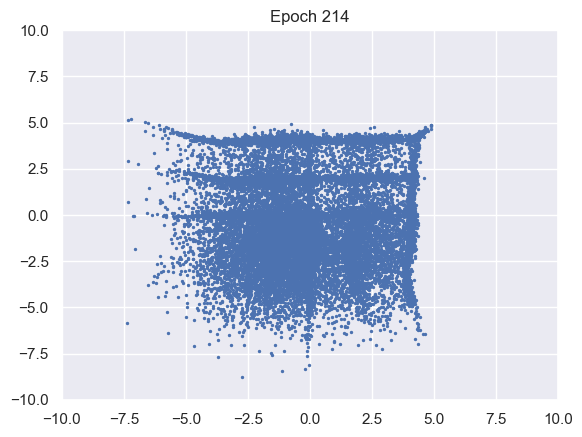

100%|██████████| 976/976 [00:10<00:00, 88.94it/s]


D loss : 1.1218, GP_loss : 0 G_loss : -0.8196, MI : 4.7976


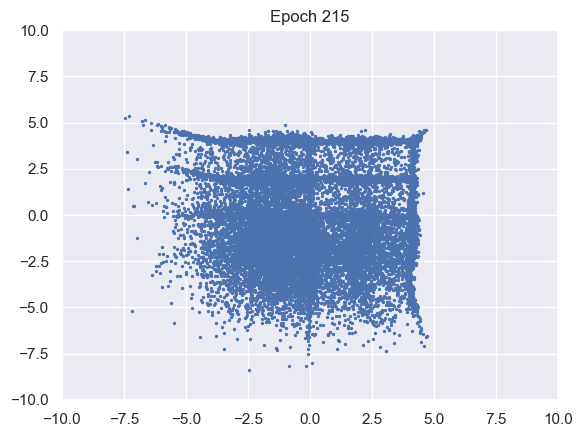

100%|██████████| 976/976 [00:11<00:00, 88.39it/s]


D loss : 1.1235, GP_loss : 0 G_loss : -0.819, MI : 4.5205


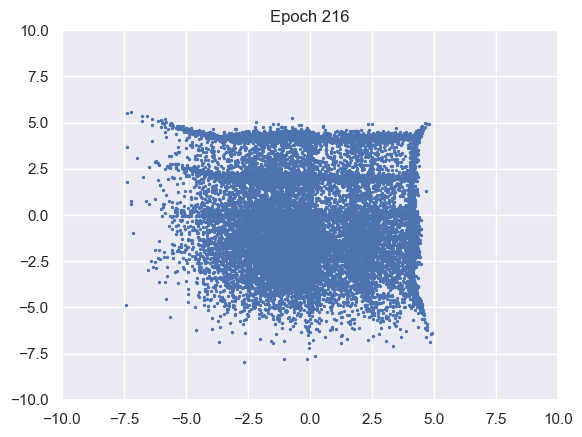

100%|██████████| 976/976 [00:10<00:00, 88.83it/s]


D loss : 1.1269, GP_loss : 0 G_loss : -0.8182, MI : 4.8374


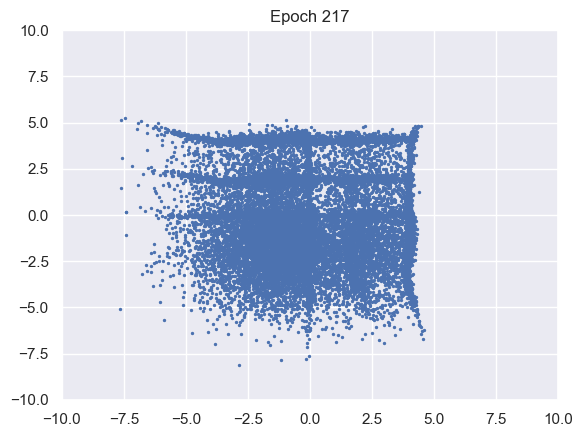

100%|██████████| 976/976 [00:11<00:00, 88.20it/s]


D loss : 1.1241, GP_loss : 0 G_loss : -0.8186, MI : 4.7513


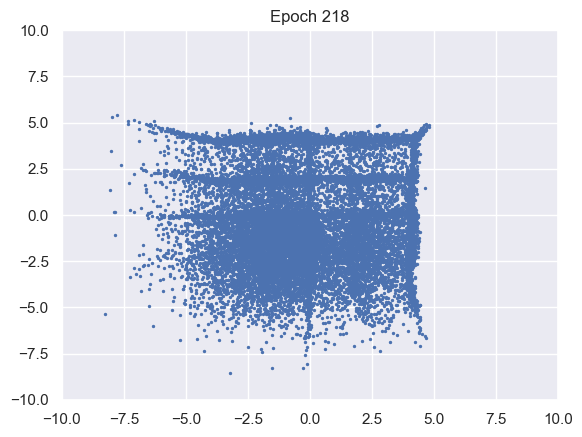

100%|██████████| 976/976 [00:11<00:00, 86.21it/s]


D loss : 1.1236, GP_loss : 0 G_loss : -0.8202, MI : 4.6545


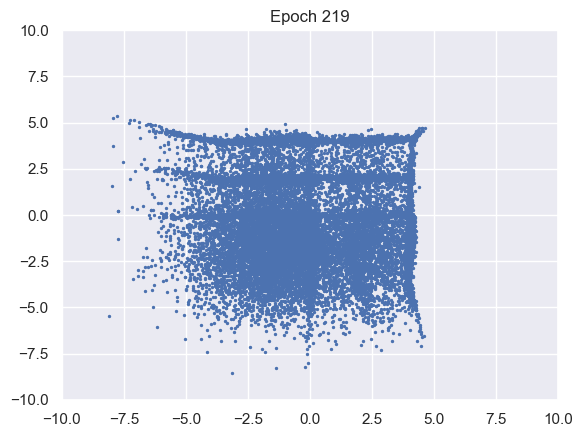

100%|██████████| 976/976 [00:11<00:00, 87.15it/s]


D loss : 1.1234, GP_loss : 0 G_loss : -0.8197, MI : 4.4765


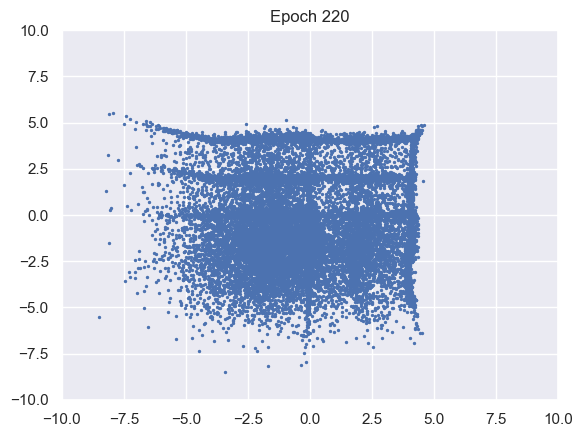

100%|██████████| 976/976 [00:11<00:00, 86.92it/s]


D loss : 1.1234, GP_loss : 0 G_loss : -0.8225, MI : 4.2564


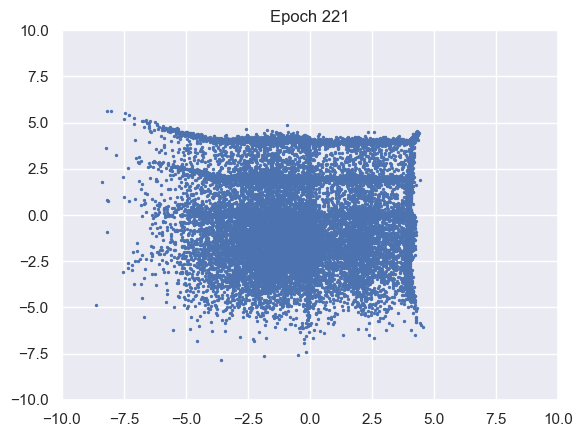

100%|██████████| 976/976 [00:10<00:00, 89.18it/s]


D loss : 1.1259, GP_loss : 0 G_loss : -0.8198, MI : 4.6616


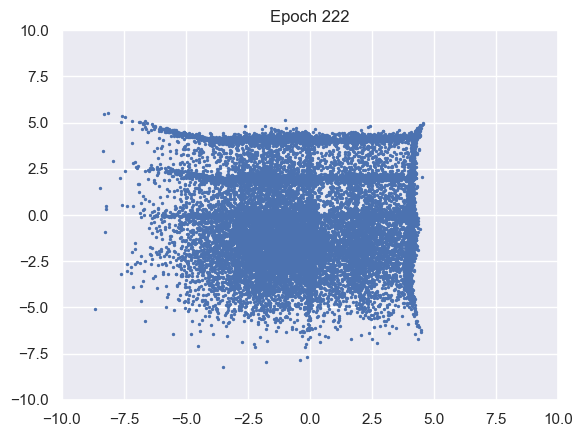

100%|██████████| 976/976 [00:10<00:00, 89.86it/s]


D loss : 1.123, GP_loss : 0 G_loss : -0.8188, MI : 4.9031


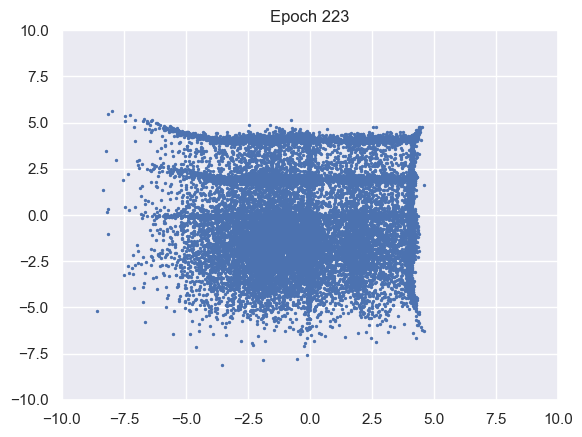

100%|██████████| 976/976 [00:11<00:00, 87.02it/s]


D loss : 1.124, GP_loss : 0 G_loss : -0.8214, MI : 3.9302


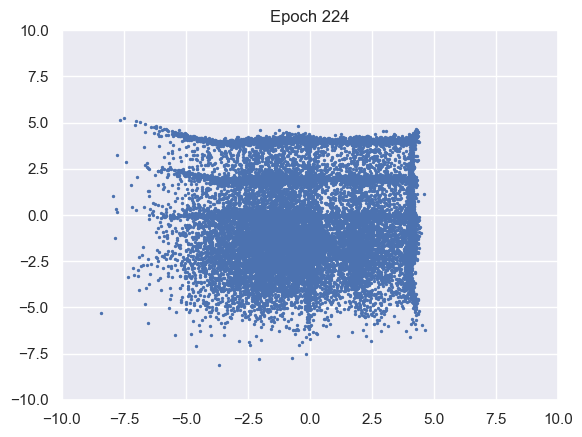

100%|██████████| 976/976 [00:11<00:00, 86.85it/s]


D loss : 1.1257, GP_loss : 0 G_loss : -0.8223, MI : 5.0215


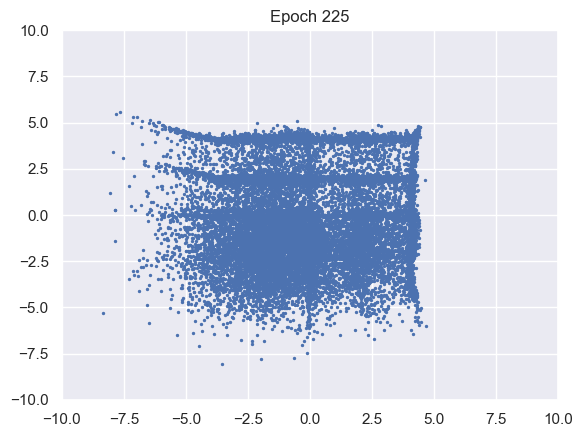

100%|██████████| 976/976 [00:11<00:00, 85.77it/s]


D loss : 1.1235, GP_loss : 0 G_loss : -0.821, MI : 3.9749


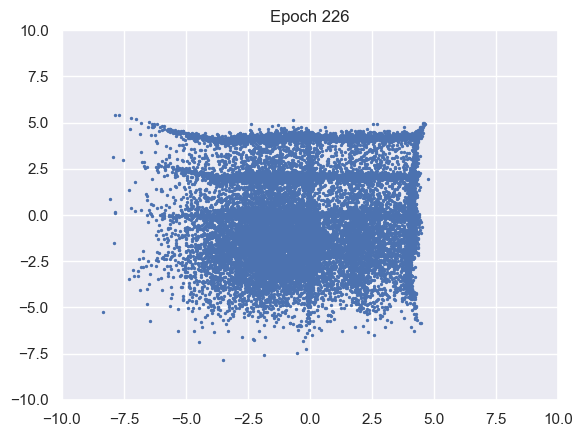

100%|██████████| 976/976 [00:11<00:00, 86.35it/s]


D loss : 1.124, GP_loss : 0 G_loss : -0.8189, MI : 3.666


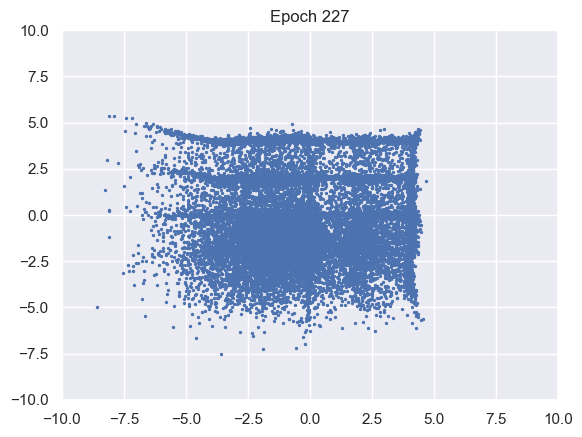

100%|██████████| 976/976 [00:11<00:00, 85.94it/s]


D loss : 1.1238, GP_loss : 0 G_loss : -0.8191, MI : 4.896


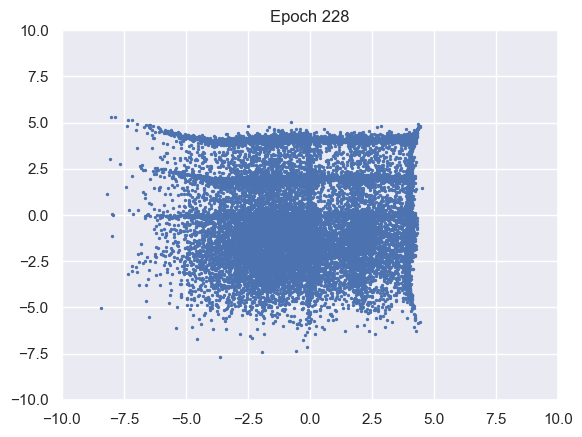

100%|██████████| 976/976 [00:11<00:00, 86.05it/s]


D loss : 1.1237, GP_loss : 0 G_loss : -0.8204, MI : 4.9719


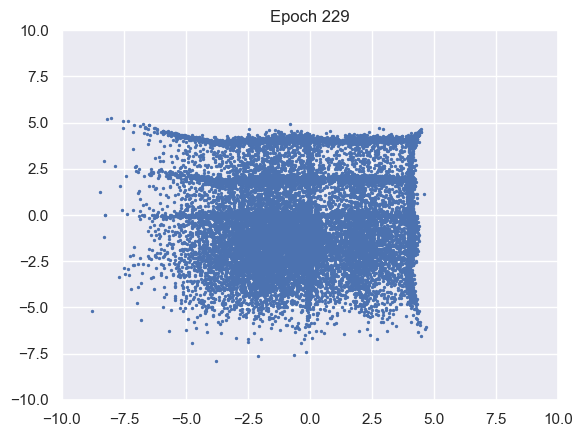

100%|██████████| 976/976 [00:11<00:00, 87.96it/s]


D loss : 1.1268, GP_loss : 0 G_loss : -0.8198, MI : 3.3664


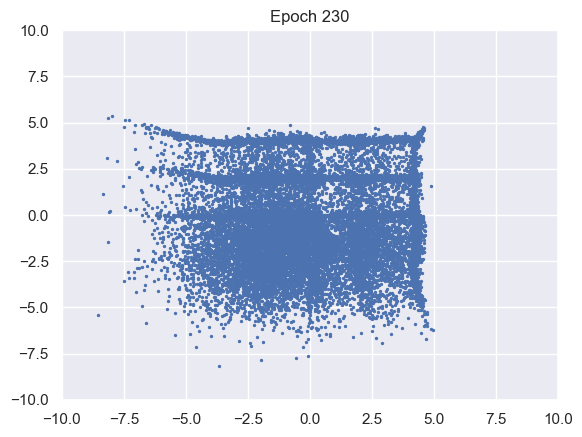

100%|██████████| 976/976 [00:10<00:00, 88.86it/s]


D loss : 1.1227, GP_loss : 0 G_loss : -0.8209, MI : 4.7197


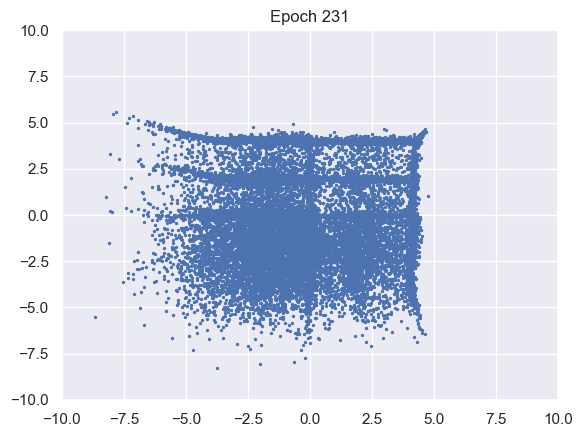

100%|██████████| 976/976 [00:10<00:00, 89.91it/s]


D loss : 1.1249, GP_loss : 0 G_loss : -0.8222, MI : 4.6149


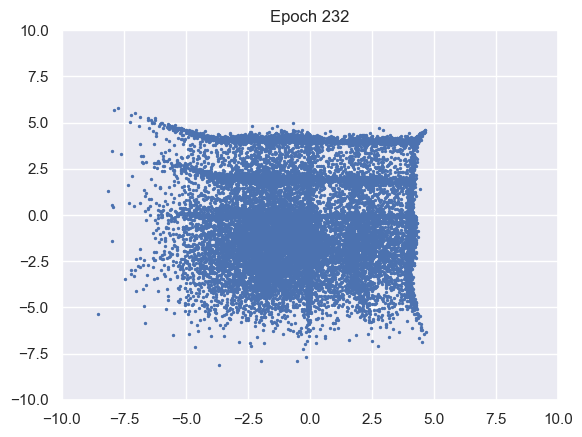

100%|██████████| 976/976 [00:10<00:00, 89.78it/s]


D loss : 1.1253, GP_loss : 0 G_loss : -0.8219, MI : 4.8127


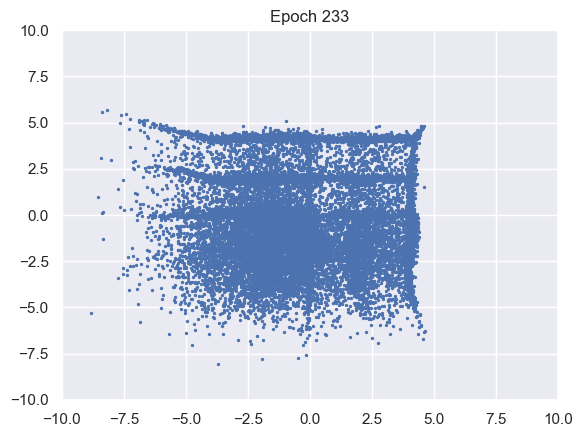

100%|██████████| 976/976 [00:10<00:00, 90.44it/s]


D loss : 1.1234, GP_loss : 0 G_loss : -0.8209, MI : 4.6148


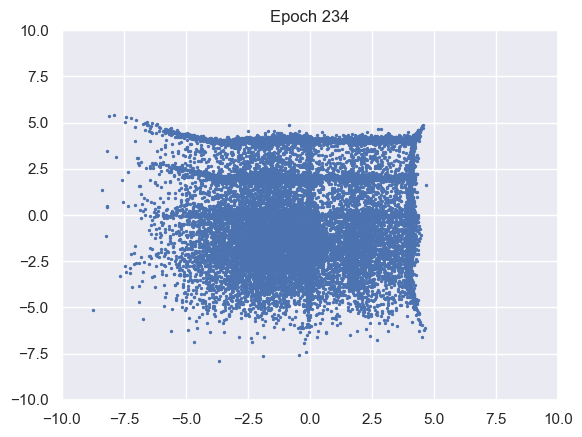

100%|██████████| 976/976 [00:10<00:00, 89.82it/s]


D loss : 1.1266, GP_loss : 0 G_loss : -0.822, MI : 4.1906


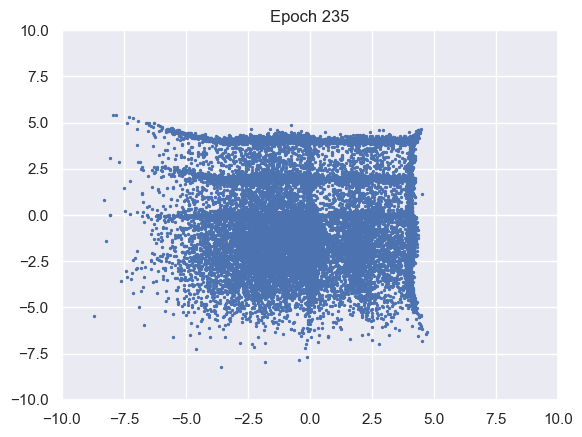

100%|██████████| 976/976 [00:11<00:00, 87.11it/s]


D loss : 1.1251, GP_loss : 0 G_loss : -0.8194, MI : 4.5139


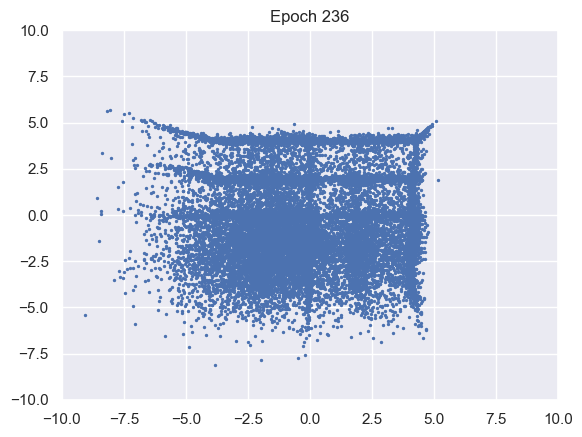

100%|██████████| 976/976 [00:11<00:00, 87.52it/s]


D loss : 1.1221, GP_loss : 0 G_loss : -0.821, MI : 4.7685


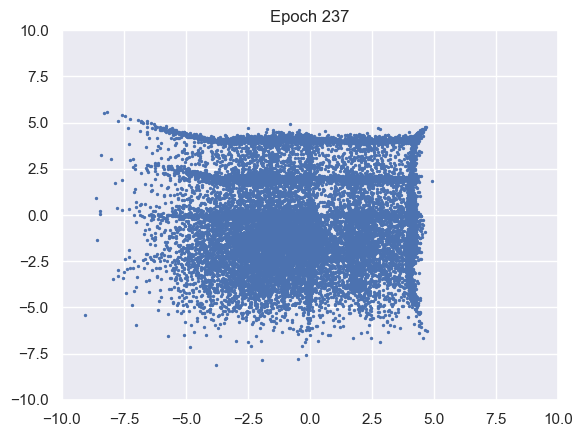

100%|██████████| 976/976 [00:11<00:00, 87.58it/s]


D loss : 1.1223, GP_loss : 0 G_loss : -0.8192, MI : 4.4257


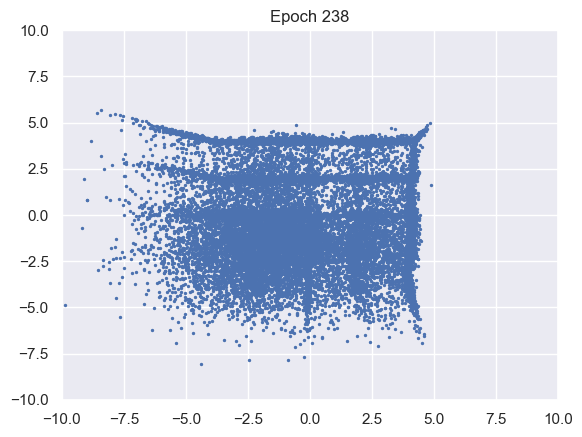

100%|██████████| 976/976 [00:11<00:00, 88.09it/s]


D loss : 1.1203, GP_loss : 0 G_loss : -0.8186, MI : 4.7002


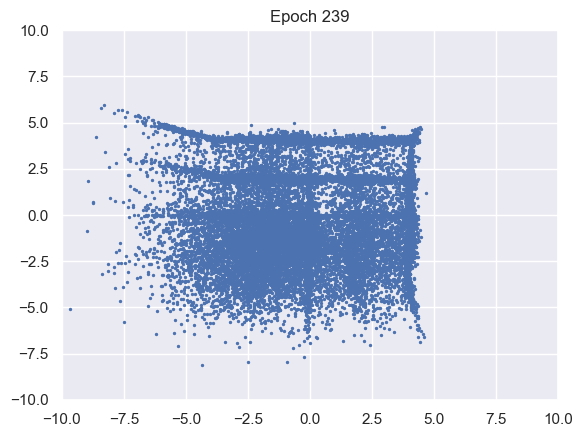

100%|██████████| 976/976 [00:11<00:00, 83.74it/s]


D loss : 1.1229, GP_loss : 0 G_loss : -0.8219, MI : 4.8021


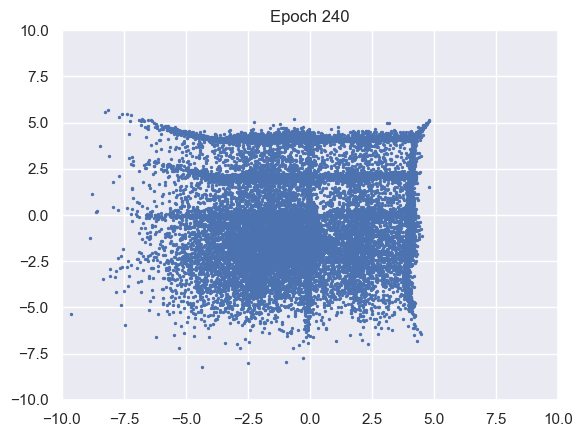

100%|██████████| 976/976 [00:11<00:00, 85.03it/s]


D loss : 1.121, GP_loss : 0 G_loss : -0.8233, MI : 4.7424


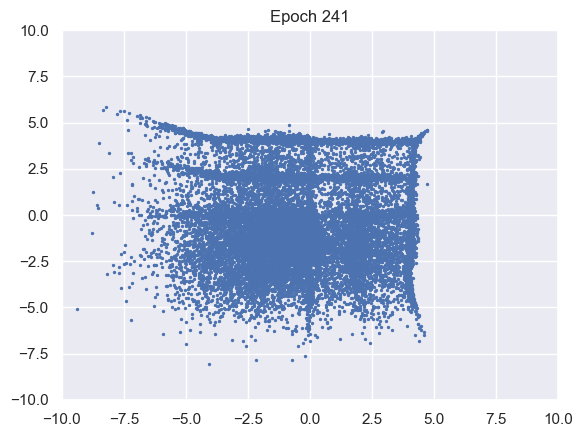

100%|██████████| 976/976 [00:11<00:00, 86.44it/s]


D loss : 1.1203, GP_loss : 0 G_loss : -0.821, MI : 4.7134


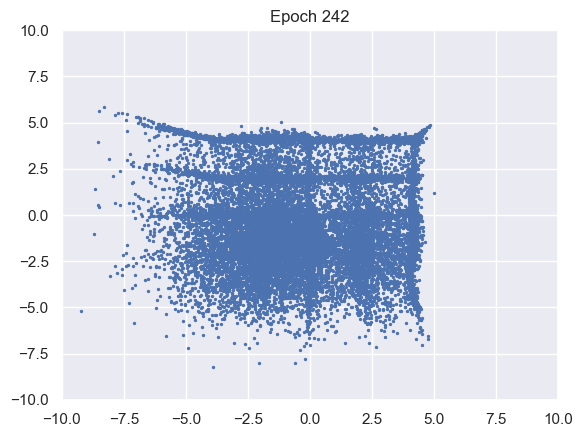

100%|██████████| 976/976 [00:11<00:00, 85.23it/s]


D loss : 1.1202, GP_loss : 0 G_loss : -0.8216, MI : 4.7531


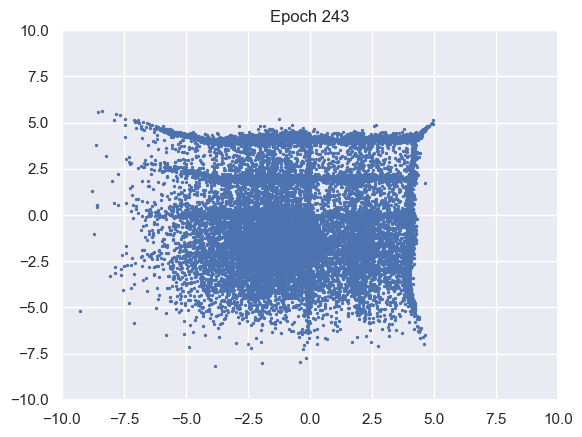

100%|██████████| 976/976 [00:11<00:00, 87.25it/s]


D loss : 1.1226, GP_loss : 0 G_loss : -0.8218, MI : 0.247


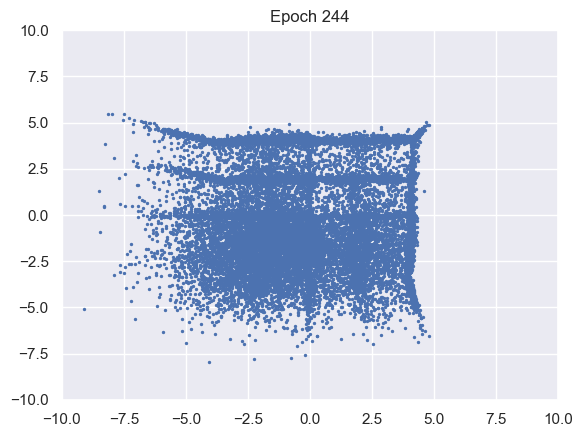

100%|██████████| 976/976 [00:11<00:00, 86.38it/s]


D loss : 1.1222, GP_loss : 0 G_loss : -0.8242, MI : 4.9192


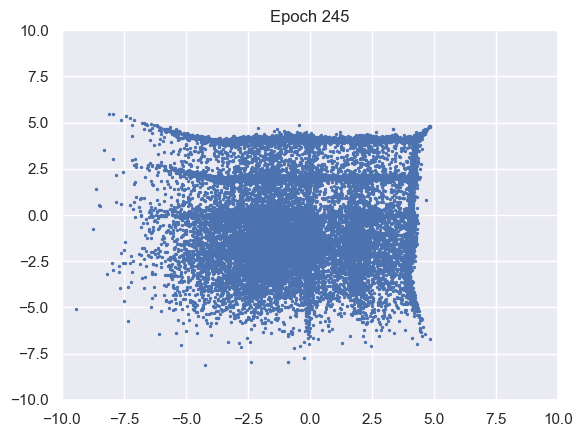

100%|██████████| 976/976 [00:11<00:00, 85.58it/s]


D loss : 1.1237, GP_loss : 0 G_loss : -0.8225, MI : 4.9717


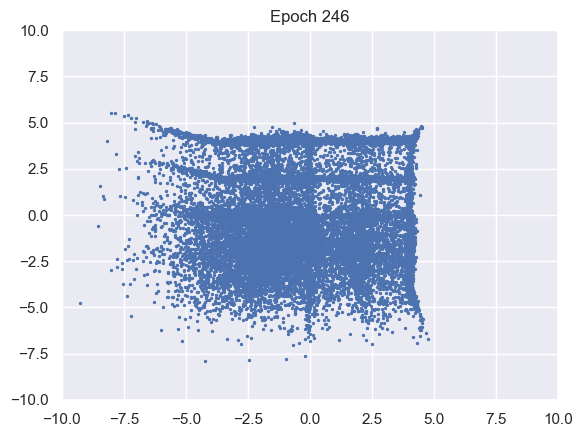

100%|██████████| 976/976 [00:11<00:00, 87.13it/s]


D loss : 1.1247, GP_loss : 0 G_loss : -0.8231, MI : 2.4386


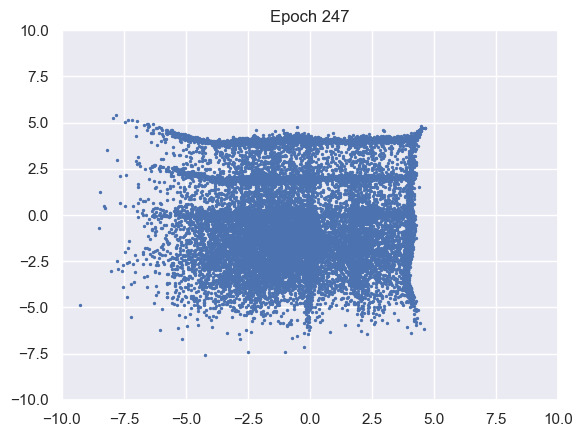

100%|██████████| 976/976 [00:11<00:00, 86.85it/s]


D loss : 1.1227, GP_loss : 0 G_loss : -0.8221, MI : 4.8346


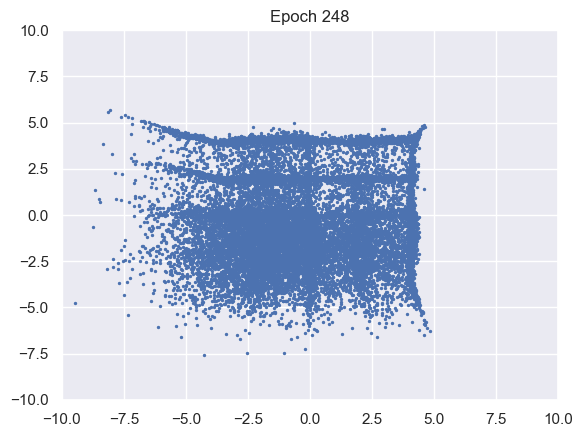

100%|██████████| 976/976 [00:11<00:00, 87.49it/s]


D loss : 1.1281, GP_loss : 0 G_loss : -0.8219, MI : 4.9256


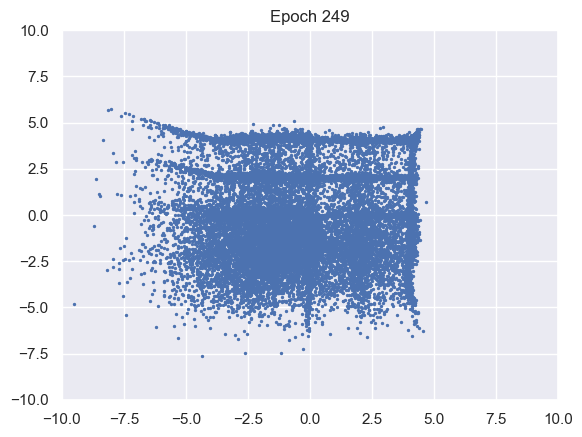

100%|██████████| 976/976 [00:11<00:00, 86.22it/s]


D loss : 1.1266, GP_loss : 0 G_loss : -0.8194, MI : 4.2805


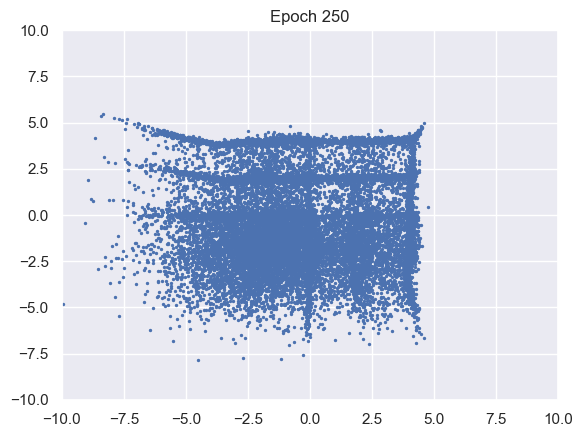

100%|██████████| 976/976 [00:11<00:00, 86.68it/s]


D loss : 1.125, GP_loss : 0 G_loss : -0.819, MI : 4.9084


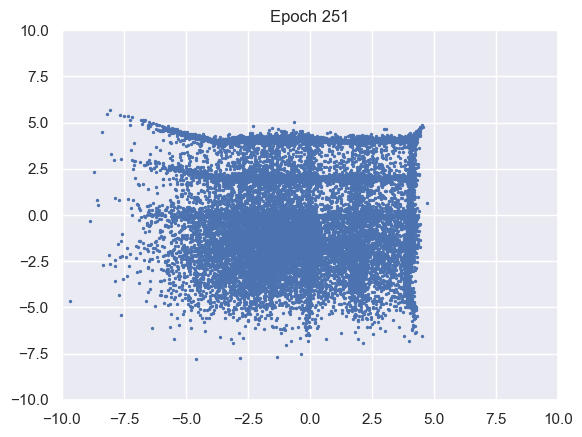

100%|██████████| 976/976 [00:11<00:00, 87.53it/s]


D loss : 1.1258, GP_loss : 0 G_loss : -0.8209, MI : 4.7083


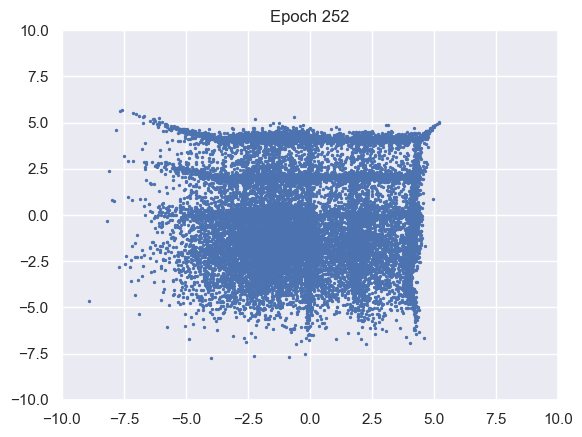

100%|██████████| 976/976 [00:11<00:00, 86.67it/s]


D loss : 1.127, GP_loss : 0 G_loss : -0.8234, MI : 4.4197


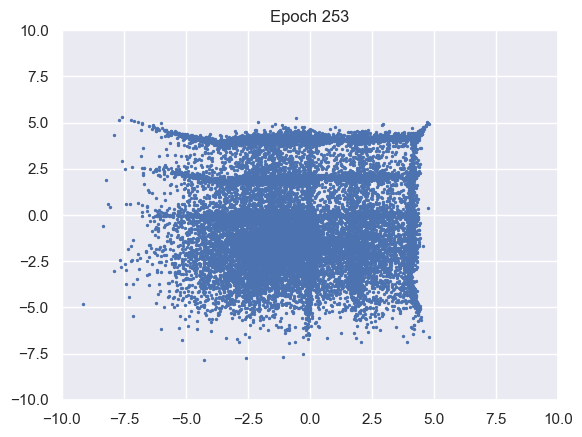

100%|██████████| 976/976 [00:11<00:00, 87.75it/s]


D loss : 1.1285, GP_loss : 0 G_loss : -0.8251, MI : 4.7648


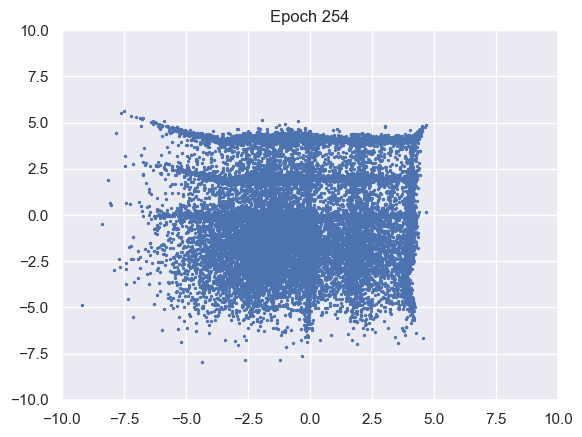

100%|██████████| 976/976 [00:11<00:00, 87.14it/s]


D loss : 1.1283, GP_loss : 0 G_loss : -0.8232, MI : 4.8704


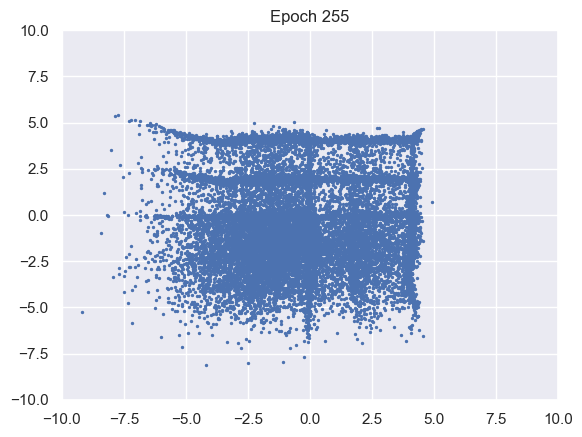

100%|██████████| 976/976 [00:10<00:00, 89.10it/s]


D loss : 1.1272, GP_loss : 0 G_loss : -0.8246, MI : 2.9717


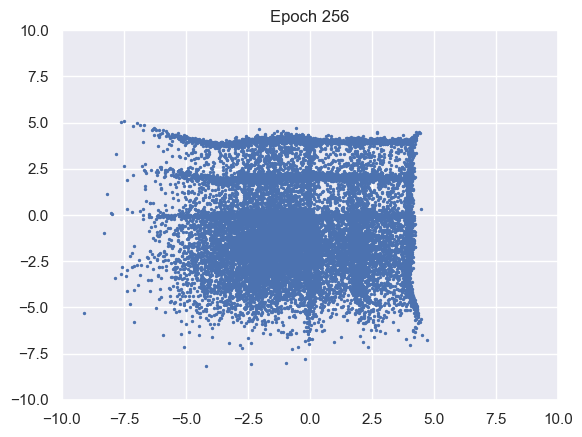

100%|██████████| 976/976 [00:11<00:00, 81.83it/s]


D loss : 1.1276, GP_loss : 0 G_loss : -0.826, MI : 4.8833


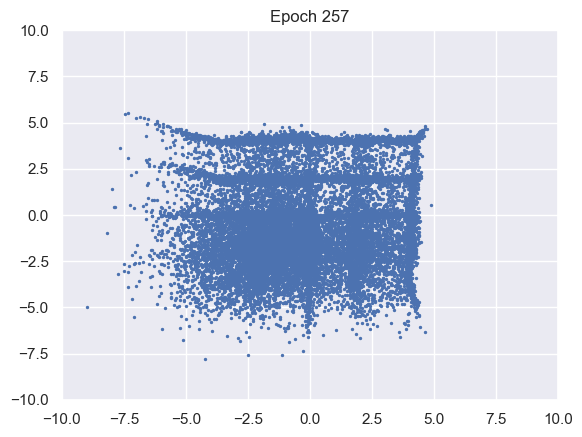

100%|██████████| 976/976 [00:12<00:00, 78.67it/s]


D loss : 1.1271, GP_loss : 0 G_loss : -0.8229, MI : 4.5163


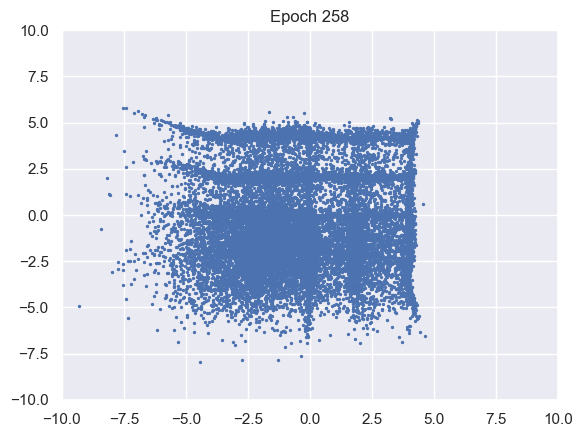

100%|██████████| 976/976 [00:11<00:00, 84.08it/s]


D loss : 1.1295, GP_loss : 0 G_loss : -0.8267, MI : 4.8806


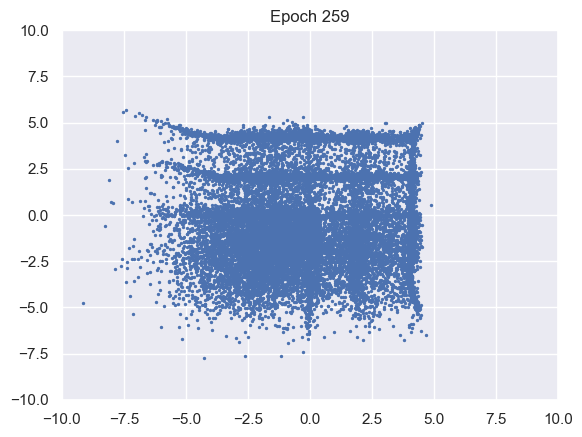

100%|██████████| 976/976 [00:11<00:00, 84.30it/s]


D loss : 1.1311, GP_loss : 0 G_loss : -0.8232, MI : 4.9621


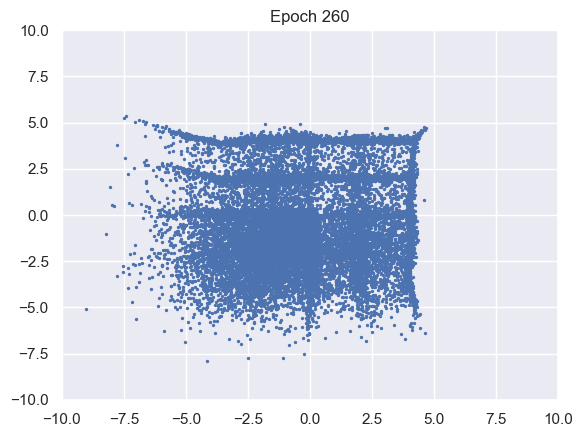

100%|██████████| 976/976 [00:11<00:00, 83.53it/s]


D loss : 1.126, GP_loss : 0 G_loss : -0.8228, MI : 4.7107


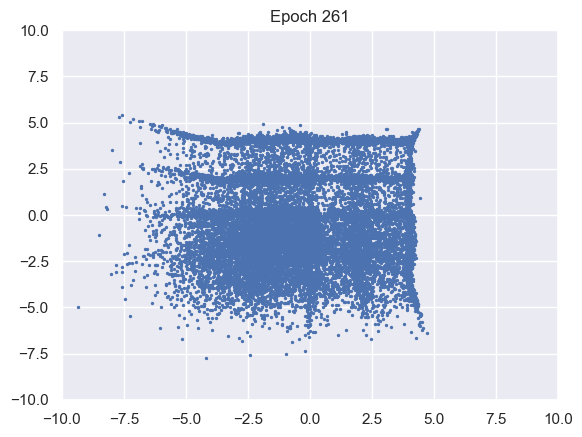

100%|██████████| 976/976 [00:11<00:00, 84.63it/s]


D loss : 1.1282, GP_loss : 0 G_loss : -0.8234, MI : 4.6405


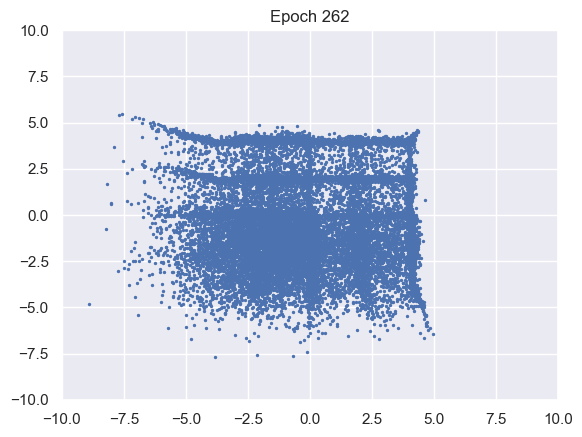

100%|██████████| 976/976 [00:11<00:00, 86.66it/s]


D loss : 1.1321, GP_loss : 0 G_loss : -0.8246, MI : 4.7412


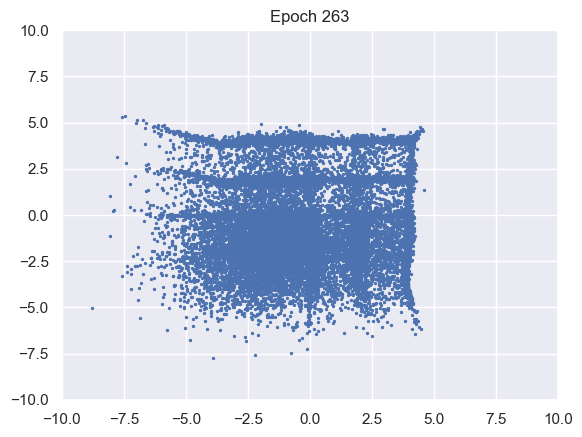

100%|██████████| 976/976 [00:11<00:00, 85.27it/s]


D loss : 1.1336, GP_loss : 0 G_loss : -0.8237, MI : 4.1428


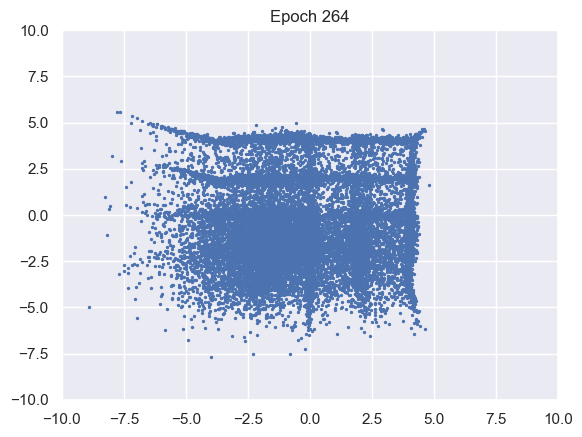

100%|██████████| 976/976 [00:11<00:00, 85.63it/s]


D loss : 1.133, GP_loss : 0 G_loss : -0.8224, MI : 4.4059


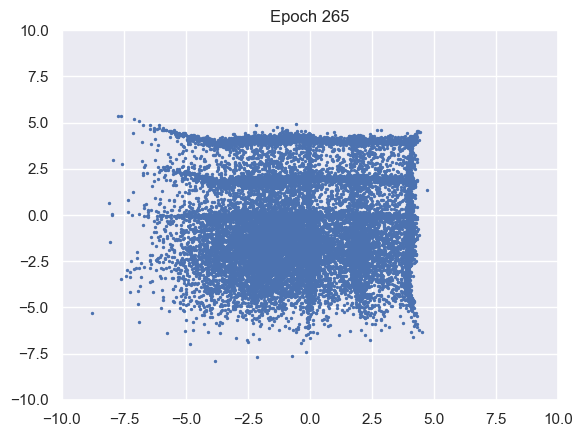

100%|██████████| 976/976 [00:11<00:00, 85.30it/s]


D loss : 1.1305, GP_loss : 0 G_loss : -0.8223, MI : 4.5709


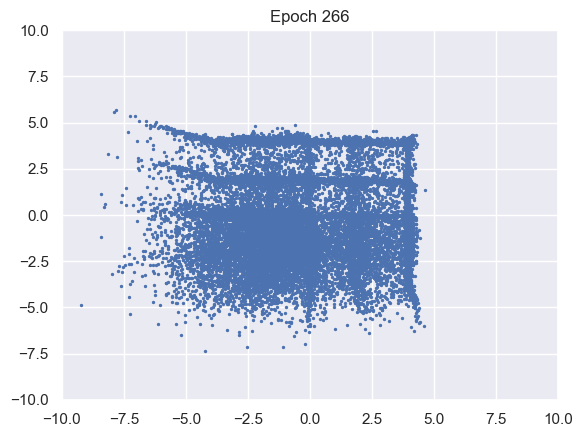

100%|██████████| 976/976 [00:11<00:00, 86.13it/s]


D loss : 1.1305, GP_loss : 0 G_loss : -0.8242, MI : 4.7745


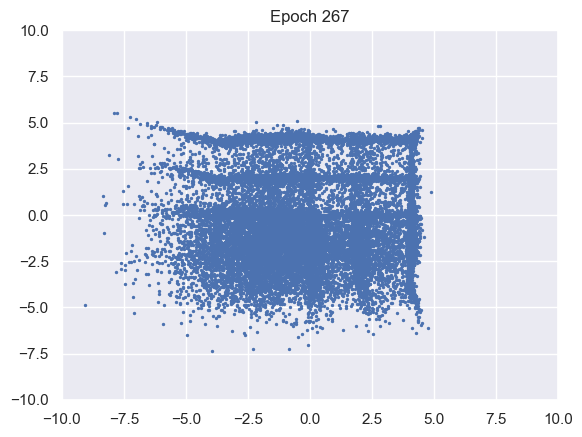

100%|██████████| 976/976 [00:11<00:00, 86.56it/s]


D loss : 1.1326, GP_loss : 0 G_loss : -0.8217, MI : 4.5046


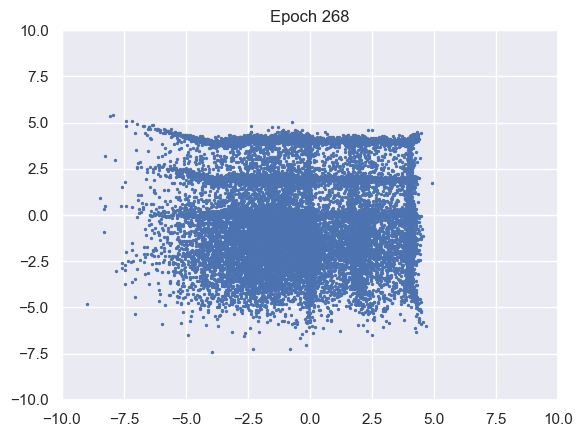

100%|██████████| 976/976 [00:10<00:00, 88.88it/s]


D loss : 1.1321, GP_loss : 0 G_loss : -0.824, MI : 4.5521


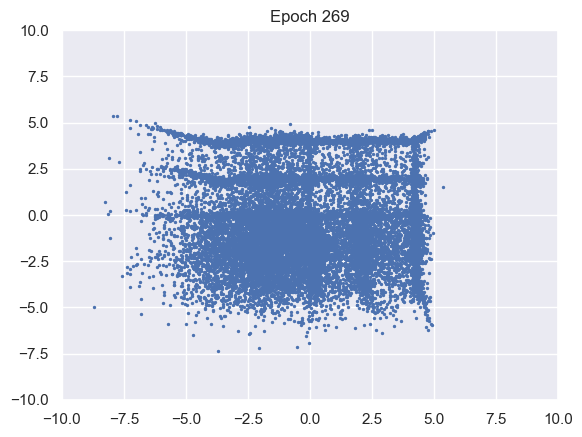

100%|██████████| 976/976 [00:10<00:00, 89.15it/s]


D loss : 1.1343, GP_loss : 0 G_loss : -0.8248, MI : 4.8353


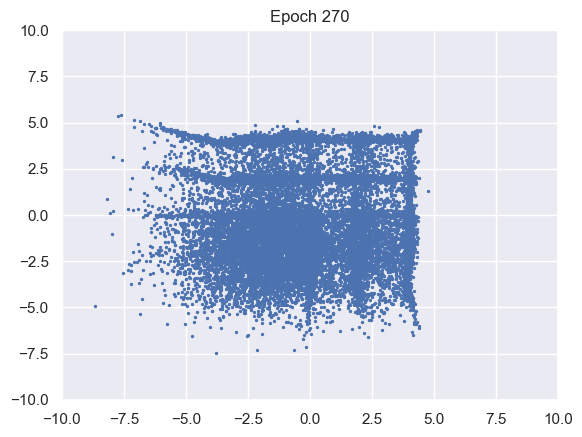

100%|██████████| 976/976 [00:11<00:00, 88.49it/s]


D loss : 1.1381, GP_loss : 0 G_loss : -0.8252, MI : 4.9066


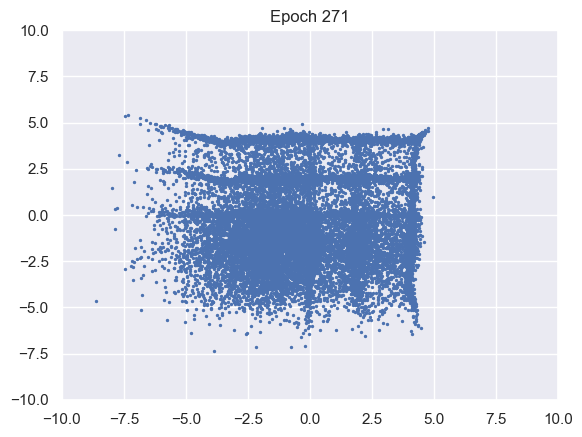

100%|██████████| 976/976 [00:11<00:00, 85.76it/s]


D loss : 1.1372, GP_loss : 0 G_loss : -0.8242, MI : 3.8816


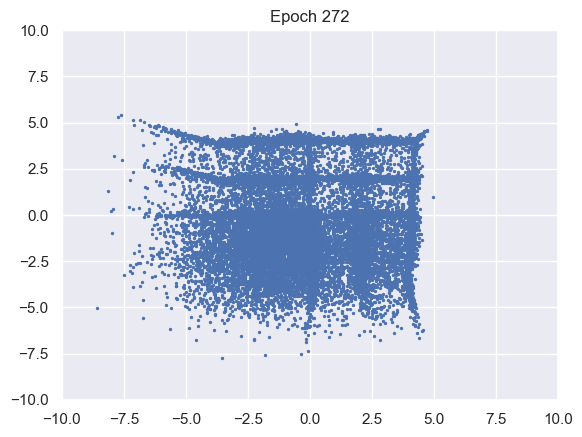

100%|██████████| 976/976 [00:11<00:00, 84.68it/s]


D loss : 1.1384, GP_loss : 0 G_loss : -0.8227, MI : 4.1267


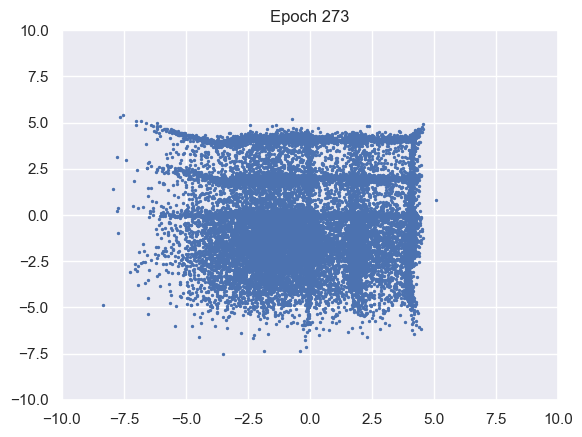

100%|██████████| 976/976 [00:11<00:00, 85.63it/s]


D loss : 1.1384, GP_loss : 0 G_loss : -0.825, MI : 4.793


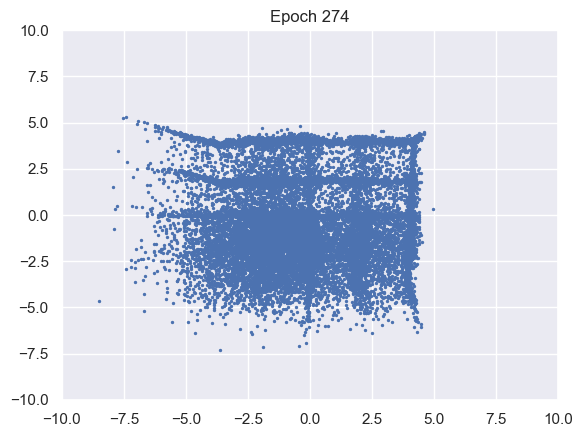

100%|██████████| 976/976 [00:11<00:00, 85.26it/s]


D loss : 1.1391, GP_loss : 0 G_loss : -0.8255, MI : 4.3329


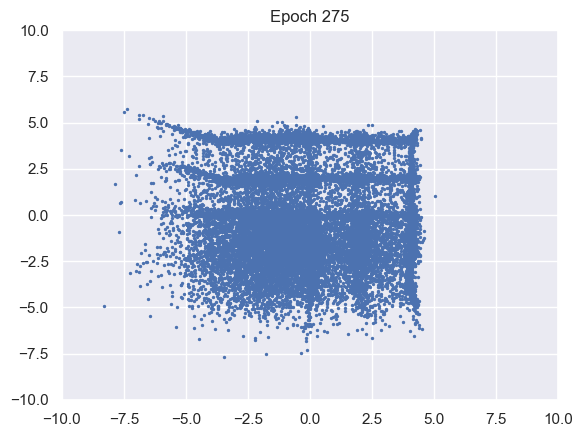

100%|██████████| 976/976 [00:11<00:00, 86.34it/s]


D loss : 1.1413, GP_loss : 0 G_loss : -0.8237, MI : 4.4832


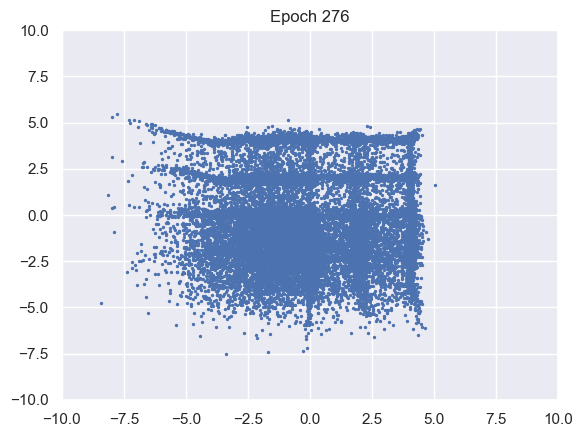

100%|██████████| 976/976 [00:11<00:00, 86.49it/s]


D loss : 1.1422, GP_loss : 0 G_loss : -0.823, MI : 4.8954


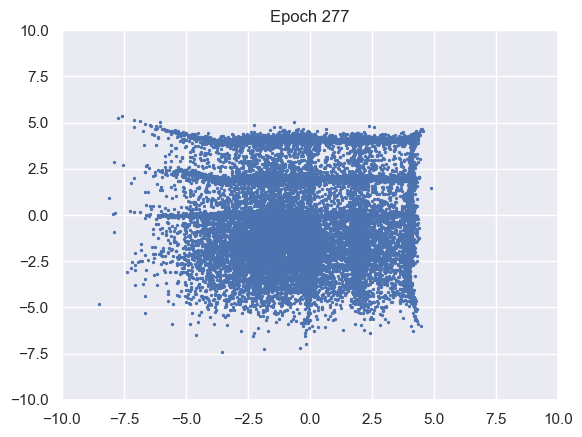

100%|██████████| 976/976 [00:11<00:00, 87.27it/s]


D loss : 1.1387, GP_loss : 0 G_loss : -0.823, MI : 4.8459


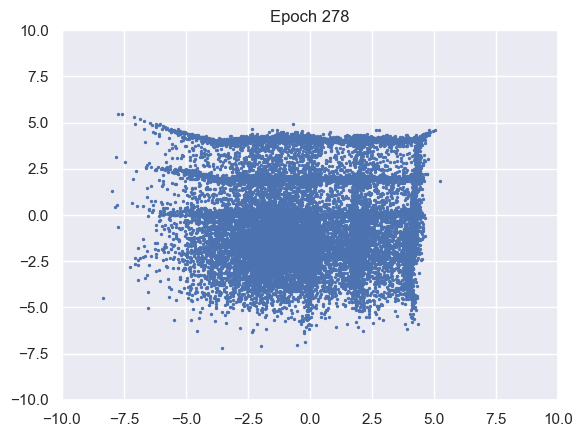

100%|██████████| 976/976 [00:11<00:00, 85.66it/s]


D loss : 1.1415, GP_loss : 0 G_loss : -0.8253, MI : 4.86


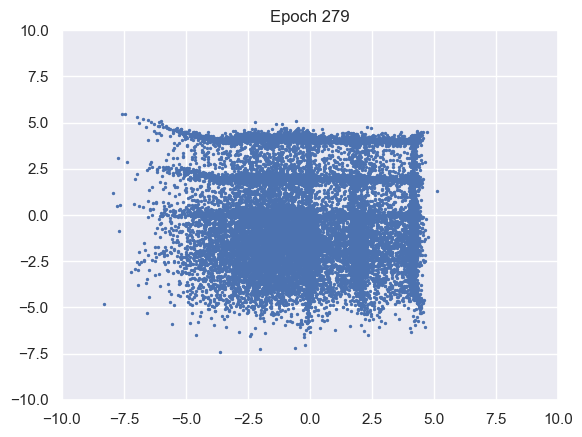

100%|██████████| 976/976 [00:11<00:00, 87.68it/s]


D loss : 1.1384, GP_loss : 0 G_loss : -0.8251, MI : 4.777


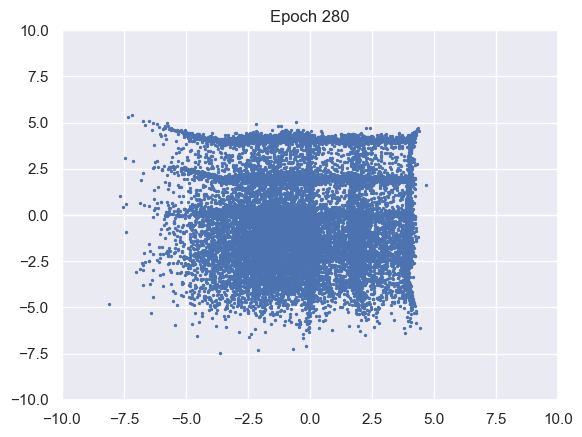

100%|██████████| 976/976 [00:11<00:00, 88.18it/s]


D loss : 1.1394, GP_loss : 0 G_loss : -0.8256, MI : 2.4723


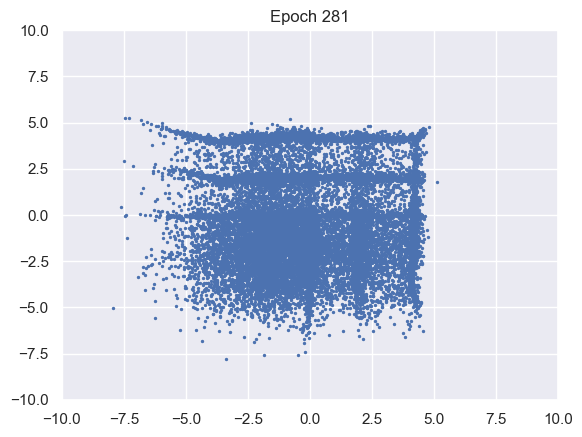

100%|██████████| 976/976 [00:11<00:00, 86.37it/s]


D loss : 1.1404, GP_loss : 0 G_loss : -0.8253, MI : 3.4874


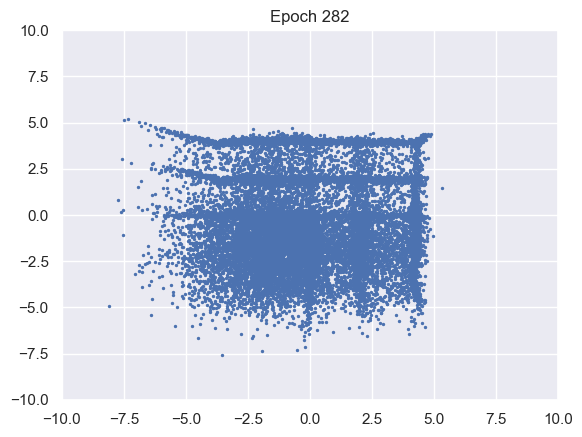

100%|██████████| 976/976 [00:11<00:00, 88.19it/s]


D loss : 1.1405, GP_loss : 0 G_loss : -0.8264, MI : 3.8563


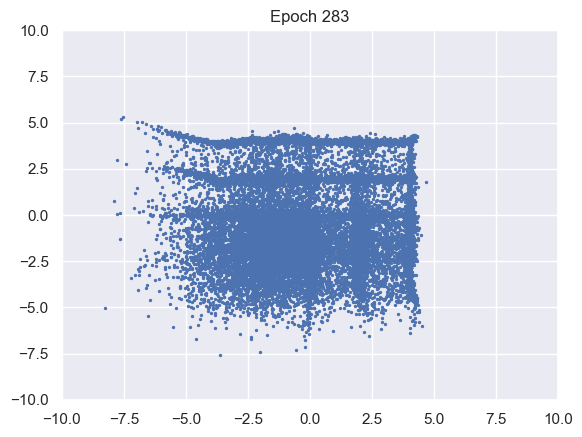

100%|██████████| 976/976 [00:11<00:00, 83.65it/s]


D loss : 1.1383, GP_loss : 0 G_loss : -0.8259, MI : 4.9719


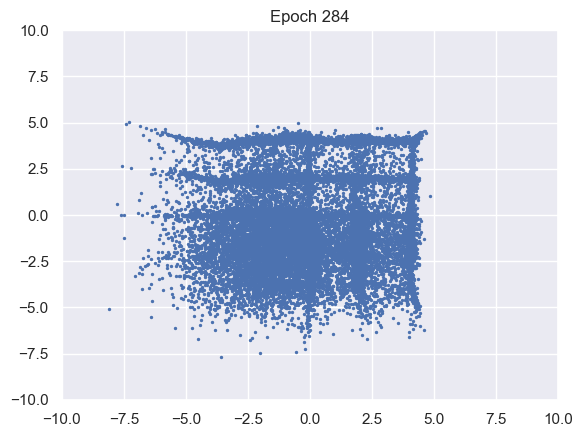

100%|██████████| 976/976 [00:11<00:00, 85.95it/s]


D loss : 1.1375, GP_loss : 0 G_loss : -0.827, MI : 4.8255


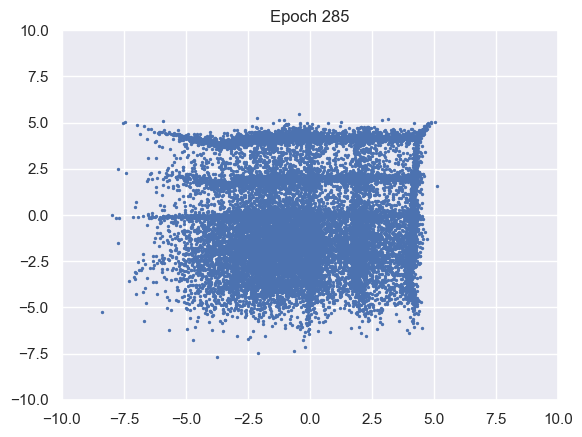

100%|██████████| 976/976 [00:11<00:00, 86.03it/s]


D loss : 1.1387, GP_loss : 0 G_loss : -0.8279, MI : 3.2408


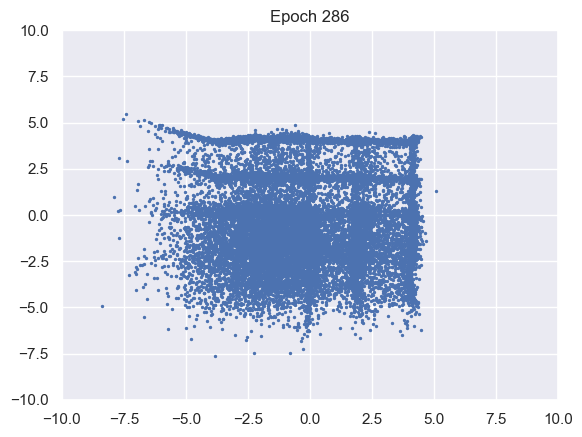

100%|██████████| 976/976 [00:11<00:00, 86.01it/s]


D loss : 1.1383, GP_loss : 0 G_loss : -0.8282, MI : 4.5036


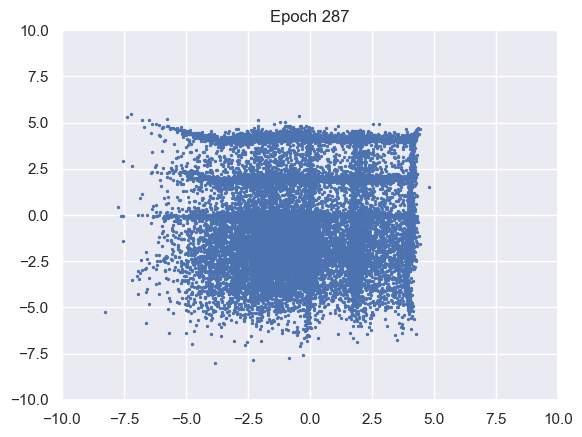

100%|██████████| 976/976 [00:10<00:00, 93.66it/s] 


D loss : 1.1382, GP_loss : 0 G_loss : -0.8277, MI : 4.9094


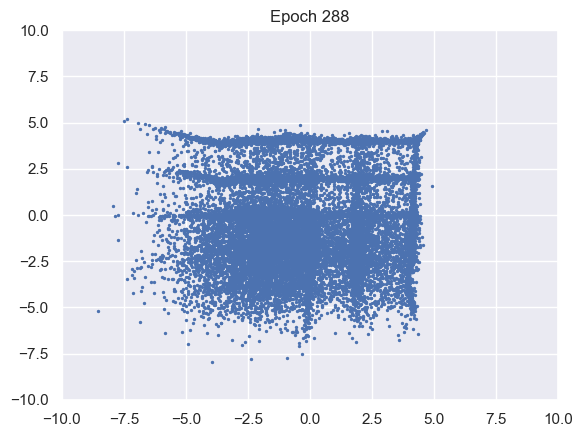

100%|██████████| 976/976 [00:09<00:00, 101.35it/s]


D loss : 1.138, GP_loss : 0 G_loss : -0.8292, MI : 2.9556


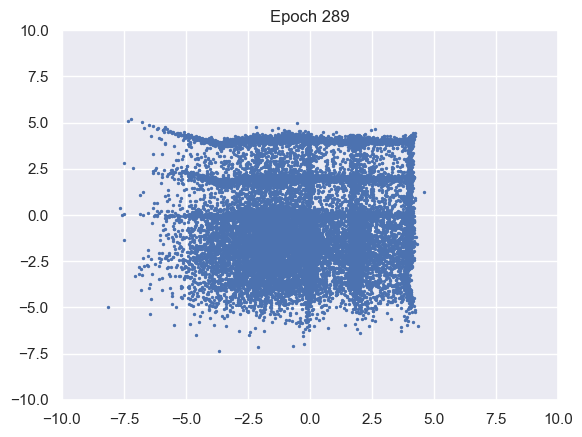

100%|██████████| 976/976 [00:09<00:00, 101.74it/s]


D loss : 1.1399, GP_loss : 0 G_loss : -0.8303, MI : 4.5787


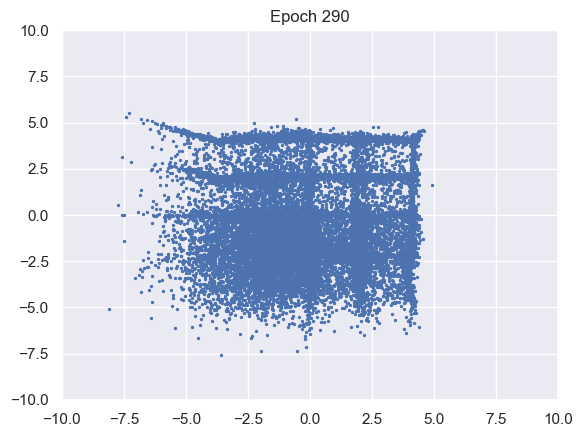

100%|██████████| 976/976 [00:09<00:00, 102.21it/s]


D loss : 1.1418, GP_loss : 0 G_loss : -0.8294, MI : 4.4258


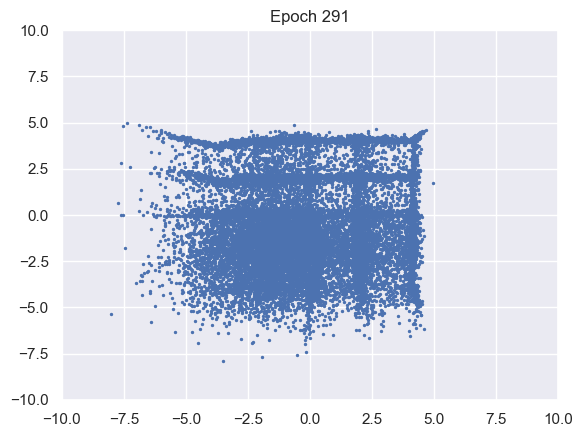

100%|██████████| 976/976 [00:09<00:00, 102.67it/s]


D loss : 1.139, GP_loss : 0 G_loss : -0.8307, MI : 4.942


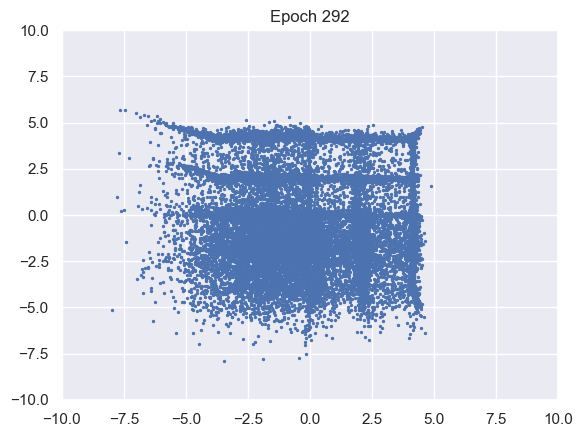

100%|██████████| 976/976 [00:09<00:00, 102.05it/s]


D loss : 1.138, GP_loss : 0 G_loss : -0.8311, MI : 4.6893


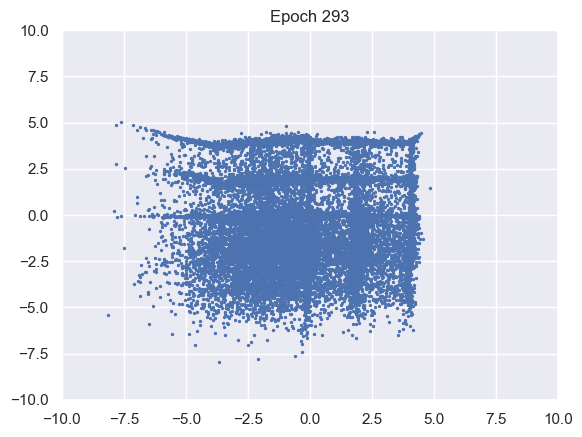

100%|██████████| 976/976 [00:10<00:00, 96.28it/s]


D loss : 1.1392, GP_loss : 0 G_loss : -0.8321, MI : 4.7117


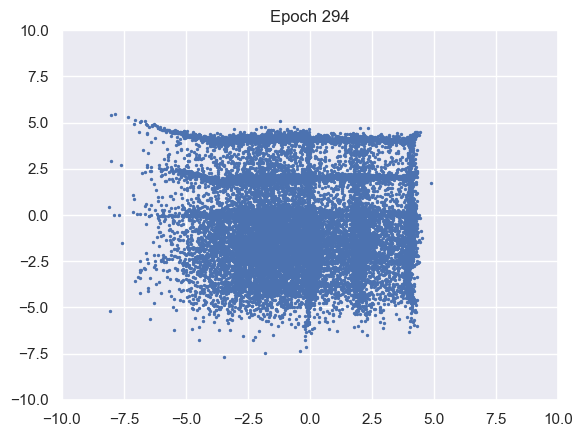

100%|██████████| 976/976 [00:09<00:00, 97.68it/s] 


D loss : 1.1406, GP_loss : 0 G_loss : -0.83, MI : 4.7089


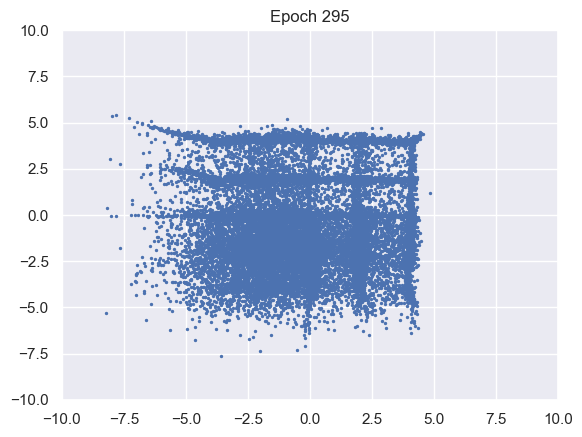

100%|██████████| 976/976 [00:10<00:00, 96.74it/s]


D loss : 1.1386, GP_loss : 0 G_loss : -0.8297, MI : 4.4276


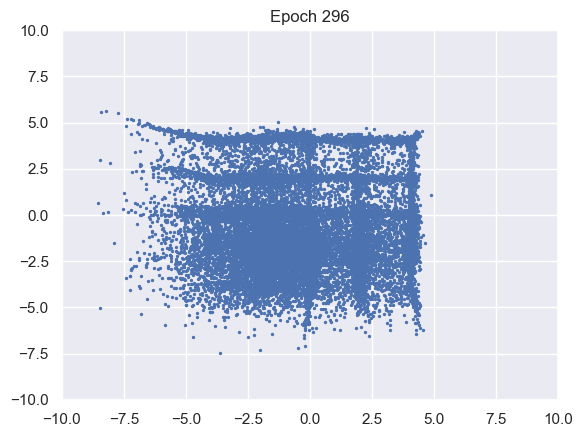

100%|██████████| 976/976 [00:10<00:00, 95.72it/s]


D loss : 1.1394, GP_loss : 0 G_loss : -0.8282, MI : 4.6902


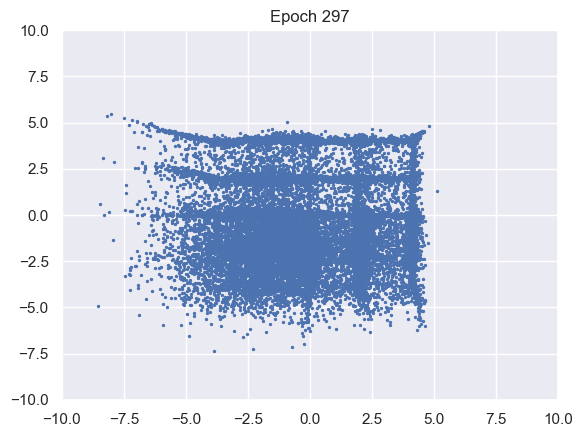

100%|██████████| 976/976 [00:10<00:00, 97.38it/s] 


D loss : 1.1431, GP_loss : 0 G_loss : -0.8291, MI : 4.4243


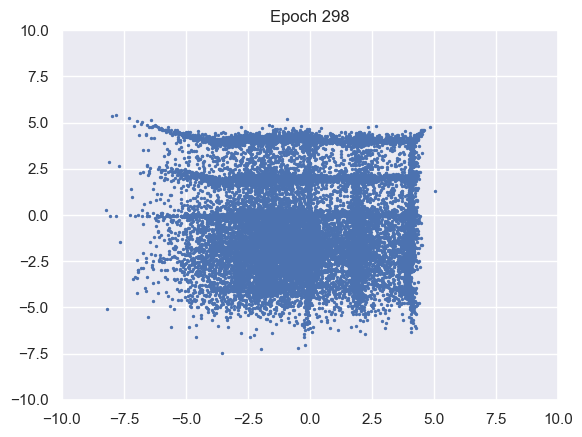

100%|██████████| 976/976 [00:09<00:00, 98.92it/s] 


D loss : 1.1446, GP_loss : 0 G_loss : -0.8311, MI : 4.6718


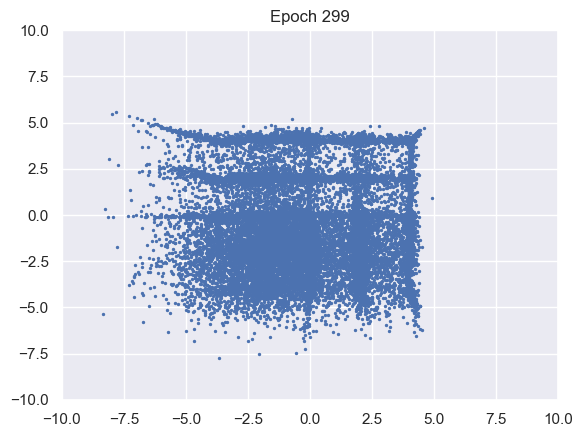

100%|██████████| 976/976 [00:10<00:00, 97.50it/s] 


D loss : 1.146, GP_loss : 0 G_loss : -0.8317, MI : 4.0575


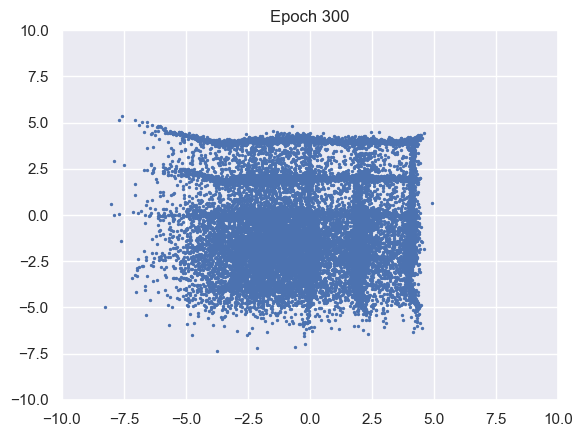

100%|██████████| 976/976 [00:10<00:00, 97.29it/s] 


D loss : 1.1451, GP_loss : 0 G_loss : -0.8318, MI : 4.645


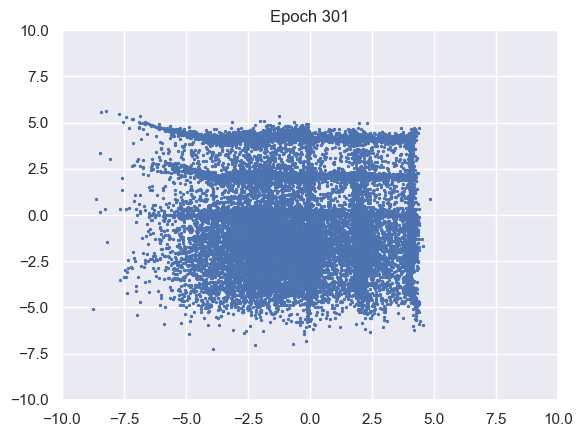

100%|██████████| 976/976 [00:10<00:00, 97.00it/s] 


D loss : 1.1469, GP_loss : 0 G_loss : -0.8314, MI : 4.6612


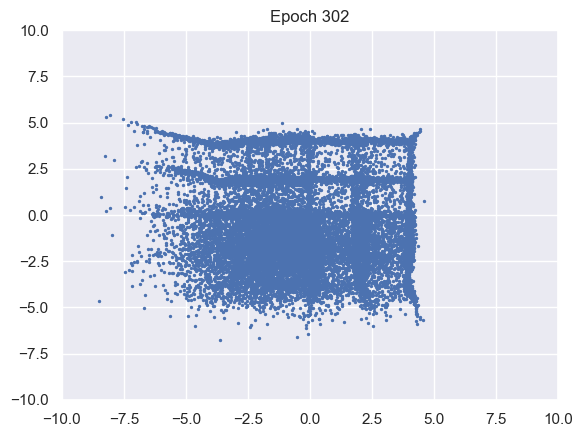

100%|██████████| 976/976 [00:09<00:00, 99.23it/s] 


D loss : 1.1509, GP_loss : 0 G_loss : -0.8318, MI : 4.2505


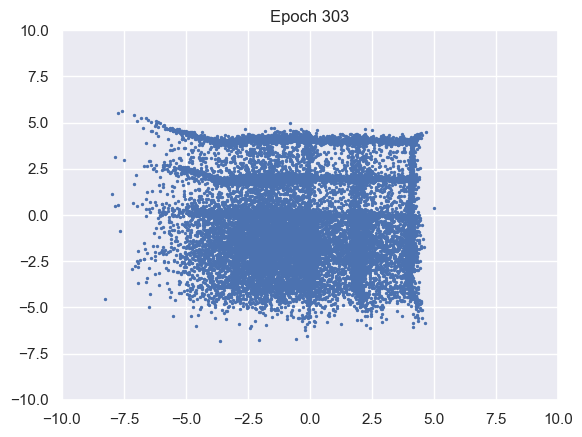

100%|██████████| 976/976 [00:09<00:00, 97.87it/s] 


D loss : 1.1533, GP_loss : 0 G_loss : -0.8323, MI : 4.775


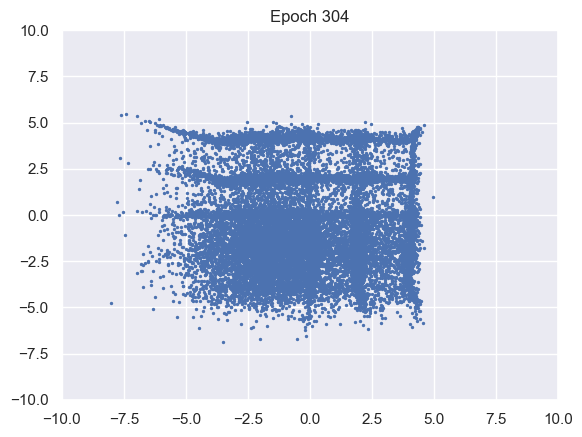

100%|██████████| 976/976 [00:09<00:00, 97.61it/s] 


D loss : 1.1576, GP_loss : 0 G_loss : -0.8323, MI : 4.4652


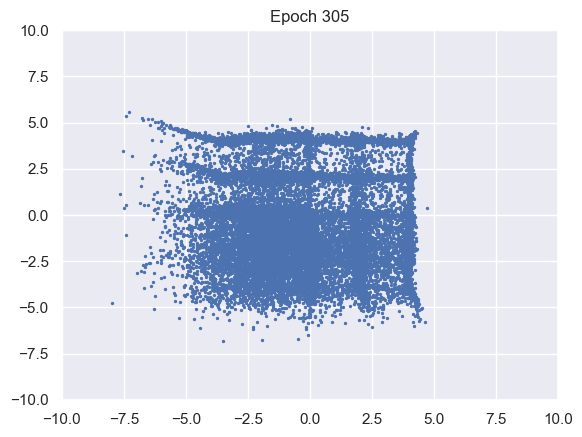

100%|██████████| 976/976 [00:10<00:00, 95.91it/s]


D loss : 1.1593, GP_loss : 0 G_loss : -0.8322, MI : 4.7416


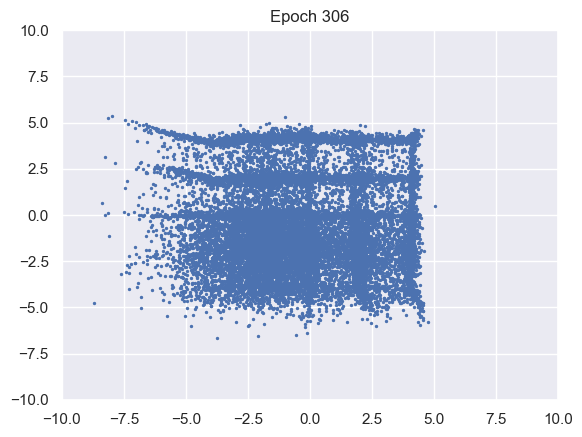

100%|██████████| 976/976 [00:10<00:00, 96.12it/s] 


D loss : 1.1607, GP_loss : 0 G_loss : -0.8337, MI : 4.4596


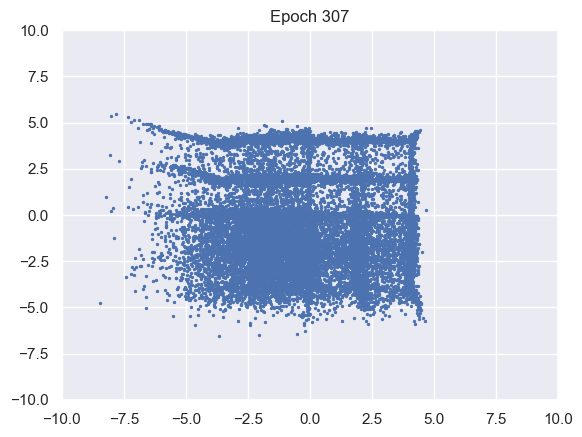

100%|██████████| 976/976 [00:09<00:00, 101.15it/s]


D loss : 1.1653, GP_loss : 0 G_loss : -0.8316, MI : 4.6982


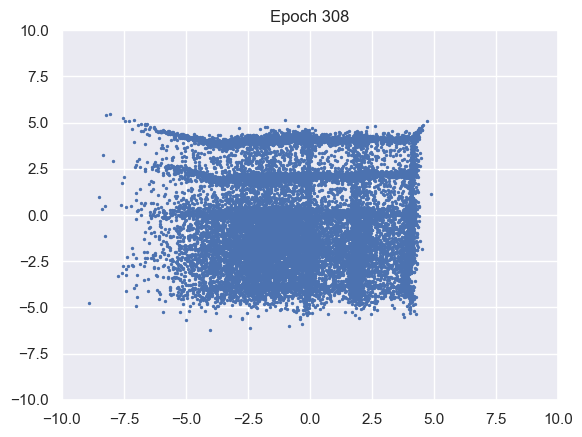

100%|██████████| 976/976 [00:10<00:00, 96.69it/s]


D loss : 1.1712, GP_loss : 0 G_loss : -0.8309, MI : 4.7217


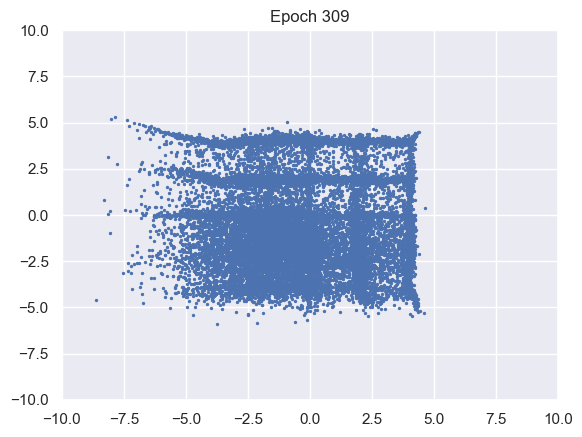

100%|██████████| 976/976 [00:09<00:00, 98.96it/s] 


D loss : 1.1763, GP_loss : 0 G_loss : -0.8293, MI : 4.2205


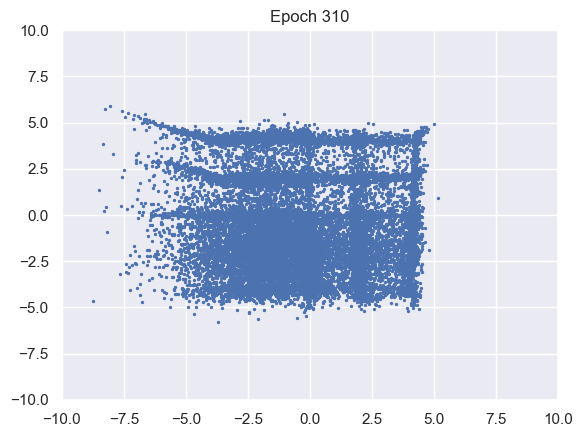

100%|██████████| 976/976 [00:10<00:00, 97.53it/s] 


D loss : 1.1848, GP_loss : 0 G_loss : -0.8255, MI : 4.6652


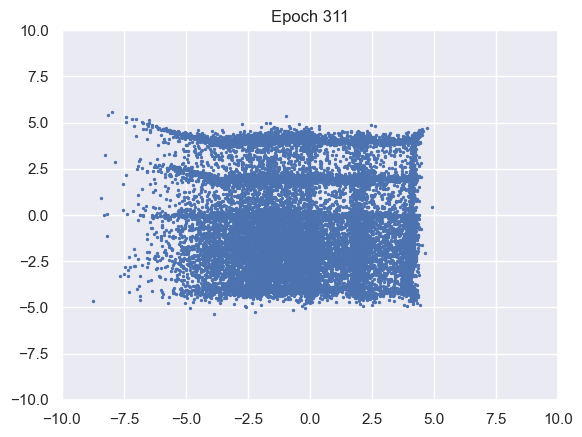

100%|██████████| 976/976 [00:10<00:00, 96.51it/s] 


D loss : 1.1895, GP_loss : 0 G_loss : -0.8209, MI : 3.9676


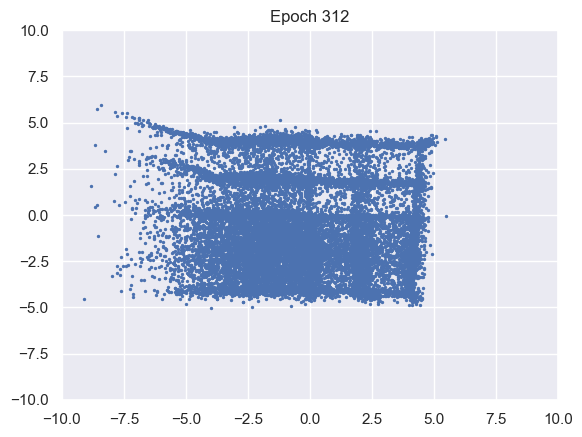

100%|██████████| 976/976 [00:09<00:00, 99.54it/s] 


D loss : 1.1957, GP_loss : 0 G_loss : -0.8165, MI : 4.7686


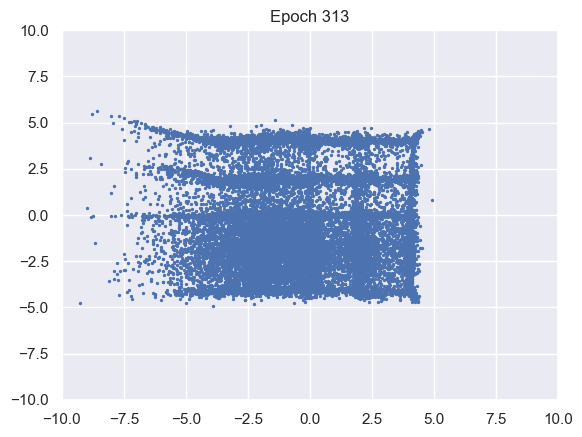

100%|██████████| 976/976 [00:09<00:00, 100.05it/s]


D loss : 1.1982, GP_loss : 0 G_loss : -0.8141, MI : 4.1552


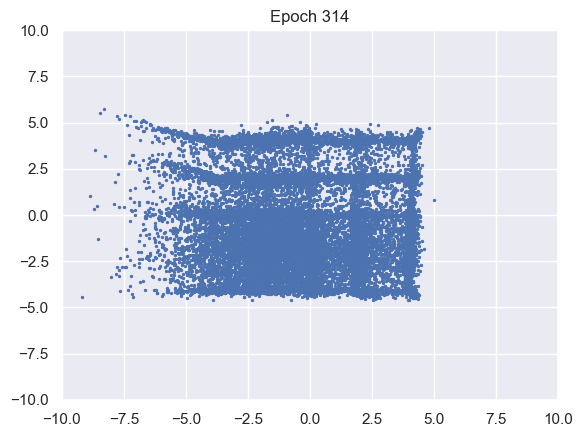

100%|██████████| 976/976 [00:09<00:00, 100.77it/s]


D loss : 1.2016, GP_loss : 0 G_loss : -0.8132, MI : 4.6448


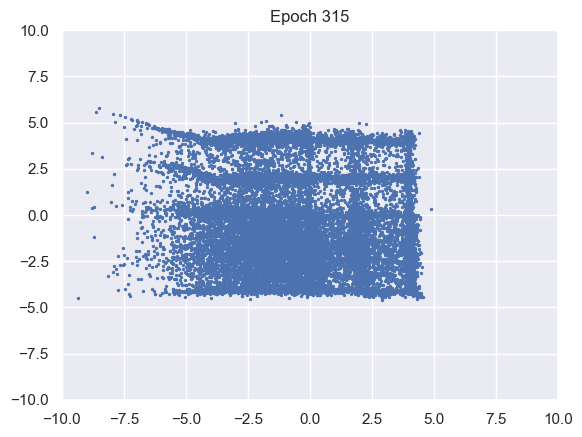

100%|██████████| 976/976 [00:09<00:00, 100.30it/s]


D loss : 1.2028, GP_loss : 0 G_loss : -0.8127, MI : 4.691


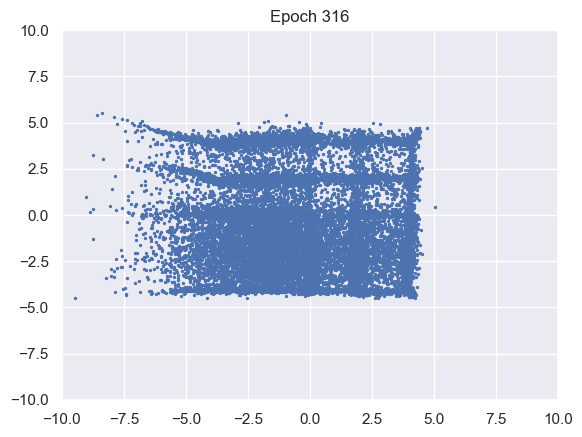

100%|██████████| 976/976 [00:09<00:00, 99.87it/s] 


D loss : 1.2048, GP_loss : 0 G_loss : -0.8091, MI : 4.3991


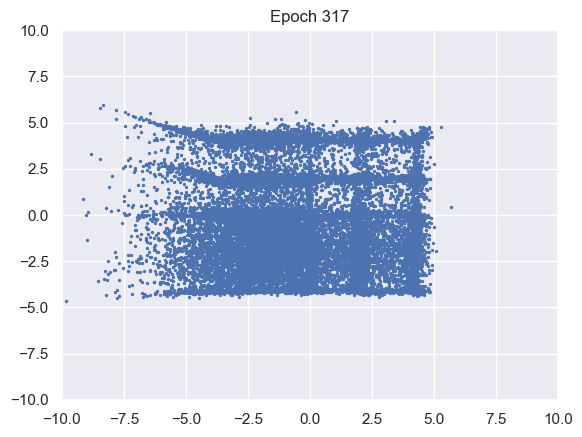

100%|██████████| 976/976 [00:09<00:00, 99.40it/s] 


D loss : 1.2048, GP_loss : 0 G_loss : -0.8091, MI : 4.5881


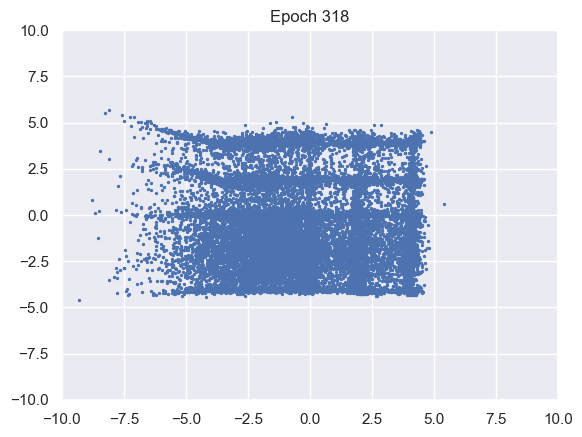

100%|██████████| 976/976 [00:09<00:00, 99.14it/s] 


D loss : 1.2074, GP_loss : 0 G_loss : -0.8104, MI : 4.6654


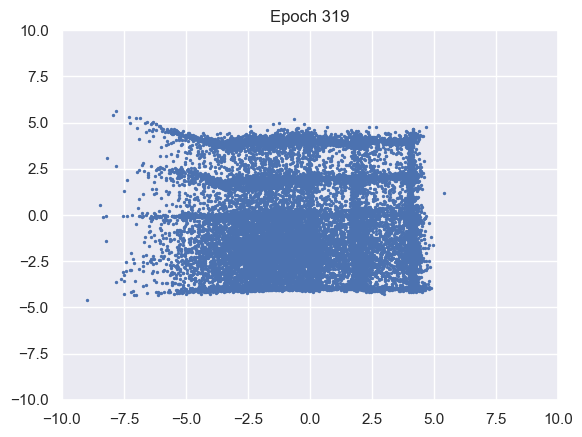

100%|██████████| 976/976 [00:09<00:00, 98.27it/s] 


D loss : 1.2066, GP_loss : 0 G_loss : -0.8104, MI : 4.1469


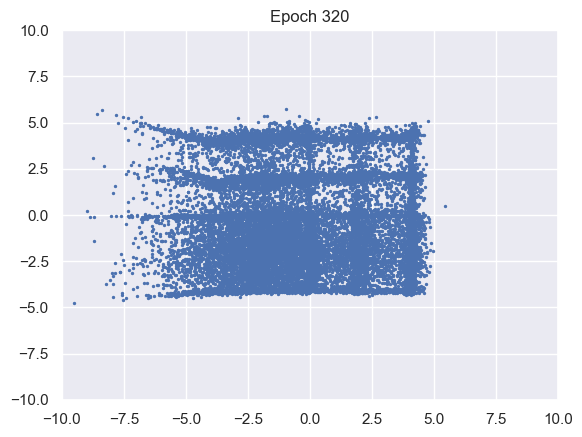

100%|██████████| 976/976 [00:09<00:00, 100.78it/s]


D loss : 1.2075, GP_loss : 0 G_loss : -0.8082, MI : 4.5227


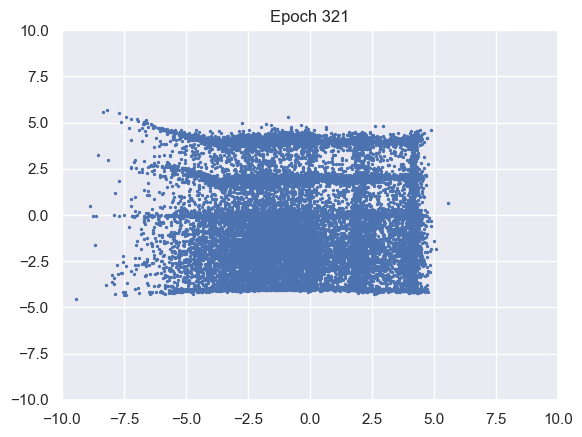

100%|██████████| 976/976 [00:09<00:00, 99.98it/s] 


D loss : 1.2104, GP_loss : 0 G_loss : -0.8092, MI : 3.713


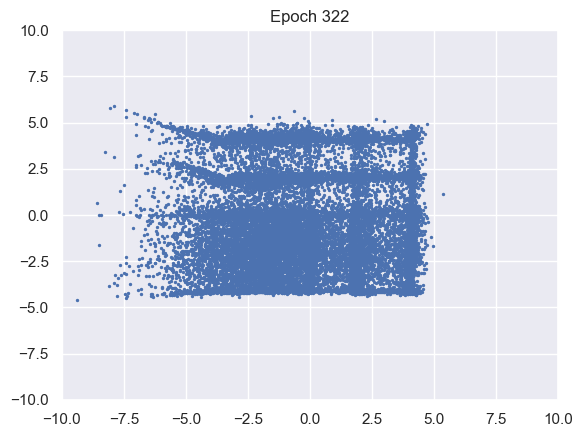

100%|██████████| 976/976 [00:09<00:00, 99.74it/s] 


D loss : 1.211, GP_loss : 0 G_loss : -0.8078, MI : 4.6624


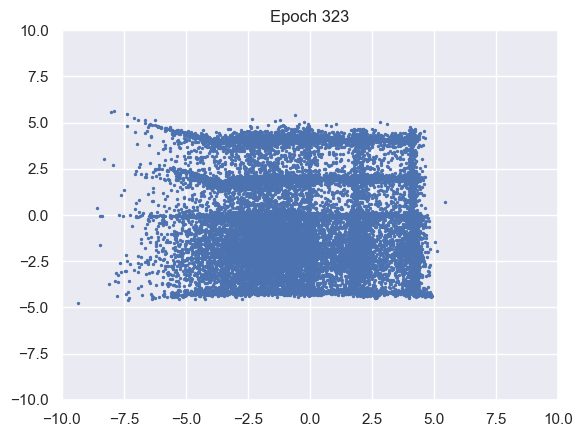

100%|██████████| 976/976 [00:09<00:00, 99.61it/s] 


D loss : 1.2088, GP_loss : 0 G_loss : -0.8083, MI : 4.6347


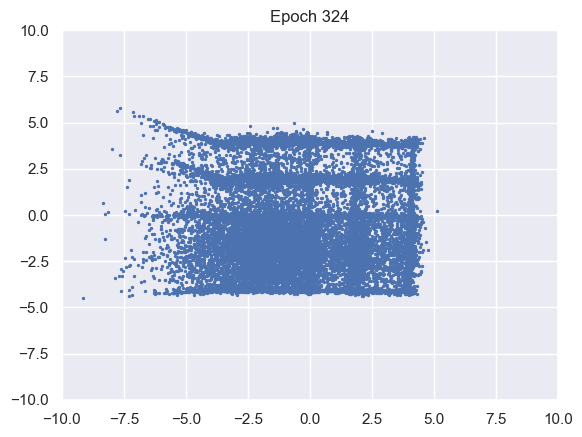

100%|██████████| 976/976 [00:09<00:00, 101.18it/s]


D loss : 1.2102, GP_loss : 0 G_loss : -0.8091, MI : 4.7555


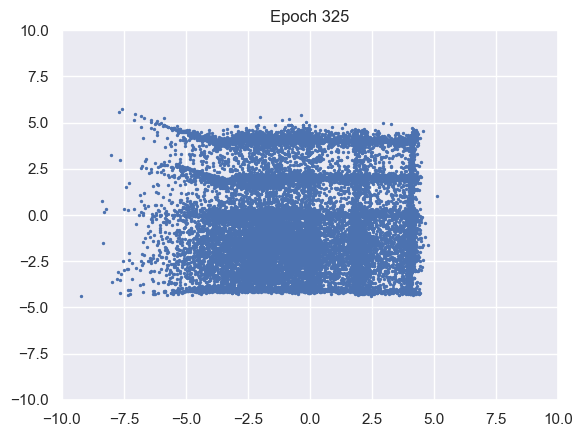

100%|██████████| 976/976 [00:09<00:00, 101.00it/s]


D loss : 1.2092, GP_loss : 0 G_loss : -0.8077, MI : 4.6761


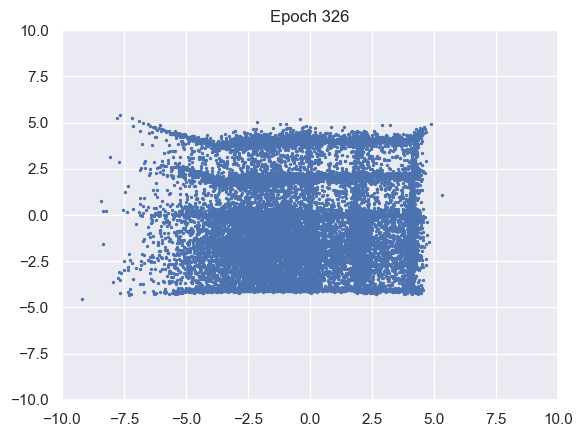

100%|██████████| 976/976 [00:09<00:00, 101.38it/s]


D loss : 1.207, GP_loss : 0 G_loss : -0.8069, MI : 2.6916


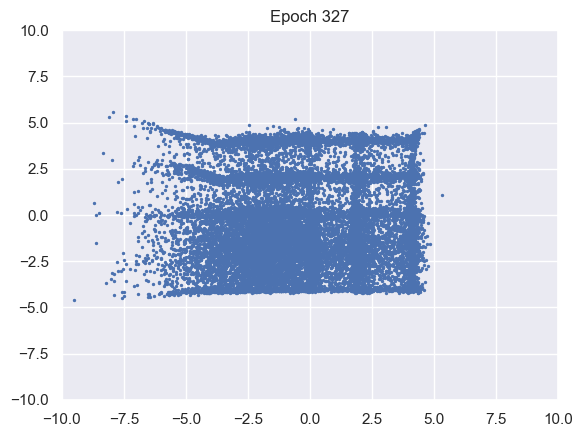

100%|██████████| 976/976 [00:09<00:00, 100.31it/s]


D loss : 1.2083, GP_loss : 0 G_loss : -0.8072, MI : 5.0067


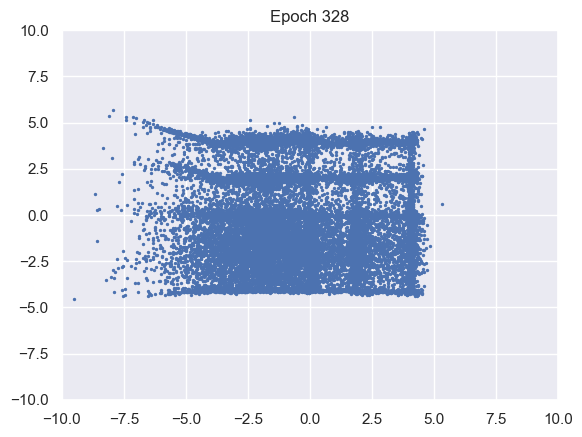

100%|██████████| 976/976 [00:09<00:00, 101.89it/s]


D loss : 1.2069, GP_loss : 0 G_loss : -0.8066, MI : 4.6746


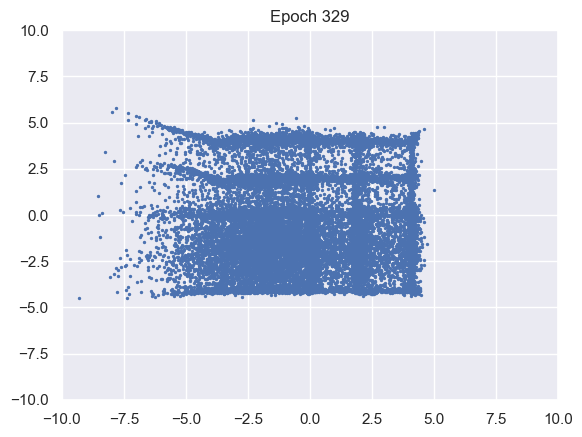

100%|██████████| 976/976 [00:09<00:00, 98.75it/s] 


D loss : 1.2079, GP_loss : 0 G_loss : -0.8081, MI : 4.6692


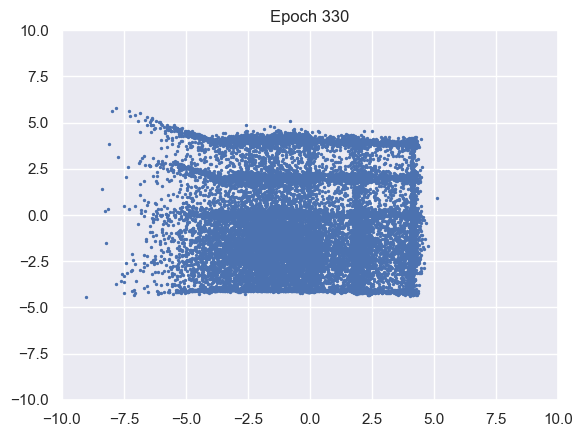

100%|██████████| 976/976 [00:09<00:00, 100.95it/s]


D loss : 1.21, GP_loss : 0 G_loss : -0.8079, MI : 4.5624


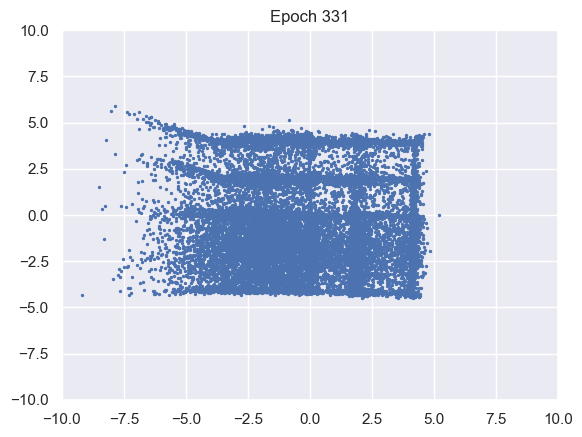

100%|██████████| 976/976 [00:09<00:00, 99.82it/s] 


D loss : 1.2096, GP_loss : 0 G_loss : -0.8069, MI : 4.7199


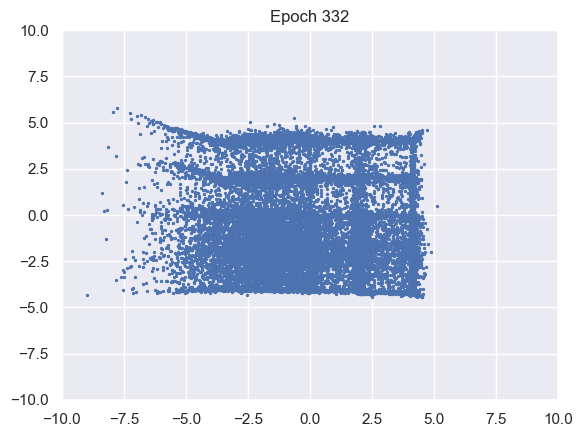

100%|██████████| 976/976 [00:09<00:00, 99.56it/s] 


D loss : 1.2067, GP_loss : 0 G_loss : -0.806, MI : 4.78


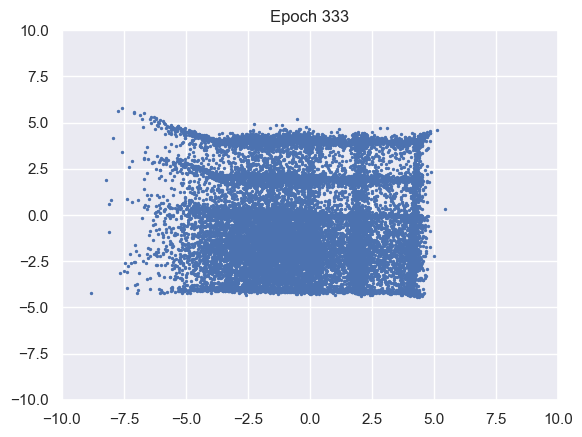

100%|██████████| 976/976 [00:09<00:00, 99.51it/s] 


D loss : 1.2073, GP_loss : 0 G_loss : -0.8089, MI : 4.8461


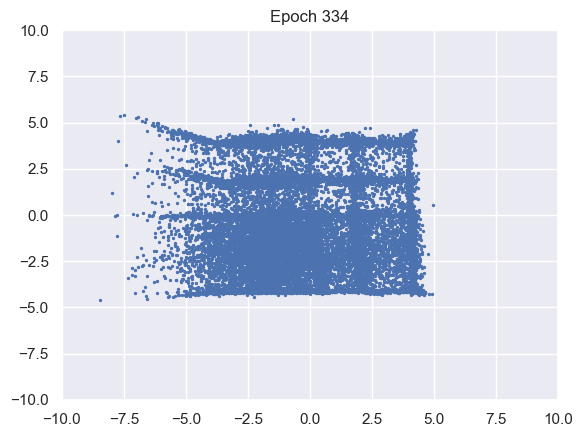

100%|██████████| 976/976 [00:09<00:00, 100.13it/s]


D loss : 1.2088, GP_loss : 0 G_loss : -0.8073, MI : 4.7958


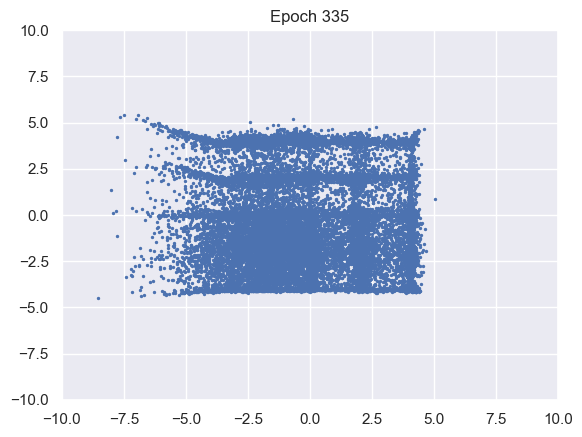

100%|██████████| 976/976 [00:09<00:00, 99.75it/s] 


D loss : 1.208, GP_loss : 0 G_loss : -0.8068, MI : 4.2822


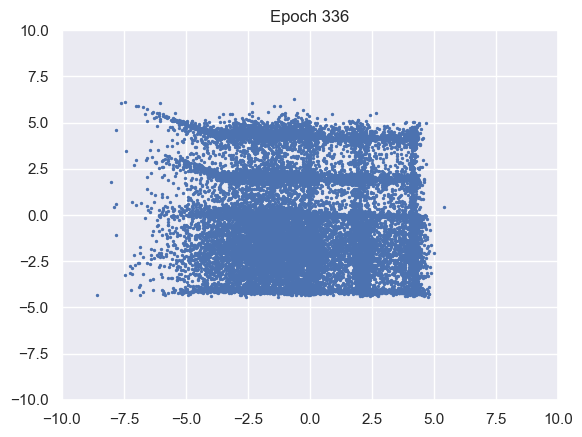

100%|██████████| 976/976 [00:09<00:00, 101.31it/s]


D loss : 1.2097, GP_loss : 0 G_loss : -0.8066, MI : 4.8437


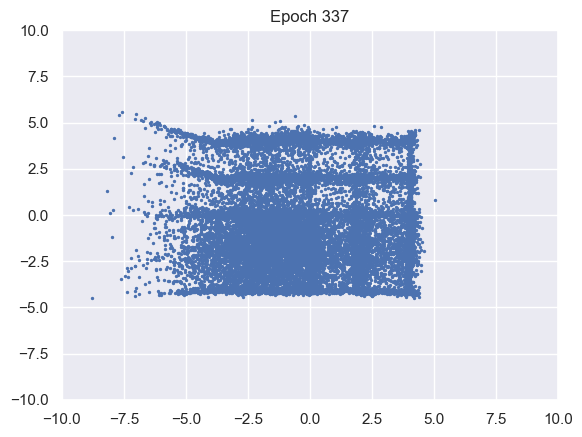

100%|██████████| 976/976 [00:09<00:00, 106.46it/s]


D loss : 1.2092, GP_loss : 0 G_loss : -0.8058, MI : 4.8586


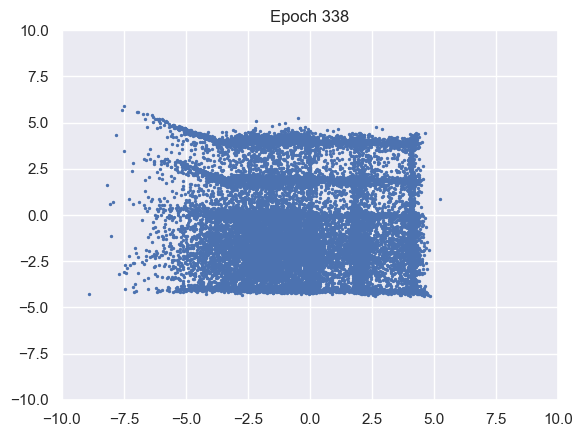

100%|██████████| 976/976 [00:09<00:00, 98.98it/s] 


D loss : 1.208, GP_loss : 0 G_loss : -0.8081, MI : 4.875


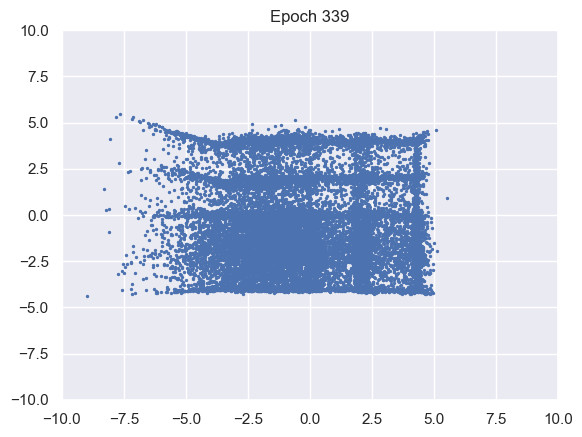

100%|██████████| 976/976 [00:09<00:00, 98.78it/s] 


D loss : 1.2081, GP_loss : 0 G_loss : -0.8073, MI : 4.1234


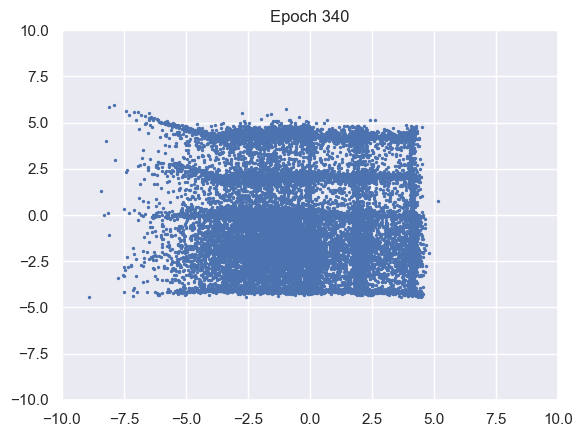

100%|██████████| 976/976 [00:09<00:00, 99.40it/s] 


D loss : 1.2074, GP_loss : 0 G_loss : -0.8072, MI : 4.1933


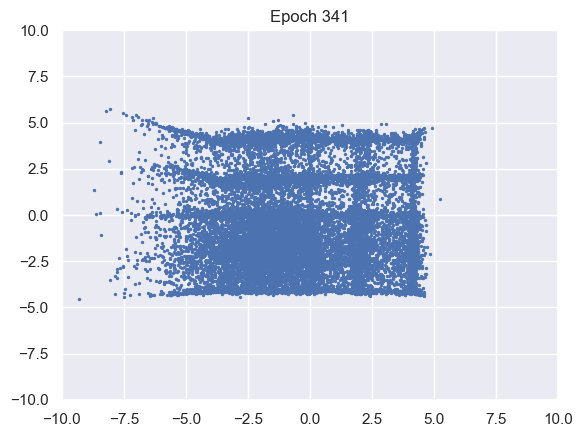

100%|██████████| 976/976 [00:09<00:00, 107.46it/s]


D loss : 1.2091, GP_loss : 0 G_loss : -0.8064, MI : 4.8507


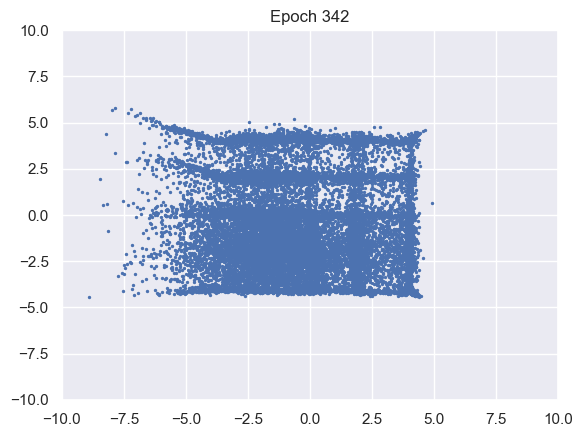

100%|██████████| 976/976 [00:09<00:00, 99.57it/s] 


D loss : 1.2074, GP_loss : 0 G_loss : -0.8068, MI : 4.9138


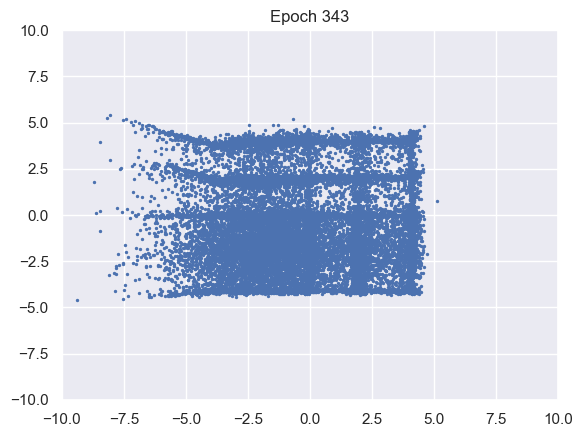

100%|██████████| 976/976 [00:09<00:00, 100.22it/s]


D loss : 1.2051, GP_loss : 0 G_loss : -0.8061, MI : 4.8681


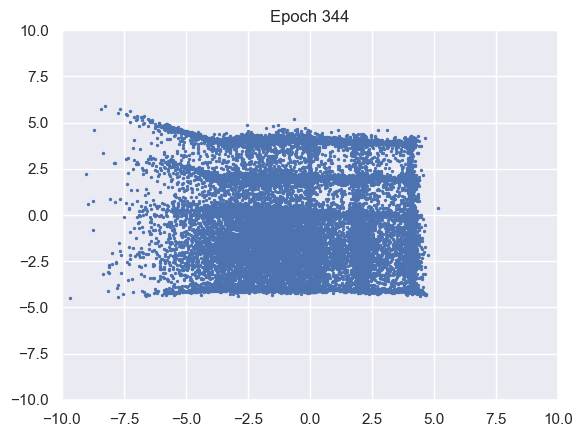

100%|██████████| 976/976 [00:09<00:00, 99.33it/s] 


D loss : 1.2051, GP_loss : 0 G_loss : -0.805, MI : 4.4213


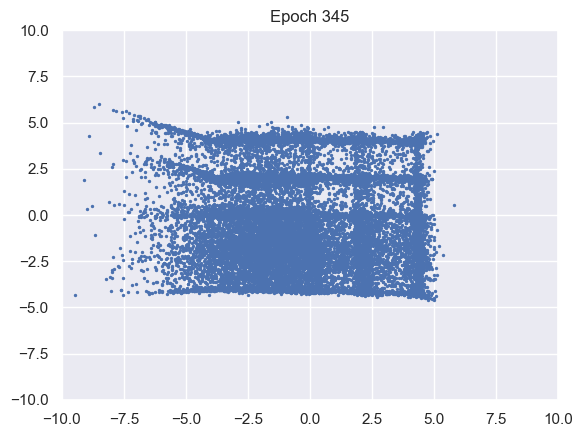

100%|██████████| 976/976 [00:09<00:00, 100.72it/s]


D loss : 1.2098, GP_loss : 0 G_loss : -0.8043, MI : 4.5832


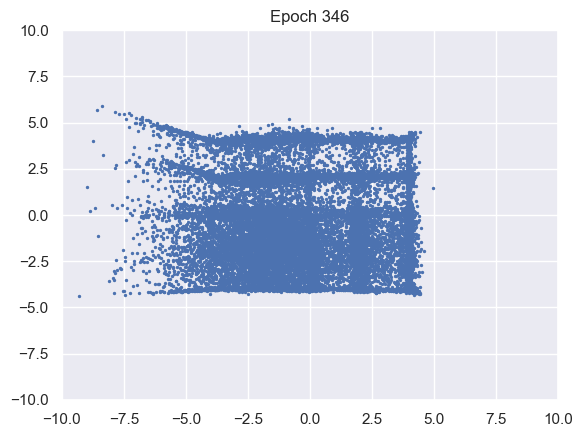

100%|██████████| 976/976 [00:09<00:00, 100.65it/s]


D loss : 1.2106, GP_loss : 0 G_loss : -0.804, MI : 4.8161


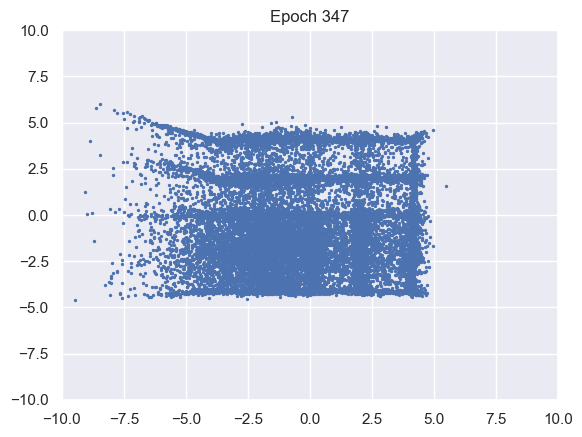

100%|██████████| 976/976 [00:09<00:00, 101.98it/s]


D loss : 1.2081, GP_loss : 0 G_loss : -0.805, MI : 4.8133


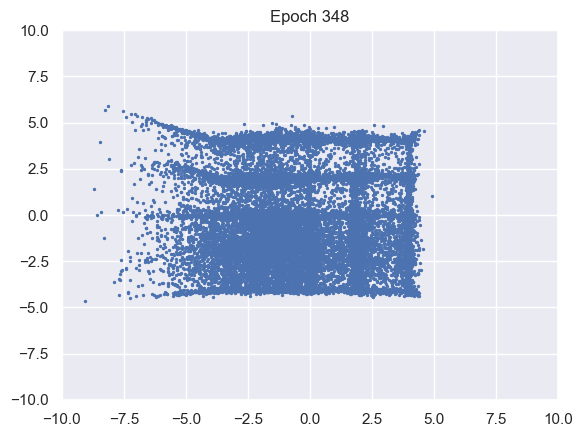

100%|██████████| 976/976 [00:10<00:00, 97.57it/s] 


D loss : 1.2086, GP_loss : 0 G_loss : -0.8047, MI : 4.7616


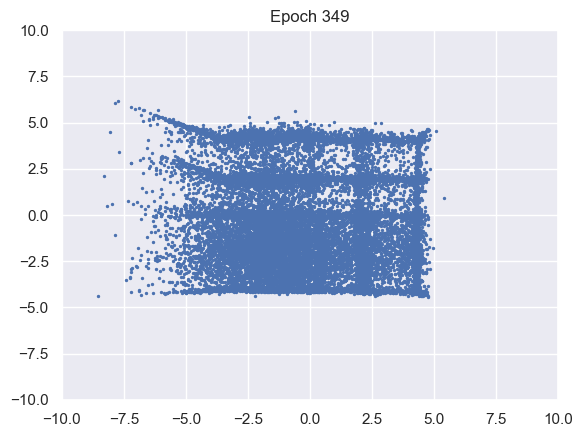

100%|██████████| 976/976 [00:09<00:00, 107.33it/s]


D loss : 1.2105, GP_loss : 0 G_loss : -0.8052, MI : 4.9398


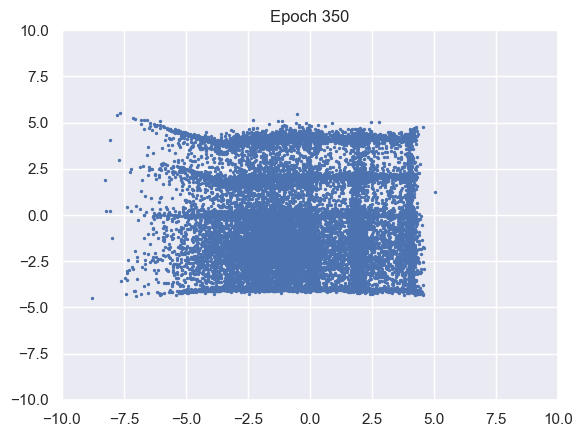

100%|██████████| 976/976 [00:09<00:00, 100.05it/s]


D loss : 1.211, GP_loss : 0 G_loss : -0.8046, MI : 4.7577


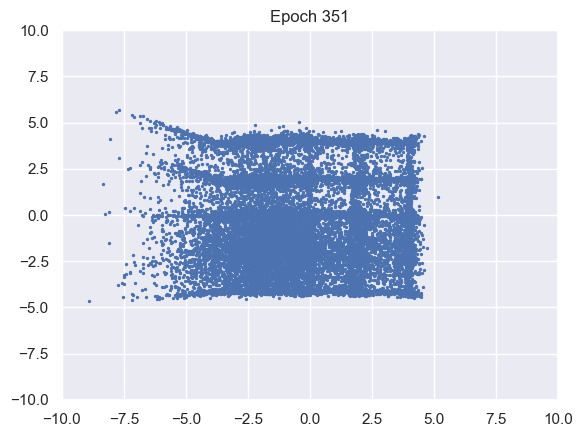

100%|██████████| 976/976 [00:09<00:00, 98.88it/s] 


D loss : 1.2118, GP_loss : 0 G_loss : -0.8057, MI : 4.521


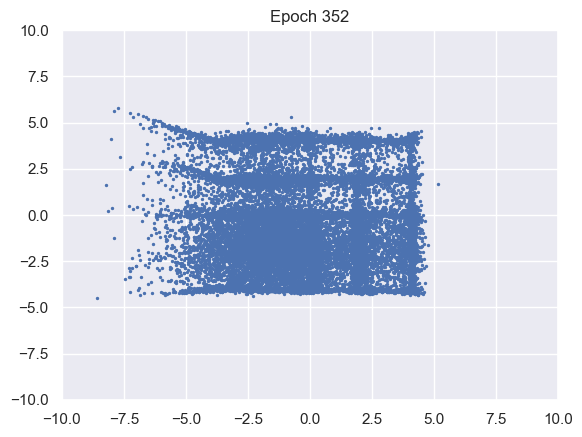

100%|██████████| 976/976 [00:09<00:00, 101.00it/s]


D loss : 1.207, GP_loss : 0 G_loss : -0.806, MI : 4.8615


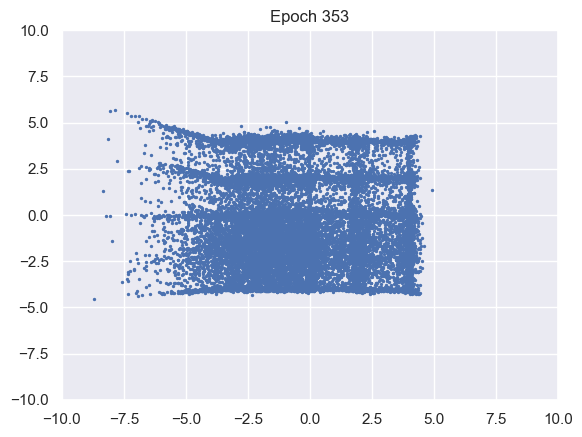

100%|██████████| 976/976 [00:09<00:00, 102.11it/s]


D loss : 1.2099, GP_loss : 0 G_loss : -0.8055, MI : 4.3726


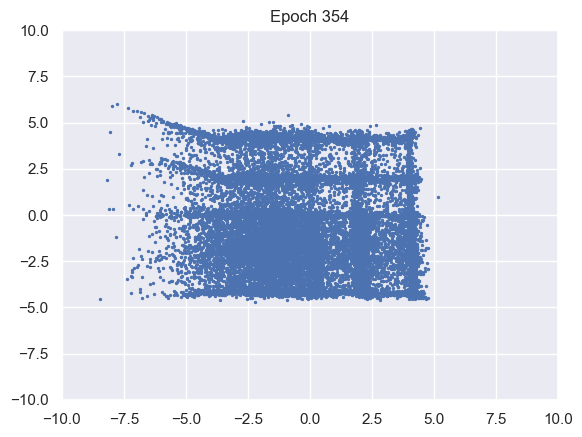

100%|██████████| 976/976 [00:09<00:00, 100.83it/s]


D loss : 1.2104, GP_loss : 0 G_loss : -0.8071, MI : 4.6104


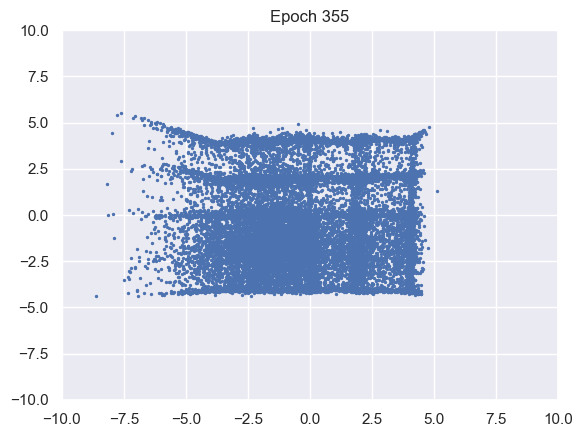

100%|██████████| 976/976 [00:09<00:00, 100.67it/s]


D loss : 1.2109, GP_loss : 0 G_loss : -0.8064, MI : 5.0528


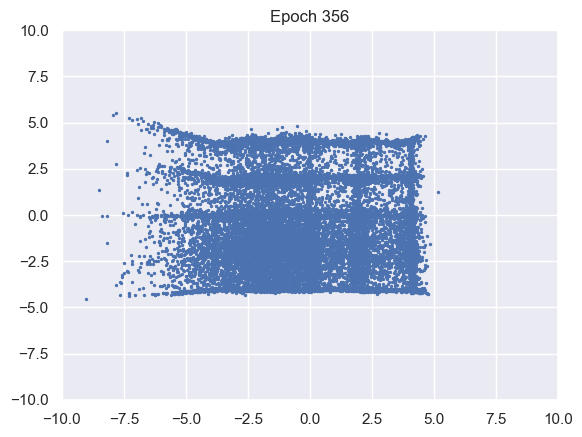

100%|██████████| 976/976 [00:09<00:00, 100.67it/s]


D loss : 1.2101, GP_loss : 0 G_loss : -0.8046, MI : 4.6271


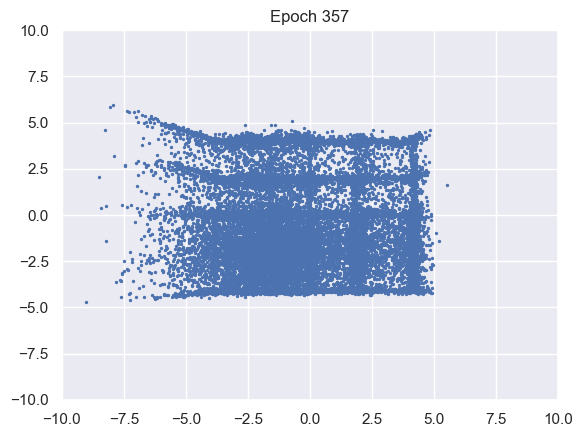

100%|██████████| 976/976 [00:09<00:00, 100.36it/s]


D loss : 1.2072, GP_loss : 0 G_loss : -0.8066, MI : 4.925


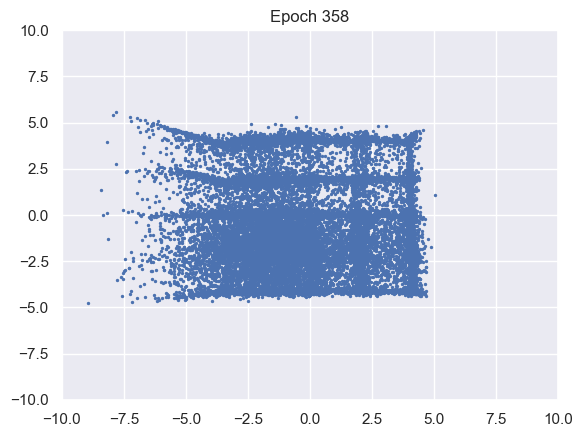

100%|██████████| 976/976 [00:09<00:00, 100.78it/s]


D loss : 1.2061, GP_loss : 0 G_loss : -0.8075, MI : 4.926


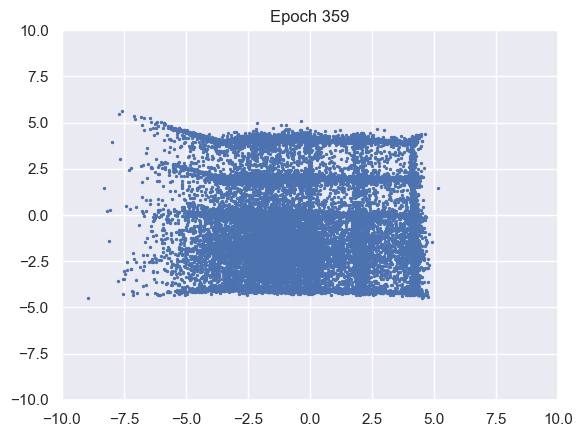

100%|██████████| 976/976 [00:09<00:00, 102.04it/s]


D loss : 1.2086, GP_loss : 0 G_loss : -0.8078, MI : 4.921


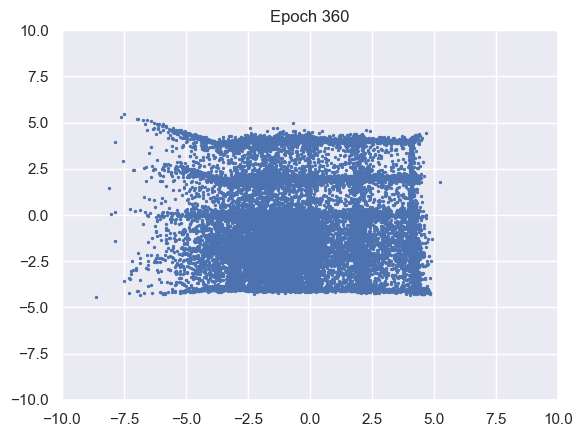

100%|██████████| 976/976 [00:09<00:00, 101.60it/s]


D loss : 1.2064, GP_loss : 0 G_loss : -0.8068, MI : 3.9608


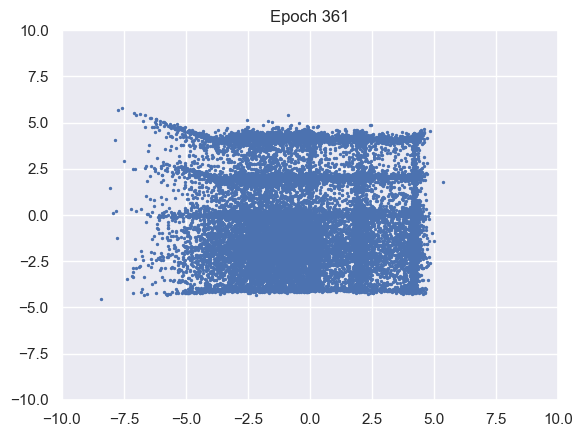

100%|██████████| 976/976 [00:09<00:00, 101.40it/s]


D loss : 1.2051, GP_loss : 0 G_loss : -0.8073, MI : 4.9157


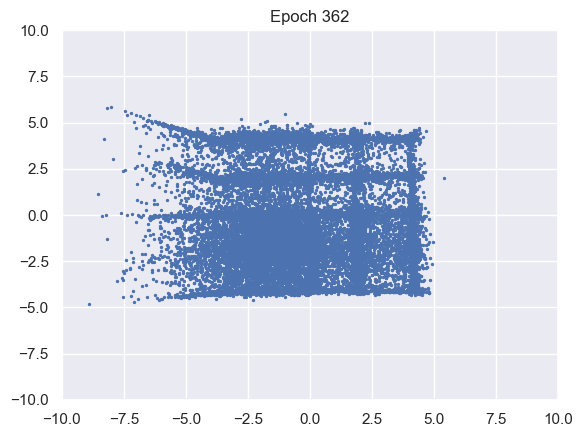

100%|██████████| 976/976 [00:09<00:00, 100.99it/s]


D loss : 1.2057, GP_loss : 0 G_loss : -0.8069, MI : 4.8072


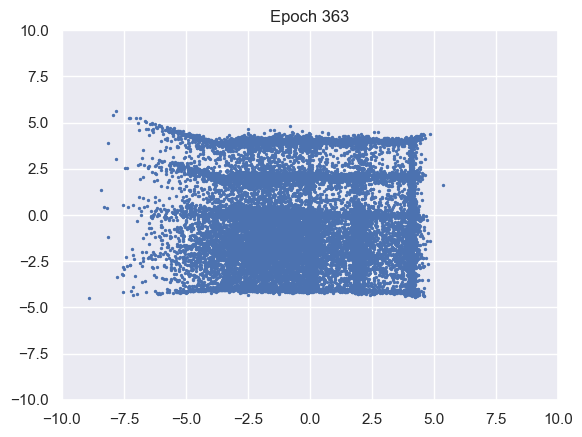

100%|██████████| 976/976 [00:09<00:00, 102.48it/s]


D loss : 1.2054, GP_loss : 0 G_loss : -0.8078, MI : 4.2379


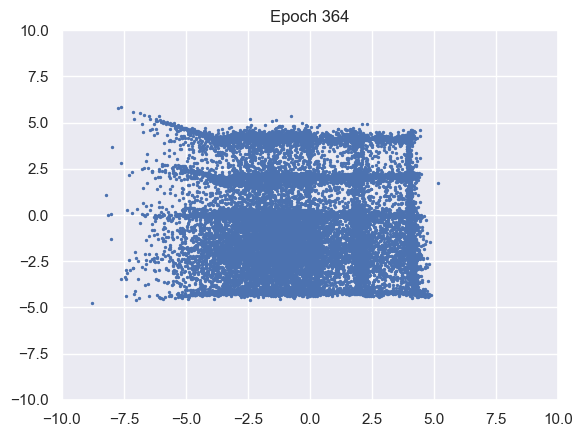

100%|██████████| 976/976 [00:09<00:00, 102.13it/s]


D loss : 1.2057, GP_loss : 0 G_loss : -0.8074, MI : 4.9773


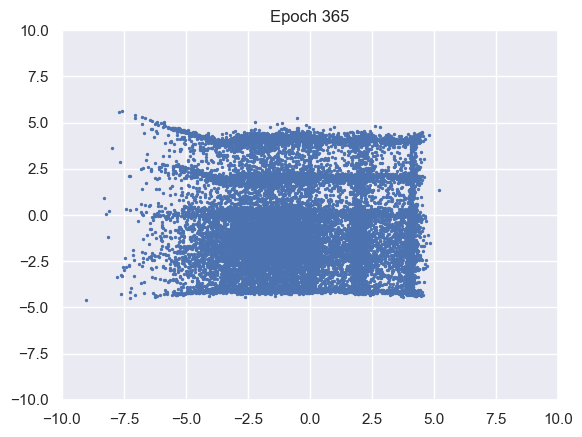

100%|██████████| 976/976 [00:08<00:00, 108.62it/s]


D loss : 1.2053, GP_loss : 0 G_loss : -0.8082, MI : 5.0218


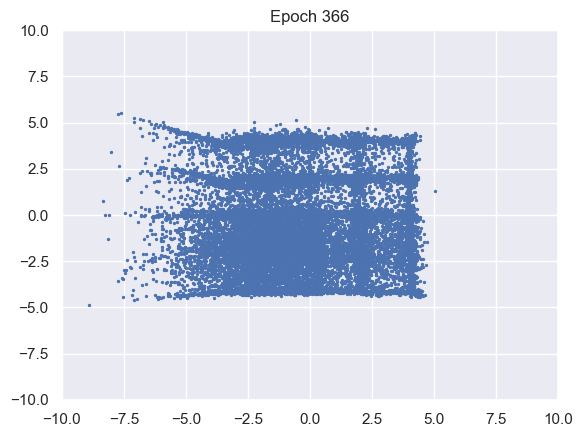

100%|██████████| 976/976 [00:08<00:00, 108.90it/s]


D loss : 1.2016, GP_loss : 0 G_loss : -0.8084, MI : 4.9324


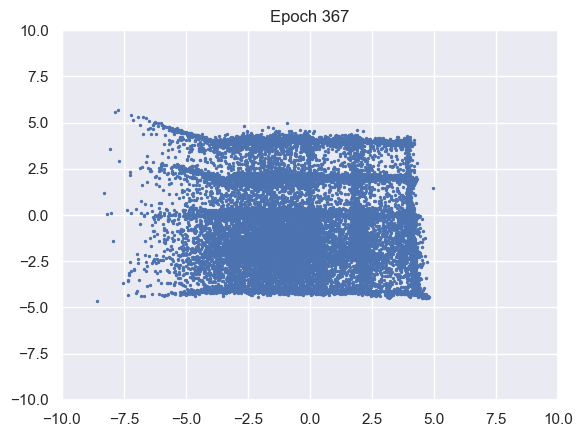

100%|██████████| 976/976 [00:09<00:00, 101.96it/s]


D loss : 1.2028, GP_loss : 0 G_loss : -0.8075, MI : 4.0617


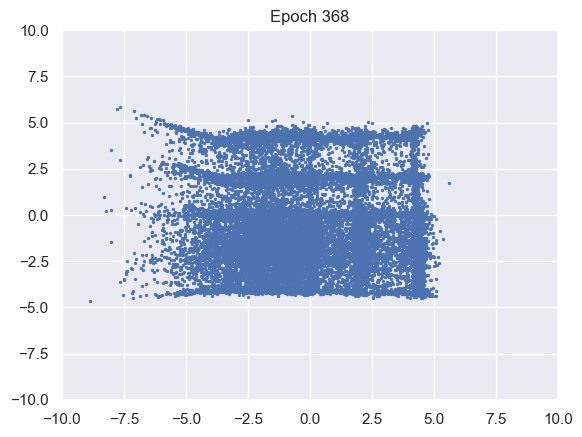

100%|██████████| 976/976 [00:09<00:00, 101.44it/s]


D loss : 1.2039, GP_loss : 0 G_loss : -0.8077, MI : 4.9297


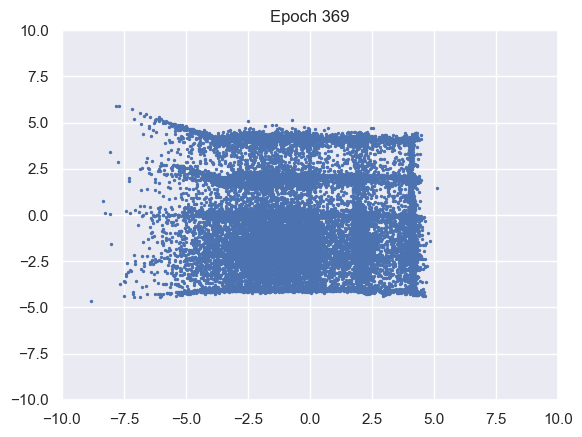

100%|██████████| 976/976 [00:09<00:00, 101.73it/s]


D loss : 1.2064, GP_loss : 0 G_loss : -0.8066, MI : 4.9272


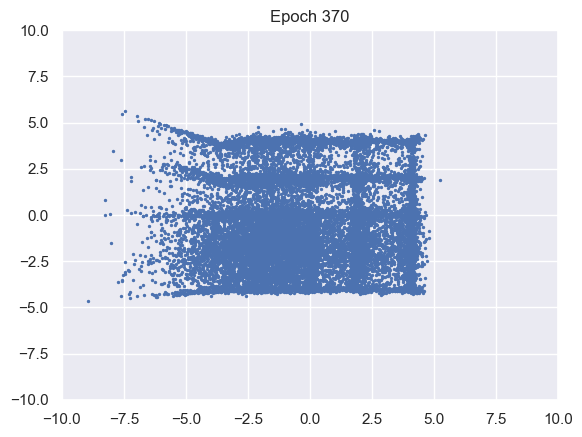

100%|██████████| 976/976 [00:10<00:00, 93.13it/s] 


D loss : 1.2066, GP_loss : 0 G_loss : -0.8073, MI : 4.9676


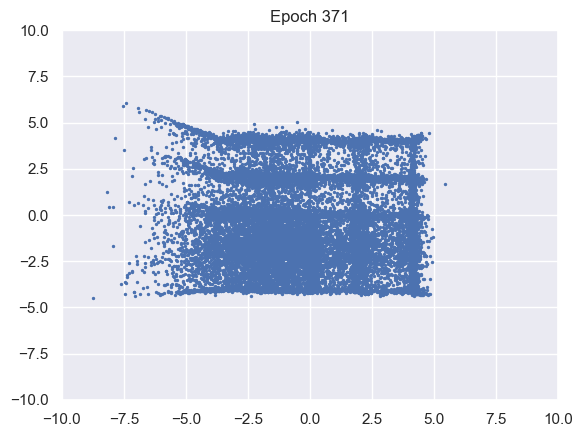

100%|██████████| 976/976 [00:11<00:00, 87.59it/s]


D loss : 1.2049, GP_loss : 0 G_loss : -0.8057, MI : 4.8614


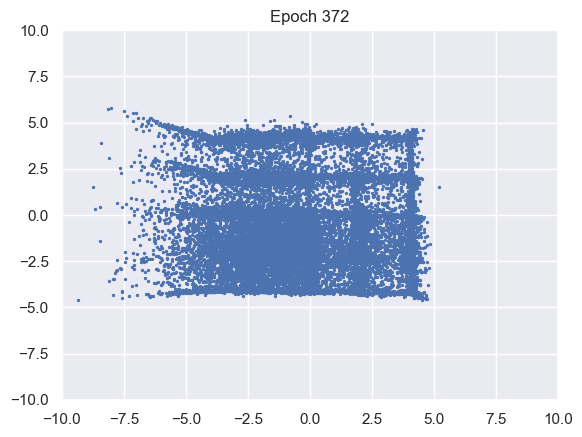

100%|██████████| 976/976 [00:10<00:00, 96.94it/s] 


D loss : 1.2047, GP_loss : 0 G_loss : -0.8066, MI : 4.7829


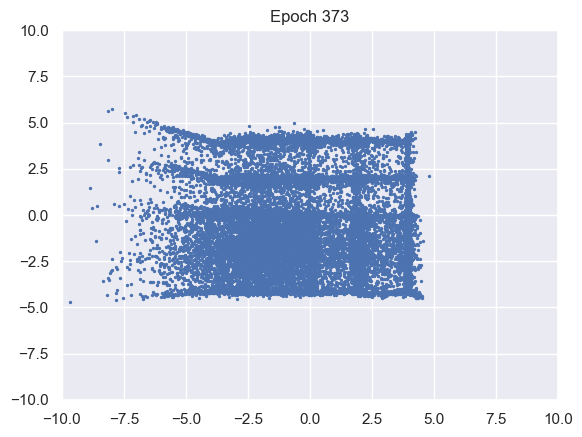

100%|██████████| 976/976 [00:09<00:00, 98.07it/s] 


D loss : 1.2039, GP_loss : 0 G_loss : -0.8052, MI : 4.999


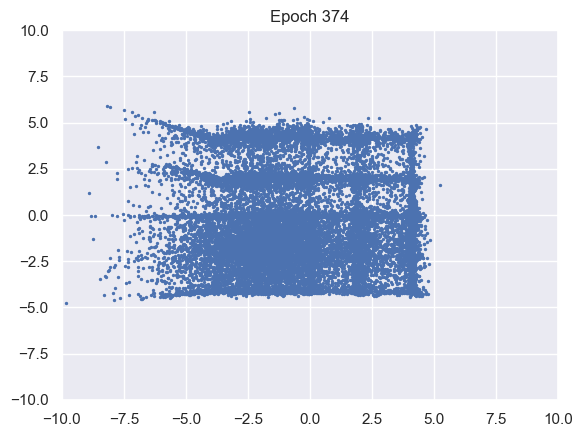

100%|██████████| 976/976 [00:09<00:00, 100.66it/s]


D loss : 1.2001, GP_loss : 0 G_loss : -0.8054, MI : 4.5783


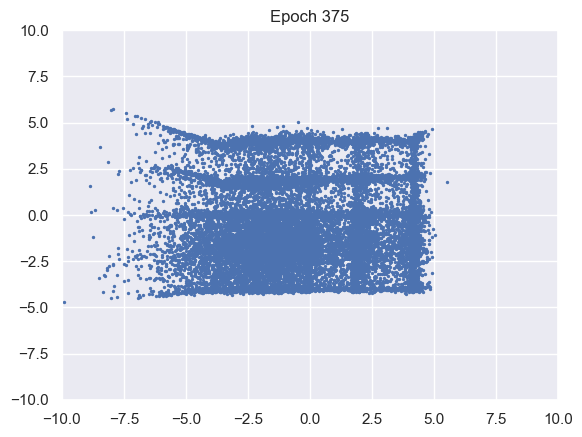

100%|██████████| 976/976 [00:09<00:00, 99.22it/s] 


D loss : 1.2007, GP_loss : 0 G_loss : -0.8061, MI : 4.4088


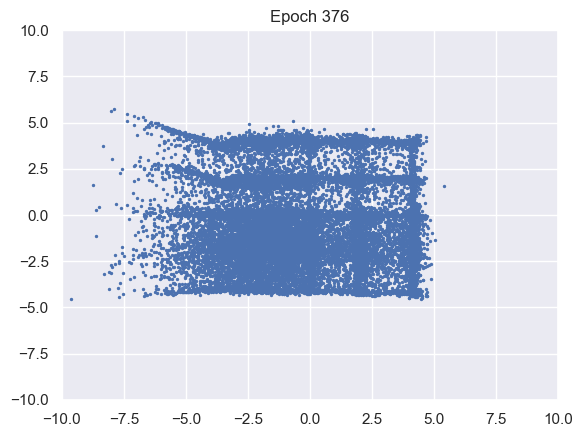

100%|██████████| 976/976 [00:11<00:00, 85.88it/s] 


D loss : 1.2017, GP_loss : 0 G_loss : -0.8062, MI : 4.998


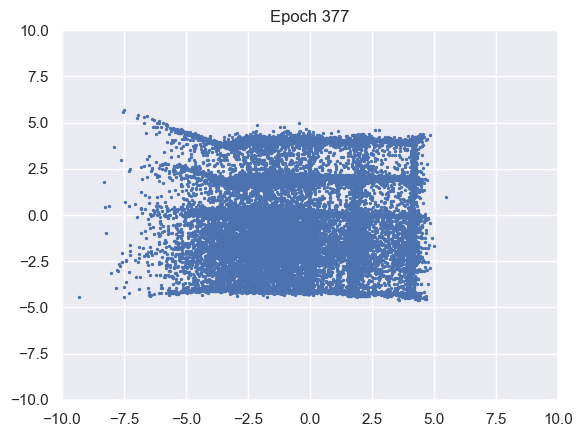

100%|██████████| 976/976 [00:10<00:00, 92.72it/s] 


D loss : 1.2011, GP_loss : 0 G_loss : -0.8064, MI : 4.636


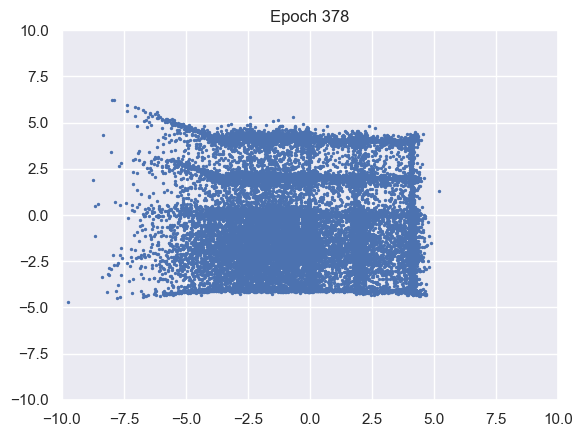

100%|██████████| 976/976 [00:09<00:00, 99.44it/s] 


D loss : 1.2075, GP_loss : 0 G_loss : -0.8059, MI : 4.5828


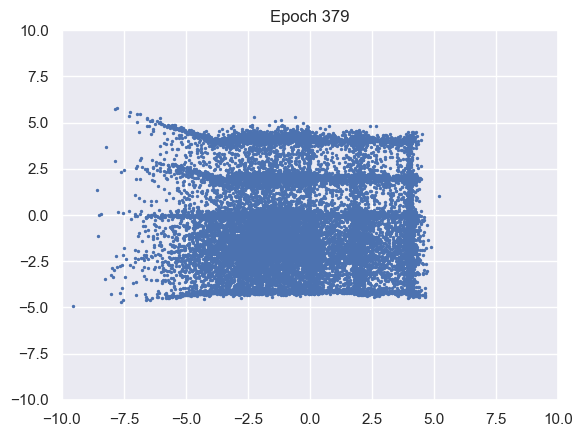

100%|██████████| 976/976 [00:09<00:00, 99.60it/s] 


D loss : 1.2054, GP_loss : 0 G_loss : -0.8036, MI : 5.1765


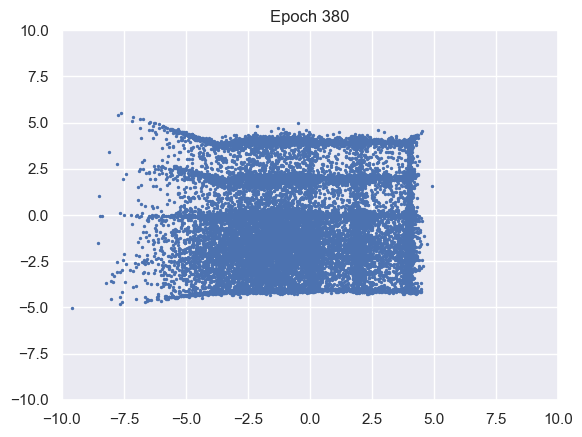

100%|██████████| 976/976 [00:09<00:00, 105.57it/s]


D loss : 1.2044, GP_loss : 0 G_loss : -0.8051, MI : 4.8655


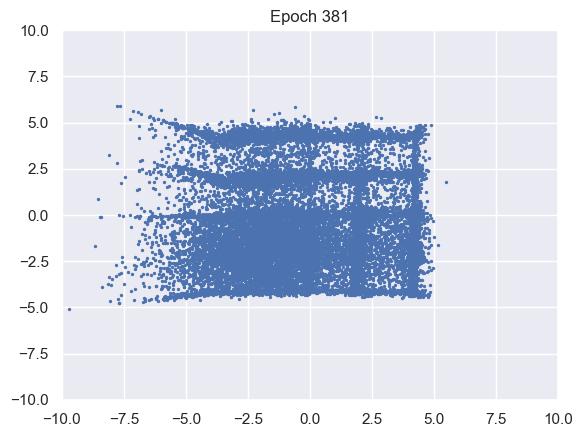

100%|██████████| 976/976 [00:09<00:00, 102.65it/s]


D loss : 1.2047, GP_loss : 0 G_loss : -0.806, MI : 4.7764


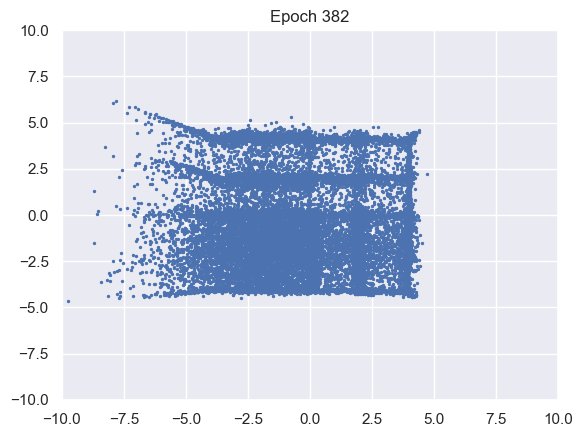

100%|██████████| 976/976 [00:09<00:00, 105.52it/s]


D loss : 1.2031, GP_loss : 0 G_loss : -0.8049, MI : 4.8189


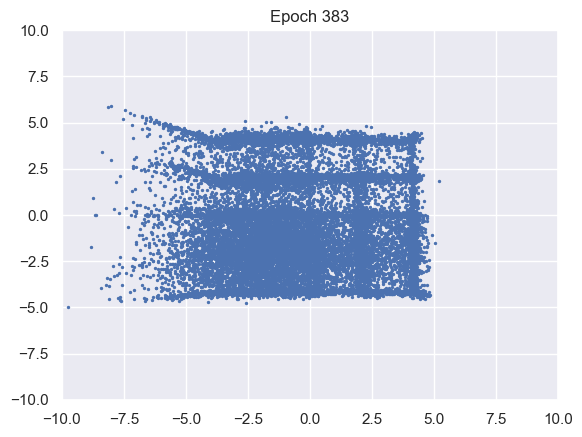

100%|██████████| 976/976 [00:09<00:00, 103.79it/s]


D loss : 1.2023, GP_loss : 0 G_loss : -0.8054, MI : 5.0788


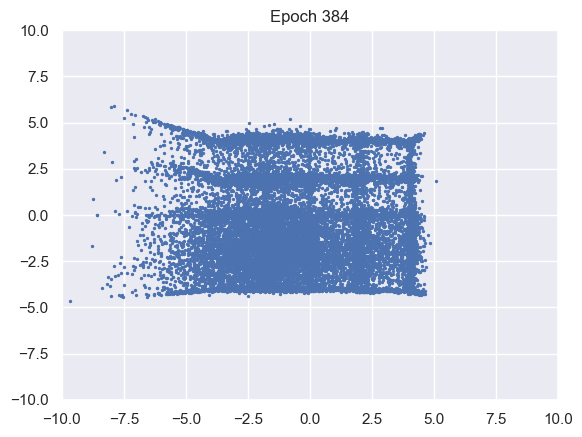

100%|██████████| 976/976 [00:09<00:00, 99.70it/s] 


D loss : 1.2027, GP_loss : 0 G_loss : -0.8041, MI : 4.2945


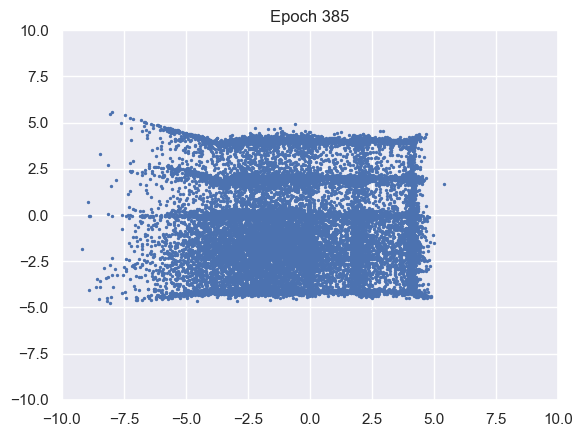

100%|██████████| 976/976 [00:09<00:00, 100.61it/s]


D loss : 1.2027, GP_loss : 0 G_loss : -0.8031, MI : 5.0489


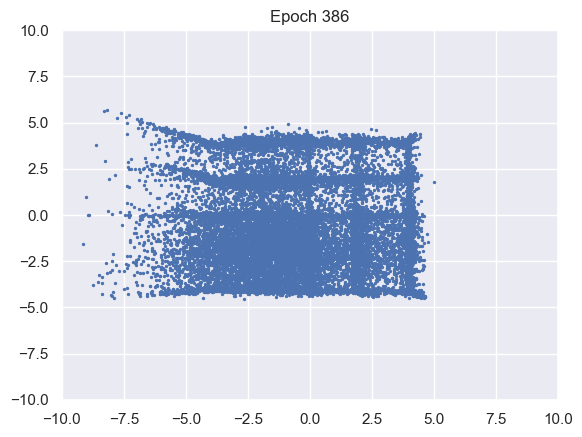

100%|██████████| 976/976 [00:09<00:00, 101.44it/s]


D loss : 1.2011, GP_loss : 0 G_loss : -0.804, MI : 5.1017


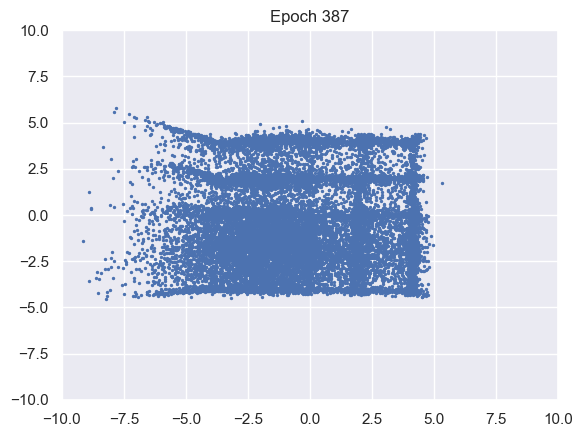

100%|██████████| 976/976 [00:10<00:00, 97.10it/s] 


D loss : 1.2034, GP_loss : 0 G_loss : -0.8047, MI : 4.7776


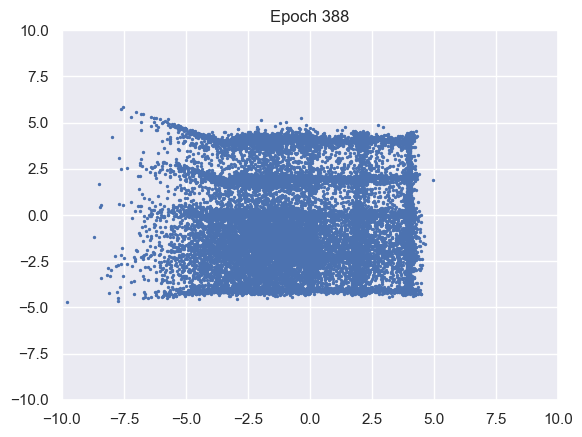

100%|██████████| 976/976 [00:09<00:00, 103.21it/s]


D loss : 1.2037, GP_loss : 0 G_loss : -0.8055, MI : 4.9926


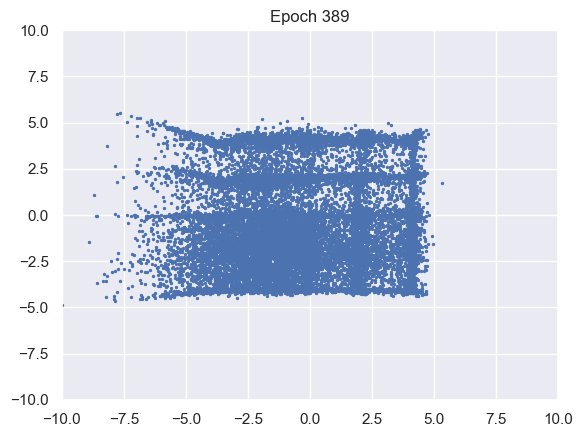

100%|██████████| 976/976 [00:09<00:00, 103.34it/s]


D loss : 1.2023, GP_loss : 0 G_loss : -0.8055, MI : 4.1502


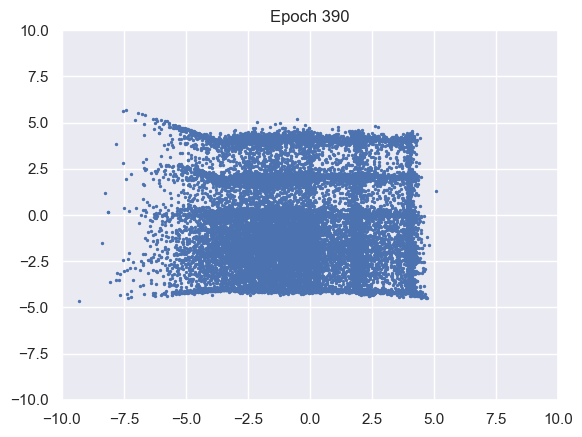

100%|██████████| 976/976 [00:09<00:00, 103.34it/s]


D loss : 1.2055, GP_loss : 0 G_loss : -0.8063, MI : 4.8407


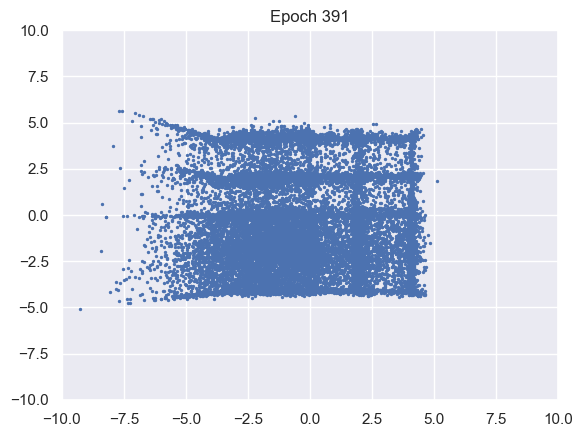

100%|██████████| 976/976 [00:09<00:00, 105.19it/s]


D loss : 1.2085, GP_loss : 0 G_loss : -0.8059, MI : 4.8089


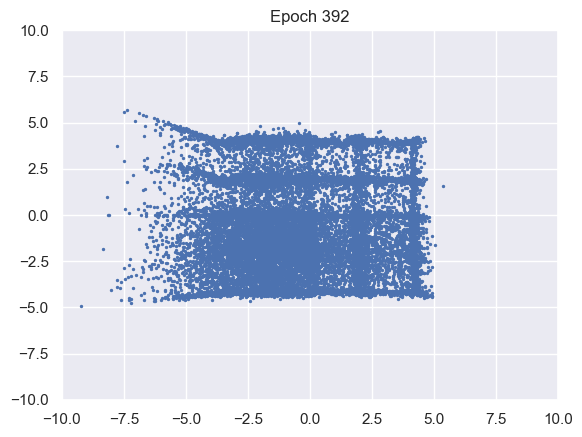

100%|██████████| 976/976 [00:09<00:00, 101.89it/s]


D loss : 1.2078, GP_loss : 0 G_loss : -0.8054, MI : 4.5491


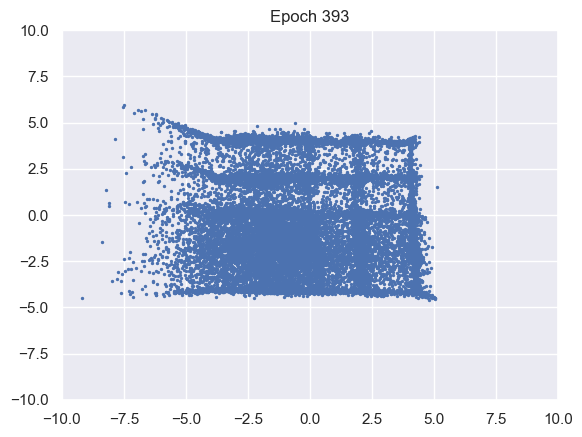

100%|██████████| 976/976 [00:09<00:00, 101.58it/s]


D loss : 1.2042, GP_loss : 0 G_loss : -0.8066, MI : 4.943


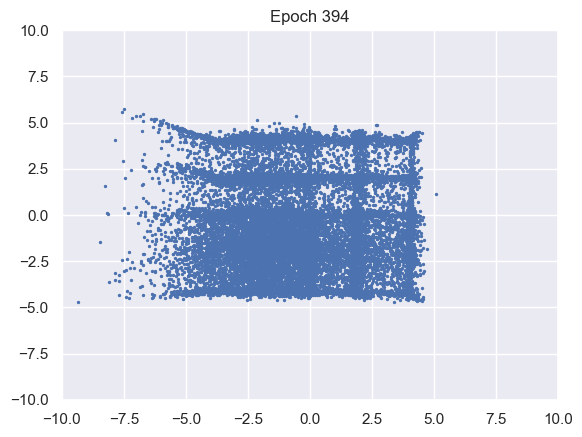

100%|██████████| 976/976 [00:09<00:00, 101.64it/s]


D loss : 1.2056, GP_loss : 0 G_loss : -0.8049, MI : 4.7219


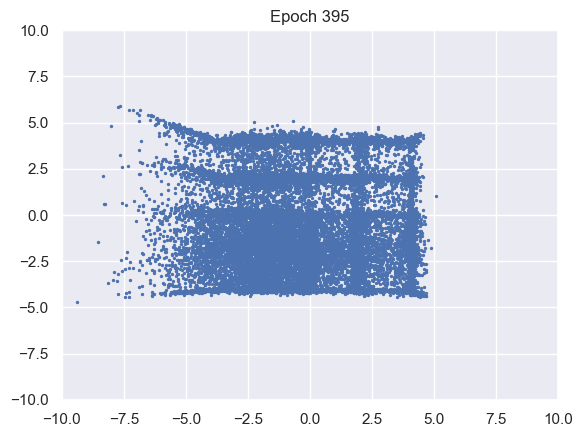

100%|██████████| 976/976 [00:09<00:00, 99.60it/s] 


D loss : 1.2058, GP_loss : 0 G_loss : -0.8049, MI : 5.1103


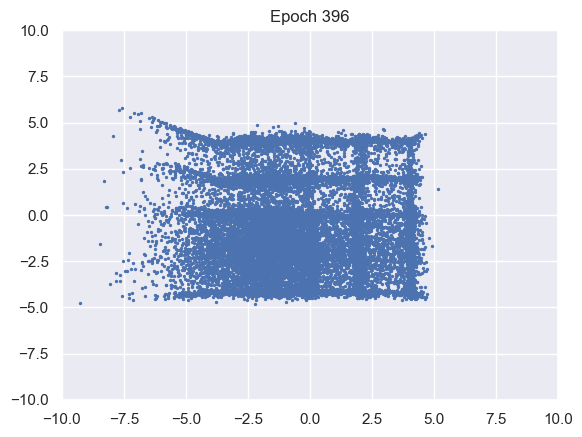

100%|██████████| 976/976 [00:09<00:00, 102.04it/s]


D loss : 1.2032, GP_loss : 0 G_loss : -0.8052, MI : 4.7554


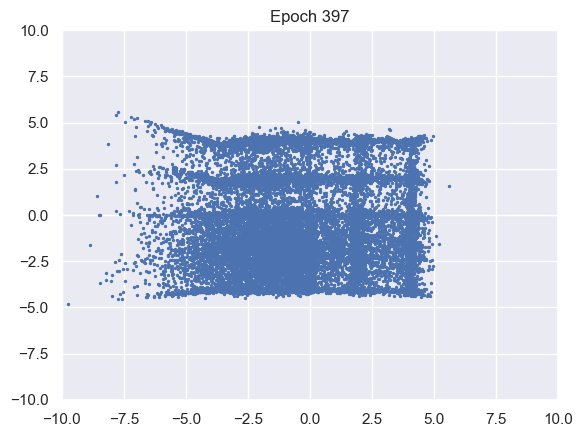

100%|██████████| 976/976 [00:09<00:00, 102.71it/s]


D loss : 1.2036, GP_loss : 0 G_loss : -0.8063, MI : 5.0105


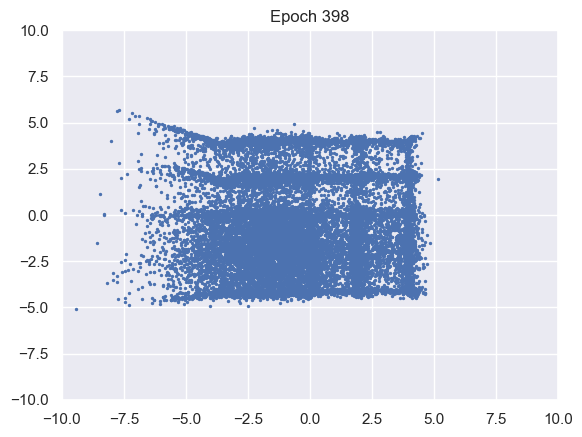

100%|██████████| 976/976 [00:09<00:00, 102.75it/s]


D loss : 1.2055, GP_loss : 0 G_loss : -0.8058, MI : 4.4321


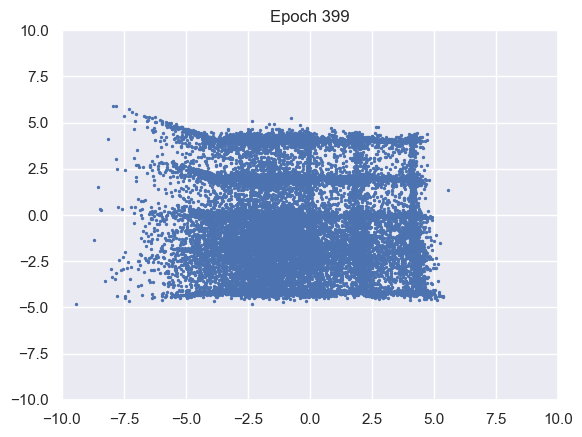

100%|██████████| 976/976 [00:09<00:00, 100.94it/s]


D loss : 1.2028, GP_loss : 0 G_loss : -0.8055, MI : 4.8017


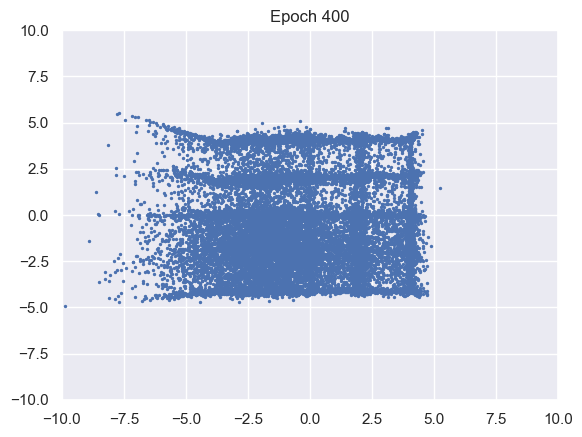

100%|██████████| 976/976 [00:09<00:00, 103.51it/s]


D loss : 1.2031, GP_loss : 0 G_loss : -0.8071, MI : 4.7243


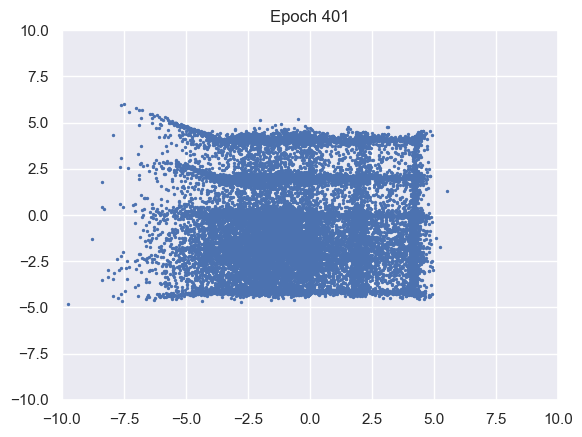

100%|██████████| 976/976 [00:09<00:00, 104.64it/s]


D loss : 1.2016, GP_loss : 0 G_loss : -0.8051, MI : 4.9333


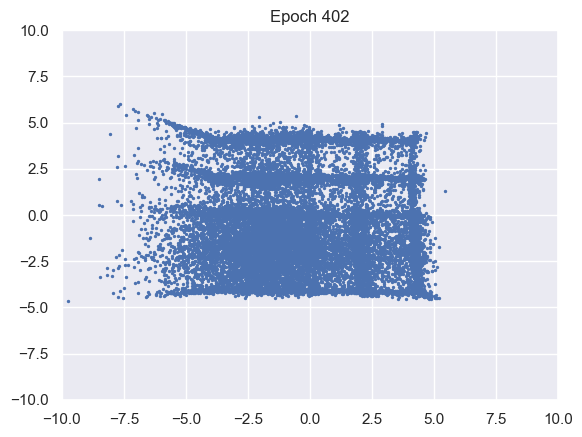

100%|██████████| 976/976 [00:09<00:00, 102.86it/s]


D loss : 1.2024, GP_loss : 0 G_loss : -0.8058, MI : 4.4904


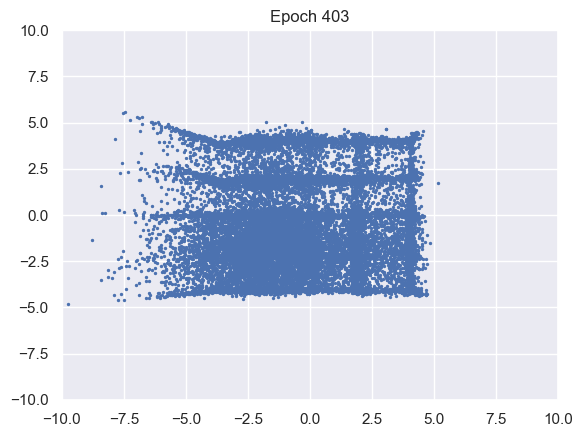

100%|██████████| 976/976 [00:09<00:00, 102.80it/s]


D loss : 1.1991, GP_loss : 0 G_loss : -0.8069, MI : 3.9875


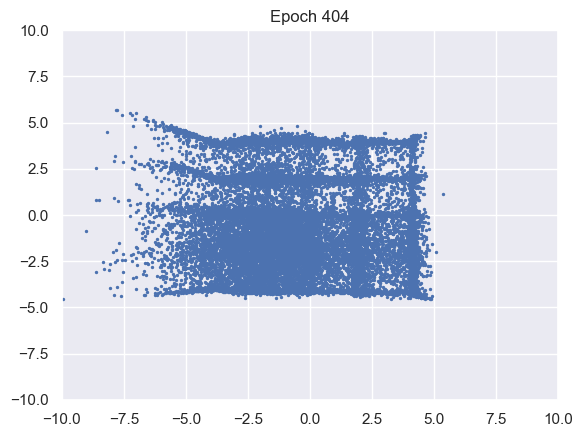

100%|██████████| 976/976 [00:09<00:00, 103.24it/s]


D loss : 1.2009, GP_loss : 0 G_loss : -0.8073, MI : 5.1181


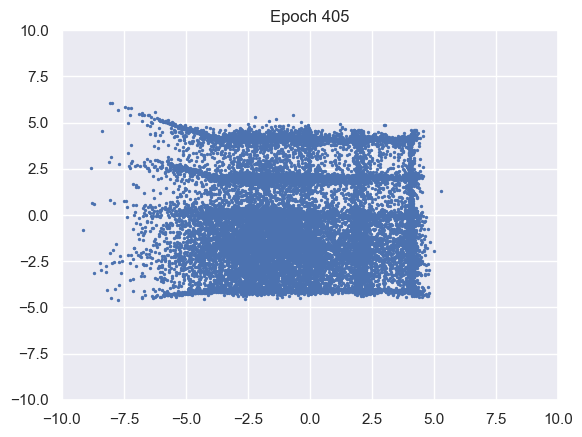

100%|██████████| 976/976 [00:09<00:00, 103.13it/s]


D loss : 1.202, GP_loss : 0 G_loss : -0.806, MI : 4.7006


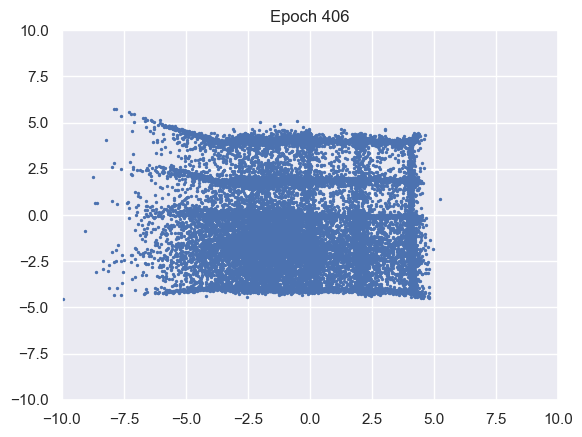

100%|██████████| 976/976 [00:09<00:00, 99.18it/s] 


D loss : 1.2037, GP_loss : 0 G_loss : -0.8056, MI : 5.1671


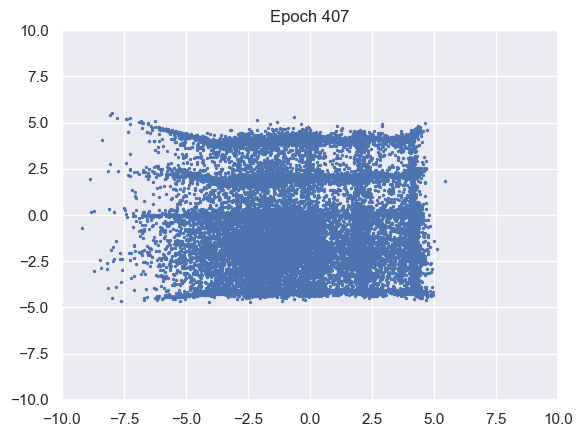

100%|██████████| 976/976 [00:09<00:00, 99.64it/s] 


D loss : 1.2024, GP_loss : 0 G_loss : -0.8059, MI : 4.9053


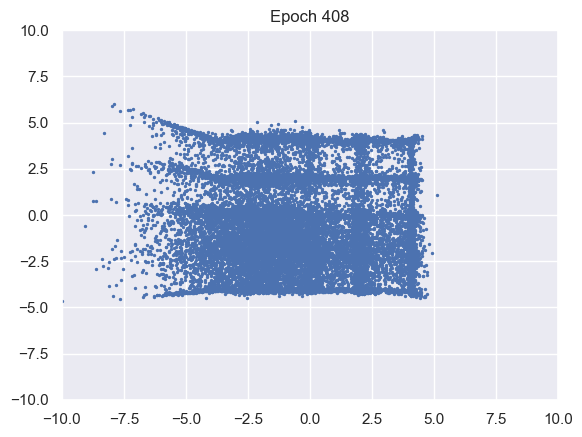

100%|██████████| 976/976 [00:09<00:00, 99.46it/s] 


D loss : 1.1989, GP_loss : 0 G_loss : -0.8044, MI : 4.4164


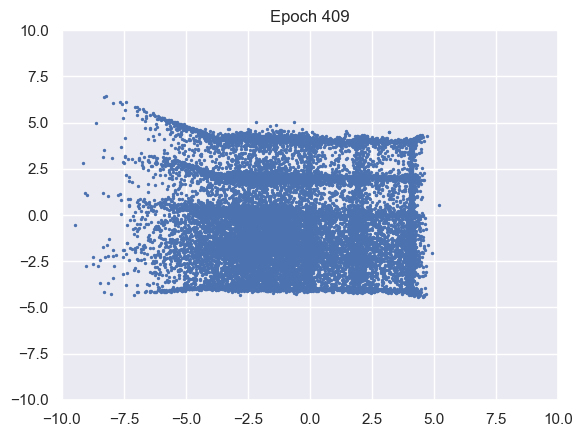

100%|██████████| 976/976 [00:09<00:00, 99.69it/s] 


D loss : 1.1969, GP_loss : 0 G_loss : -0.8045, MI : 4.8344


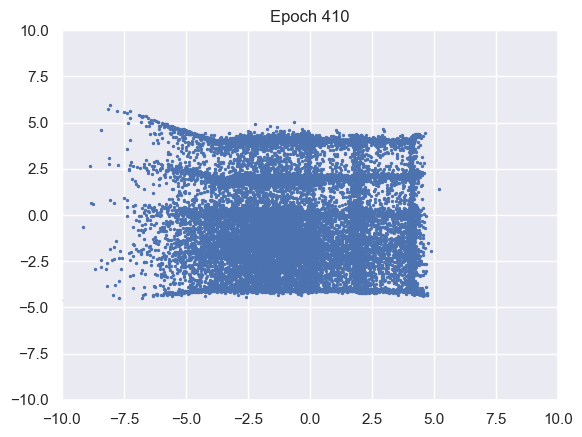

100%|██████████| 976/976 [00:09<00:00, 99.40it/s] 


D loss : 1.1982, GP_loss : 0 G_loss : -0.8061, MI : 4.8745


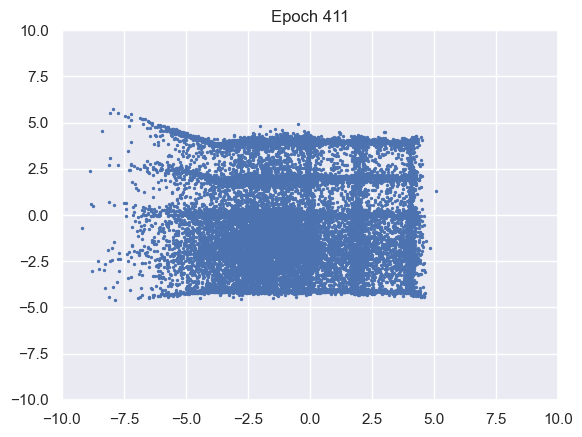

100%|██████████| 976/976 [00:09<00:00, 98.90it/s] 


D loss : 1.2043, GP_loss : 0 G_loss : -0.8053, MI : 4.447


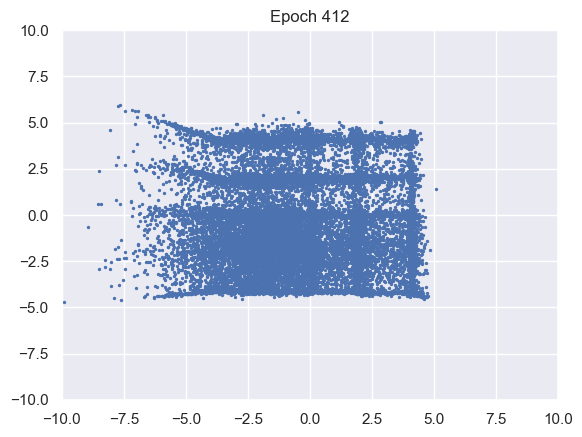

100%|██████████| 976/976 [00:09<00:00, 100.53it/s]


D loss : 1.1997, GP_loss : 0 G_loss : -0.805, MI : 4.4505


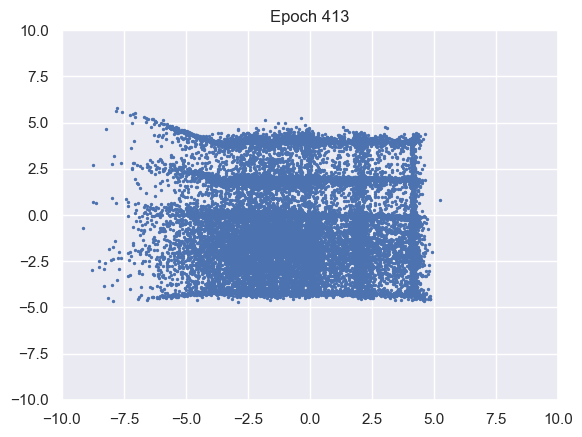

100%|██████████| 976/976 [00:09<00:00, 99.62it/s] 


D loss : 1.1991, GP_loss : 0 G_loss : -0.805, MI : 4.6668


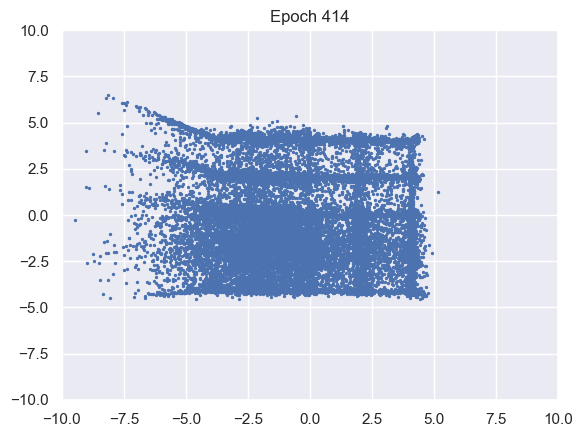

100%|██████████| 976/976 [00:09<00:00, 99.65it/s] 


D loss : 1.1985, GP_loss : 0 G_loss : -0.8046, MI : 4.9037


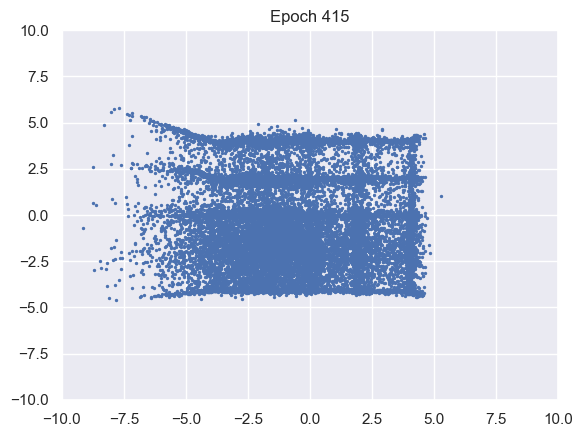

100%|██████████| 976/976 [00:09<00:00, 99.52it/s] 


D loss : 1.2012, GP_loss : 0 G_loss : -0.8057, MI : 4.5617


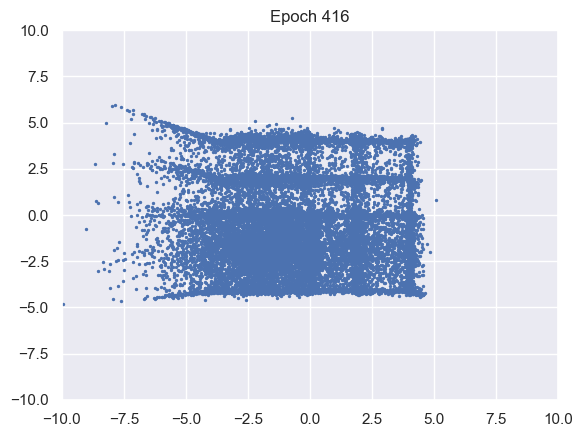

100%|██████████| 976/976 [00:09<00:00, 98.83it/s] 


D loss : 1.1995, GP_loss : 0 G_loss : -0.8051, MI : 5.0747


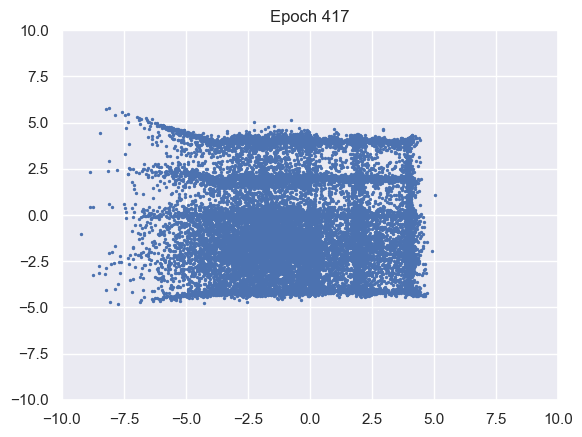

100%|██████████| 976/976 [00:09<00:00, 99.02it/s] 


D loss : 1.1993, GP_loss : 0 G_loss : -0.8056, MI : 5.0915


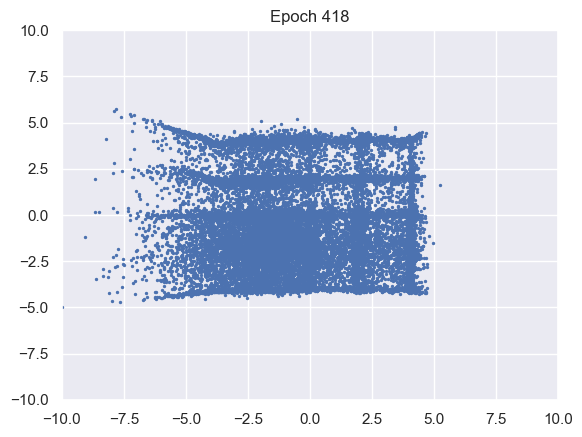

100%|██████████| 976/976 [00:09<00:00, 99.85it/s] 


D loss : 1.1989, GP_loss : 0 G_loss : -0.8056, MI : 4.6977


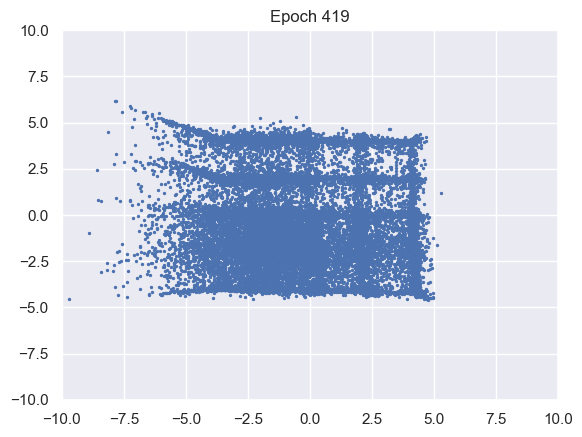

100%|██████████| 976/976 [00:09<00:00, 100.21it/s]


D loss : 1.1953, GP_loss : 0 G_loss : -0.8053, MI : 4.6747


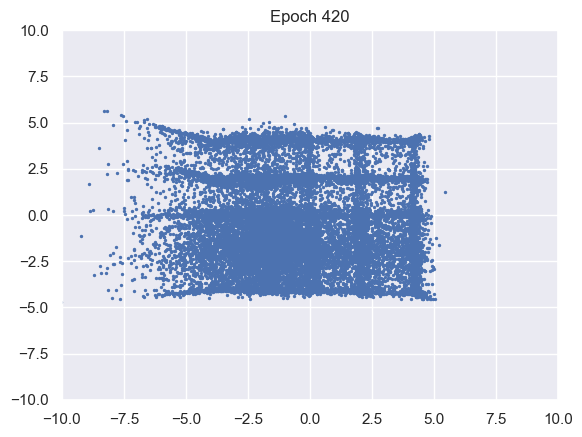

100%|██████████| 976/976 [00:09<00:00, 100.35it/s]


D loss : 1.1956, GP_loss : 0 G_loss : -0.8055, MI : 4.8951


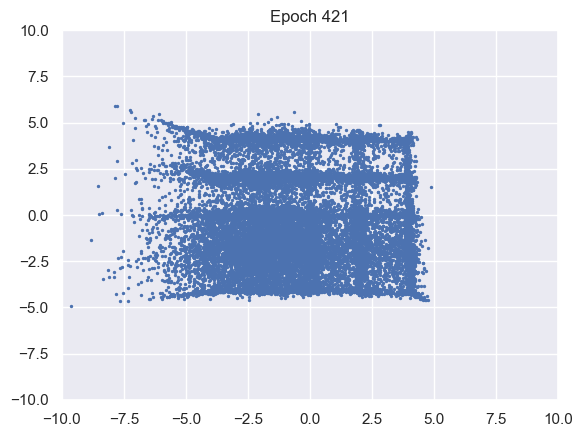

100%|██████████| 976/976 [00:09<00:00, 101.25it/s]


D loss : 1.1954, GP_loss : 0 G_loss : -0.8062, MI : 5.2054


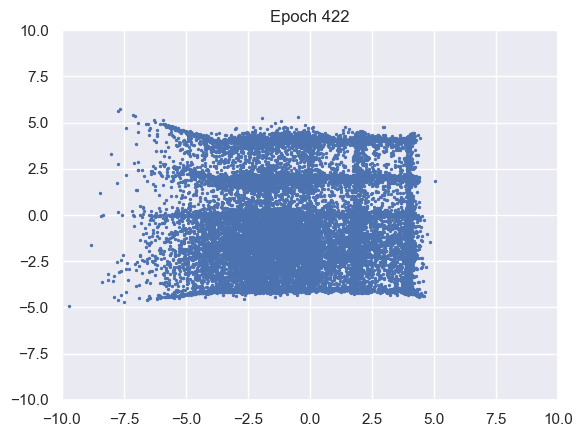

100%|██████████| 976/976 [00:09<00:00, 101.43it/s]


D loss : 1.1944, GP_loss : 0 G_loss : -0.8068, MI : -0.8704


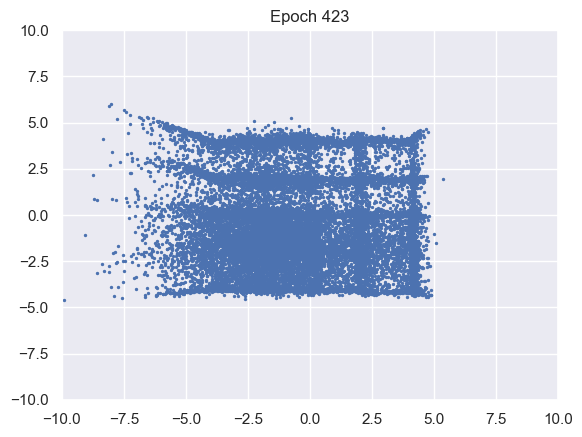

100%|██████████| 976/976 [00:09<00:00, 99.76it/s] 


D loss : 1.1952, GP_loss : 0 G_loss : -0.8071, MI : 3.2832


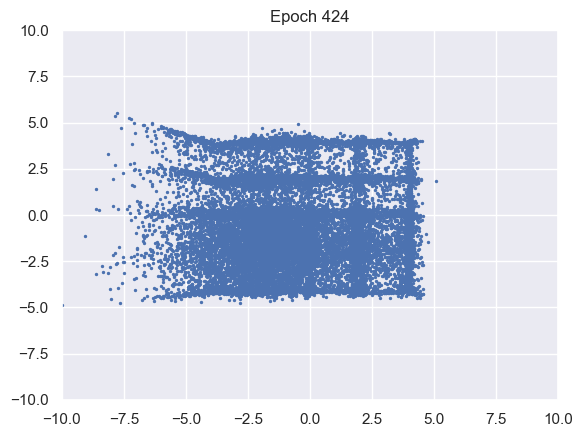

100%|██████████| 976/976 [00:09<00:00, 101.27it/s]


D loss : 1.1891, GP_loss : 0 G_loss : -0.8069, MI : 5.1847


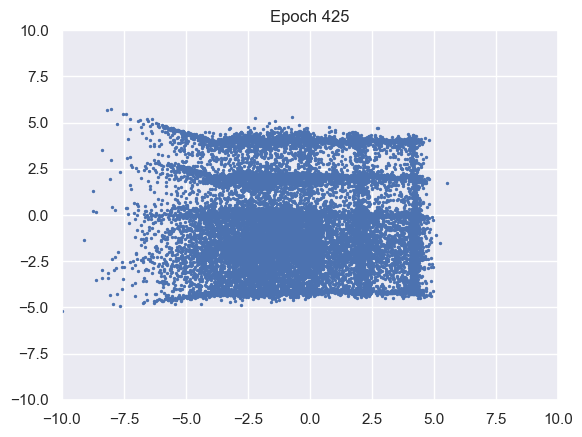

100%|██████████| 976/976 [00:09<00:00, 101.24it/s]


D loss : 1.191, GP_loss : 0 G_loss : -0.807, MI : 5.0614


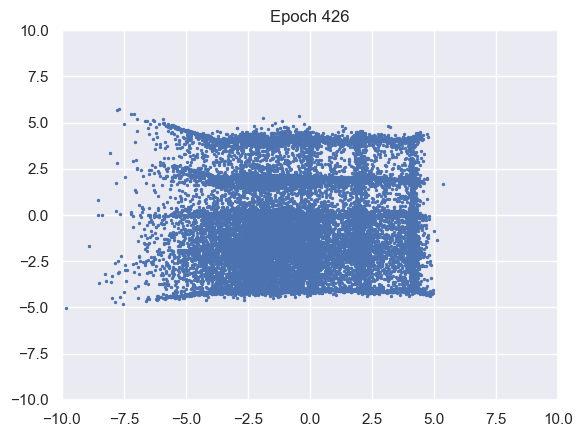

100%|██████████| 976/976 [00:09<00:00, 101.96it/s]


D loss : 1.1922, GP_loss : 0 G_loss : -0.8078, MI : 4.6067


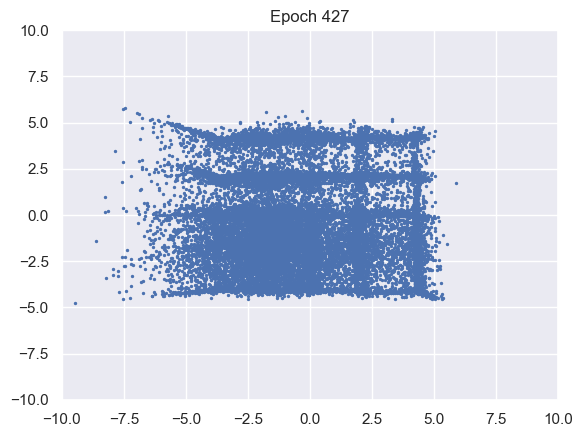

100%|██████████| 976/976 [00:09<00:00, 102.39it/s]


D loss : 1.1931, GP_loss : 0 G_loss : -0.8083, MI : 5.3002


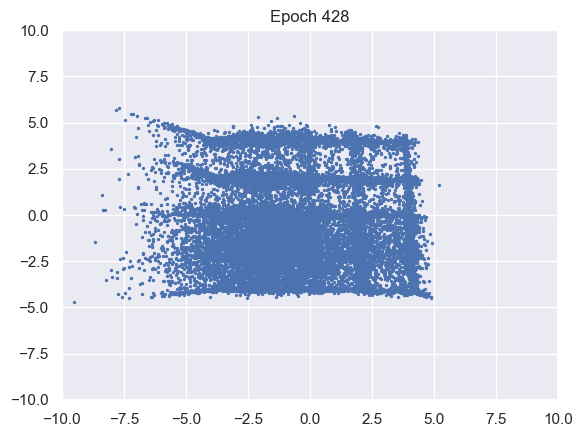

100%|██████████| 976/976 [00:09<00:00, 100.46it/s]


D loss : 1.1878, GP_loss : 0 G_loss : -0.8072, MI : 4.3871


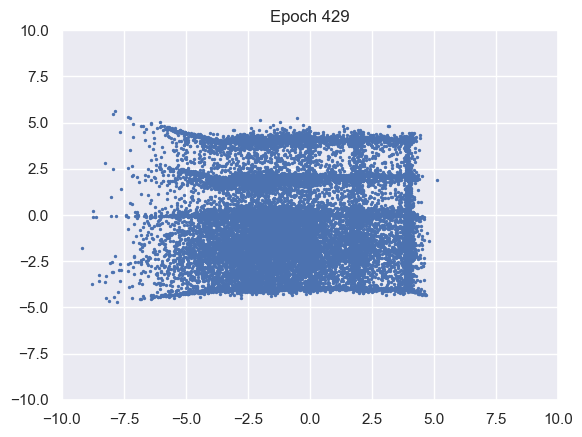

100%|██████████| 976/976 [00:09<00:00, 100.65it/s]


D loss : 1.1914, GP_loss : 0 G_loss : -0.8059, MI : 3.7968


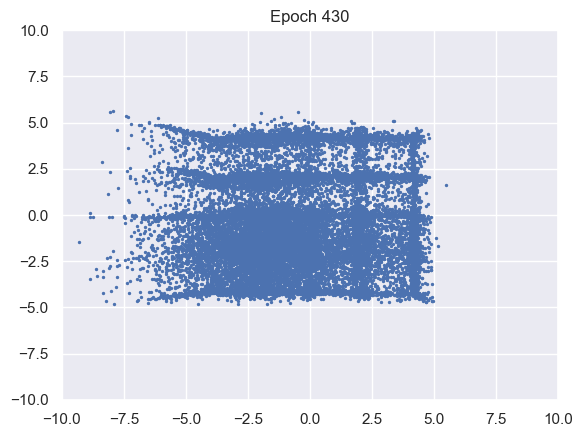

100%|██████████| 976/976 [00:09<00:00, 100.62it/s]


D loss : 1.1897, GP_loss : 0 G_loss : -0.8059, MI : 5.222


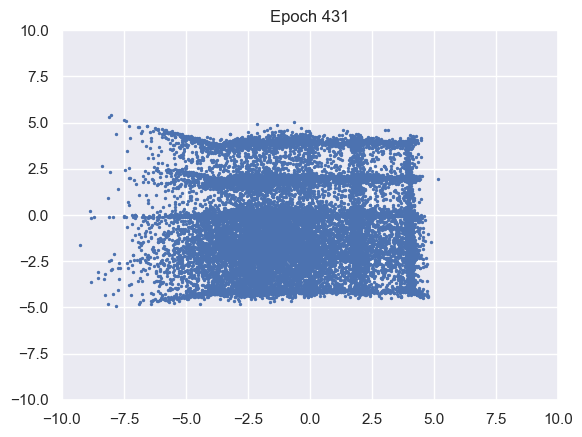

100%|██████████| 976/976 [00:09<00:00, 100.83it/s]


D loss : 1.1886, GP_loss : 0 G_loss : -0.8069, MI : 3.4645


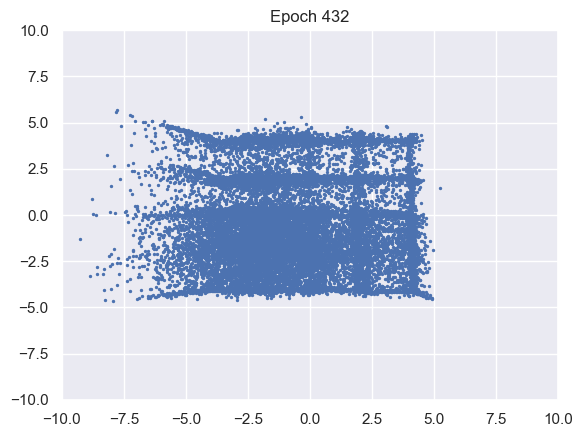

100%|██████████| 976/976 [00:09<00:00, 101.69it/s]


D loss : 1.1917, GP_loss : 0 G_loss : -0.8065, MI : 5.0782


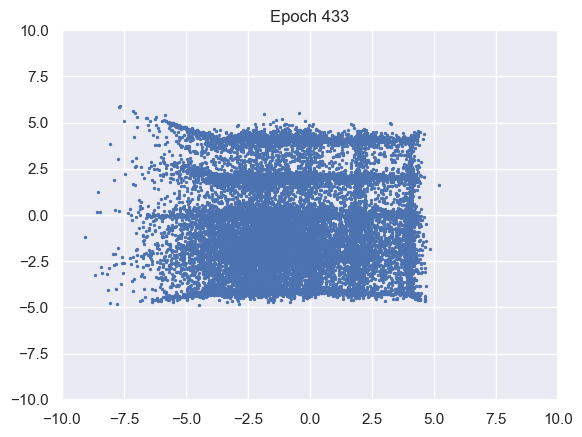

100%|██████████| 976/976 [00:09<00:00, 101.71it/s]


D loss : 1.1916, GP_loss : 0 G_loss : -0.8081, MI : 4.9678


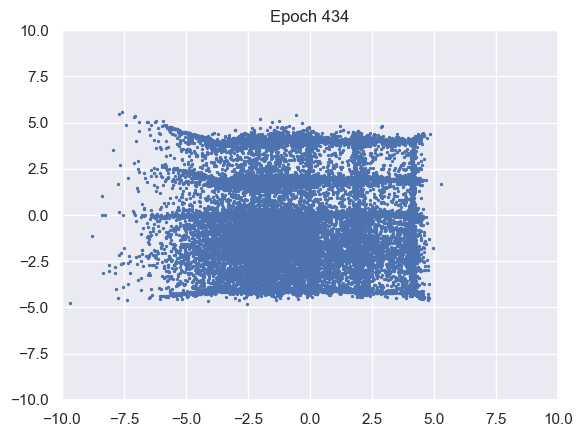

100%|██████████| 976/976 [00:09<00:00, 100.86it/s]


D loss : 1.1932, GP_loss : 0 G_loss : -0.8081, MI : 5.0644


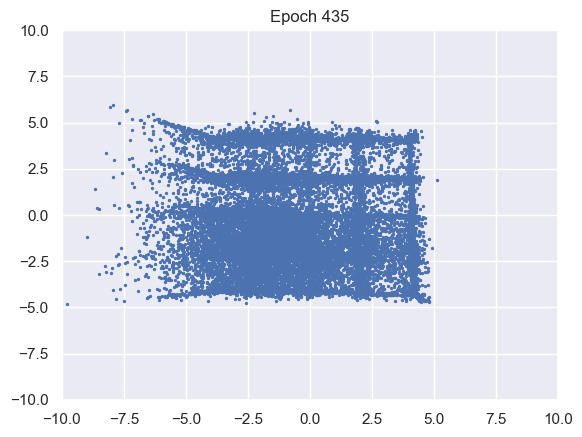

100%|██████████| 976/976 [00:09<00:00, 101.10it/s]


D loss : 1.1914, GP_loss : 0 G_loss : -0.8077, MI : 4.7051


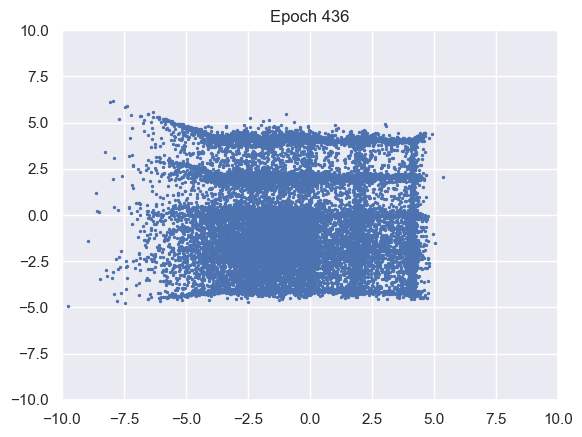

100%|██████████| 976/976 [00:09<00:00, 101.34it/s]


D loss : 1.193, GP_loss : 0 G_loss : -0.8067, MI : 5.169


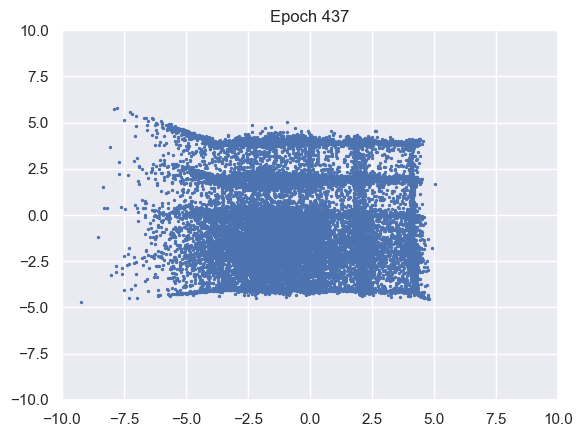

100%|██████████| 976/976 [00:09<00:00, 102.03it/s]


D loss : 1.1942, GP_loss : 0 G_loss : -0.8099, MI : 4.8109


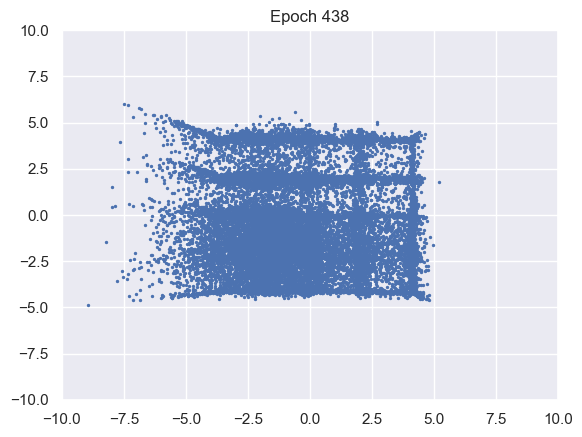

100%|██████████| 976/976 [00:09<00:00, 101.06it/s]


D loss : 1.1995, GP_loss : 0 G_loss : -0.8092, MI : 4.5821


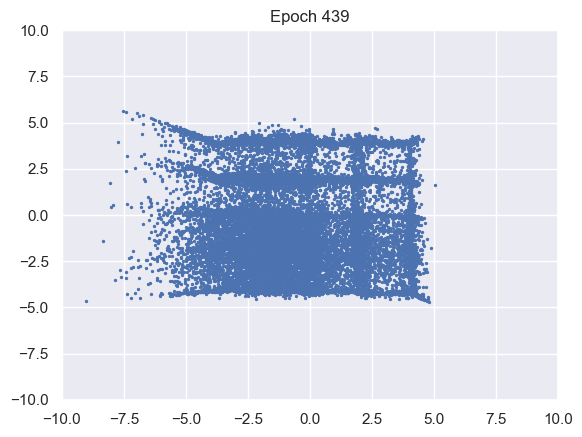

100%|██████████| 976/976 [00:09<00:00, 101.43it/s]


D loss : 1.1989, GP_loss : 0 G_loss : -0.8094, MI : 5.1674


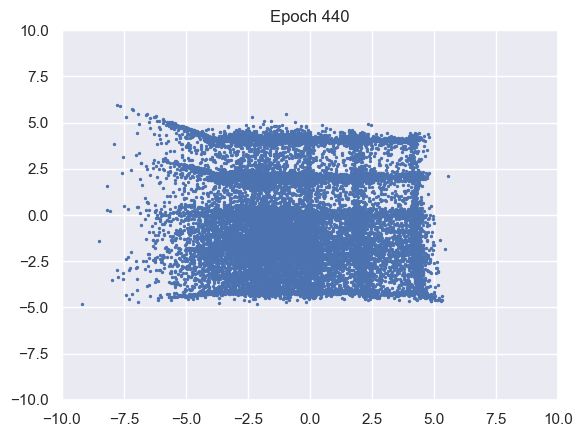

100%|██████████| 976/976 [00:09<00:00, 100.67it/s]


D loss : 1.1967, GP_loss : 0 G_loss : -0.809, MI : 4.6946


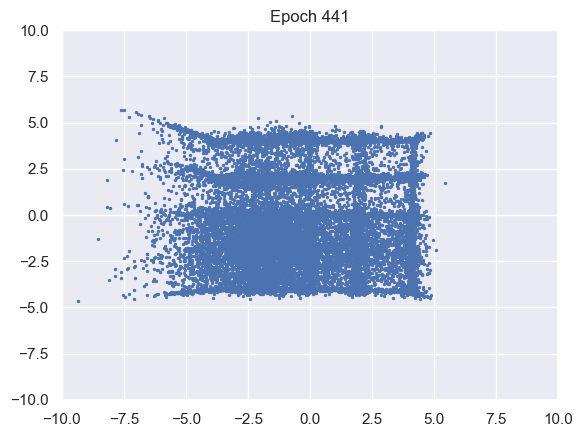

100%|██████████| 976/976 [00:09<00:00, 102.27it/s]


D loss : 1.1985, GP_loss : 0 G_loss : -0.8084, MI : 4.9007


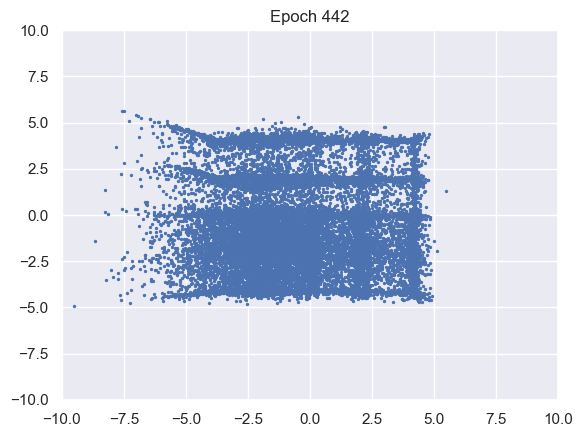

100%|██████████| 976/976 [00:09<00:00, 103.02it/s]


D loss : 1.1957, GP_loss : 0 G_loss : -0.808, MI : 4.9983


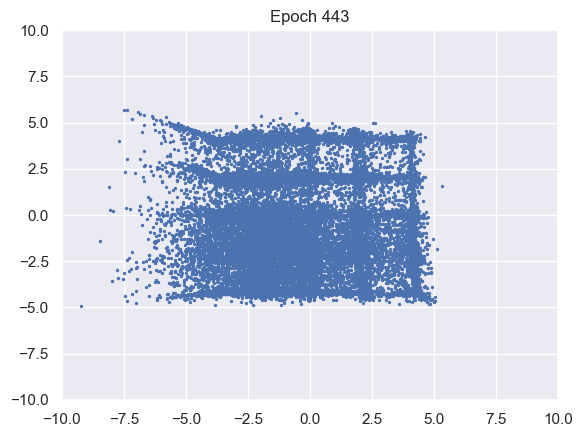

100%|██████████| 976/976 [00:10<00:00, 95.59it/s] 


D loss : 1.1967, GP_loss : 0 G_loss : -0.8089, MI : 4.9825


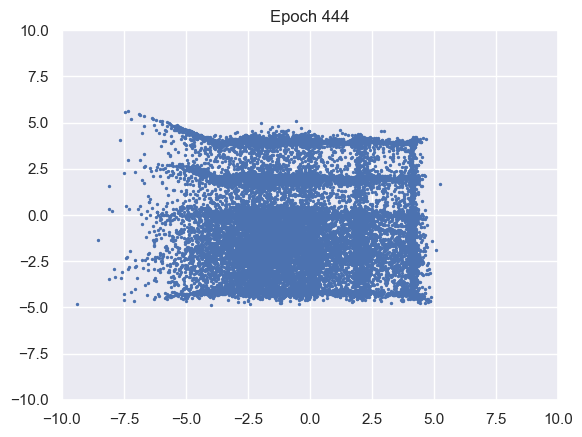

100%|██████████| 976/976 [00:10<00:00, 96.93it/s] 


D loss : 1.1961, GP_loss : 0 G_loss : -0.8094, MI : 3.9214


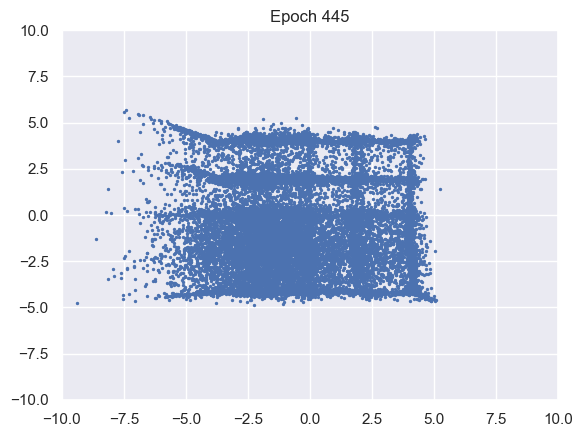

100%|██████████| 976/976 [00:10<00:00, 93.53it/s] 


D loss : 1.1971, GP_loss : 0 G_loss : -0.8079, MI : 5.1719


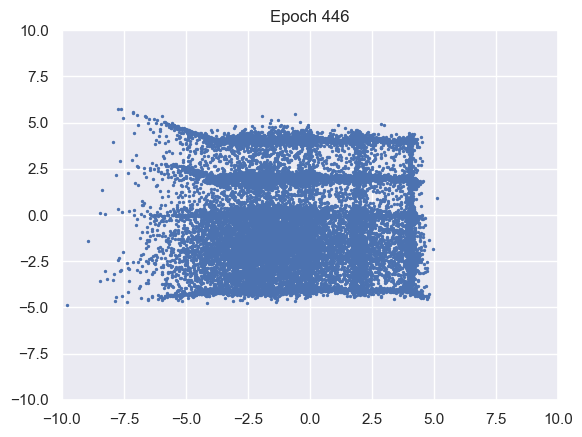

100%|██████████| 976/976 [00:09<00:00, 100.26it/s]


D loss : 1.1965, GP_loss : 0 G_loss : -0.8078, MI : 4.8815


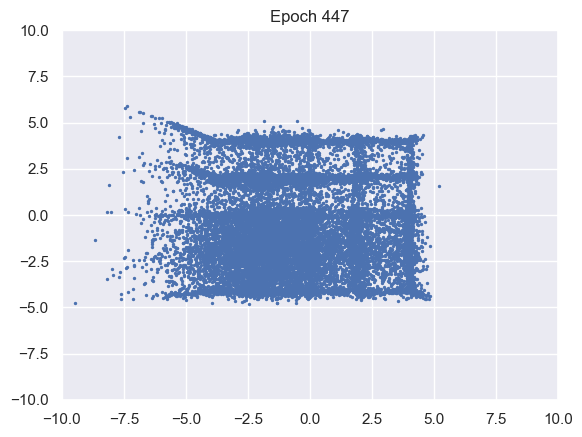

 74%|███████▍  | 727/976 [00:07<00:02, 91.75it/s] 

In [73]:
# MI augemented GAN
G = Generator()
G_ma = Generator()
D = Discriminator()
M = Mine()

if USE_GPU:
    G, G_ma, D, M = G.cuda(), G_ma.cuda(), D.cuda(), M.cuda()

G_ma.load_state_dict(G.state_dict())

G_opt = torch.optim.Adam(G.parameters(), lr=2e-4)
D_opt = torch.optim.Adam(D.parameters(), lr=2e-4)
M_opt = torch.optim.Adam(M.parameters(), lr=2e-4)

train(epoch_num=1000, is_zero_gp=True, is_mi_obj=True)